In [27]:
import torch
import torch.nn as nn
import torch.nn.functional as F
USE_GPU = torch.cuda.is_available()
BATCH_SIZE = 256

import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
%matplotlib inline

In [28]:
x = np.array([(i,j) for i in range(-4, 5, 2) for j in range(-4, 5, 2)] * 10000)
x = x + 0.1 * np.random.randn(*x.shape)
print(x.shape)

(250000, 2)


# spiral data

In [29]:
theta = np.linspace(0, 8*np.pi, 250000)  # 각도 범위를 정의합니다.
radius = np.linspace(0, 6, 250000)  # 반지름 범위를 정의합니다.
xx = radius * np.cos(theta) + 0.05 * np.random.randn(250000)  # x 좌표 계산
yy = radius * np.sin(theta) + 0.05 * np.random.randn(250000)  # y 좌표 계산

x = np.column_stack((xx, yy))  # x와 y 좌표를 합쳐서 데이터 생성

In [30]:
x.shape

(250000, 2)

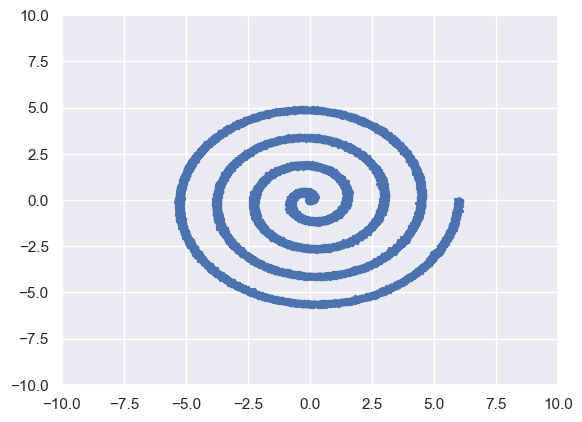

In [31]:
plt.scatter(x[:,0], x[:,1], s=2.0)
plt.xlim((-10, 10))
plt.ylim((-10, 10))
plt.show()

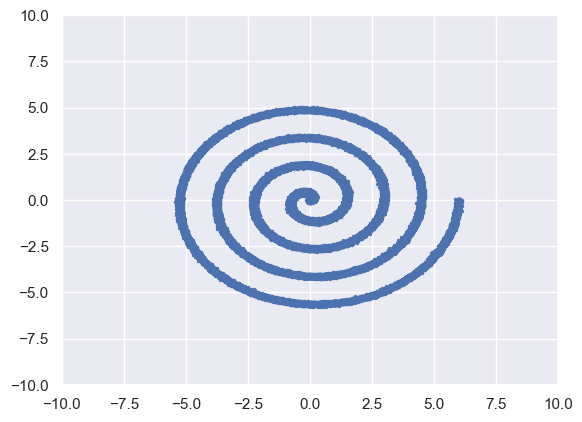

In [32]:
np.random.shuffle(x)
plt.scatter(x[:,0], x[:,1], s=2.0)
plt.xlim((-10, 10))
plt.ylim((-10, 10))
plt.show()

In [19]:
class Generator(nn.Module):
    
    def __init__(self, input_size=10, output_size=2, hidden_size=128):
        super().__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)
        self.fc2 = nn.Linear(hidden_size, hidden_size)
        self.fc3 = nn.Linear(hidden_size, output_size)
        
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight)
                nn.init.constant_(m.bias, 0.0)
                
    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), negative_slope=2e-1)
        x = F.leaky_relu(self.fc2(x), negative_slope=2e-1)
        x = F.leaky_relu(self.fc3(x), negative_slope=2e-1)
        return x
        
class Discriminator(nn.Module):
    
    def __init__(self, input_size=2, output_size=1, hidden_size=128):
        super().__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)
        self.fc2 = nn.Linear(hidden_size, hidden_size)
        self.fc_mu = nn.Linear(hidden_size, hidden_size)
        self.fc_sigma = nn.Linear(hidden_size, hidden_size)
        self.fc3 = nn.Linear(hidden_size, output_size)
        
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight)
                nn.init.constant_(m.bias, 0.0)
                
    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), negative_slope=2e-1)
        x = F.leaky_relu(self.fc2(x), negative_slope=2e-1)
        mu = self.fc_mu(x)
        sigma = torch.sigmoid(self.fc_sigma(x))
        x = torch.sigmoid(F.leaky_relu(self.fc3(mu + sigma * torch.randn_like(sigma)), negative_slope=2e-1))
        return x, mu, sigma
        
class Mine(nn.Module):
    
    def __init__(self, noise_size=3, sample_size=2, output_size=1, hidden_size=128):
        super().__init__()
        self.fc1_noise = nn.Linear(noise_size, hidden_size, bias=False)
        self.fc1_sample = nn.Linear(sample_size, hidden_size, bias=False)
        self.fc1_bias = nn.Parameter(torch.zeros(hidden_size))
        self.fc2 = nn.Linear(hidden_size, hidden_size)
        self.fc3 = nn.Linear(hidden_size, output_size)
        
        self.ma_et = None
        
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight)
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0.0)
                
    def forward(self, noise, sample):
        x_noise = self.fc1_noise(noise)
        x_sample = self.fc1_sample(sample)
        x = F.leaky_relu(x_noise + x_sample + self.fc1_bias, negative_slope=2e-1)
        x = F.leaky_relu(self.fc2(x), negative_slope=2e-1)
        x = F.leaky_relu(self.fc3(x), negative_slope=2e-1)
        return x

## 학습

In [20]:
def update_target(ma_net, net, update_rate=1e-1):
        # update moving average network parameters using network
    for ma_net_param, net_param in zip(ma_net.parameters(), net.parameters()):
        ma_net_param.data.copy_((1.0 - update_rate) \
                                * ma_net_param.data + update_rate*net_param.data)

In [21]:
def vib(mu, sigma, alpha=1e-8):
    d_kl = 0.5 * torch.mean((mu ** 2) + (sigma ** 2)
                                      - torch.log((sigma ** 2) + alpha) - 1)
    return d_kl

In [22]:
def learn_discriminator(x, G, D , M, D_opt, zero_gp=True, vdb=True):
    '''
    real_samples : torch.Tensor
    G : Generator network
    D : Discriminator network
    M : Mutual Information Neural Estimation(MINE) network
    D_opt : Optimizer of Discriminator
    '''
    z = torch.randn((BATCH_SIZE, 10))
    if USE_GPU:
        z = z.cuda()
        x = x.cuda()
    x_tilde = G(z)
    Dx_tilde, Dmu_tilde, Dsigma_tilde = D(x_tilde)
        
    if zero_gp:
        # zero centered gradient penalty  : https://arxiv.org/abs/1801.04406
        x.requires_grad = True
        Dx, Dmu, Dsigma = D(x)
        grad = torch.autograd.grad(Dx, x, create_graph=True,
                             grad_outputs=torch.ones_like(Dx),
                             retain_graph=True, only_inputs=True)[0].view(BATCH_SIZE, -1)
        grad = grad.norm(dim=1)
        gp_loss = torch.mean(grad**2)
    else:
        Dx, Dmu, Dsigma = D(x)
    
    if vdb:
        # information bottleneck
        vib_loss = (vib(Dmu, Dsigma) + vib(Dmu_tilde, Dsigma_tilde))/2
    
    loss = 0.
    gan_loss = - torch.log(Dx).mean() - torch.log(1-Dx_tilde).mean()
    loss += gan_loss
    if zero_gp:
        loss = gan_loss + 1.0 * gp_loss
    if vdb:
        loss += 0.1 * vib_loss
    
    D_opt.zero_grad()
    loss.backward()
    D_opt.step()
    
    if zero_gp:
        return gan_loss.item(), gp_loss.item()
    
    return gan_loss.item(), 0

In [40]:
def learn_generator(x, G, D, M, G_opt, G_ma, mi_obj=False):
    '''
    real_samples : torch.Tensor
    G : Generator network
    D : Discriminator network
    M : Mutual Information Neural Estimation(MINE) network
    G_opt : Optimizer of Generator
    mi_reg : add Mutual information objective
    '''
    z = torch.randn((BATCH_SIZE, 10))
    z_bar = torch.narrow(torch.randn((BATCH_SIZE, 10)), dim=1, start=0, length=3)
        # which is for product distribution.
    if USE_GPU:
        z = z.cuda()
        z_bar = z_bar.cuda()
        x = x.cuda()
    x_tilde = G(z)
    Dx_tilde, Dmu_tilde, Dsimga_tilde = D(x_tilde)
    
    loss = 0.
    gan_loss = torch.log(1-Dx_tilde).mean()
    loss += gan_loss
    if mi_obj:
        z = torch.narrow(z, dim=1, start=0, length=3) # slice for MI
        mi = torch.mean(M(z, x_tilde)) - torch.log(torch.mean(torch.exp(M(z_bar, x_tilde)))+1e-8)
        loss -= 0.01 * mi
    
    G_opt.zero_grad()
    loss.backward()
    G_opt.step()
    
    # EMA GAN : https://arxiv.org/abs/1806.04498
    update_target(G_ma, G)
    
    return gan_loss.item()

In [41]:
def learn_mine(G, M, M_opt, ma_rate=0.001):
    '''
    Mine is learning for MI of (input, output) of Generator.
    '''
    z = torch.randn((BATCH_SIZE, 10)) # (256, 10)
    # which is the input of Generator.
    z_bar = torch.narrow(torch.randn((BATCH_SIZE, 10)), dim=1, start=0, length=3) # (256, 3)
    # which is for product distribution.
    if USE_GPU:
        z = z.cuda()
        z_bar = z_bar.cuda()
    x_tilde = G(z) # which is the output of Generator.
    #print(z.shape, z_bar.shape, x_tilde.shape)
    
    et = torch.mean(torch.exp(M(z_bar, x_tilde))) # z_bar가 x, x_tilde가 y_shuffle
    
    if M.ma_et is None:
        M.ma_et = et.detach().item()
    M.ma_et += ma_rate * (et.detach().item() - M.ma_et)
    z = torch.narrow(z, dim=1, start=0, length=3) # slice for MI -> (256, 3)
    mutual_information = torch.mean(M(z, x_tilde)) - torch.log(et) * et.detach() /M.ma_et
    loss = - mutual_information
    
    M_opt.zero_grad()
    loss.backward()
    M_opt.step()
    
    return mutual_information.item()

In [42]:
z_test = torch.randn((20000, 10))
if USE_GPU:
    z_test = z_test.cuda()
def train(epoch_num=300, is_zero_gp=False, is_mi_obj=False):
    for i in range(1, epoch_num+1):
        np.random.shuffle(x)
        iter_num = len(x) // BATCH_SIZE
        for j in tqdm(range(iter_num)):
            batch = torch.FloatTensor(x[BATCH_SIZE * j : BATCH_SIZE * j + BATCH_SIZE])
            d_loss, gp_loss = learn_discriminator(batch, G, D, M, D_opt, zero_gp=is_zero_gp)
            g_loss = learn_generator(batch, G, D, M, G_opt, G_ma, mi_obj=is_mi_obj)
            mi = learn_mine(G, M, M_opt)
            
            d_loss_arr.append(d_loss)
            gp_loss_arr.append(gp_loss)
            g_loss_arr.append(g_loss)
            mi_arr.append(mi)
        print('D loss : {0}, GP_loss : {1} G_loss : {2}, MI : {3}'.format(
            round(np.mean(d_loss_arr),4), round(np.mean(gp_loss_arr)),
            round(np.mean(g_loss_arr),4), round(np.mean(mi_arr),4)))
        x_test = G_ma(z_test).data.cpu().numpy()
        plt.title('Epoch {0}'.format(i))
        plt.scatter(x_test[:,0], x_test[:,1], s=2.0)
        plt.xlim((-10, 10))
        plt.ylim((-10, 10))
        plt.savefig(f'result_mine_0.01/{i}.png')
        plt.show()
    
    return d_loss_arr, gp_loss_arr, 

100%|██████████| 976/976 [00:10<00:00, 89.72it/s]


D loss : 1.3432, GP_loss : 0 G_loss : -0.6777, MI : 0.2831


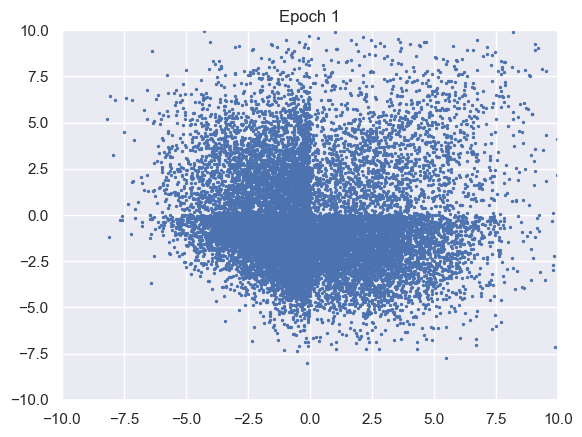

100%|██████████| 976/976 [00:10<00:00, 90.50it/s]


D loss : 1.3608, GP_loss : 0 G_loss : -0.6719, MI : 0.3974


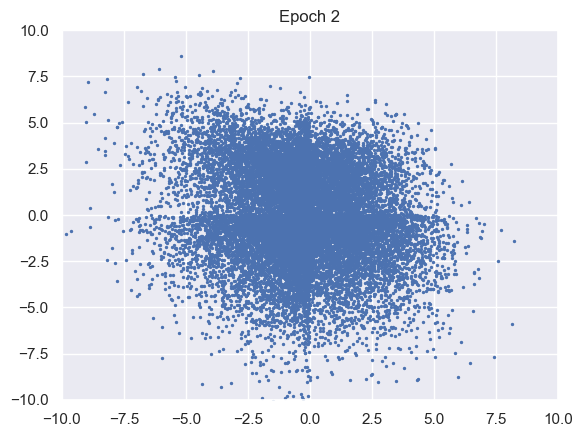

100%|██████████| 976/976 [00:10<00:00, 91.79it/s]


D loss : 1.3716, GP_loss : 0 G_loss : -0.6656, MI : 0.5946


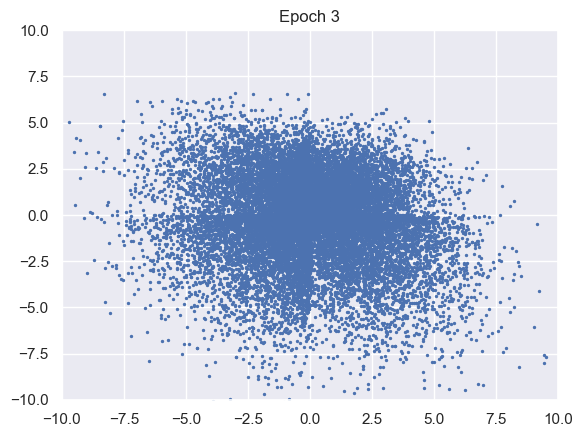

100%|██████████| 976/976 [00:10<00:00, 90.84it/s]


D loss : 1.3762, GP_loss : 0 G_loss : -0.6646, MI : 0.7764


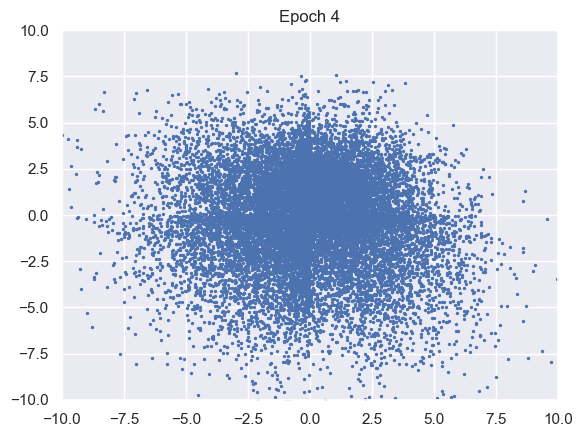

100%|██████████| 976/976 [00:10<00:00, 89.83it/s]


D loss : 1.3782, GP_loss : 0 G_loss : -0.6668, MI : 0.9493


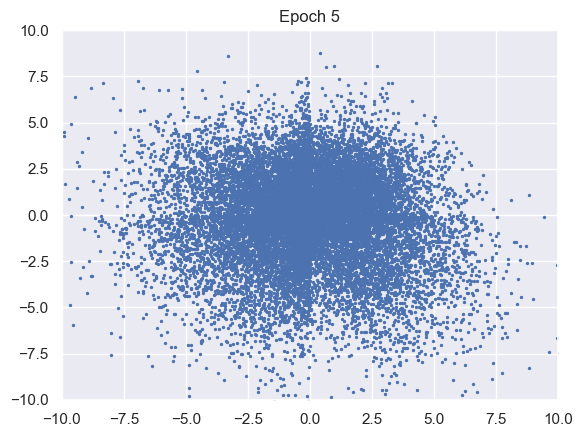

100%|██████████| 976/976 [00:10<00:00, 91.41it/s]


D loss : 1.379, GP_loss : 0 G_loss : -0.6712, MI : 1.1267


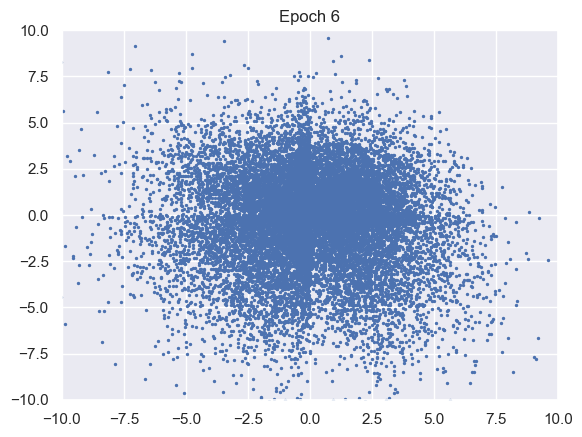

100%|██████████| 976/976 [00:10<00:00, 89.69it/s]


D loss : 1.3795, GP_loss : 0 G_loss : -0.6754, MI : 1.3153


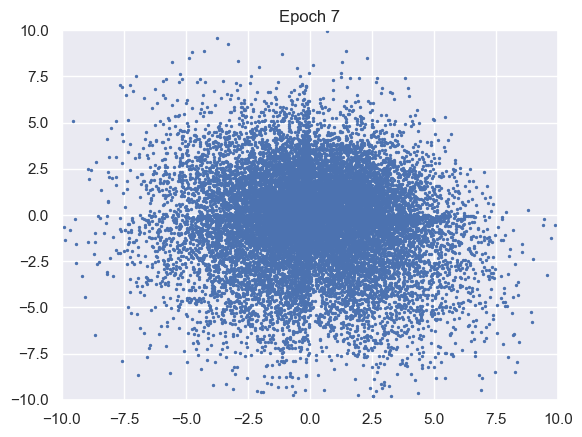

100%|██████████| 976/976 [00:10<00:00, 91.22it/s]


D loss : 1.3798, GP_loss : 0 G_loss : -0.679, MI : 1.5047


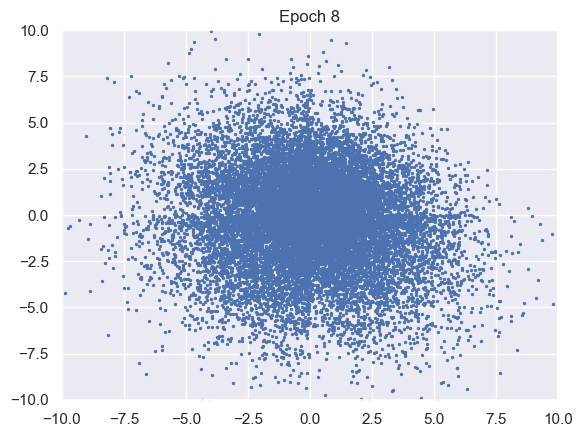

100%|██████████| 976/976 [00:10<00:00, 90.53it/s]


D loss : 1.3801, GP_loss : 0 G_loss : -0.6817, MI : 1.6992


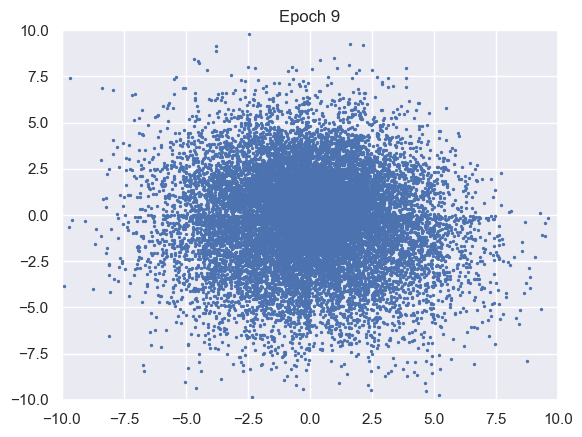

100%|██████████| 976/976 [00:10<00:00, 91.68it/s]


D loss : 1.3803, GP_loss : 0 G_loss : -0.6839, MI : 1.876


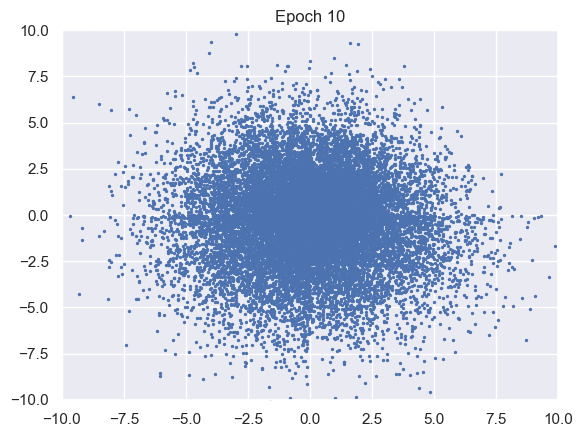

100%|██████████| 976/976 [00:10<00:00, 89.68it/s]


D loss : 1.3804, GP_loss : 0 G_loss : -0.6857, MI : 2.0466


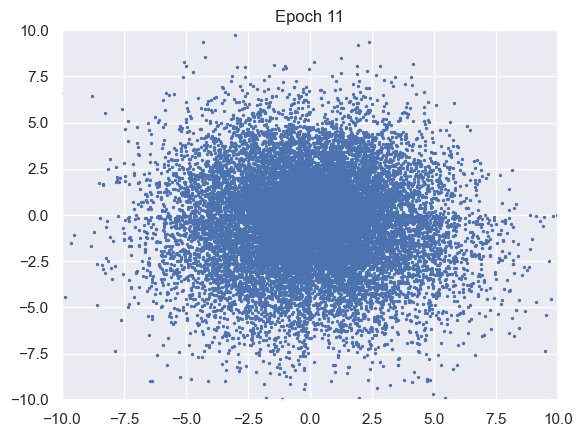

100%|██████████| 976/976 [00:10<00:00, 91.84it/s]


D loss : 1.3805, GP_loss : 0 G_loss : -0.6871, MI : 2.2078


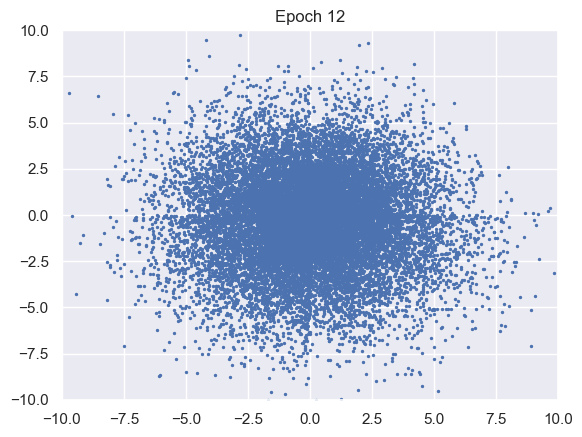

100%|██████████| 976/976 [00:10<00:00, 91.21it/s]


D loss : 1.3805, GP_loss : 0 G_loss : -0.6885, MI : 2.3028


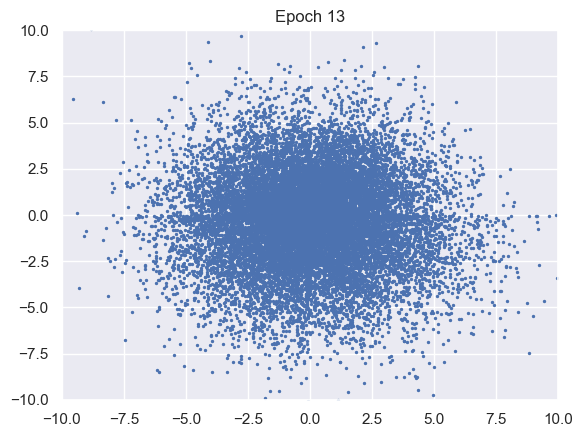

100%|██████████| 976/976 [00:10<00:00, 91.61it/s]


D loss : 1.3804, GP_loss : 0 G_loss : -0.6896, MI : 2.4242


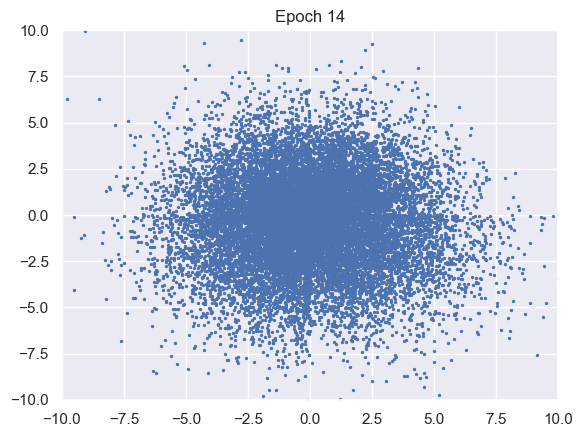

100%|██████████| 976/976 [00:10<00:00, 91.73it/s]


D loss : 1.3804, GP_loss : 0 G_loss : -0.6906, MI : 2.5411


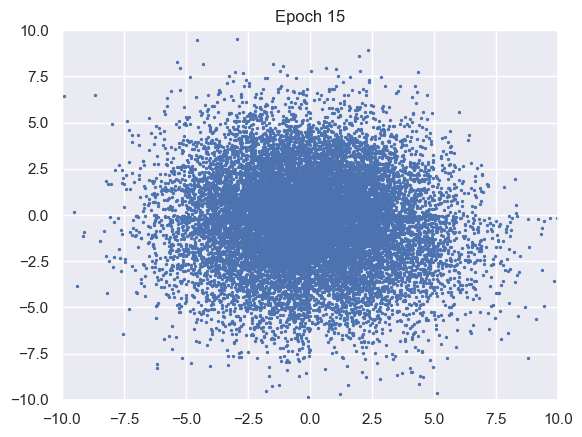

100%|██████████| 976/976 [00:10<00:00, 93.06it/s]


D loss : 1.3802, GP_loss : 0 G_loss : -0.6916, MI : 2.634


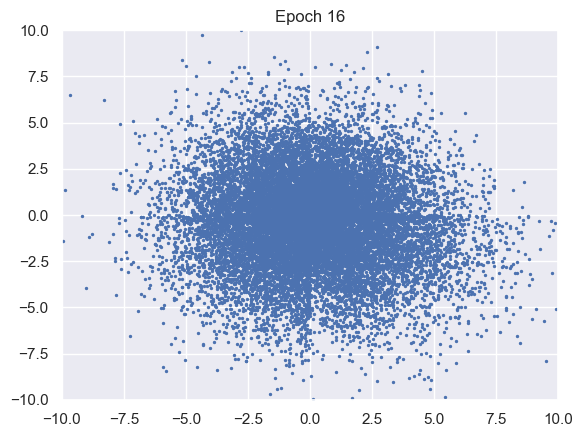

100%|██████████| 976/976 [00:10<00:00, 93.39it/s]


D loss : 1.38, GP_loss : 0 G_loss : -0.6927, MI : 2.6811


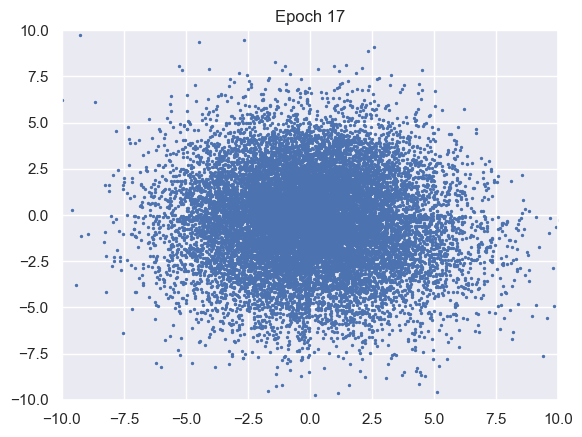

100%|██████████| 976/976 [00:10<00:00, 92.46it/s]


D loss : 1.3798, GP_loss : 0 G_loss : -0.6937, MI : 2.7701


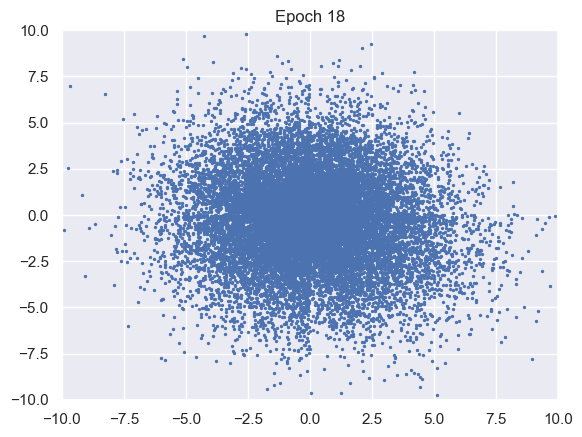

100%|██████████| 976/976 [00:10<00:00, 92.29it/s]


D loss : 1.3795, GP_loss : 0 G_loss : -0.6948, MI : 2.8314


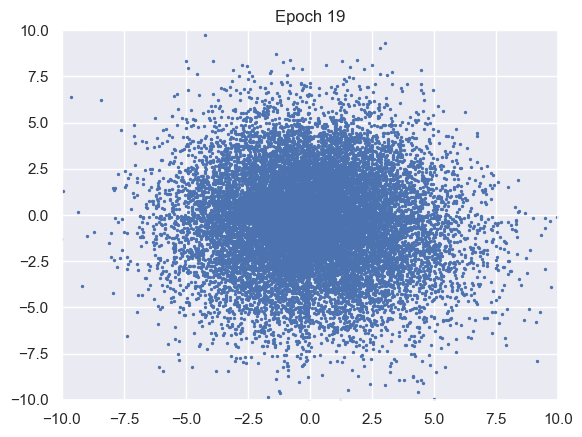

100%|██████████| 976/976 [00:10<00:00, 93.02it/s]


D loss : 1.379, GP_loss : 0 G_loss : -0.6961, MI : 2.8992


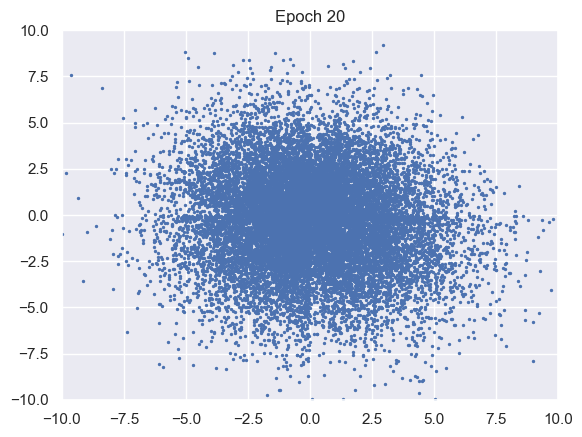

100%|██████████| 976/976 [00:10<00:00, 91.63it/s]


D loss : 1.3782, GP_loss : 0 G_loss : -0.6976, MI : 2.9716


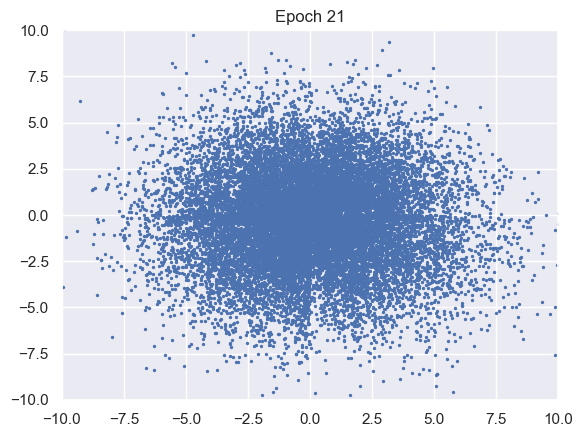

100%|██████████| 976/976 [00:10<00:00, 92.11it/s]


D loss : 1.3772, GP_loss : 0 G_loss : -0.6992, MI : 3.0075


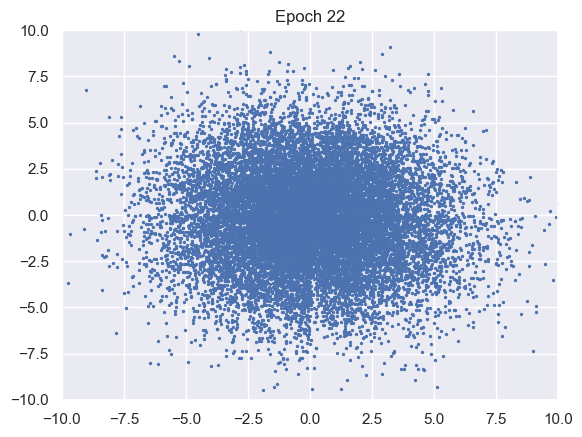

100%|██████████| 976/976 [00:10<00:00, 93.04it/s]


D loss : 1.3759, GP_loss : 0 G_loss : -0.7008, MI : 3.0549


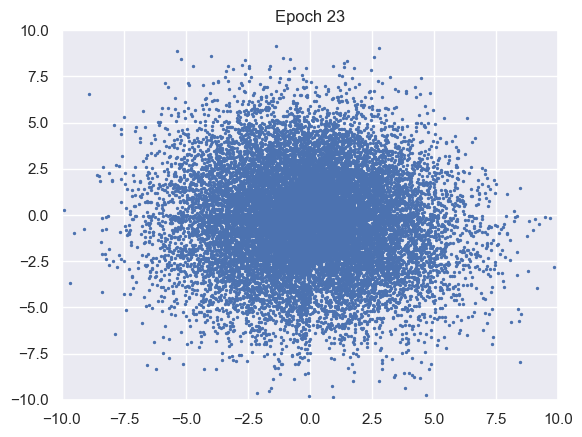

100%|██████████| 976/976 [00:10<00:00, 92.74it/s]


D loss : 1.3746, GP_loss : 0 G_loss : -0.7023, MI : 3.1002


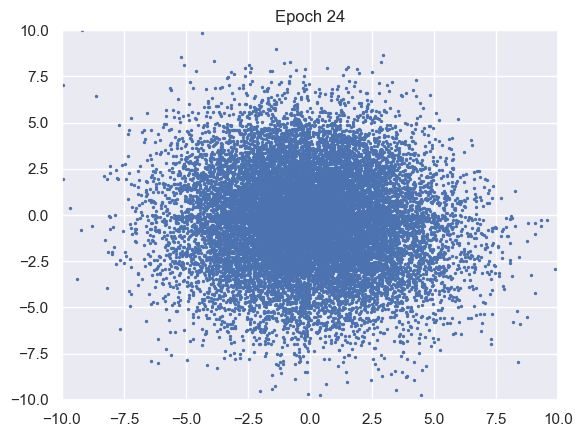

100%|██████████| 976/976 [00:10<00:00, 93.32it/s]


D loss : 1.3734, GP_loss : 0 G_loss : -0.7036, MI : 3.1483


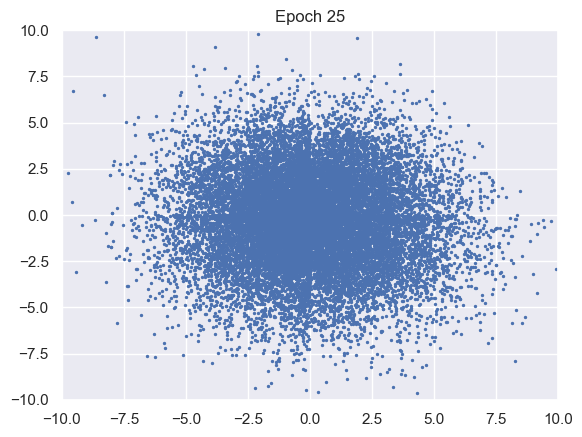

100%|██████████| 976/976 [00:10<00:00, 92.11it/s]


D loss : 1.3721, GP_loss : 0 G_loss : -0.7049, MI : 3.1911


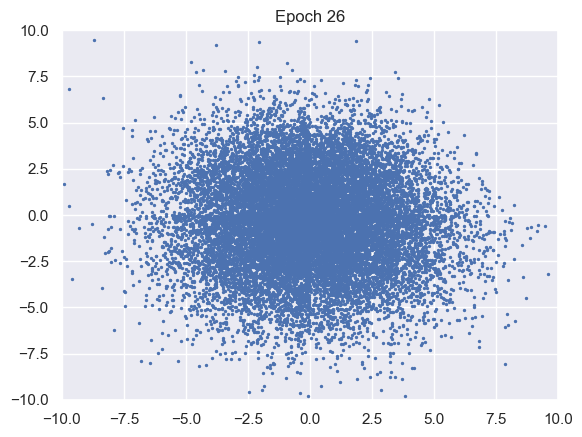

100%|██████████| 976/976 [00:10<00:00, 92.08it/s]


D loss : 1.3709, GP_loss : 0 G_loss : -0.706, MI : 3.2368


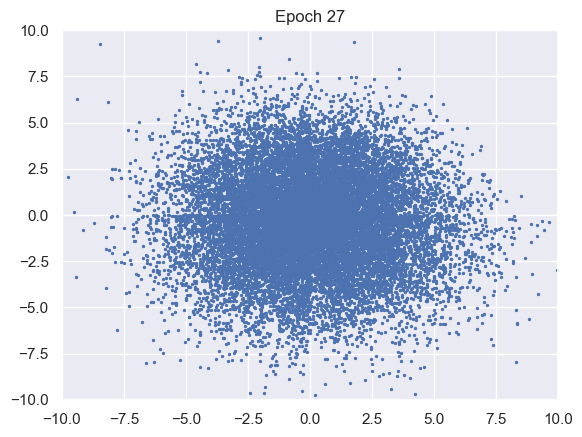

100%|██████████| 976/976 [00:10<00:00, 90.66it/s]


D loss : 1.3697, GP_loss : 0 G_loss : -0.7071, MI : 3.2163


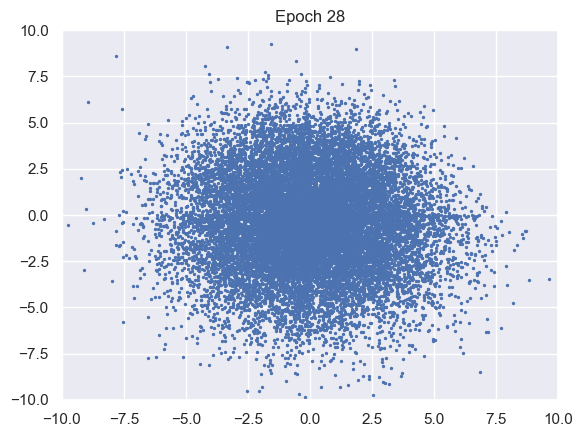

100%|██████████| 976/976 [00:10<00:00, 92.37it/s]


D loss : 1.3686, GP_loss : 0 G_loss : -0.708, MI : 3.2582


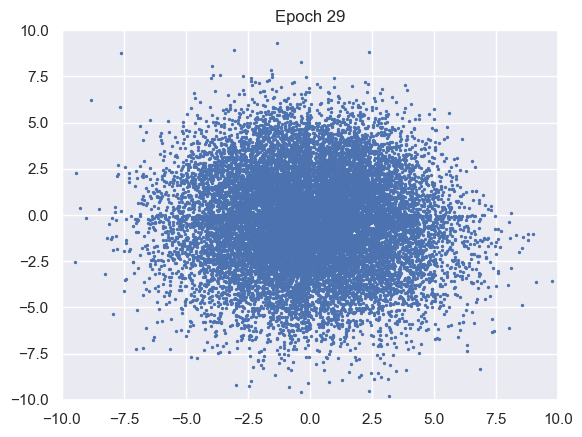

100%|██████████| 976/976 [00:10<00:00, 91.28it/s]


D loss : 1.3675, GP_loss : 0 G_loss : -0.7089, MI : 3.2988


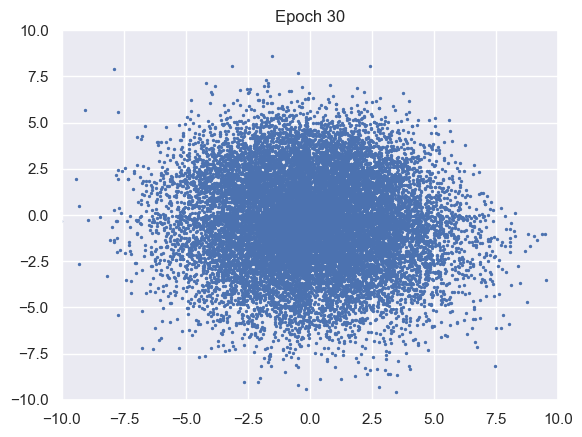

100%|██████████| 976/976 [00:10<00:00, 91.52it/s]


D loss : 1.3664, GP_loss : 0 G_loss : -0.7098, MI : 3.3281


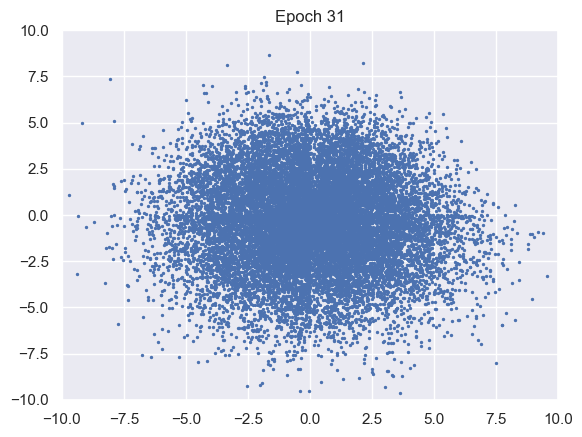

100%|██████████| 976/976 [00:10<00:00, 91.92it/s]


D loss : 1.3654, GP_loss : 0 G_loss : -0.7106, MI : 3.3315


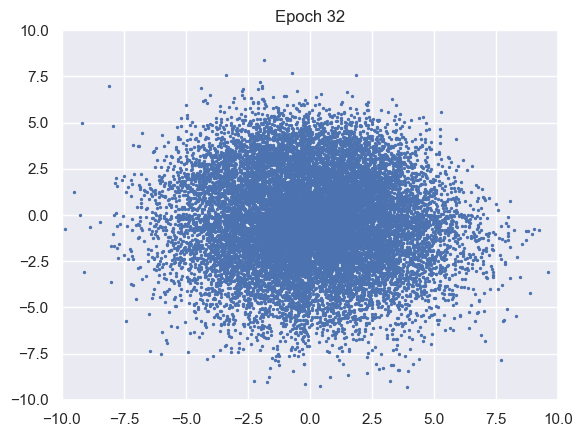

100%|██████████| 976/976 [00:10<00:00, 91.52it/s]


D loss : 1.3644, GP_loss : 0 G_loss : -0.7113, MI : 3.3661


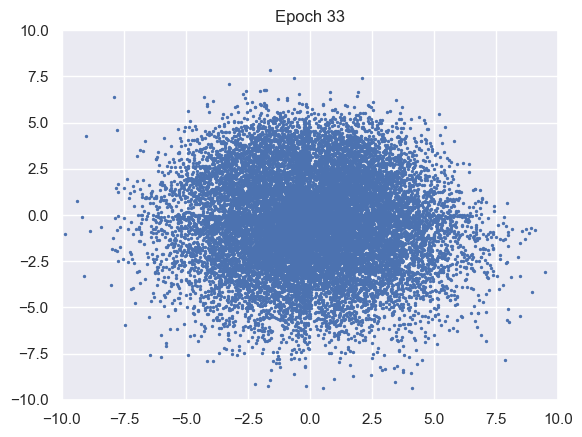

100%|██████████| 976/976 [00:10<00:00, 90.32it/s]


D loss : 1.3635, GP_loss : 0 G_loss : -0.712, MI : 3.3837


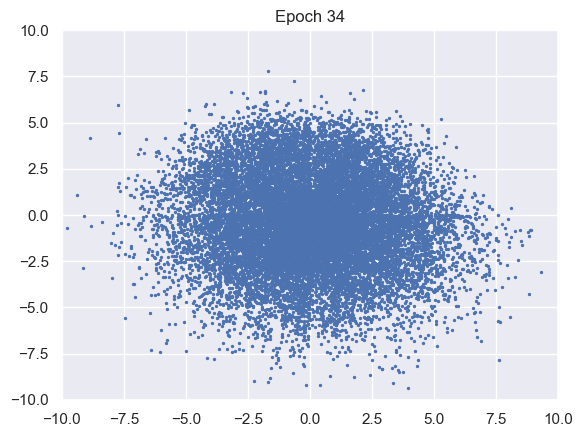

100%|██████████| 976/976 [00:10<00:00, 89.71it/s]


D loss : 1.3625, GP_loss : 0 G_loss : -0.7126, MI : 3.4096


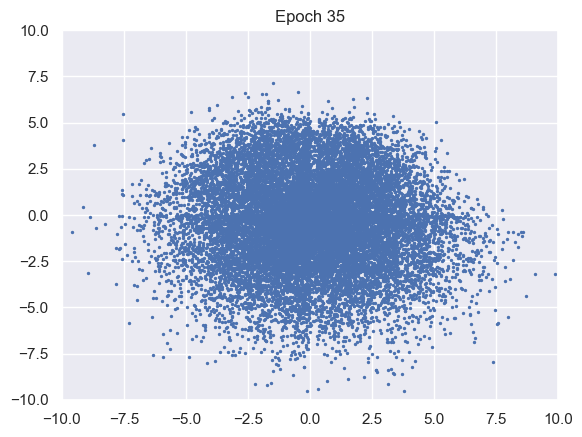

100%|██████████| 976/976 [00:10<00:00, 89.91it/s]


D loss : 1.3617, GP_loss : 0 G_loss : -0.7132, MI : 3.4226


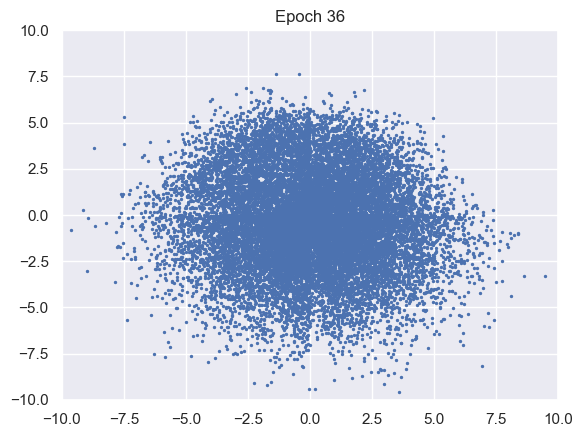

100%|██████████| 976/976 [00:10<00:00, 91.30it/s]


D loss : 1.3609, GP_loss : 0 G_loss : -0.7138, MI : 3.4375


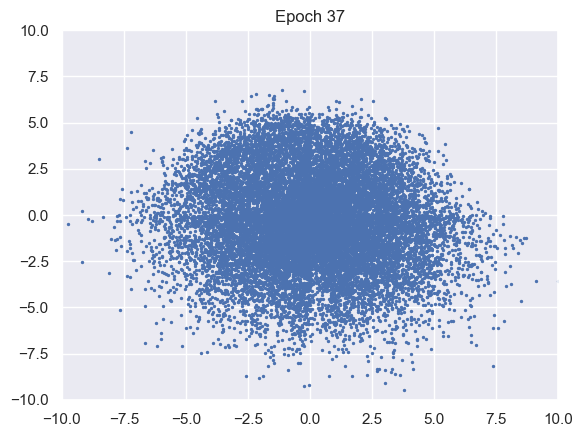

100%|██████████| 976/976 [00:10<00:00, 93.02it/s]


D loss : 1.3601, GP_loss : 0 G_loss : -0.7142, MI : 3.4134


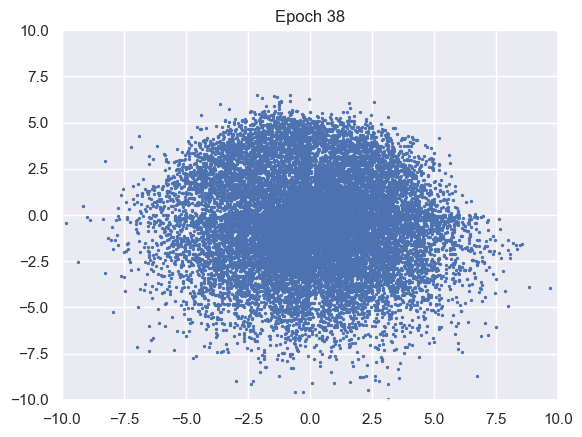

100%|██████████| 976/976 [00:10<00:00, 91.60it/s]


D loss : 1.3594, GP_loss : 0 G_loss : -0.7147, MI : 3.4372


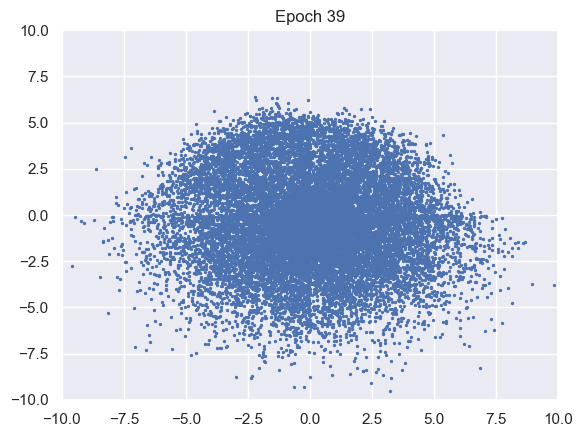

100%|██████████| 976/976 [00:10<00:00, 92.18it/s]


D loss : 1.3586, GP_loss : 0 G_loss : -0.7151, MI : 3.4588


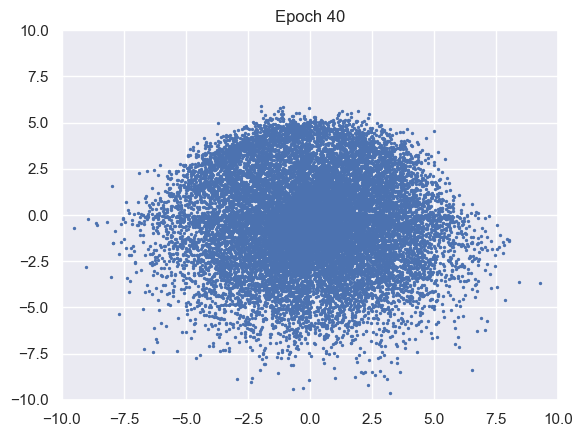

100%|██████████| 976/976 [00:10<00:00, 91.36it/s]


D loss : 1.358, GP_loss : 0 G_loss : -0.7155, MI : 3.4773


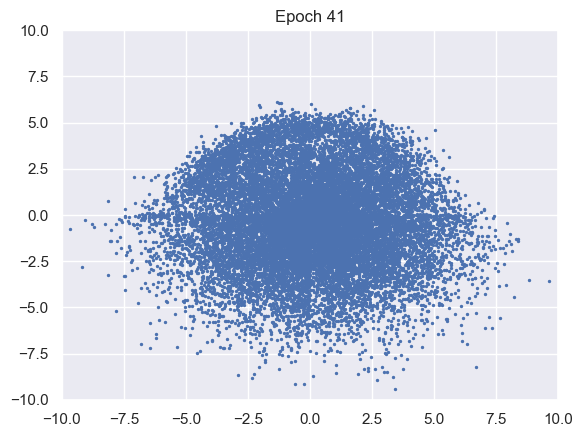

100%|██████████| 976/976 [00:10<00:00, 92.11it/s]


D loss : 1.3574, GP_loss : 0 G_loss : -0.7159, MI : 3.497


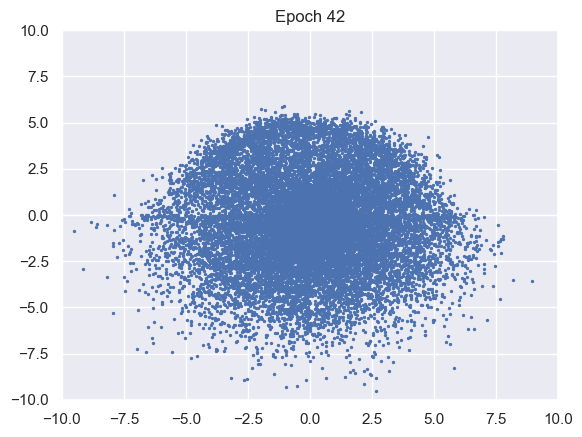

100%|██████████| 976/976 [00:10<00:00, 92.62it/s]


D loss : 1.3568, GP_loss : 0 G_loss : -0.7163, MI : 3.5097


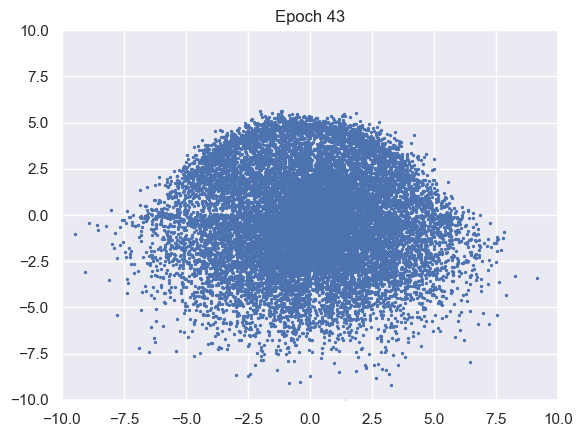

100%|██████████| 976/976 [00:10<00:00, 92.15it/s]


D loss : 1.3563, GP_loss : 0 G_loss : -0.7167, MI : 3.5227


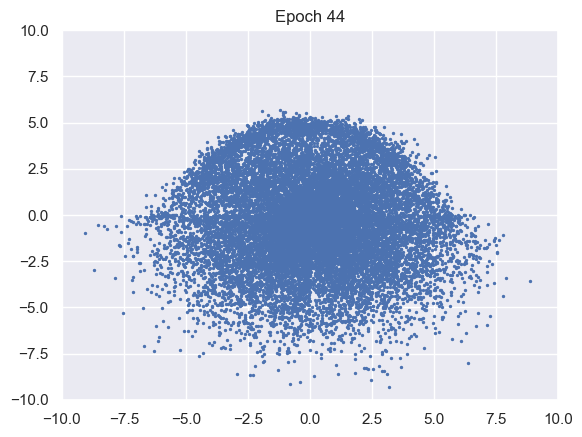

100%|██████████| 976/976 [00:10<00:00, 92.89it/s]


D loss : 1.3558, GP_loss : 0 G_loss : -0.7171, MI : 3.5338


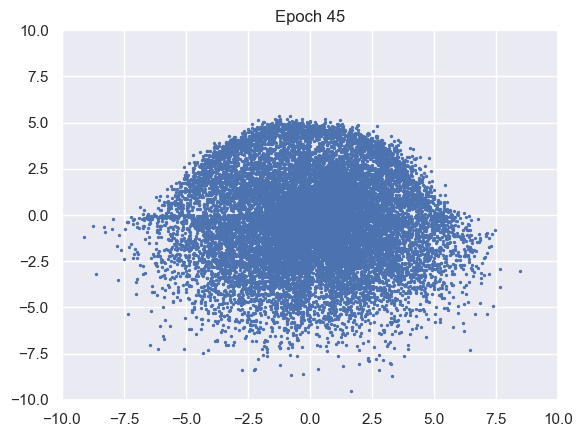

100%|██████████| 976/976 [00:10<00:00, 93.60it/s]


D loss : 1.3553, GP_loss : 0 G_loss : -0.7175, MI : 3.5429


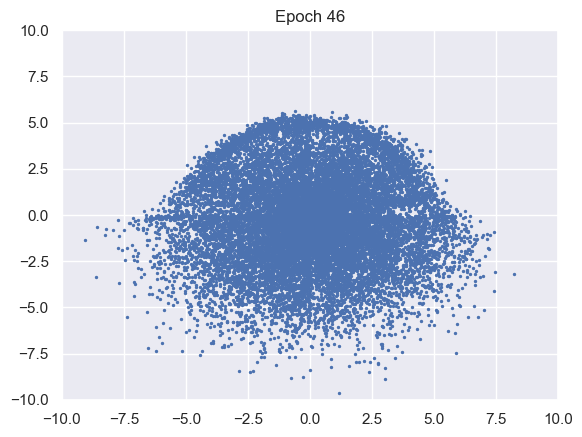

100%|██████████| 976/976 [00:10<00:00, 92.20it/s]


D loss : 1.3548, GP_loss : 0 G_loss : -0.7178, MI : 3.5488


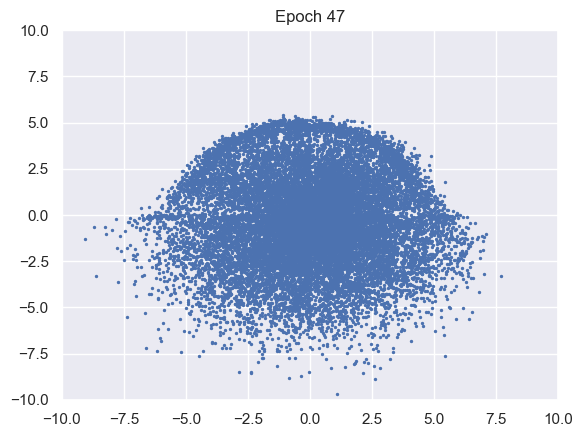

100%|██████████| 976/976 [00:10<00:00, 92.33it/s]


D loss : 1.3544, GP_loss : 0 G_loss : -0.7181, MI : 3.5661


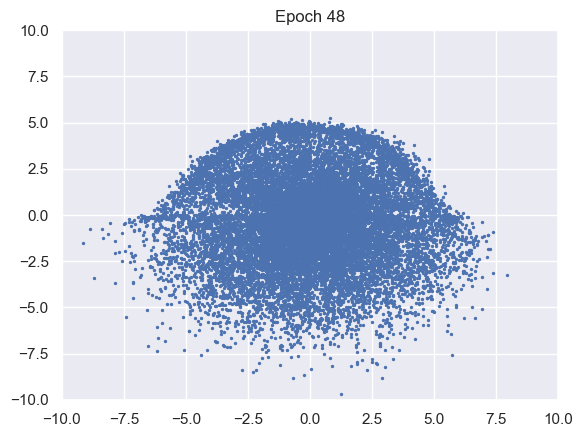

100%|██████████| 976/976 [00:10<00:00, 92.17it/s]


D loss : 1.3541, GP_loss : 0 G_loss : -0.7184, MI : 3.5757


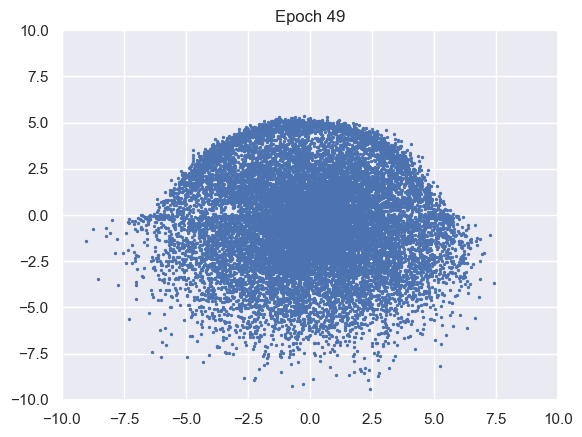

100%|██████████| 976/976 [00:10<00:00, 92.86it/s]


D loss : 1.3537, GP_loss : 0 G_loss : -0.7187, MI : 3.5863


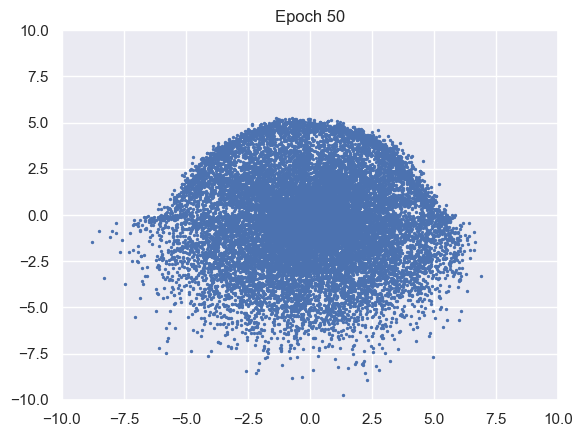

100%|██████████| 976/976 [00:10<00:00, 92.15it/s]


D loss : 1.3534, GP_loss : 0 G_loss : -0.719, MI : 3.5982


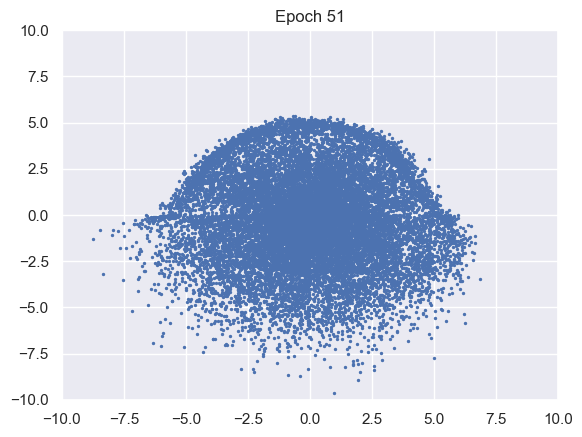

100%|██████████| 976/976 [00:10<00:00, 92.85it/s]


D loss : 1.3531, GP_loss : 0 G_loss : -0.7192, MI : 3.6077


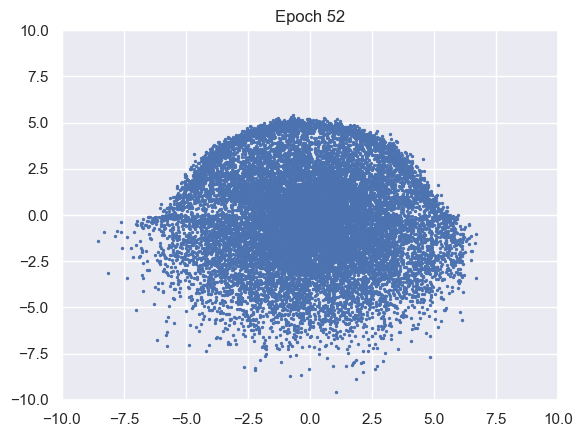

100%|██████████| 976/976 [00:10<00:00, 89.36it/s]


D loss : 1.3528, GP_loss : 0 G_loss : -0.7195, MI : 3.6179


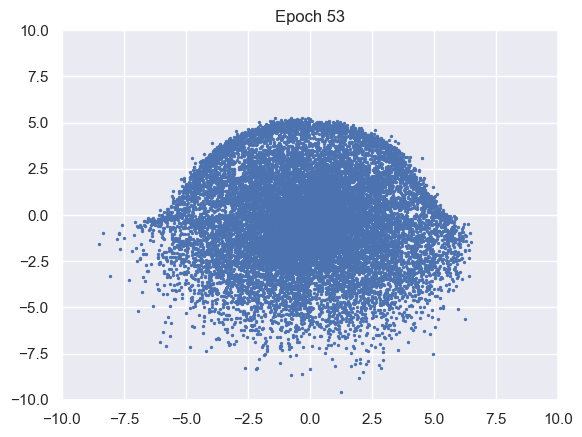

100%|██████████| 976/976 [00:10<00:00, 90.43it/s]


D loss : 1.3526, GP_loss : 0 G_loss : -0.7198, MI : 3.6297


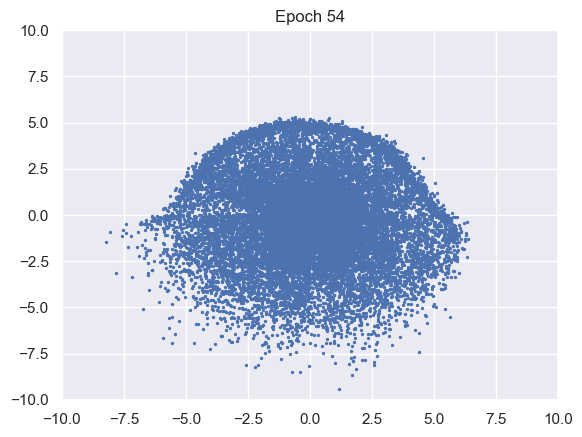

100%|██████████| 976/976 [00:10<00:00, 91.69it/s]


D loss : 1.3523, GP_loss : 0 G_loss : -0.7202, MI : 3.6405


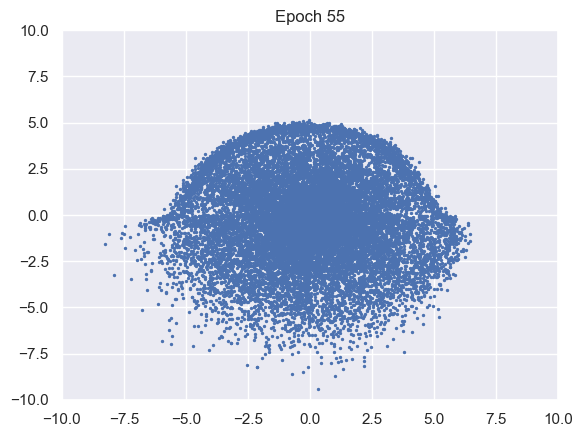

100%|██████████| 976/976 [00:10<00:00, 91.93it/s]


D loss : 1.3521, GP_loss : 0 G_loss : -0.7205, MI : 3.6516


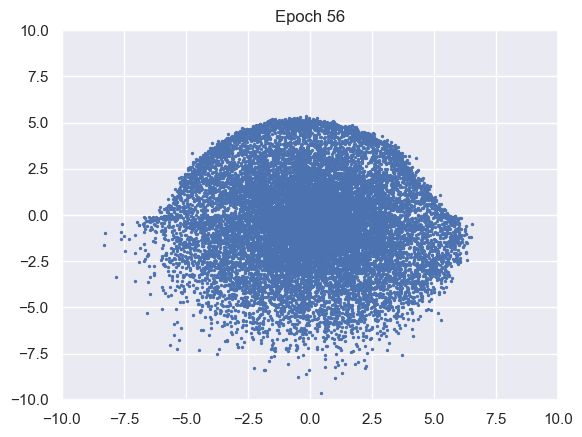

100%|██████████| 976/976 [00:10<00:00, 91.82it/s]


D loss : 1.3519, GP_loss : 0 G_loss : -0.7208, MI : 3.6586


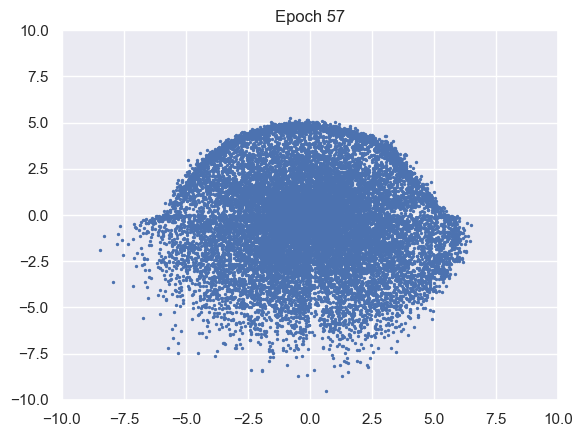

100%|██████████| 976/976 [00:10<00:00, 93.17it/s]


D loss : 1.3517, GP_loss : 0 G_loss : -0.7211, MI : 3.6654


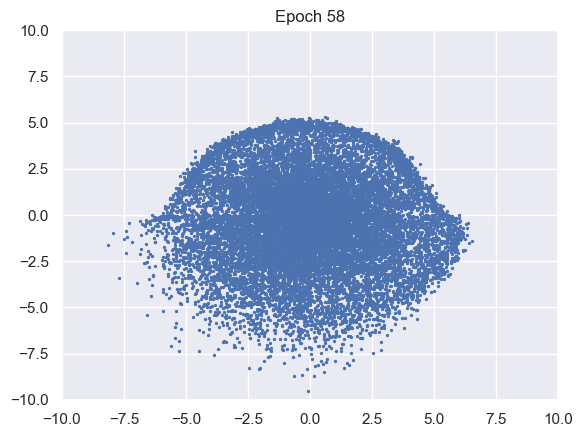

100%|██████████| 976/976 [00:10<00:00, 91.90it/s]


D loss : 1.3515, GP_loss : 0 G_loss : -0.7213, MI : 3.6759


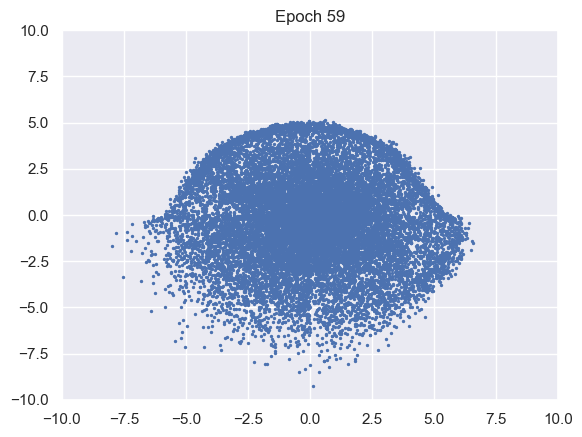

100%|██████████| 976/976 [00:10<00:00, 92.39it/s]


D loss : 1.3513, GP_loss : 0 G_loss : -0.7216, MI : 3.6798


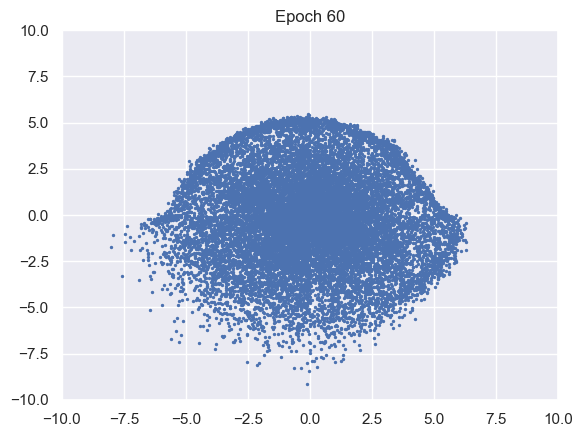

100%|██████████| 976/976 [00:10<00:00, 92.13it/s]


D loss : 1.3512, GP_loss : 0 G_loss : -0.7219, MI : 3.6868


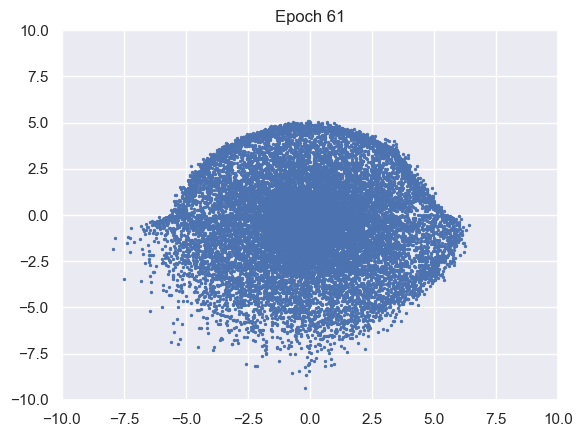

100%|██████████| 976/976 [00:10<00:00, 92.79it/s]


D loss : 1.3511, GP_loss : 0 G_loss : -0.7222, MI : 3.694


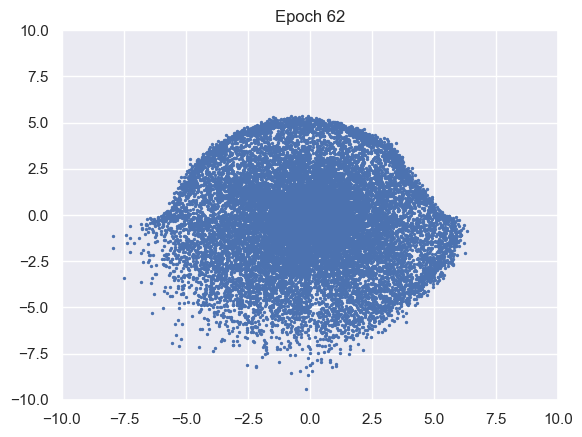

100%|██████████| 976/976 [00:10<00:00, 92.22it/s]


D loss : 1.3509, GP_loss : 0 G_loss : -0.7224, MI : 3.7016


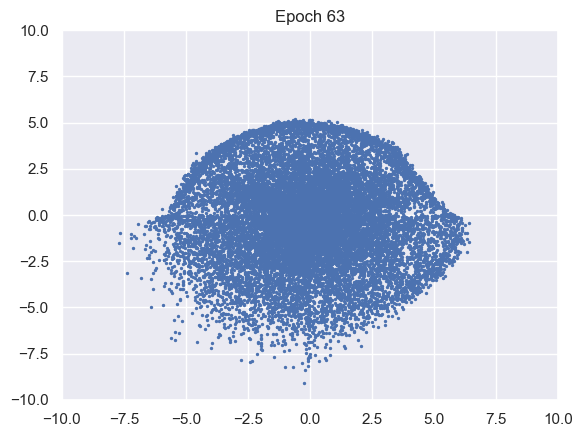

100%|██████████| 976/976 [00:10<00:00, 90.12it/s]


D loss : 1.3508, GP_loss : 0 G_loss : -0.7227, MI : 3.7086


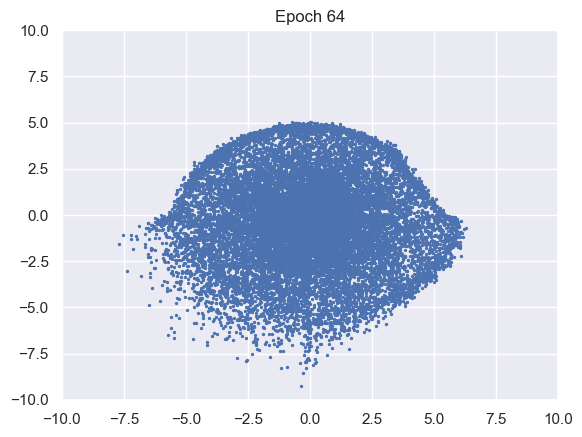

100%|██████████| 976/976 [00:10<00:00, 90.58it/s]


D loss : 1.3507, GP_loss : 0 G_loss : -0.7229, MI : 3.7186


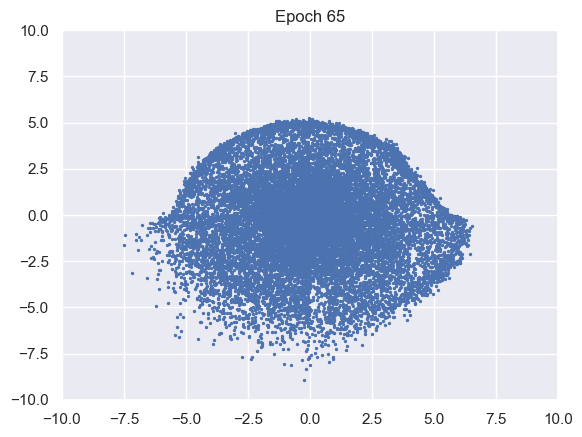

100%|██████████| 976/976 [00:10<00:00, 90.74it/s]


D loss : 1.3506, GP_loss : 0 G_loss : -0.7232, MI : 3.7258


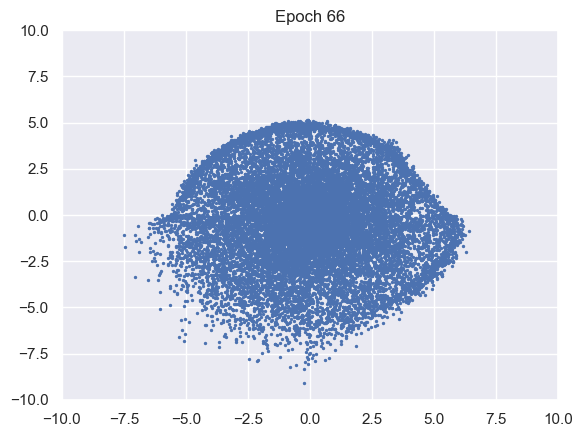

100%|██████████| 976/976 [00:10<00:00, 89.92it/s]


D loss : 1.3505, GP_loss : 0 G_loss : -0.7234, MI : 3.7302


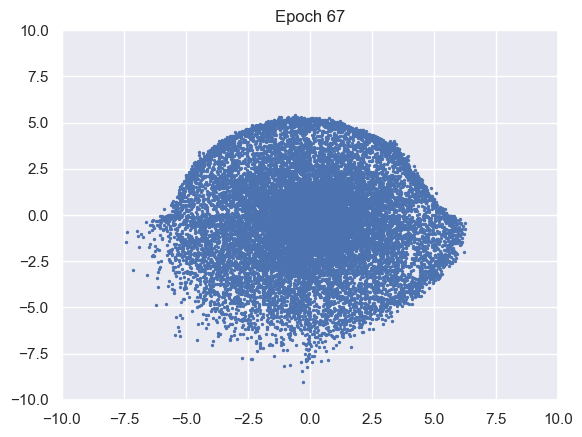

100%|██████████| 976/976 [00:10<00:00, 91.28it/s]


D loss : 1.3505, GP_loss : 0 G_loss : -0.7237, MI : 3.7397


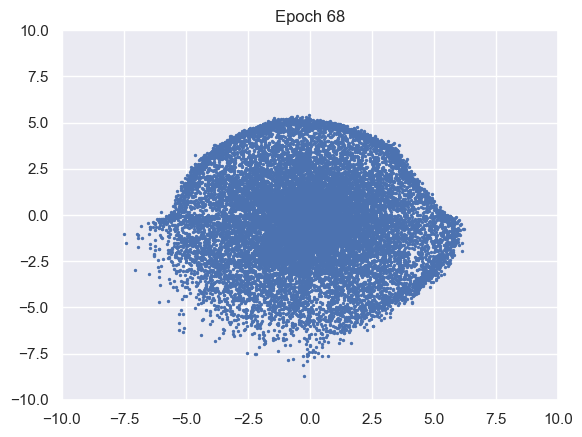

100%|██████████| 976/976 [00:10<00:00, 91.29it/s]


D loss : 1.3504, GP_loss : 0 G_loss : -0.7239, MI : 3.7429


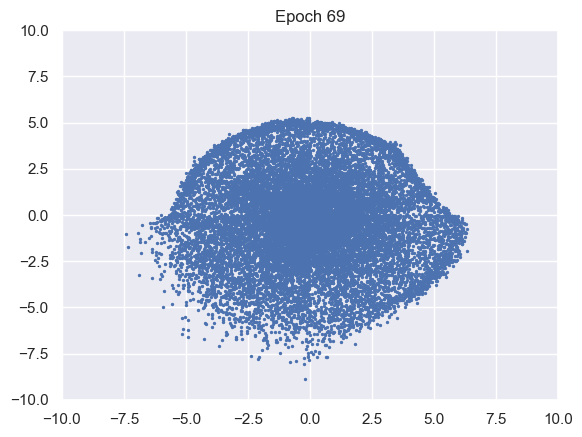

100%|██████████| 976/976 [00:10<00:00, 91.36it/s]


D loss : 1.3503, GP_loss : 0 G_loss : -0.7241, MI : 3.7501


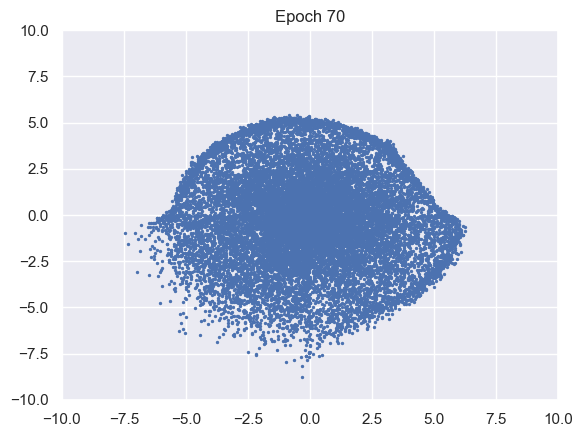

100%|██████████| 976/976 [00:10<00:00, 90.92it/s]


D loss : 1.3503, GP_loss : 0 G_loss : -0.7244, MI : 3.7561


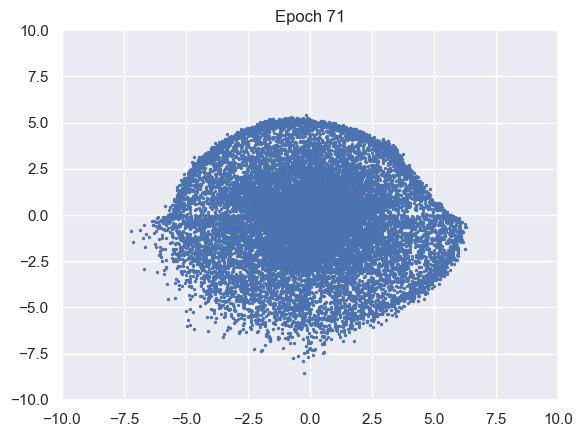

100%|██████████| 976/976 [00:11<00:00, 88.49it/s]


D loss : 1.3502, GP_loss : 0 G_loss : -0.7246, MI : 3.7623


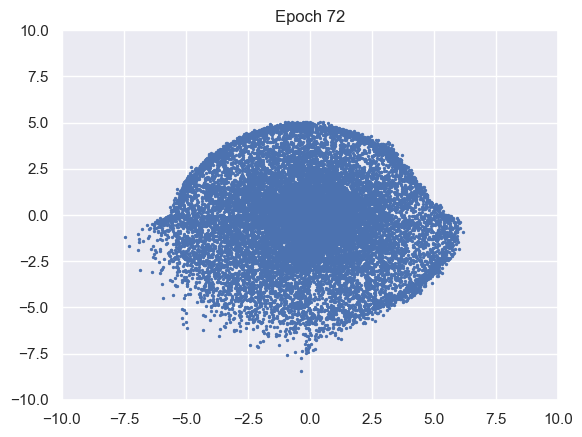

100%|██████████| 976/976 [00:10<00:00, 91.05it/s]


D loss : 1.3502, GP_loss : 0 G_loss : -0.7248, MI : 3.7698


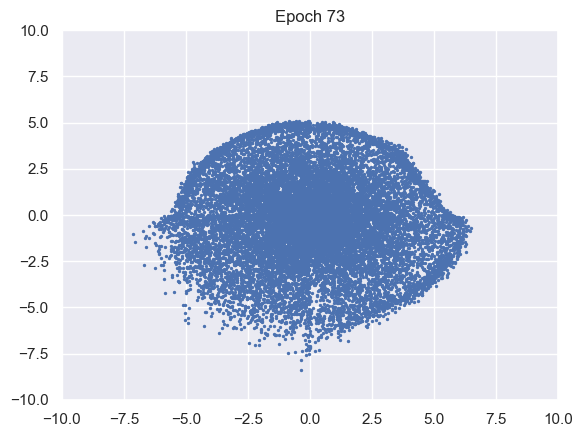

100%|██████████| 976/976 [00:10<00:00, 92.12it/s]


D loss : 1.3502, GP_loss : 0 G_loss : -0.725, MI : 3.7737


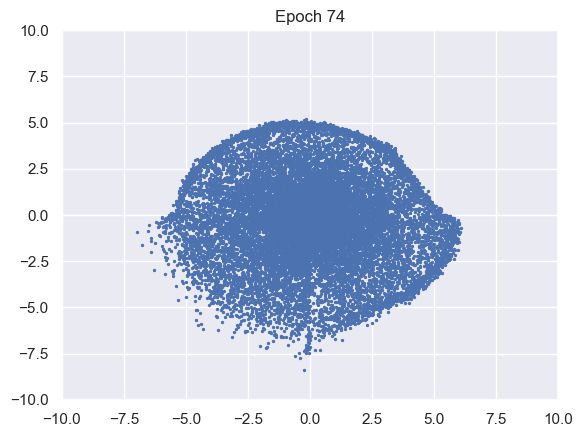

100%|██████████| 976/976 [00:10<00:00, 91.26it/s]


D loss : 1.3501, GP_loss : 0 G_loss : -0.7252, MI : 3.7804


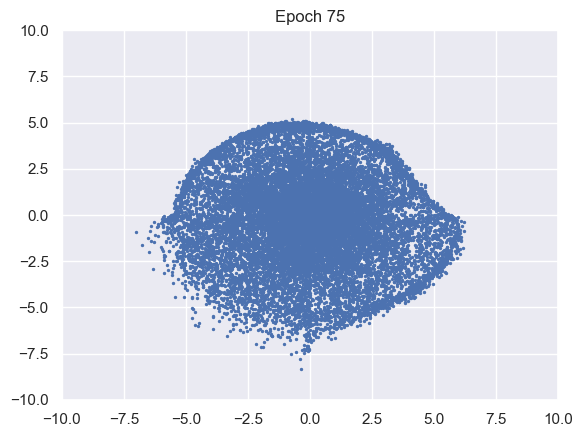

100%|██████████| 976/976 [00:10<00:00, 92.13it/s]


D loss : 1.3501, GP_loss : 0 G_loss : -0.7254, MI : 3.7865


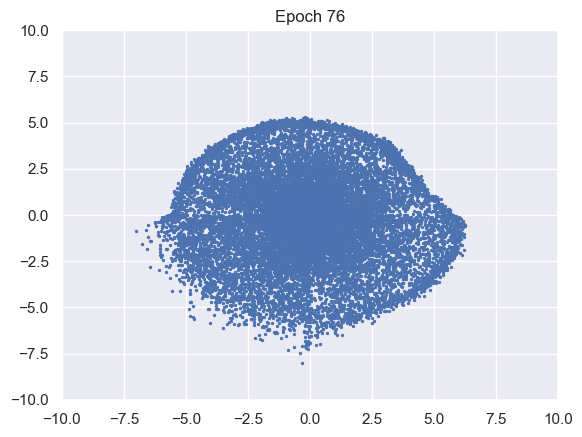

100%|██████████| 976/976 [00:10<00:00, 92.14it/s]


D loss : 1.3501, GP_loss : 0 G_loss : -0.7256, MI : 3.7933


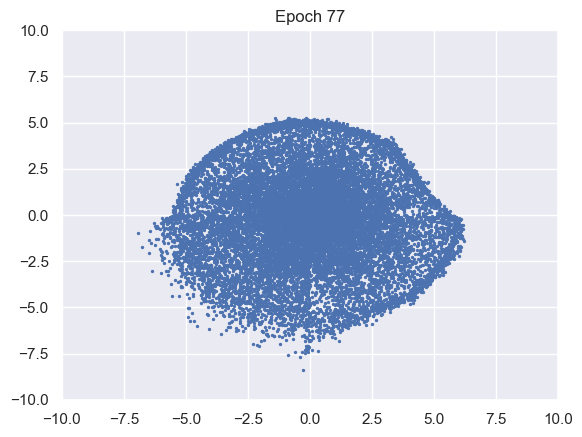

100%|██████████| 976/976 [00:10<00:00, 91.77it/s]


D loss : 1.3501, GP_loss : 0 G_loss : -0.7258, MI : 3.8


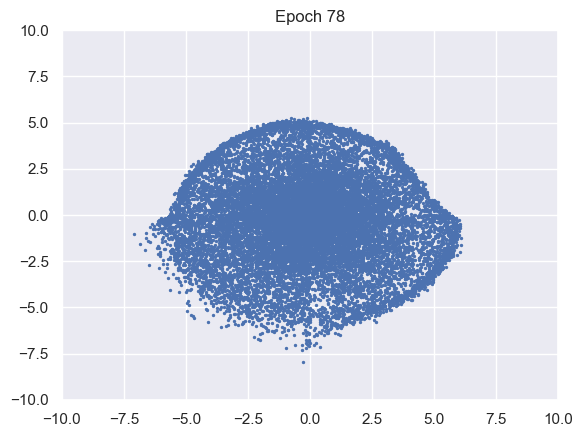

100%|██████████| 976/976 [00:10<00:00, 91.53it/s]


D loss : 1.3501, GP_loss : 0 G_loss : -0.726, MI : 3.8037


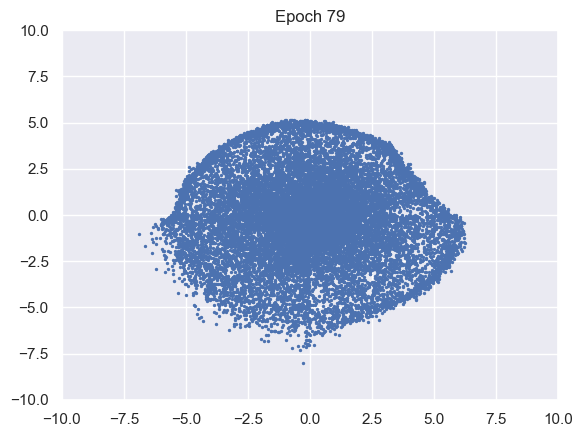

100%|██████████| 976/976 [00:11<00:00, 88.54it/s]


D loss : 1.3501, GP_loss : 0 G_loss : -0.7261, MI : 3.8103


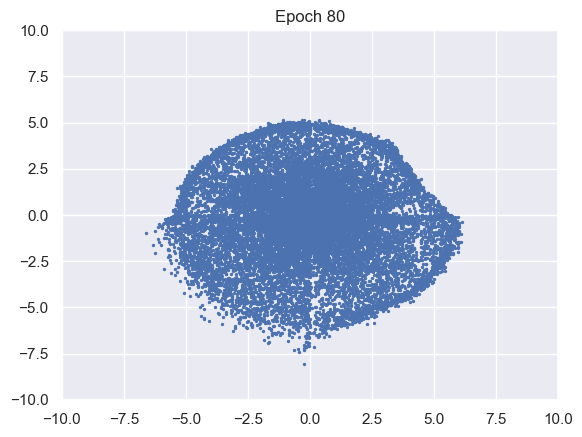

100%|██████████| 976/976 [00:10<00:00, 89.73it/s]


D loss : 1.3501, GP_loss : 0 G_loss : -0.7263, MI : 3.8156


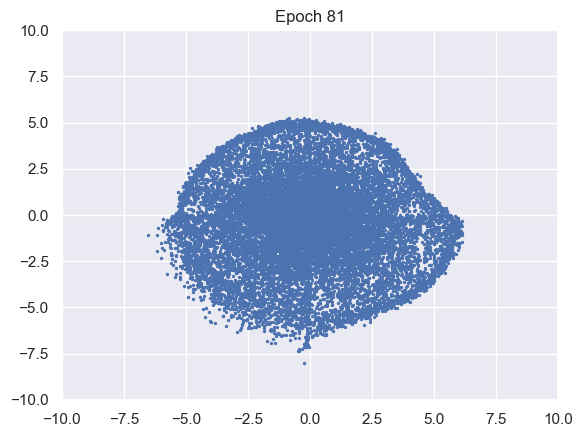

100%|██████████| 976/976 [00:10<00:00, 92.02it/s]


D loss : 1.3502, GP_loss : 0 G_loss : -0.7265, MI : 3.8214


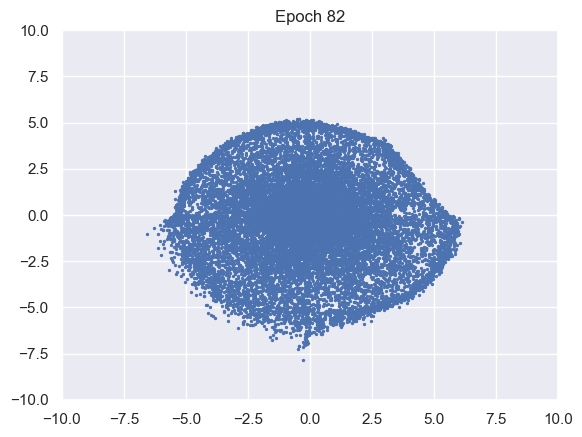

100%|██████████| 976/976 [00:10<00:00, 91.15it/s]


D loss : 1.3502, GP_loss : 0 G_loss : -0.7267, MI : 3.8262


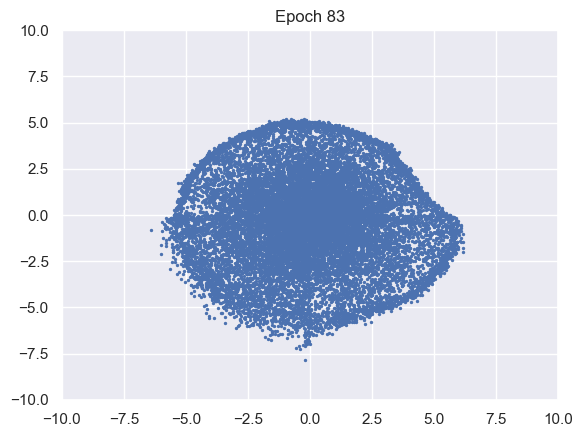

100%|██████████| 976/976 [03:55<00:00,  4.15it/s]  


D loss : 1.3502, GP_loss : 0 G_loss : -0.7269, MI : 3.8321


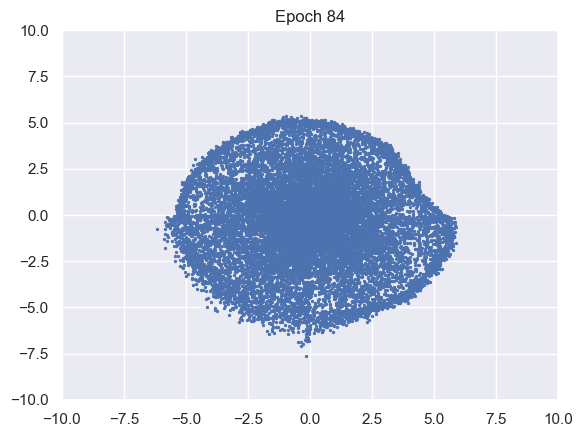

100%|██████████| 976/976 [00:10<00:00, 91.68it/s] 


D loss : 1.3502, GP_loss : 0 G_loss : -0.727, MI : 3.8376


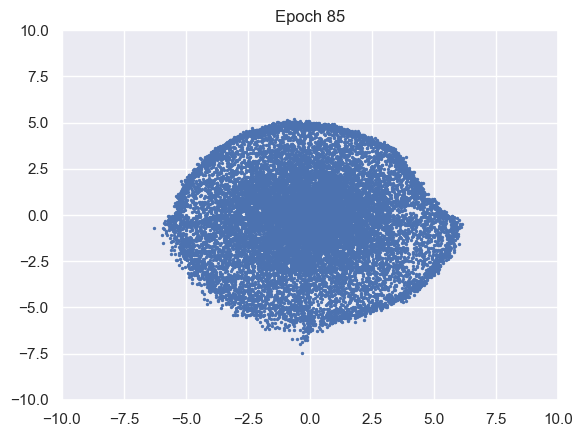

100%|██████████| 976/976 [00:11<00:00, 87.55it/s]


D loss : 1.3502, GP_loss : 0 G_loss : -0.7272, MI : 3.8418


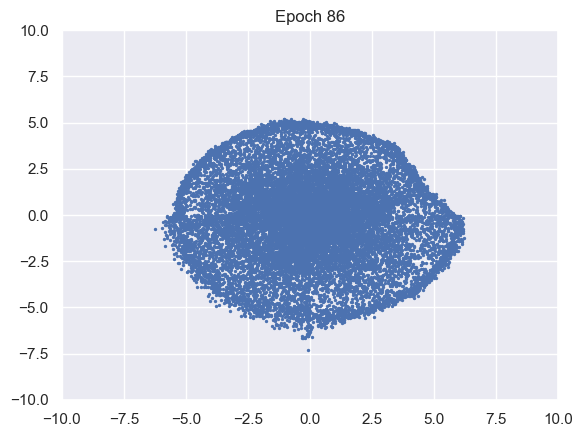

100%|██████████| 976/976 [00:11<00:00, 86.35it/s]


D loss : 1.3503, GP_loss : 0 G_loss : -0.7274, MI : 3.8485


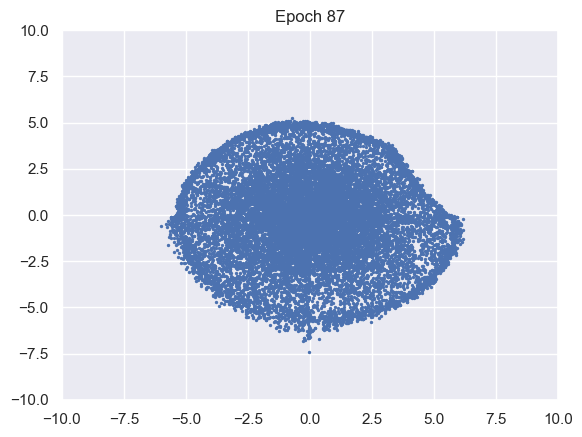

100%|██████████| 976/976 [00:10<00:00, 90.62it/s]


D loss : 1.3503, GP_loss : 0 G_loss : -0.7275, MI : 3.8525


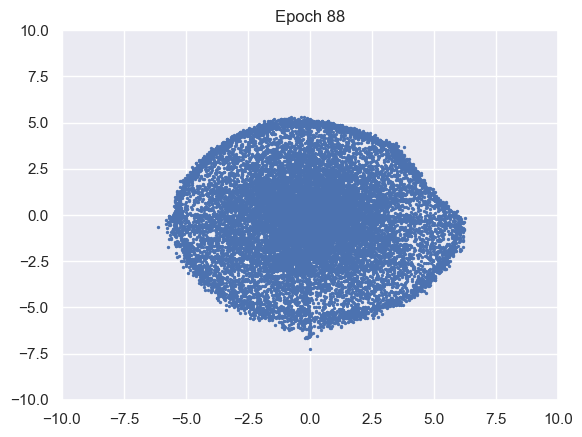

100%|██████████| 976/976 [00:10<00:00, 90.07it/s]


D loss : 1.3504, GP_loss : 0 G_loss : -0.7277, MI : 3.856


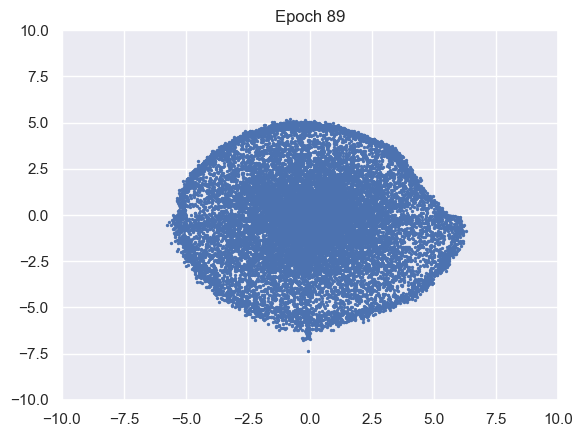

100%|██████████| 976/976 [00:10<00:00, 92.08it/s]


D loss : 1.3504, GP_loss : 0 G_loss : -0.7278, MI : 3.8614


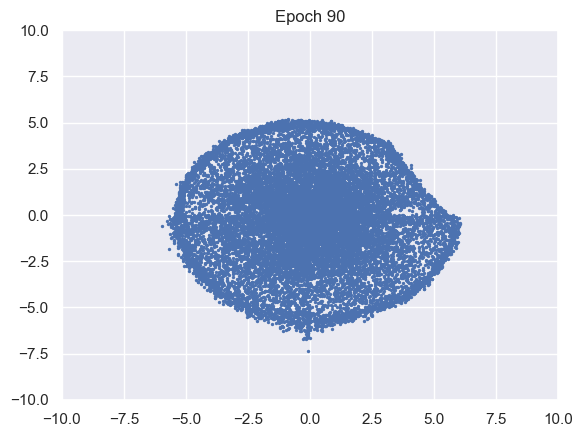

100%|██████████| 976/976 [00:10<00:00, 92.87it/s]


D loss : 1.3505, GP_loss : 0 G_loss : -0.728, MI : 3.8666


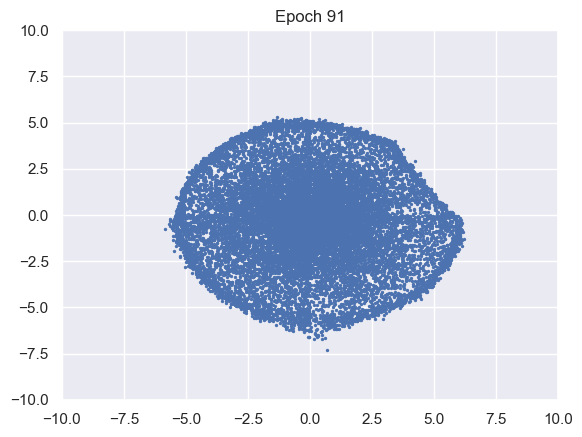

100%|██████████| 976/976 [00:10<00:00, 92.74it/s]


D loss : 1.3505, GP_loss : 0 G_loss : -0.7281, MI : 3.8717


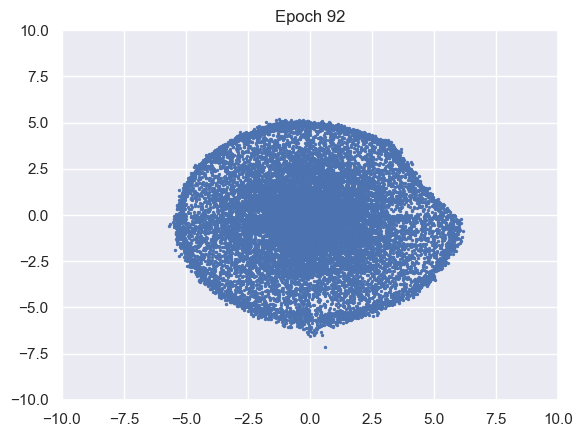

100%|██████████| 976/976 [00:10<00:00, 93.19it/s]


D loss : 1.3506, GP_loss : 0 G_loss : -0.7283, MI : 3.8758


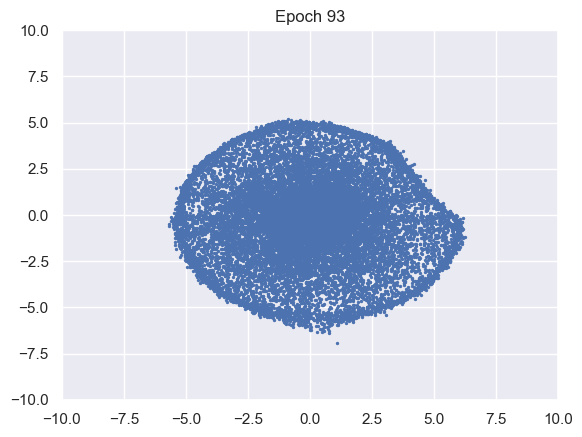

100%|██████████| 976/976 [00:10<00:00, 92.45it/s]


D loss : 1.3506, GP_loss : 0 G_loss : -0.7284, MI : 3.8806


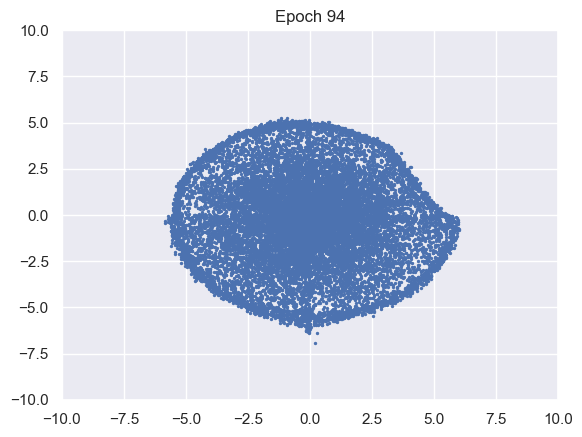

100%|██████████| 976/976 [00:10<00:00, 91.92it/s]


D loss : 1.3507, GP_loss : 0 G_loss : -0.7286, MI : 3.8858


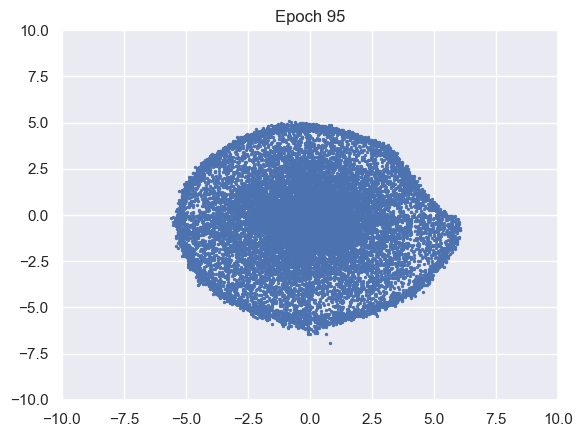

100%|██████████| 976/976 [00:10<00:00, 94.19it/s]


D loss : 1.3507, GP_loss : 0 G_loss : -0.7287, MI : 3.89


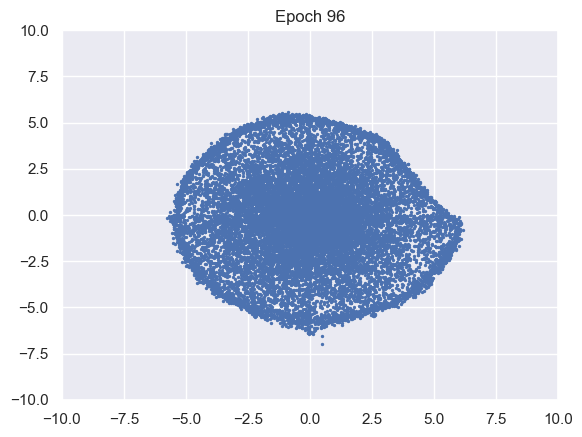

100%|██████████| 976/976 [00:10<00:00, 94.66it/s]


D loss : 1.3508, GP_loss : 0 G_loss : -0.7289, MI : 3.8952


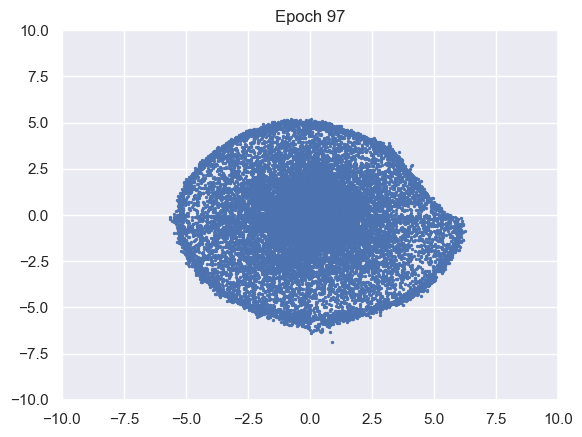

100%|██████████| 976/976 [00:10<00:00, 93.42it/s]


D loss : 1.3508, GP_loss : 0 G_loss : -0.729, MI : 3.9001


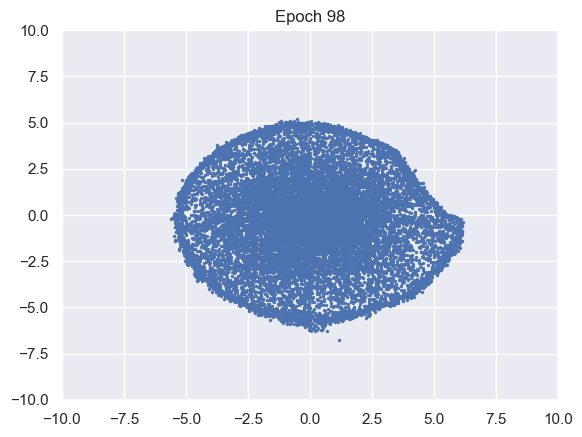

100%|██████████| 976/976 [00:10<00:00, 93.09it/s]


D loss : 1.3509, GP_loss : 0 G_loss : -0.7291, MI : 3.9039


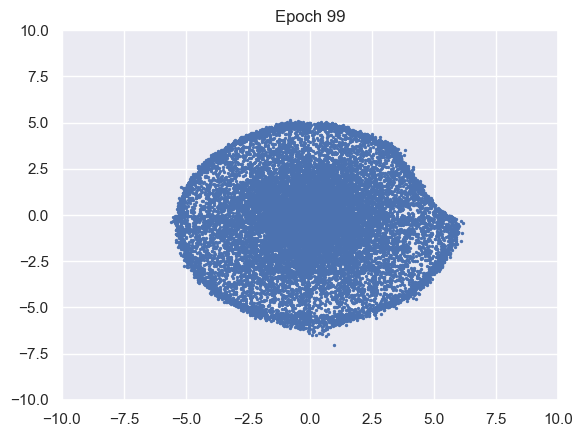

100%|██████████| 976/976 [00:10<00:00, 94.78it/s]


D loss : 1.3509, GP_loss : 0 G_loss : -0.7293, MI : 3.9086


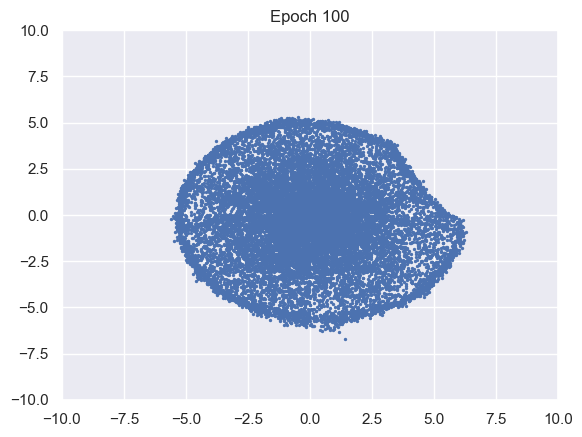

100%|██████████| 976/976 [00:10<00:00, 94.05it/s]


D loss : 1.3509, GP_loss : 0 G_loss : -0.7294, MI : 3.9121


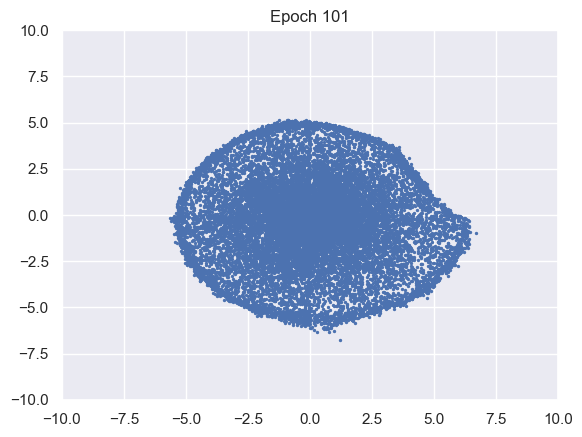

100%|██████████| 976/976 [00:10<00:00, 94.15it/s]


D loss : 1.351, GP_loss : 0 G_loss : -0.7296, MI : 3.9169


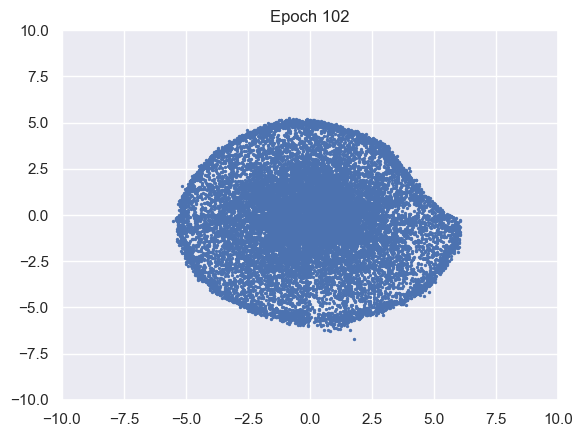

100%|██████████| 976/976 [00:10<00:00, 94.58it/s]


D loss : 1.351, GP_loss : 0 G_loss : -0.7297, MI : 3.9206


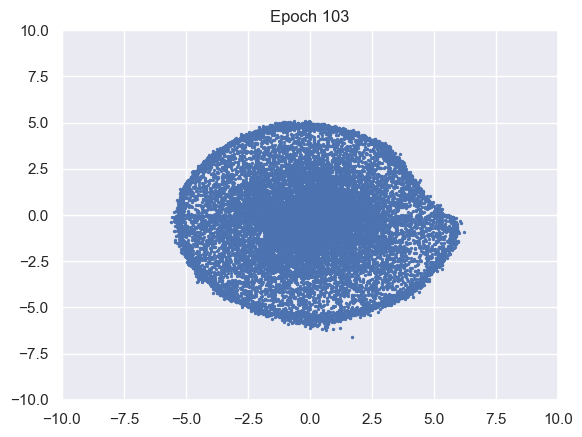

100%|██████████| 976/976 [00:10<00:00, 95.70it/s]


D loss : 1.351, GP_loss : 0 G_loss : -0.7299, MI : 3.9251


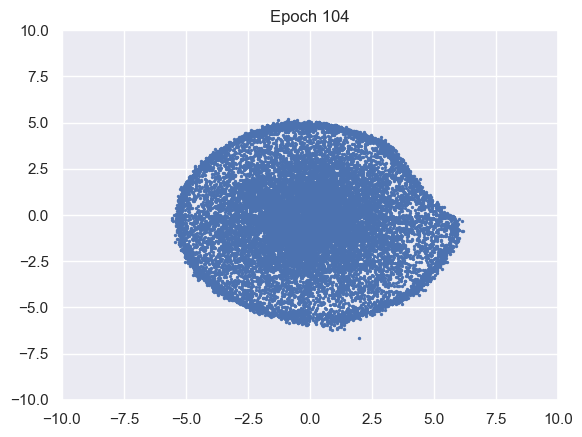

100%|██████████| 976/976 [00:10<00:00, 95.14it/s]


D loss : 1.351, GP_loss : 0 G_loss : -0.73, MI : 3.9303


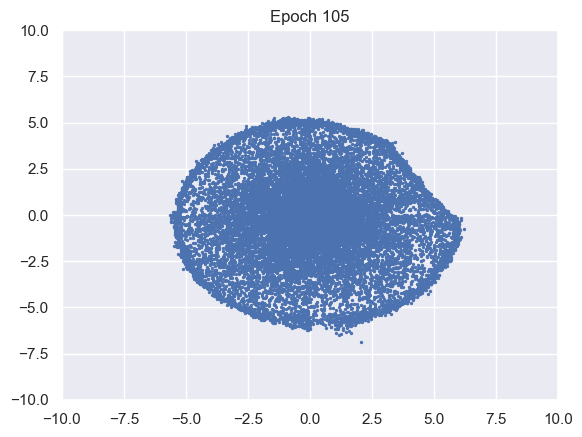

100%|██████████| 976/976 [00:10<00:00, 95.27it/s]


D loss : 1.3511, GP_loss : 0 G_loss : -0.7302, MI : 3.9349


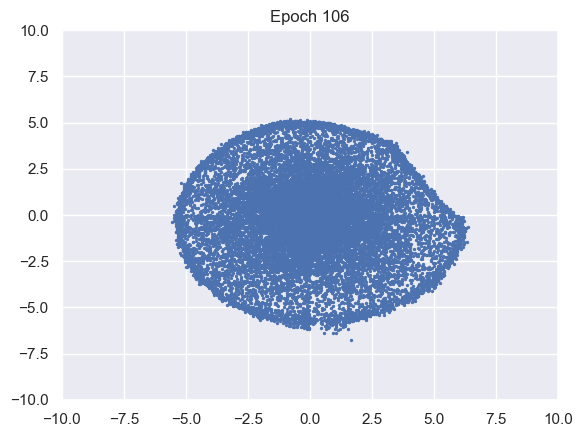

100%|██████████| 976/976 [00:10<00:00, 94.16it/s]


D loss : 1.3511, GP_loss : 0 G_loss : -0.7304, MI : 3.9393


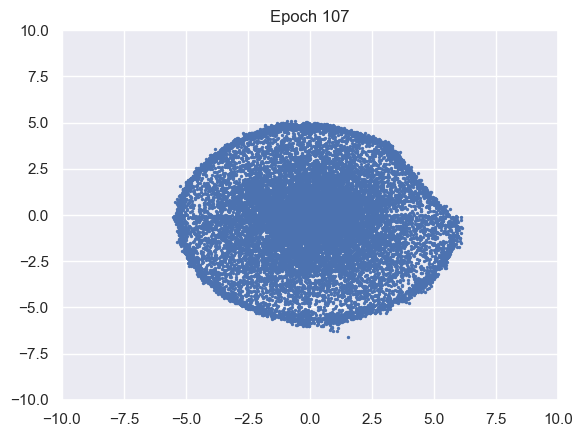

100%|██████████| 976/976 [00:10<00:00, 93.19it/s]


D loss : 1.3511, GP_loss : 0 G_loss : -0.7305, MI : 3.9443


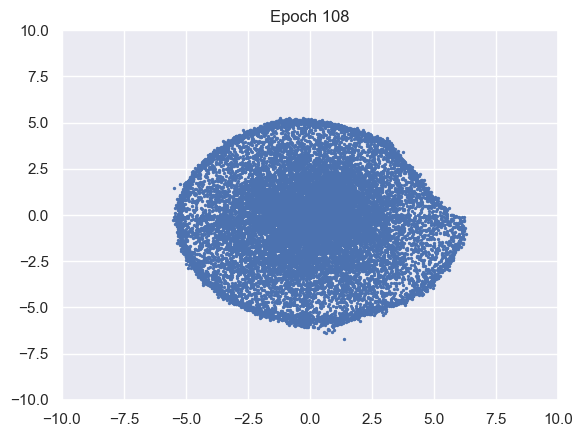

100%|██████████| 976/976 [00:10<00:00, 95.03it/s]


D loss : 1.3511, GP_loss : 0 G_loss : -0.7307, MI : 3.949


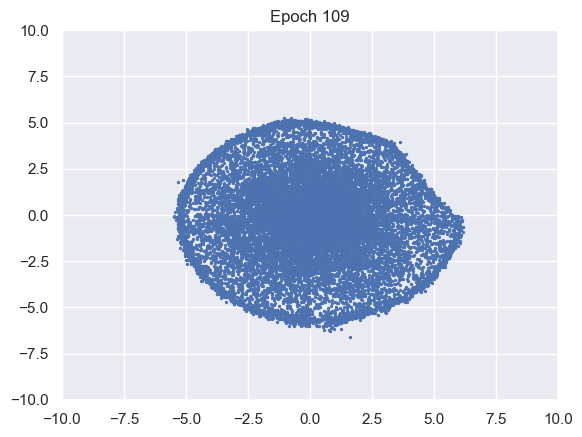

100%|██████████| 976/976 [00:10<00:00, 92.83it/s]


D loss : 1.3511, GP_loss : 0 G_loss : -0.7309, MI : 3.9539


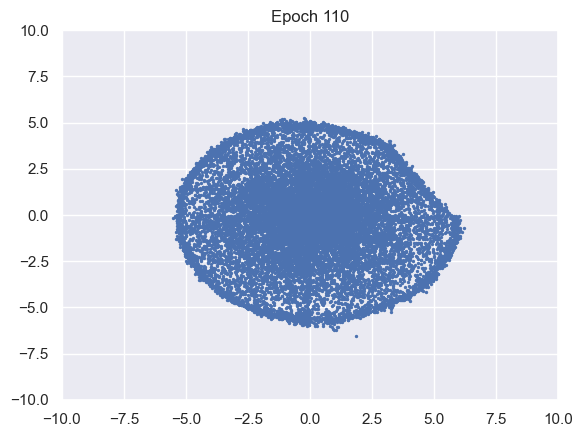

100%|██████████| 976/976 [00:10<00:00, 94.79it/s]


D loss : 1.3511, GP_loss : 0 G_loss : -0.7311, MI : 3.9575


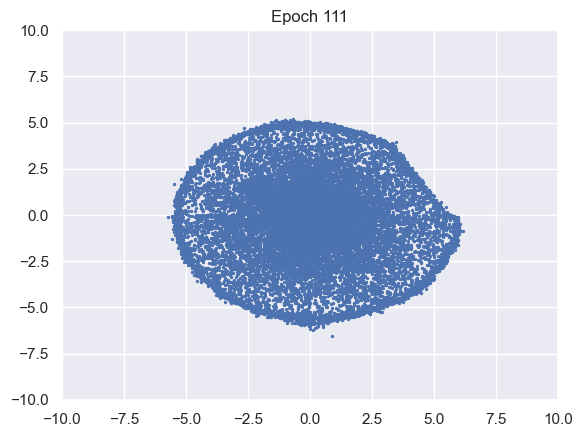

100%|██████████| 976/976 [00:10<00:00, 93.50it/s]


D loss : 1.3511, GP_loss : 0 G_loss : -0.7312, MI : 3.9616


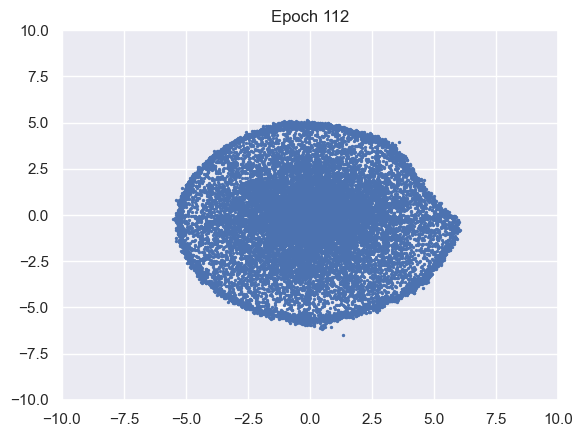

100%|██████████| 976/976 [00:10<00:00, 94.79it/s]


D loss : 1.3511, GP_loss : 0 G_loss : -0.7314, MI : 3.9671


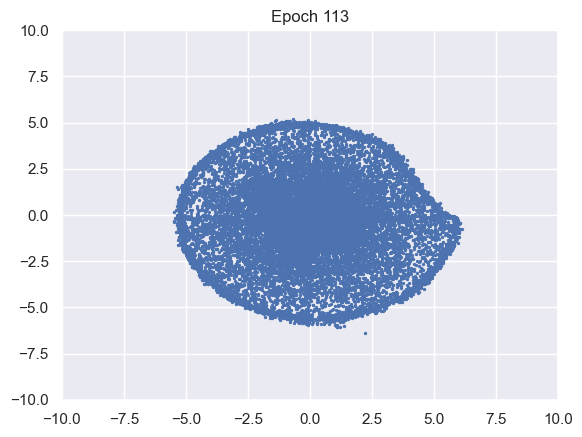

100%|██████████| 976/976 [00:10<00:00, 92.69it/s]


D loss : 1.3511, GP_loss : 0 G_loss : -0.7315, MI : 3.9691


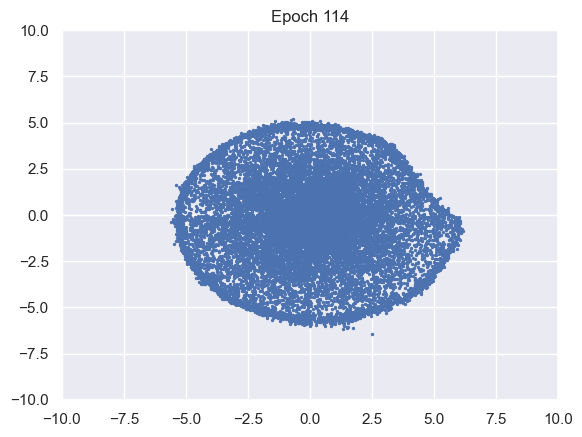

100%|██████████| 976/976 [00:10<00:00, 93.14it/s]


D loss : 1.351, GP_loss : 0 G_loss : -0.7317, MI : 3.9728


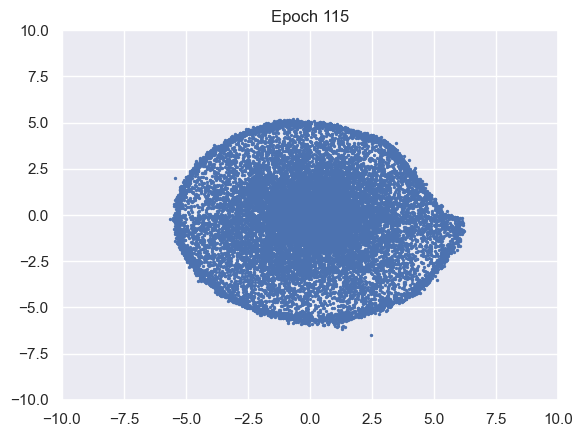

100%|██████████| 976/976 [00:10<00:00, 93.86it/s]


D loss : 1.351, GP_loss : 0 G_loss : -0.7319, MI : 3.9764


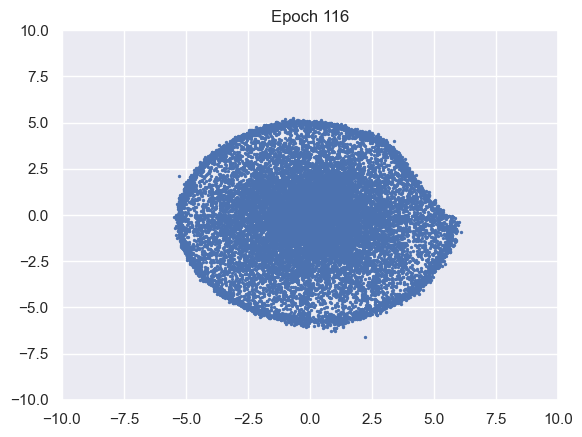

100%|██████████| 976/976 [00:10<00:00, 91.10it/s]


D loss : 1.351, GP_loss : 0 G_loss : -0.732, MI : 3.9795


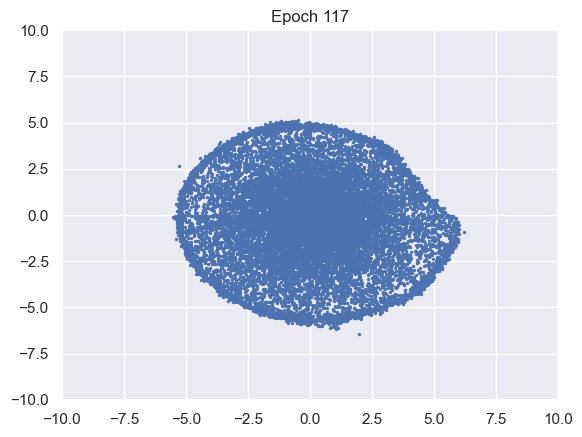

100%|██████████| 976/976 [00:10<00:00, 89.81it/s]


D loss : 1.351, GP_loss : 0 G_loss : -0.7322, MI : 3.9823


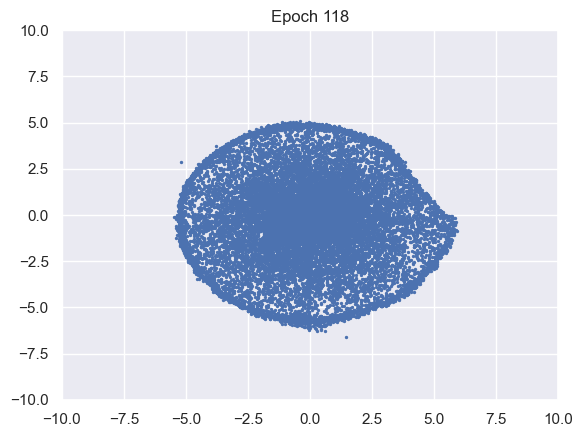

100%|██████████| 976/976 [00:10<00:00, 90.49it/s]


D loss : 1.351, GP_loss : 0 G_loss : -0.7324, MI : 3.9865


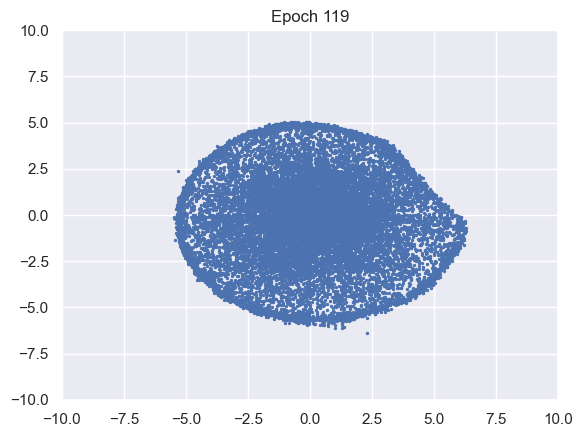

100%|██████████| 976/976 [00:10<00:00, 91.55it/s]


D loss : 1.351, GP_loss : 0 G_loss : -0.7325, MI : 3.9906


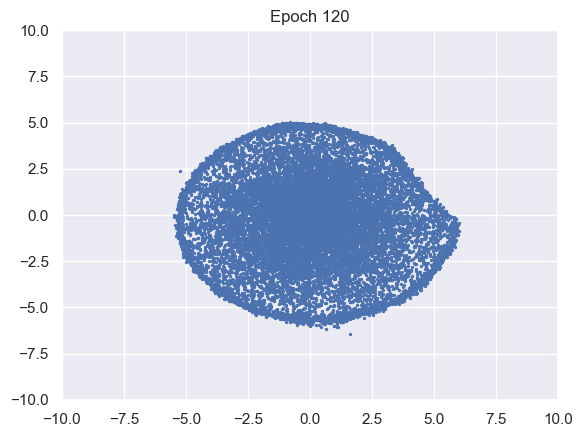

100%|██████████| 976/976 [00:10<00:00, 93.72it/s]


D loss : 1.3509, GP_loss : 0 G_loss : -0.7327, MI : 3.9914


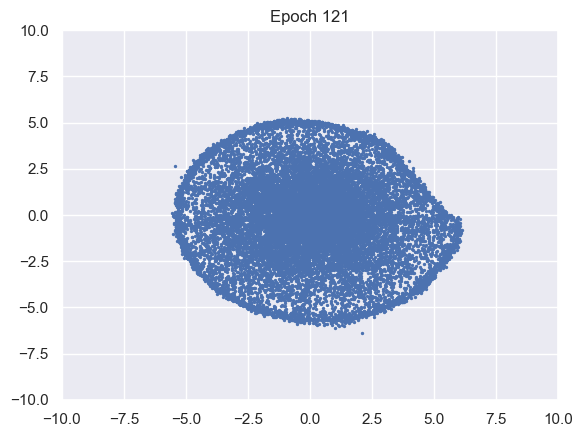

100%|██████████| 976/976 [00:10<00:00, 92.90it/s]


D loss : 1.3509, GP_loss : 0 G_loss : -0.7329, MI : 3.9943


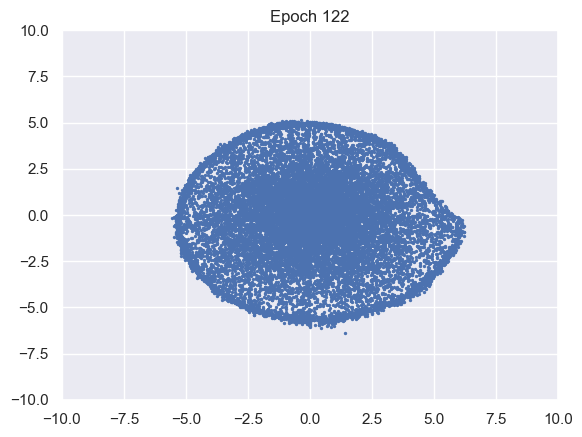

100%|██████████| 976/976 [00:10<00:00, 90.48it/s]


D loss : 1.3509, GP_loss : 0 G_loss : -0.7331, MI : 3.9989


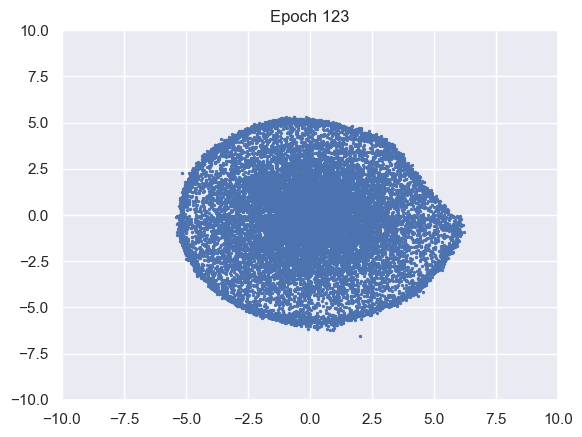

100%|██████████| 976/976 [00:10<00:00, 90.74it/s]


D loss : 1.3508, GP_loss : 0 G_loss : -0.7332, MI : 4.0023


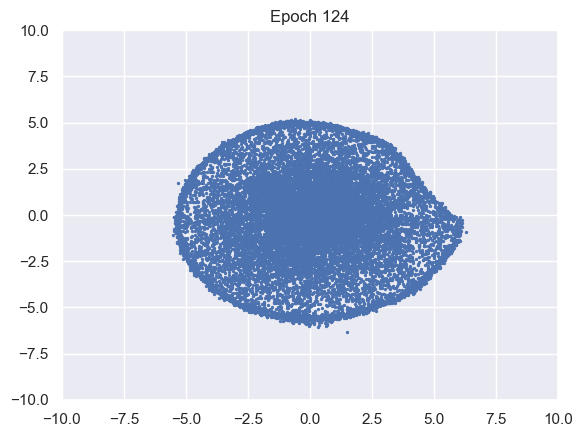

100%|██████████| 976/976 [00:10<00:00, 91.58it/s]


D loss : 1.3508, GP_loss : 0 G_loss : -0.7334, MI : 4.0068


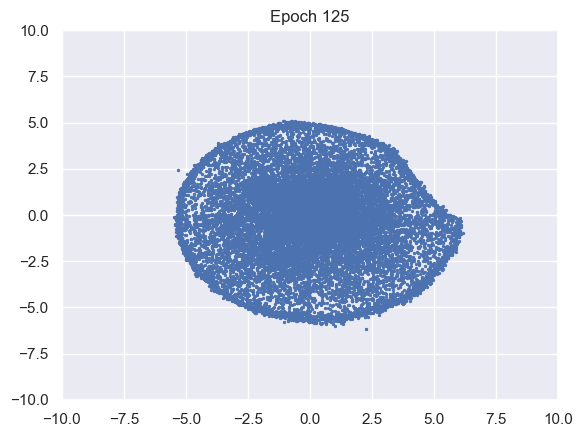

100%|██████████| 976/976 [00:10<00:00, 92.81it/s]


D loss : 1.3508, GP_loss : 0 G_loss : -0.7336, MI : 4.0097


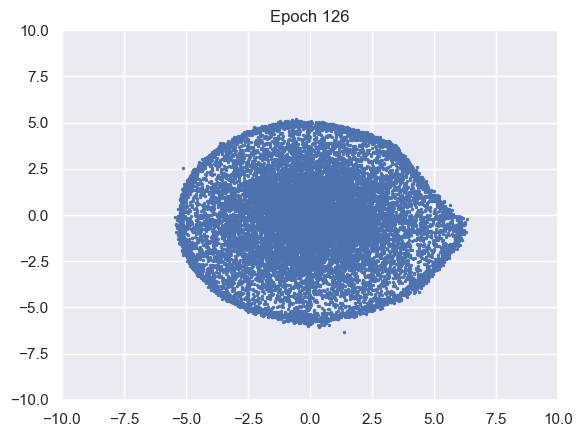

100%|██████████| 976/976 [00:10<00:00, 92.39it/s]


D loss : 1.3507, GP_loss : 0 G_loss : -0.7338, MI : 4.0139


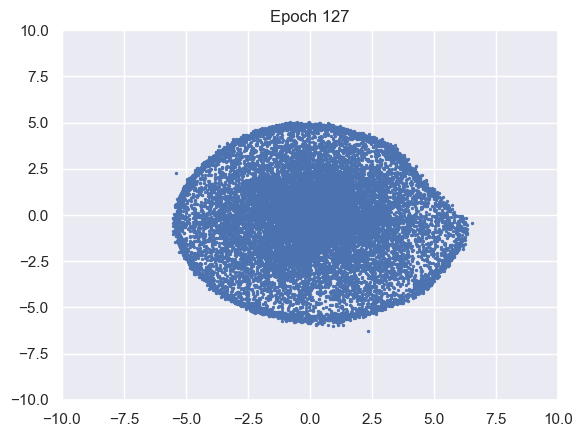

100%|██████████| 976/976 [00:10<00:00, 93.13it/s]


D loss : 1.3506, GP_loss : 0 G_loss : -0.734, MI : 4.017


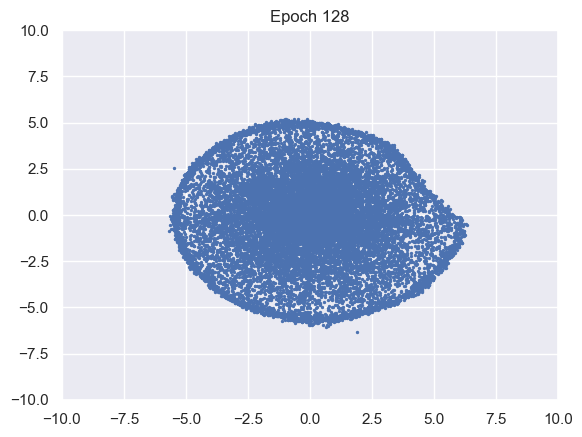

100%|██████████| 976/976 [00:10<00:00, 92.50it/s]


D loss : 1.3506, GP_loss : 0 G_loss : -0.7341, MI : 4.0217


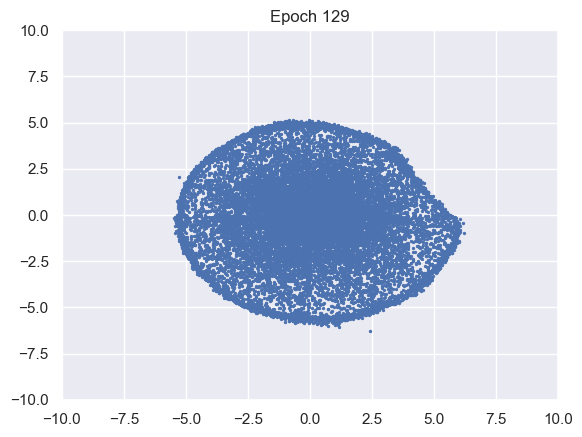

100%|██████████| 976/976 [00:10<00:00, 92.75it/s]


D loss : 1.3505, GP_loss : 0 G_loss : -0.7343, MI : 4.0241


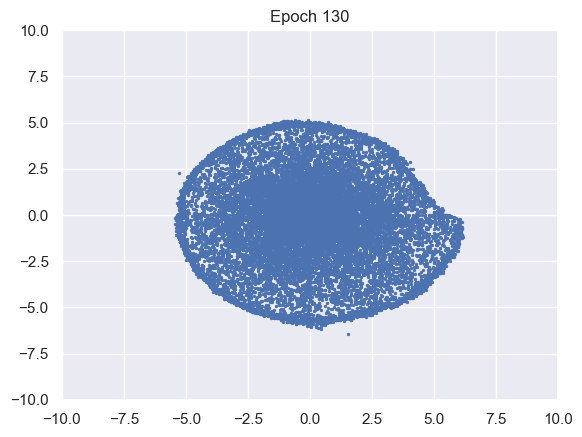

100%|██████████| 976/976 [00:10<00:00, 92.06it/s]


D loss : 1.3504, GP_loss : 0 G_loss : -0.7345, MI : 4.028


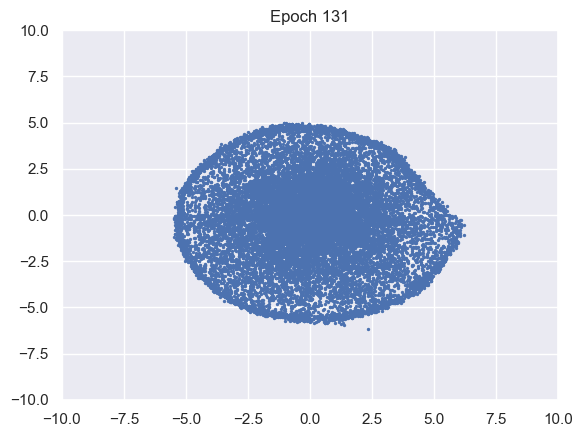

100%|██████████| 976/976 [00:10<00:00, 91.48it/s]


D loss : 1.3504, GP_loss : 0 G_loss : -0.7347, MI : 4.0321


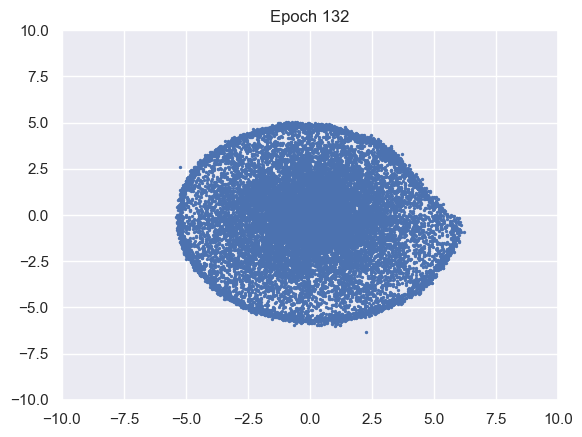

100%|██████████| 976/976 [00:10<00:00, 91.83it/s]


D loss : 1.3503, GP_loss : 0 G_loss : -0.7349, MI : 4.0353


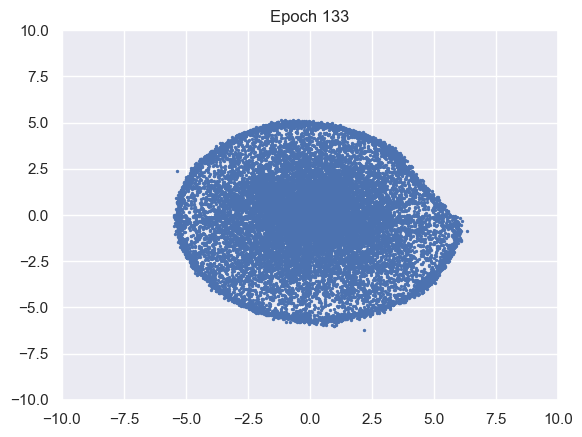

100%|██████████| 976/976 [00:10<00:00, 91.72it/s]


D loss : 1.3502, GP_loss : 0 G_loss : -0.7351, MI : 4.0389


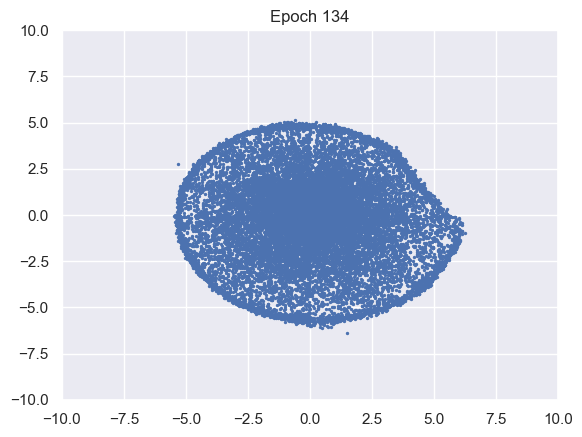

100%|██████████| 976/976 [00:10<00:00, 91.24it/s]


D loss : 1.3501, GP_loss : 0 G_loss : -0.7353, MI : 4.0425


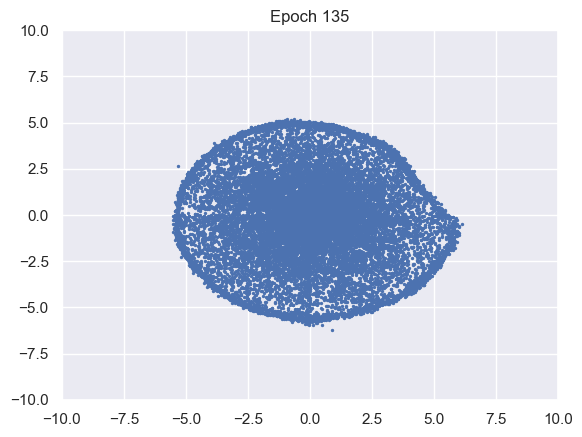

100%|██████████| 976/976 [00:10<00:00, 93.59it/s]


D loss : 1.35, GP_loss : 0 G_loss : -0.7354, MI : 4.0465


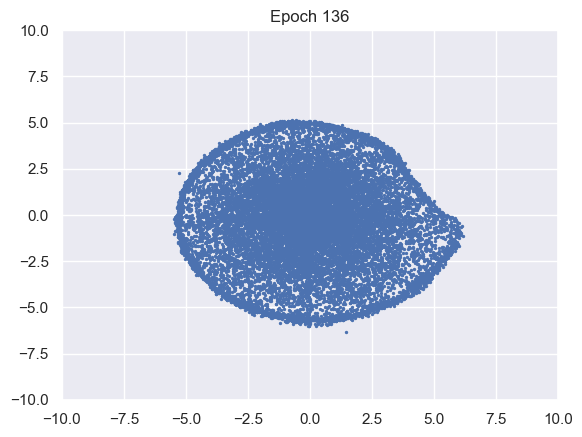

100%|██████████| 976/976 [00:10<00:00, 94.20it/s]


D loss : 1.3499, GP_loss : 0 G_loss : -0.7356, MI : 4.0506


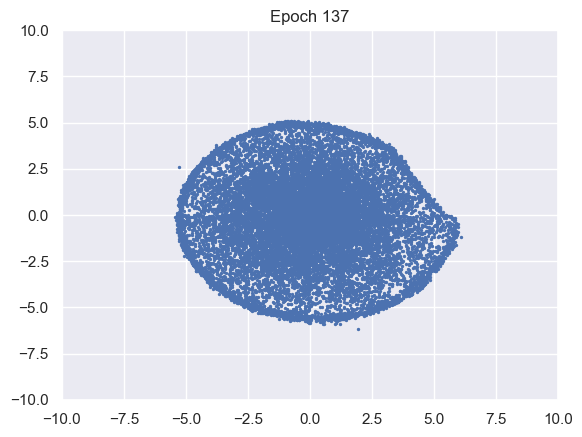

100%|██████████| 976/976 [00:10<00:00, 94.33it/s]


D loss : 1.3498, GP_loss : 0 G_loss : -0.7358, MI : 4.0535


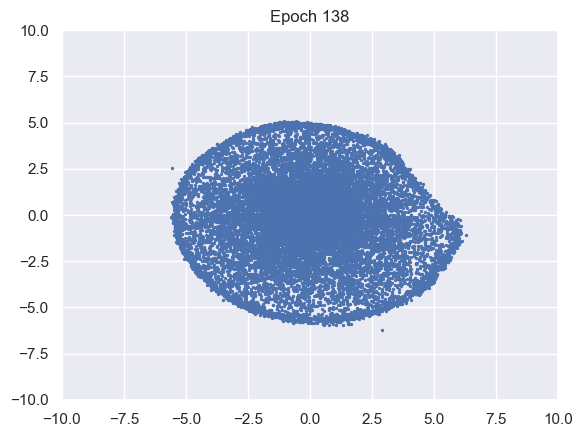

100%|██████████| 976/976 [00:10<00:00, 93.64it/s]


D loss : 1.3497, GP_loss : 0 G_loss : -0.736, MI : 4.0573


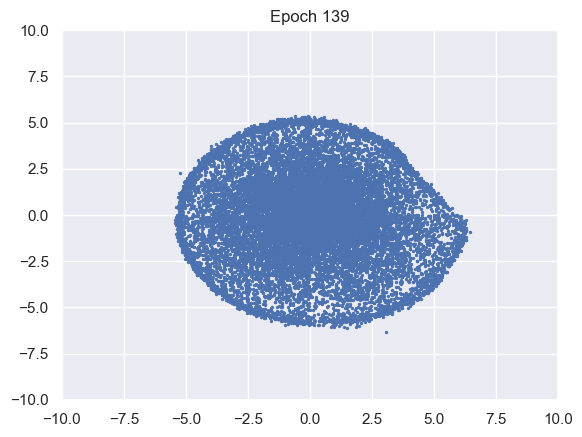

100%|██████████| 976/976 [00:10<00:00, 92.65it/s]


D loss : 1.3496, GP_loss : 0 G_loss : -0.7362, MI : 4.0605


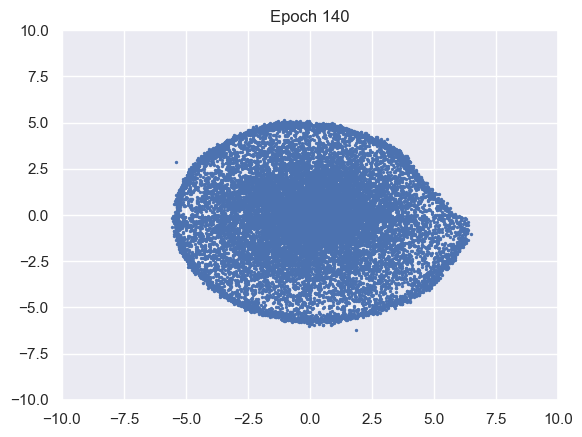

100%|██████████| 976/976 [00:10<00:00, 94.16it/s]


D loss : 1.3495, GP_loss : 0 G_loss : -0.7364, MI : 4.0515


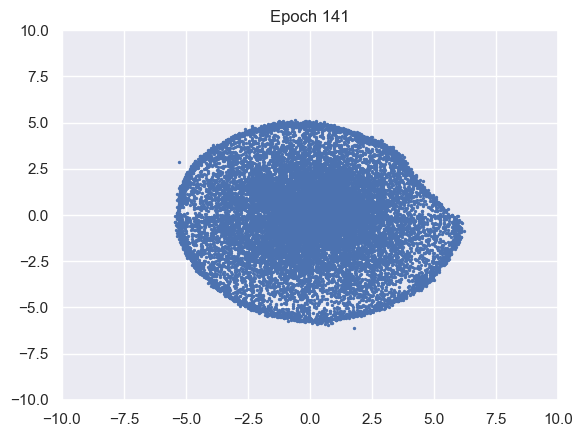

100%|██████████| 976/976 [00:10<00:00, 93.81it/s]


D loss : 1.3494, GP_loss : 0 G_loss : -0.7366, MI : 4.0558


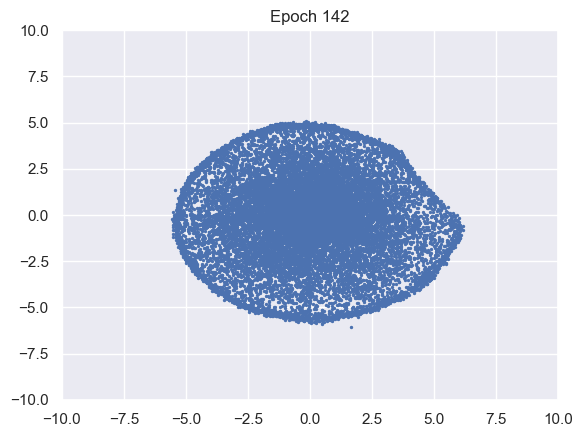

100%|██████████| 976/976 [00:10<00:00, 93.29it/s]


D loss : 1.3493, GP_loss : 0 G_loss : -0.7368, MI : 4.0595


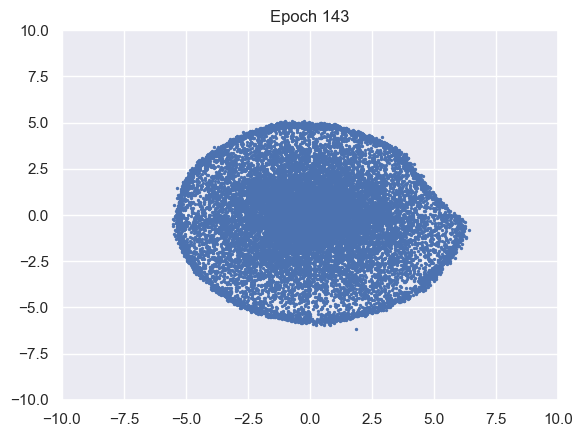

100%|██████████| 976/976 [00:10<00:00, 94.05it/s]


D loss : 1.3492, GP_loss : 0 G_loss : -0.7369, MI : 4.064


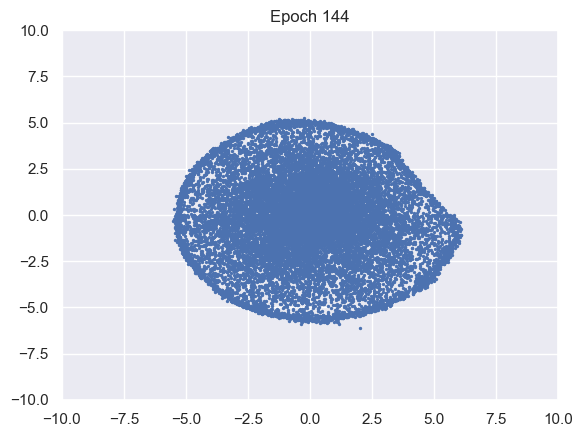

100%|██████████| 976/976 [00:10<00:00, 94.06it/s]


D loss : 1.3491, GP_loss : 0 G_loss : -0.7371, MI : 4.0675


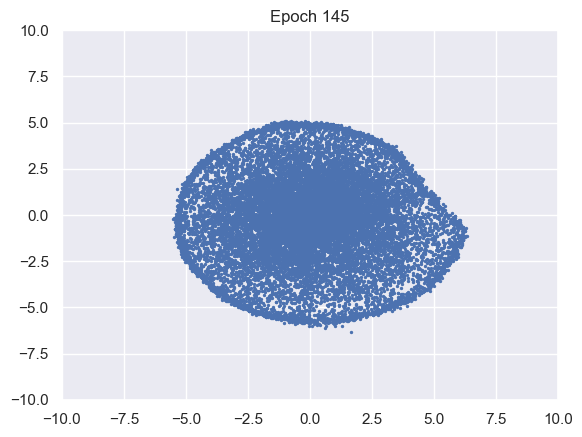

100%|██████████| 976/976 [00:10<00:00, 93.49it/s]


D loss : 1.349, GP_loss : 0 G_loss : -0.7373, MI : 4.0706


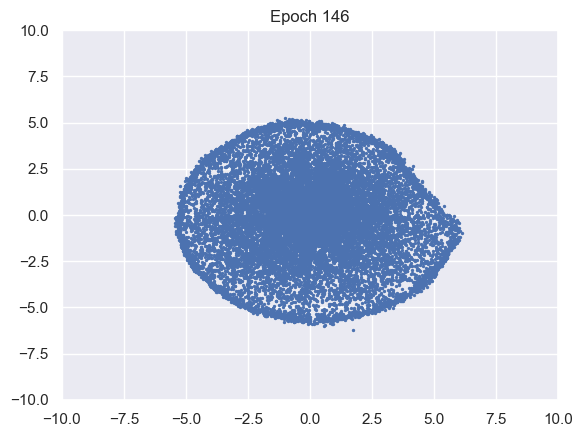

100%|██████████| 976/976 [00:10<00:00, 95.17it/s]


D loss : 1.3488, GP_loss : 0 G_loss : -0.7375, MI : 4.0738


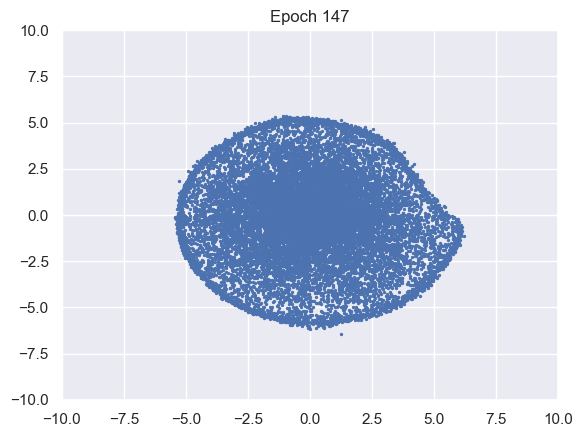

100%|██████████| 976/976 [00:10<00:00, 89.69it/s]


D loss : 1.3487, GP_loss : 0 G_loss : -0.7377, MI : 4.0764


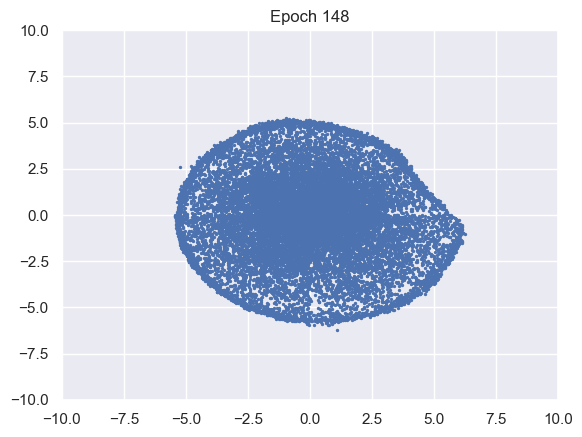

100%|██████████| 976/976 [00:10<00:00, 90.73it/s]


D loss : 1.3486, GP_loss : 0 G_loss : -0.7379, MI : 4.0785


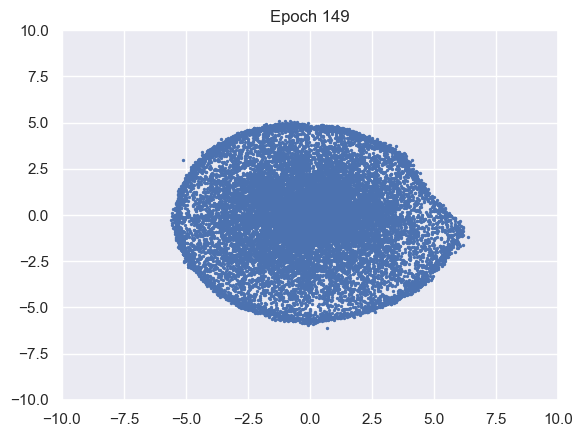

100%|██████████| 976/976 [00:10<00:00, 91.06it/s]


D loss : 1.3485, GP_loss : 0 G_loss : -0.7381, MI : 4.0826


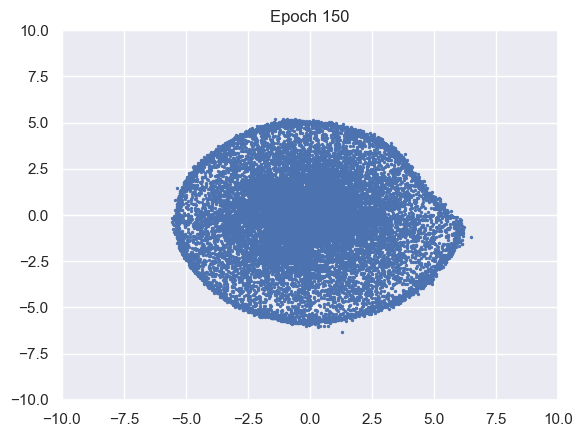

100%|██████████| 976/976 [00:10<00:00, 90.25it/s]


D loss : 1.3484, GP_loss : 0 G_loss : -0.7383, MI : 4.0862


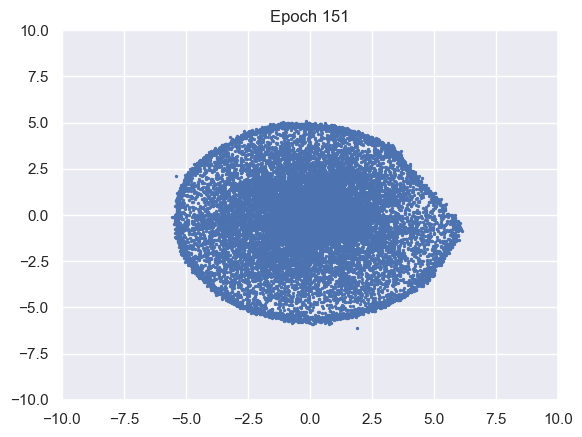

100%|██████████| 976/976 [00:10<00:00, 90.51it/s]


D loss : 1.3482, GP_loss : 0 G_loss : -0.7384, MI : 4.0892


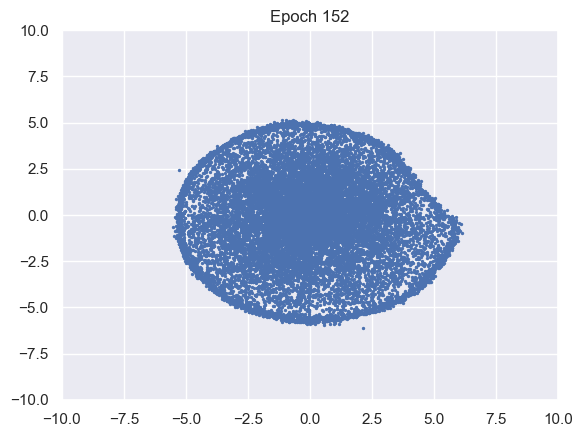

100%|██████████| 976/976 [00:10<00:00, 90.23it/s]


D loss : 1.3481, GP_loss : 0 G_loss : -0.7386, MI : 4.0918


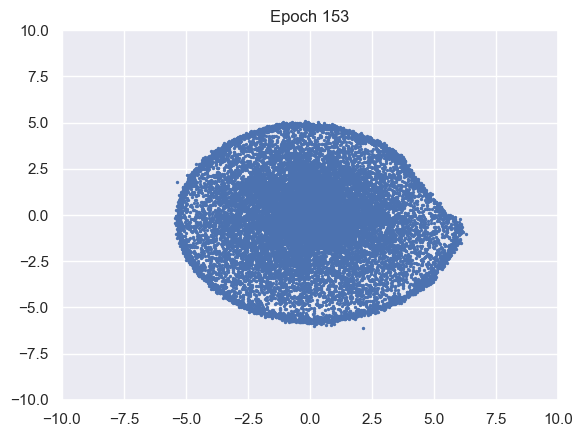

100%|██████████| 976/976 [00:10<00:00, 91.23it/s]


D loss : 1.348, GP_loss : 0 G_loss : -0.7388, MI : 4.0958


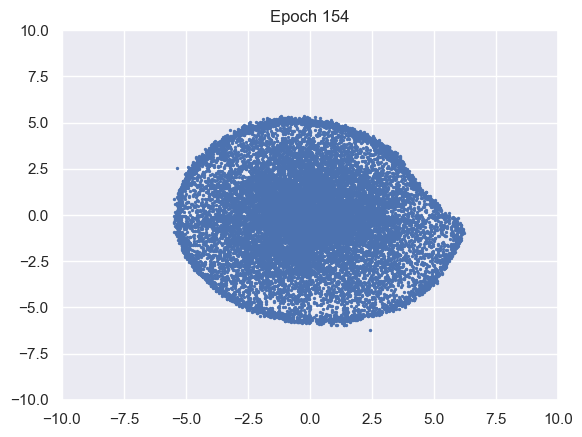

100%|██████████| 976/976 [00:10<00:00, 91.35it/s]


D loss : 1.3479, GP_loss : 0 G_loss : -0.739, MI : 4.0986


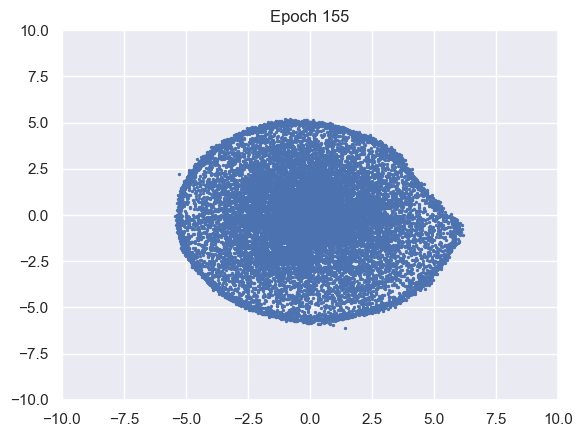

100%|██████████| 976/976 [00:10<00:00, 93.43it/s]


D loss : 1.3478, GP_loss : 0 G_loss : -0.7391, MI : 4.1019


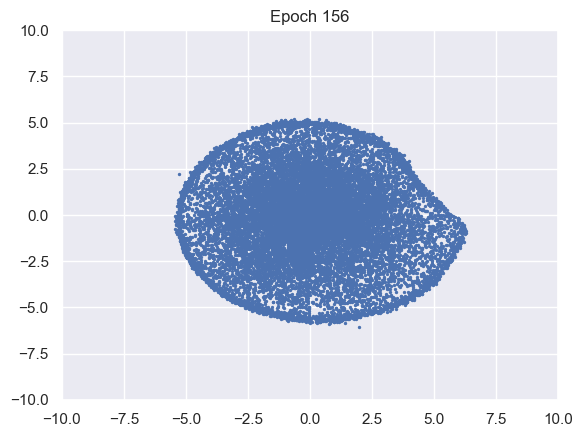

100%|██████████| 976/976 [00:10<00:00, 92.88it/s]


D loss : 1.3477, GP_loss : 0 G_loss : -0.7393, MI : 4.1046


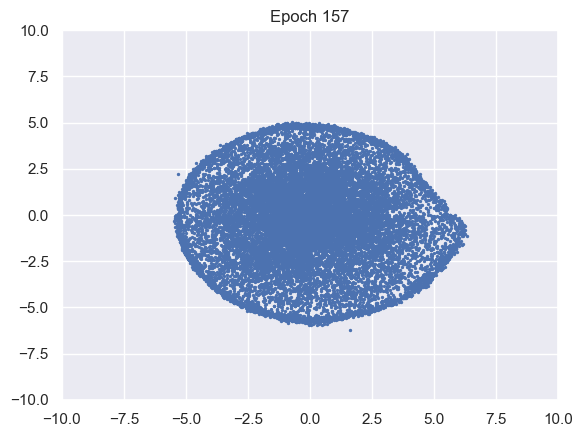

100%|██████████| 976/976 [00:10<00:00, 93.27it/s]


D loss : 1.3475, GP_loss : 0 G_loss : -0.7395, MI : 4.1083


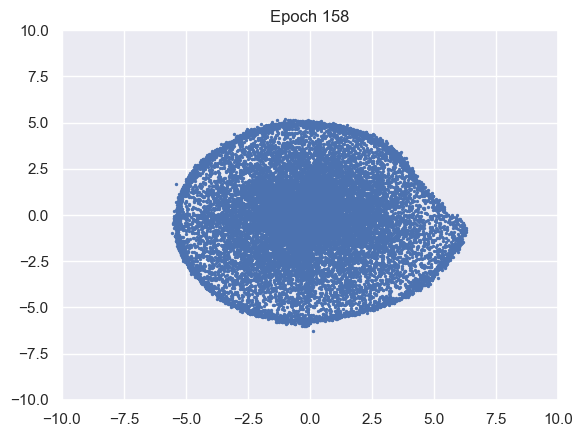

100%|██████████| 976/976 [00:10<00:00, 91.11it/s]


D loss : 1.3474, GP_loss : 0 G_loss : -0.7397, MI : 4.1117


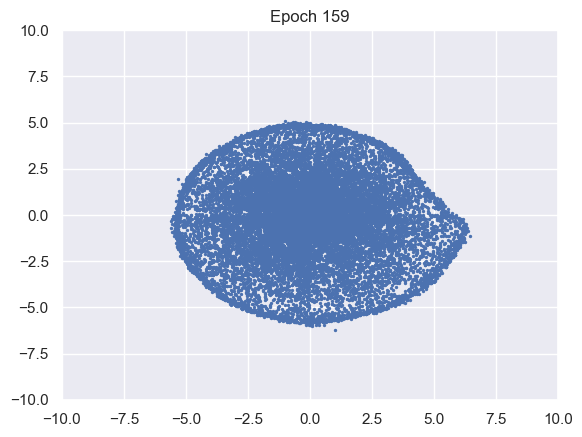

100%|██████████| 976/976 [00:10<00:00, 91.84it/s]


D loss : 1.3473, GP_loss : 0 G_loss : -0.7398, MI : 4.1145


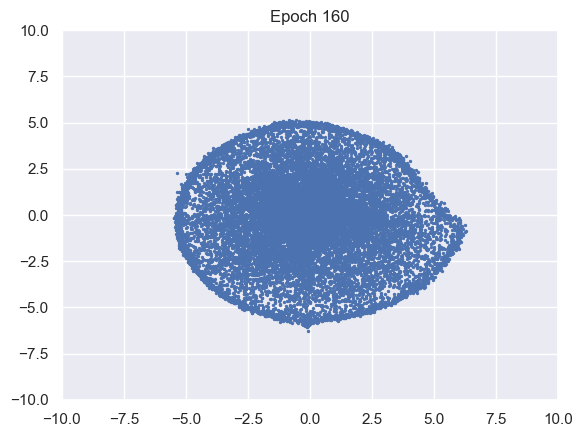

100%|██████████| 976/976 [00:10<00:00, 90.98it/s]


D loss : 1.3472, GP_loss : 0 G_loss : -0.74, MI : 4.1161


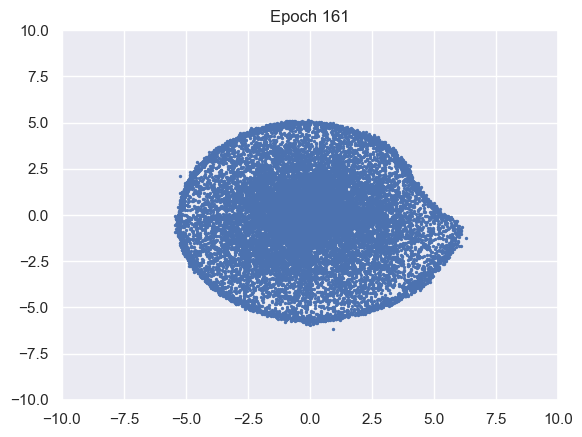

100%|██████████| 976/976 [00:10<00:00, 88.79it/s]


D loss : 1.3471, GP_loss : 0 G_loss : -0.7401, MI : 4.1172


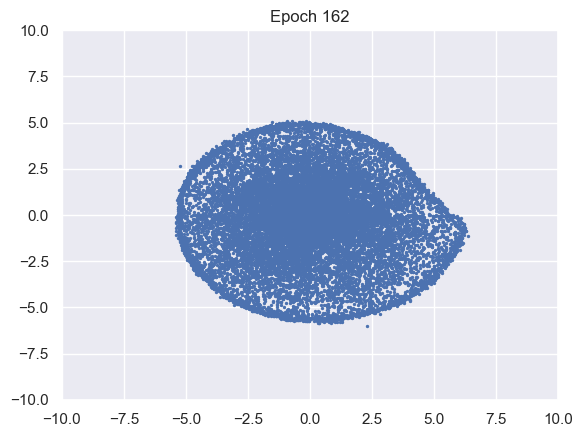

100%|██████████| 976/976 [00:10<00:00, 89.97it/s]


D loss : 1.347, GP_loss : 0 G_loss : -0.7403, MI : 4.1209


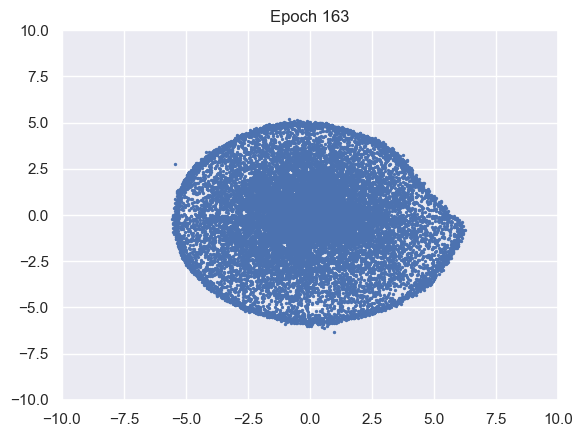

100%|██████████| 976/976 [00:10<00:00, 90.65it/s]


D loss : 1.3469, GP_loss : 0 G_loss : -0.7405, MI : 4.1242


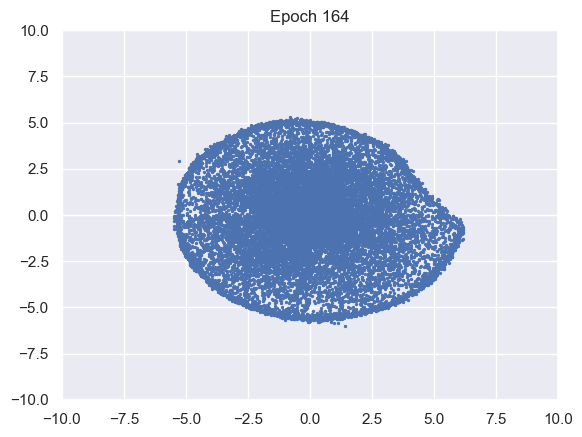

100%|██████████| 976/976 [00:10<00:00, 90.65it/s]


D loss : 1.3468, GP_loss : 0 G_loss : -0.7406, MI : 4.1277


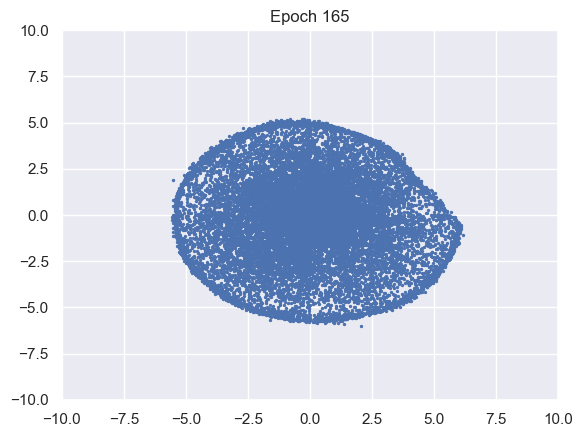

100%|██████████| 976/976 [00:10<00:00, 93.66it/s]


D loss : 1.3466, GP_loss : 0 G_loss : -0.7408, MI : 4.1305


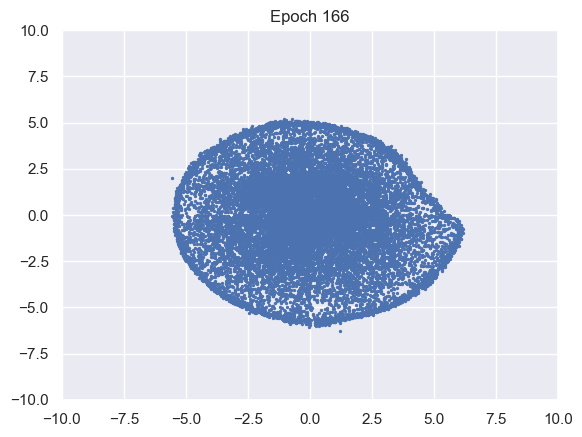

100%|██████████| 976/976 [00:10<00:00, 92.61it/s]


D loss : 1.3465, GP_loss : 0 G_loss : -0.741, MI : 4.1333


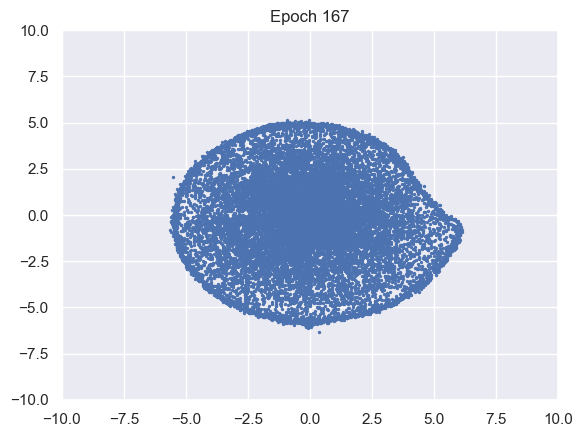

100%|██████████| 976/976 [00:10<00:00, 93.66it/s]


D loss : 1.3464, GP_loss : 0 G_loss : -0.7411, MI : 4.1355


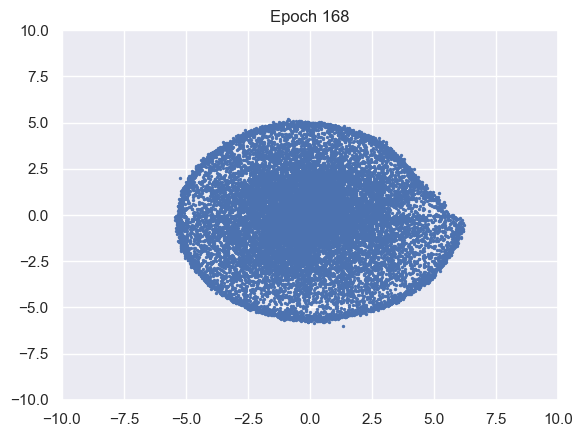

100%|██████████| 976/976 [00:10<00:00, 92.38it/s]


D loss : 1.3463, GP_loss : 0 G_loss : -0.7413, MI : 4.139


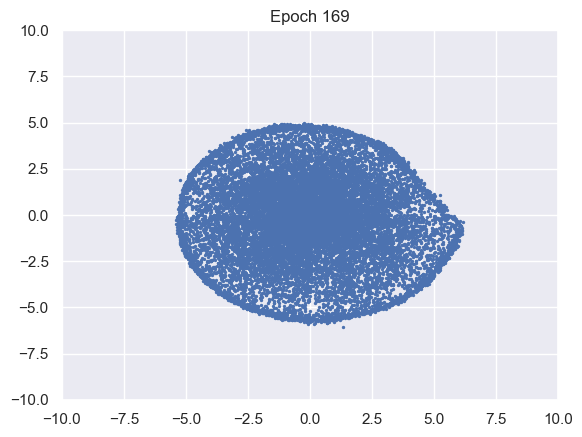

100%|██████████| 976/976 [00:10<00:00, 92.88it/s]


D loss : 1.3462, GP_loss : 0 G_loss : -0.7414, MI : 4.1415


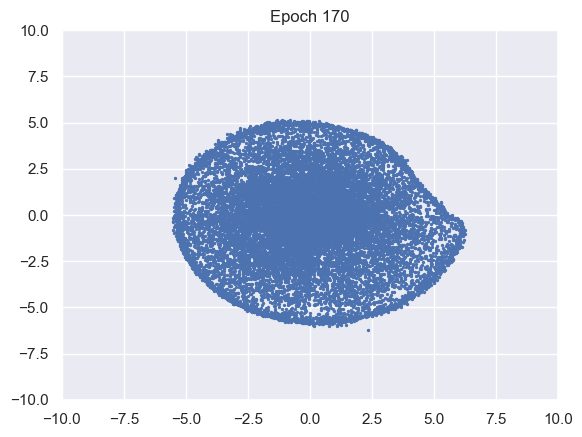

100%|██████████| 976/976 [00:10<00:00, 93.04it/s]


D loss : 1.3461, GP_loss : 0 G_loss : -0.7416, MI : 4.1438


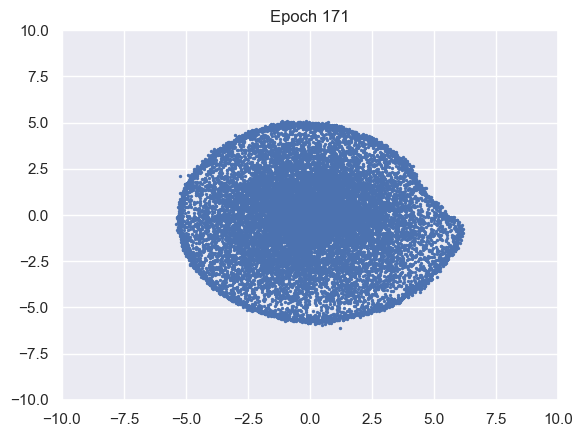

100%|██████████| 976/976 [00:10<00:00, 91.77it/s]


D loss : 1.346, GP_loss : 0 G_loss : -0.7417, MI : 4.1468


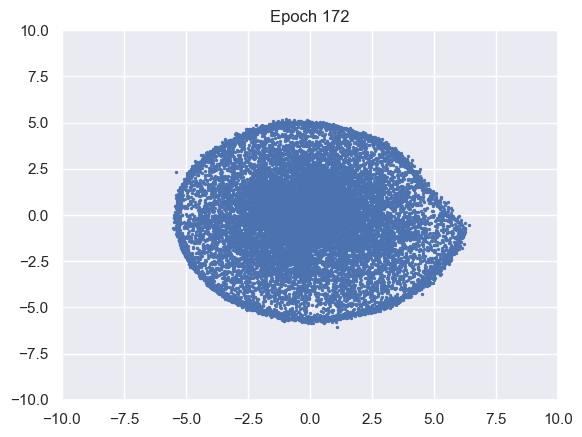

100%|██████████| 976/976 [00:10<00:00, 92.56it/s]


D loss : 1.3458, GP_loss : 0 G_loss : -0.7419, MI : 4.1491


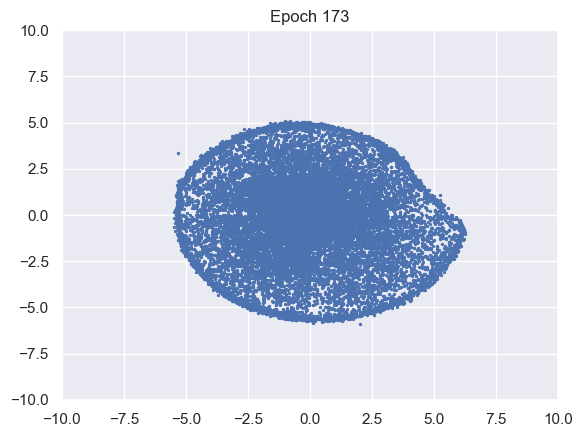

100%|██████████| 976/976 [00:10<00:00, 93.92it/s]


D loss : 1.3457, GP_loss : 0 G_loss : -0.742, MI : 4.1514


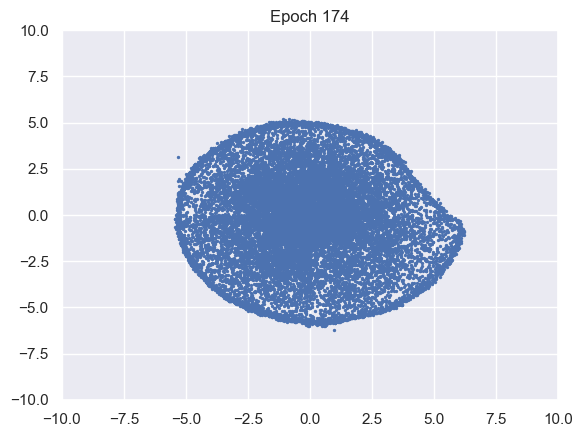

100%|██████████| 976/976 [00:10<00:00, 92.83it/s]


D loss : 1.3456, GP_loss : 0 G_loss : -0.7422, MI : 4.1541


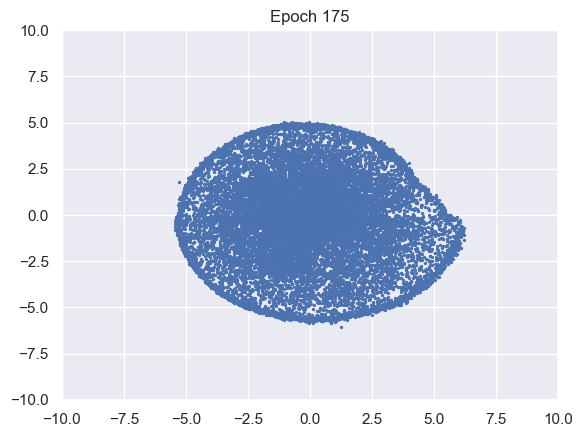

100%|██████████| 976/976 [00:10<00:00, 91.00it/s]


D loss : 1.3455, GP_loss : 0 G_loss : -0.7423, MI : 4.1556


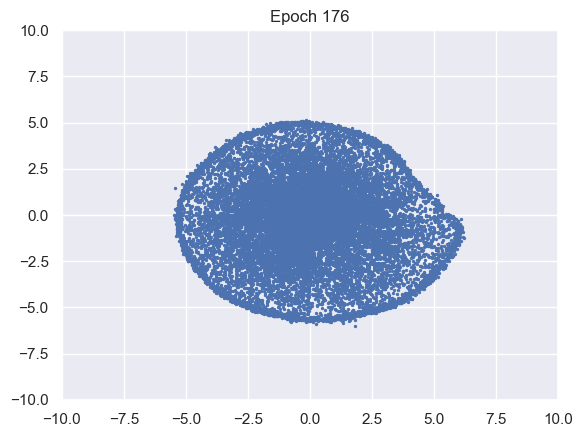

100%|██████████| 976/976 [00:10<00:00, 92.73it/s]


D loss : 1.3454, GP_loss : 0 G_loss : -0.7425, MI : 4.1577


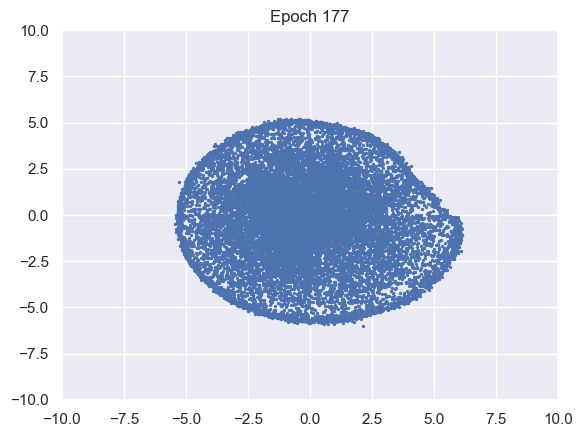

100%|██████████| 976/976 [00:10<00:00, 92.26it/s]


D loss : 1.3453, GP_loss : 0 G_loss : -0.7426, MI : 4.1609


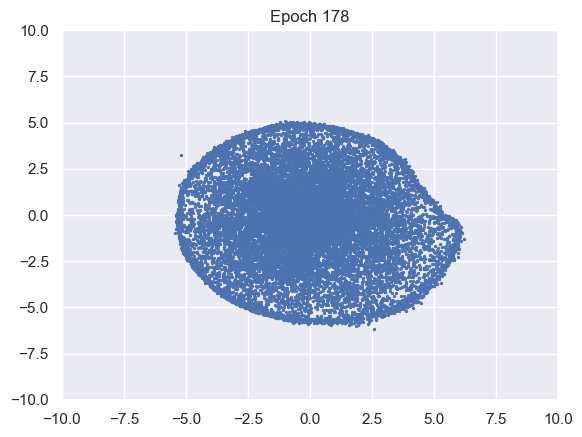

100%|██████████| 976/976 [00:10<00:00, 92.77it/s]


D loss : 1.3452, GP_loss : 0 G_loss : -0.7428, MI : 4.1637


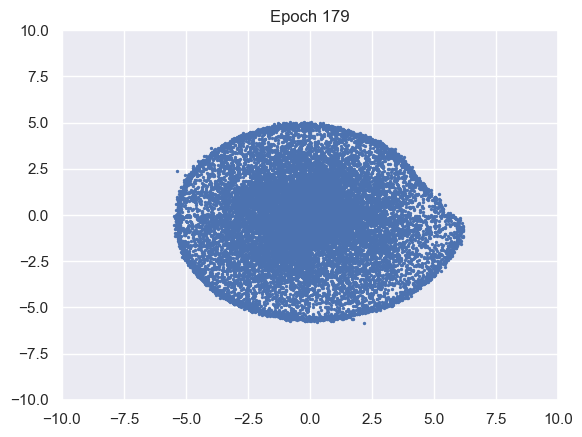

100%|██████████| 976/976 [00:10<00:00, 92.05it/s]


D loss : 1.3451, GP_loss : 0 G_loss : -0.7429, MI : 4.1659


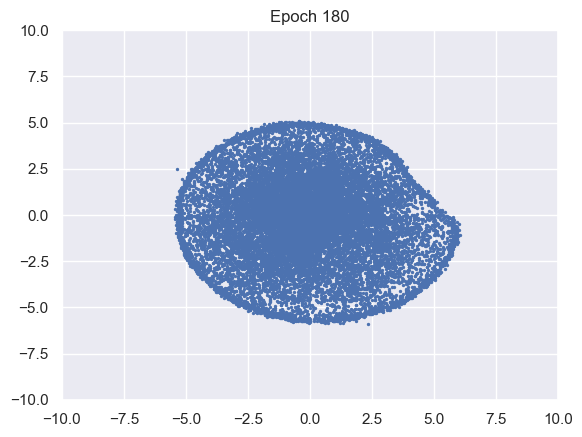

100%|██████████| 976/976 [00:10<00:00, 91.50it/s]


D loss : 1.345, GP_loss : 0 G_loss : -0.7431, MI : 4.1687


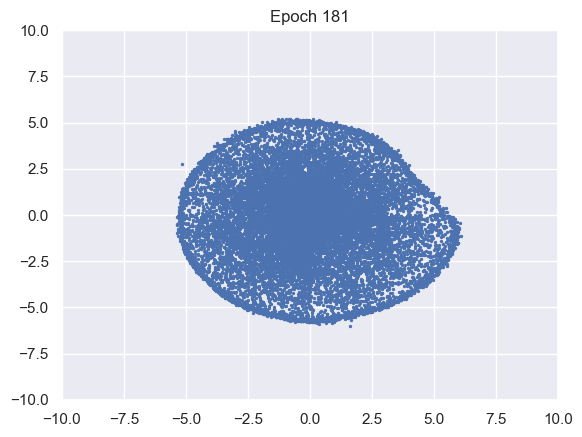

100%|██████████| 976/976 [00:10<00:00, 93.89it/s]


D loss : 1.3449, GP_loss : 0 G_loss : -0.7432, MI : 4.1716


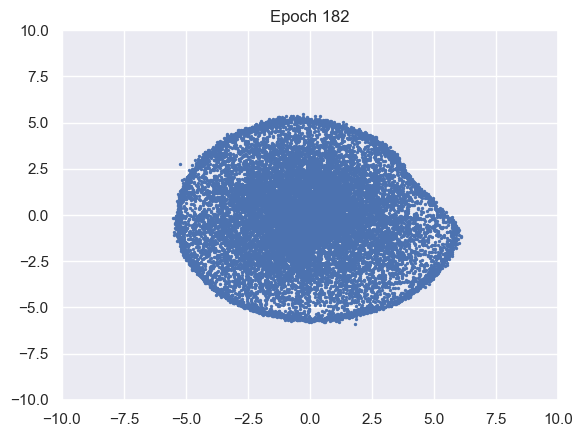

100%|██████████| 976/976 [00:10<00:00, 90.72it/s]


D loss : 1.3448, GP_loss : 0 G_loss : -0.7434, MI : 4.174


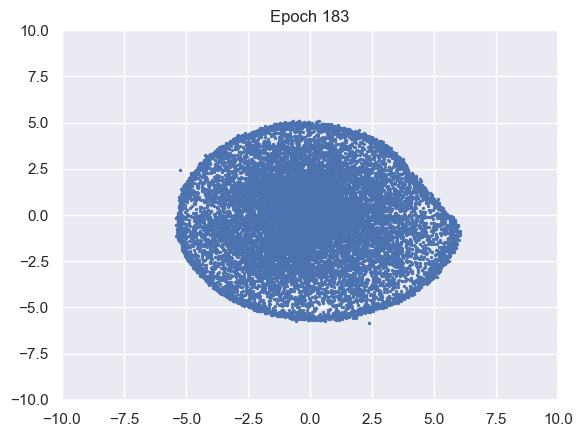

100%|██████████| 976/976 [00:10<00:00, 91.65it/s]


D loss : 1.3446, GP_loss : 0 G_loss : -0.7435, MI : 4.1776


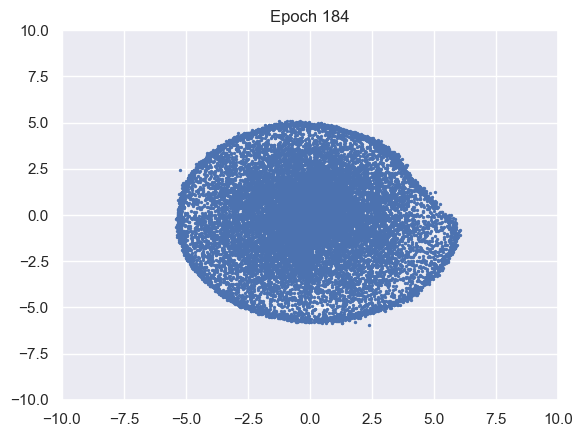

100%|██████████| 976/976 [00:10<00:00, 91.92it/s]


D loss : 1.3445, GP_loss : 0 G_loss : -0.7436, MI : 4.1799


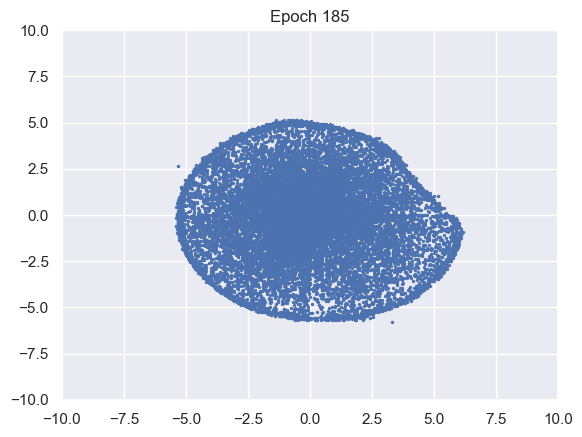

100%|██████████| 976/976 [00:10<00:00, 89.74it/s]


D loss : 1.3444, GP_loss : 0 G_loss : -0.7438, MI : 4.1819


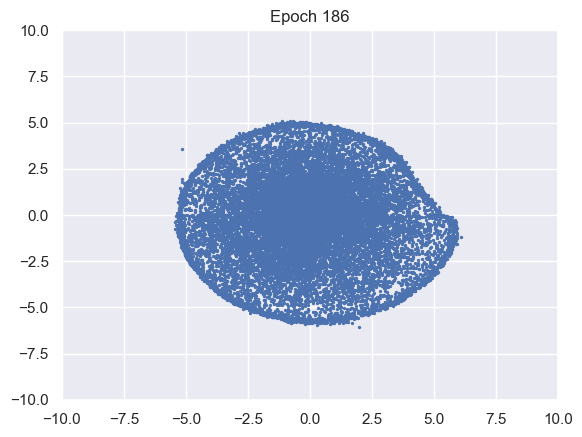

100%|██████████| 976/976 [00:10<00:00, 89.85it/s]


D loss : 1.3443, GP_loss : 0 G_loss : -0.7439, MI : 4.1841


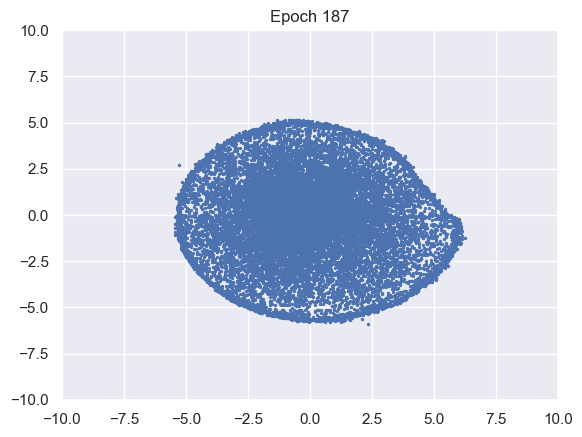

100%|██████████| 976/976 [00:10<00:00, 91.22it/s]


D loss : 1.3442, GP_loss : 0 G_loss : -0.7441, MI : 4.1864


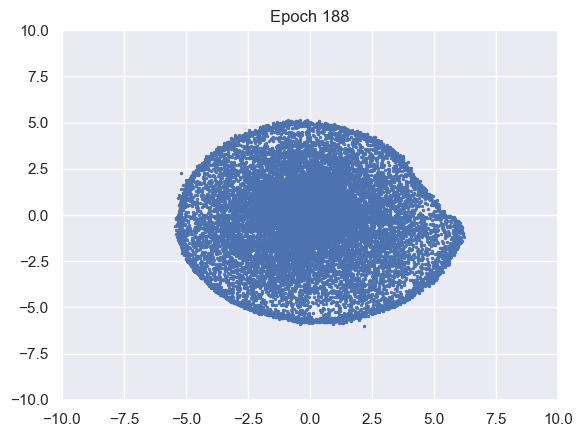

100%|██████████| 976/976 [00:10<00:00, 90.87it/s]


D loss : 1.3441, GP_loss : 0 G_loss : -0.7442, MI : 4.1872


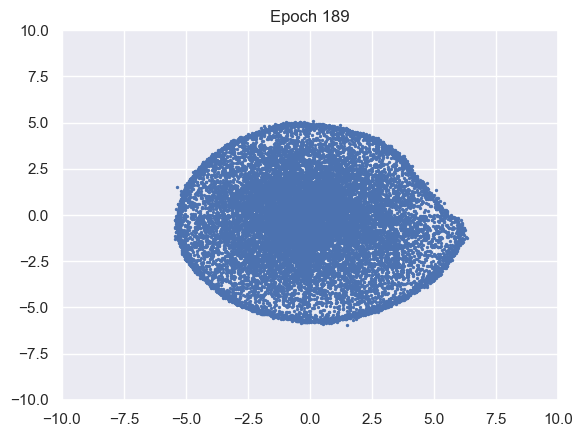

100%|██████████| 976/976 [00:10<00:00, 91.30it/s]


D loss : 1.344, GP_loss : 0 G_loss : -0.7443, MI : 4.1909


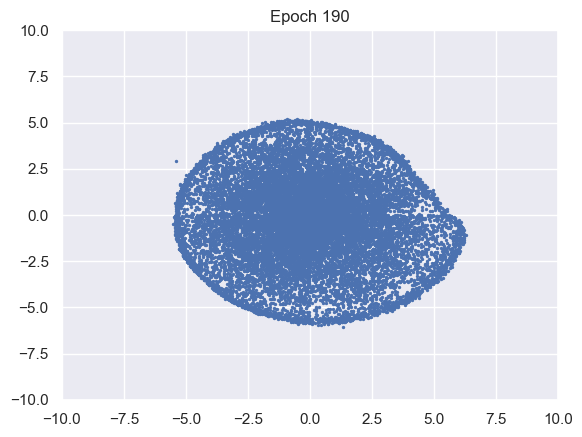

100%|██████████| 976/976 [00:10<00:00, 91.26it/s]


D loss : 1.3439, GP_loss : 0 G_loss : -0.7445, MI : 4.1931


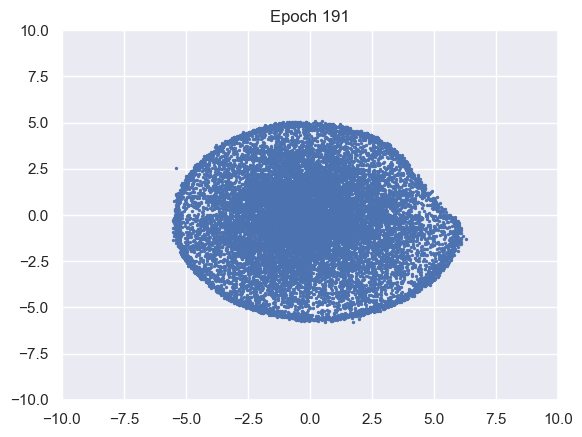

100%|██████████| 976/976 [00:10<00:00, 90.33it/s]


D loss : 1.3438, GP_loss : 0 G_loss : -0.7446, MI : 4.1957


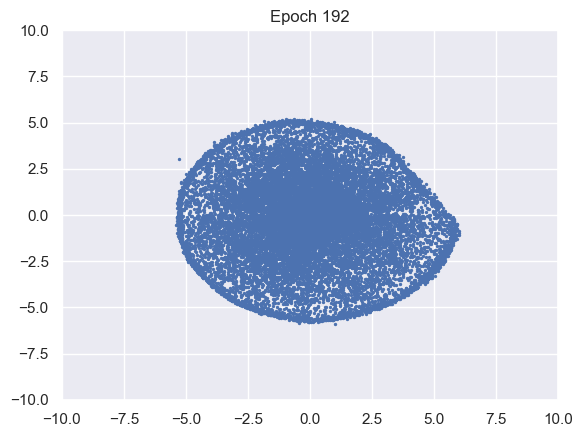

100%|██████████| 976/976 [00:10<00:00, 92.42it/s]


D loss : 1.3437, GP_loss : 0 G_loss : -0.7447, MI : 4.1984


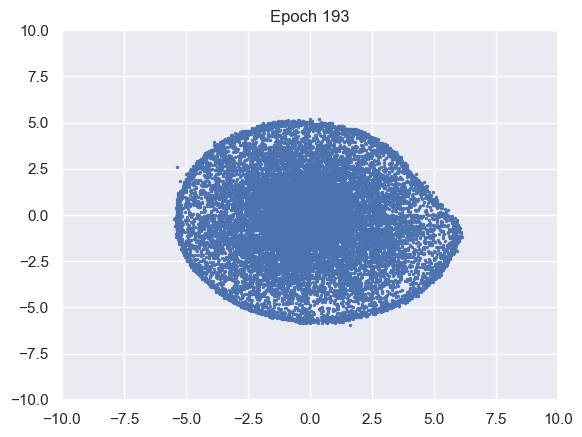

100%|██████████| 976/976 [00:10<00:00, 91.55it/s]


D loss : 1.3436, GP_loss : 0 G_loss : -0.7449, MI : 4.2004


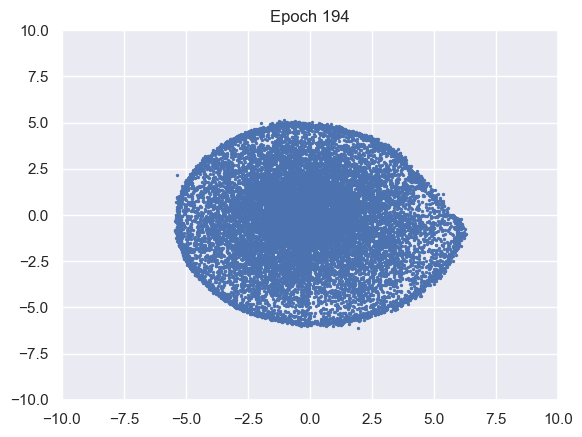

100%|██████████| 976/976 [00:10<00:00, 91.48it/s]


D loss : 1.3435, GP_loss : 0 G_loss : -0.745, MI : 4.2024


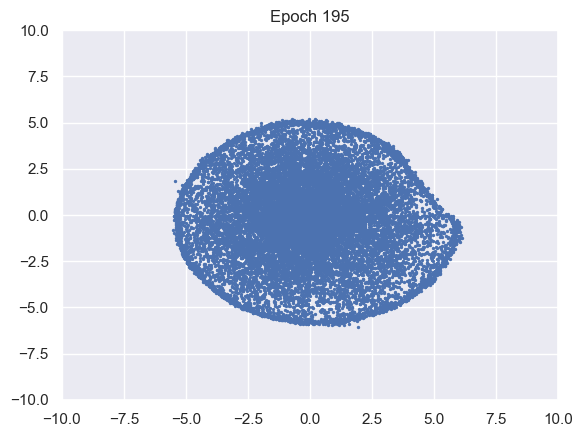

100%|██████████| 976/976 [00:10<00:00, 91.44it/s]


D loss : 1.3434, GP_loss : 0 G_loss : -0.7451, MI : 4.2043


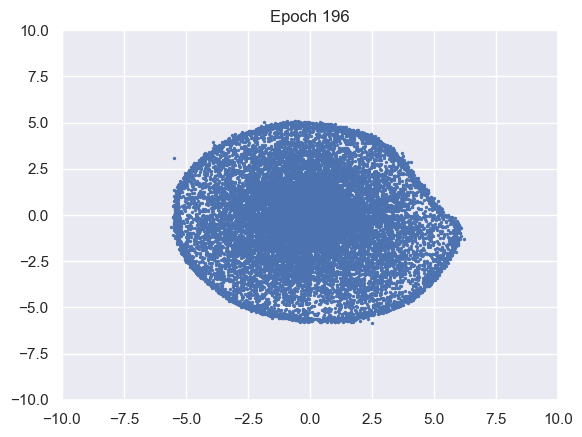

100%|██████████| 976/976 [00:10<00:00, 92.67it/s]


D loss : 1.3433, GP_loss : 0 G_loss : -0.7453, MI : 4.2065


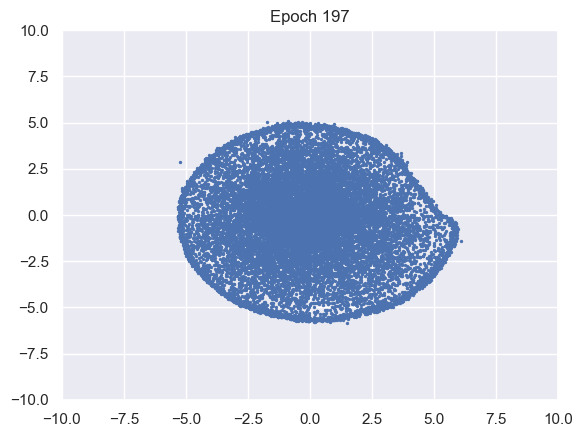

100%|██████████| 976/976 [00:10<00:00, 90.76it/s]


D loss : 1.3432, GP_loss : 0 G_loss : -0.7454, MI : 4.2093


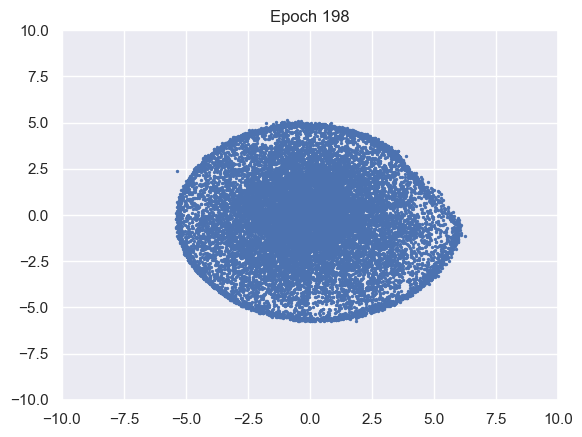

100%|██████████| 976/976 [00:10<00:00, 90.42it/s]


D loss : 1.3431, GP_loss : 0 G_loss : -0.7455, MI : 4.212


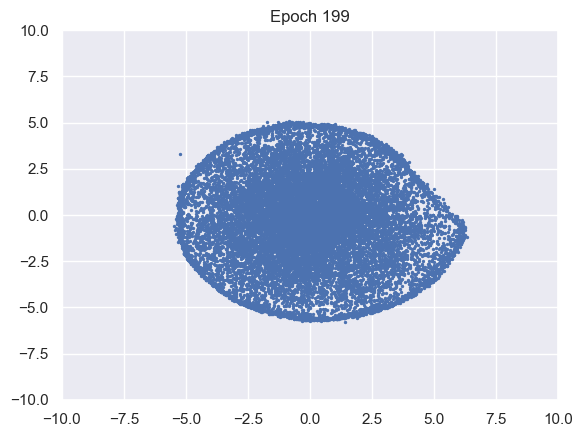

100%|██████████| 976/976 [00:10<00:00, 89.95it/s]


D loss : 1.343, GP_loss : 0 G_loss : -0.7457, MI : 4.2143


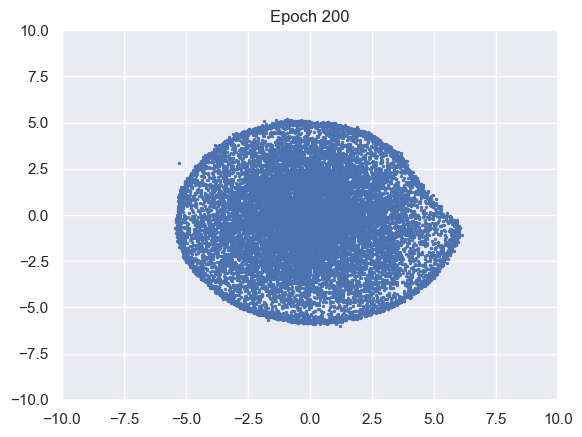

100%|██████████| 976/976 [00:10<00:00, 92.04it/s]


D loss : 1.3429, GP_loss : 0 G_loss : -0.7458, MI : 4.2141


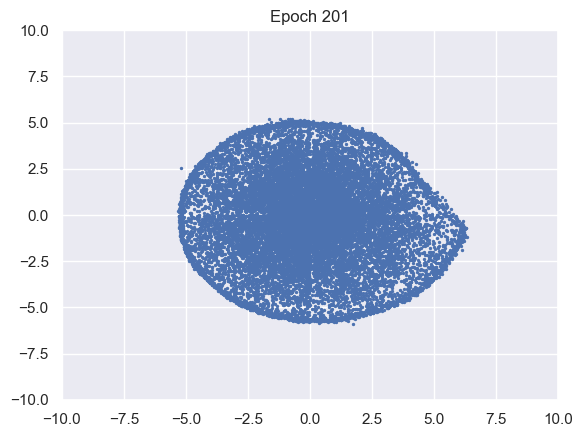

100%|██████████| 976/976 [00:10<00:00, 89.95it/s]


D loss : 1.3428, GP_loss : 0 G_loss : -0.7459, MI : 4.217


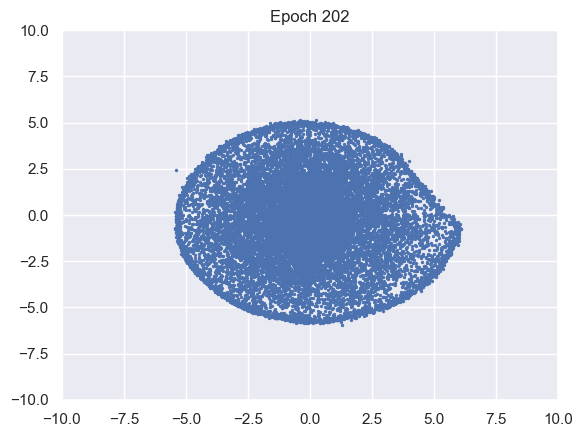

100%|██████████| 976/976 [00:10<00:00, 91.35it/s]


D loss : 1.3427, GP_loss : 0 G_loss : -0.746, MI : 4.2193


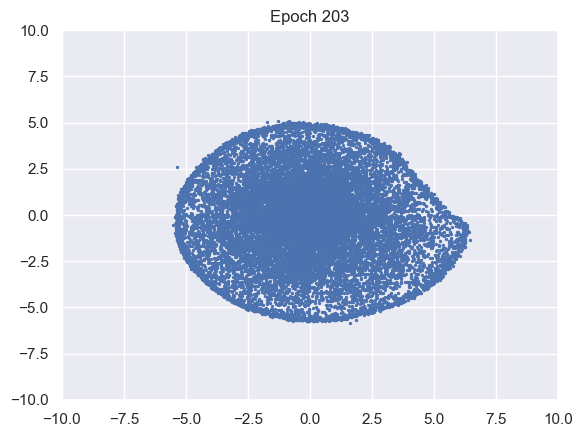

100%|██████████| 976/976 [00:10<00:00, 90.77it/s]


D loss : 1.3426, GP_loss : 0 G_loss : -0.7462, MI : 4.2188


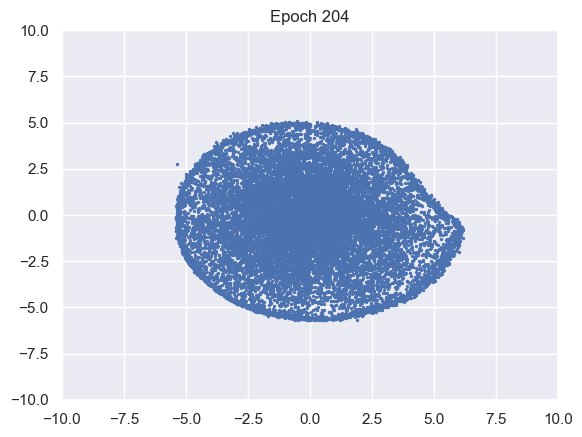

100%|██████████| 976/976 [00:10<00:00, 90.87it/s]


D loss : 1.3425, GP_loss : 0 G_loss : -0.7463, MI : 4.2213


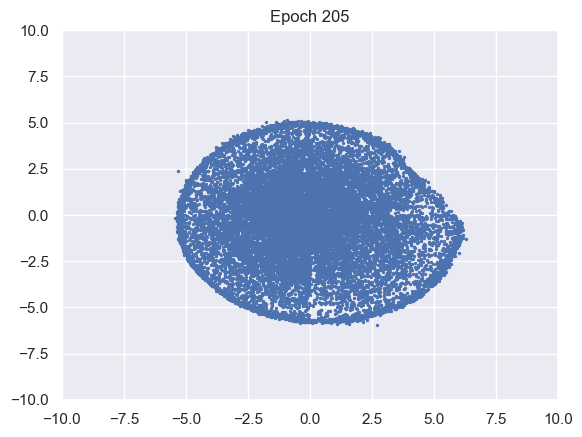

100%|██████████| 976/976 [00:10<00:00, 92.39it/s]


D loss : 1.3424, GP_loss : 0 G_loss : -0.7464, MI : 4.223


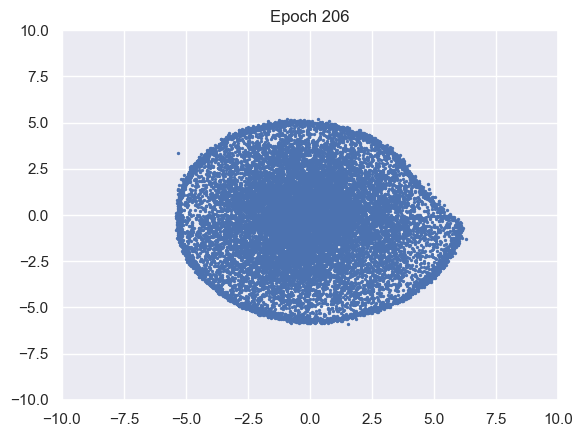

100%|██████████| 976/976 [00:10<00:00, 92.67it/s]


D loss : 1.3423, GP_loss : 0 G_loss : -0.7465, MI : 4.224


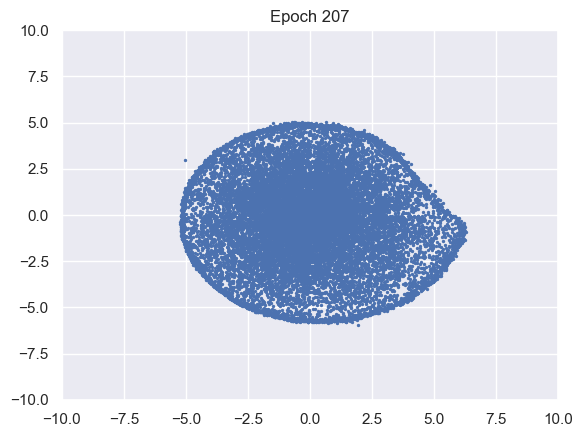

100%|██████████| 976/976 [00:10<00:00, 93.44it/s]


D loss : 1.3422, GP_loss : 0 G_loss : -0.7467, MI : 4.2265


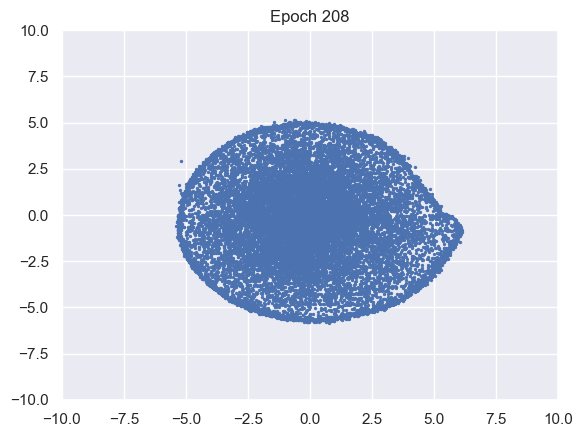

100%|██████████| 976/976 [00:10<00:00, 93.80it/s]


D loss : 1.3421, GP_loss : 0 G_loss : -0.7468, MI : 4.2287


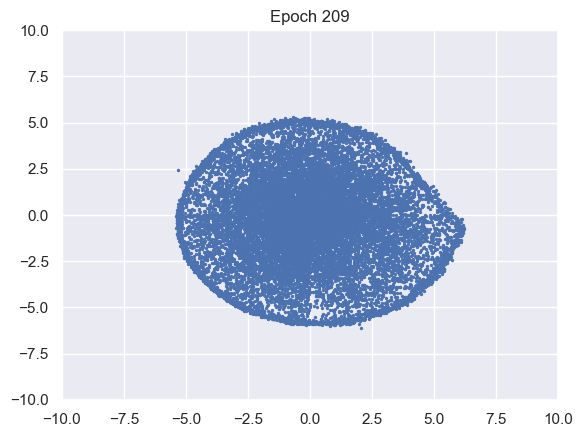

100%|██████████| 976/976 [00:10<00:00, 93.89it/s]


D loss : 1.342, GP_loss : 0 G_loss : -0.7469, MI : 4.2301


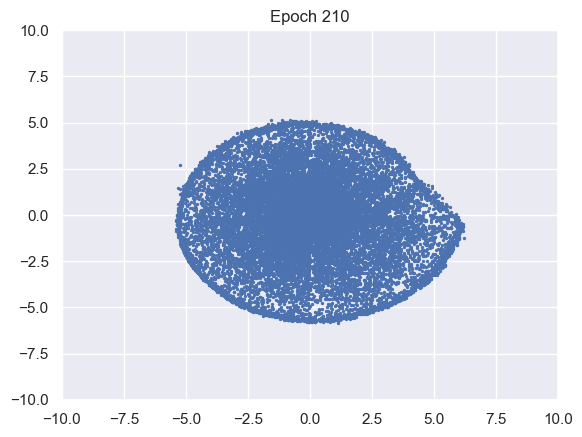

100%|██████████| 976/976 [00:10<00:00, 94.63it/s]


D loss : 1.3419, GP_loss : 0 G_loss : -0.747, MI : 4.2325


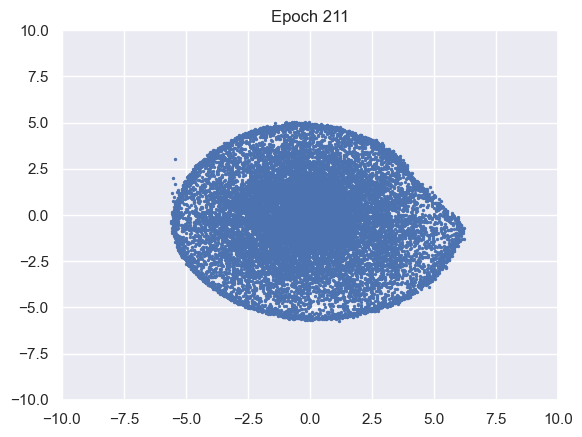

100%|██████████| 976/976 [00:10<00:00, 93.25it/s]


D loss : 1.3418, GP_loss : 0 G_loss : -0.7471, MI : 4.2345


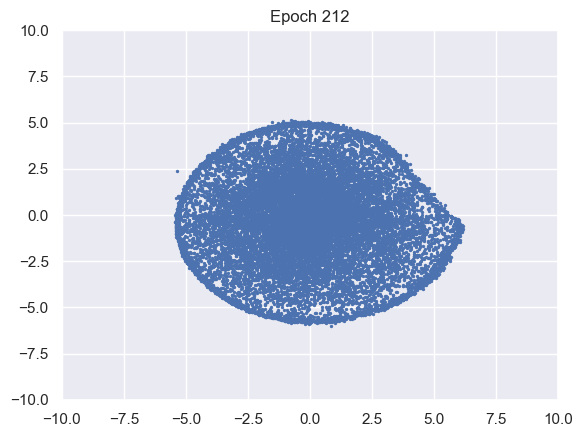

100%|██████████| 976/976 [00:10<00:00, 94.01it/s]


D loss : 1.3417, GP_loss : 0 G_loss : -0.7472, MI : 4.2365


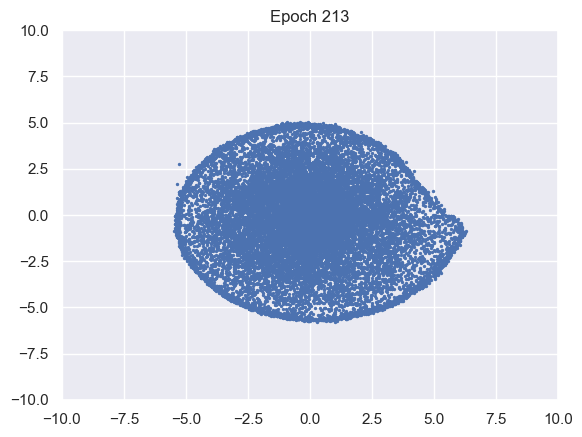

100%|██████████| 976/976 [00:10<00:00, 93.86it/s]


D loss : 1.3416, GP_loss : 0 G_loss : -0.7474, MI : 4.2388


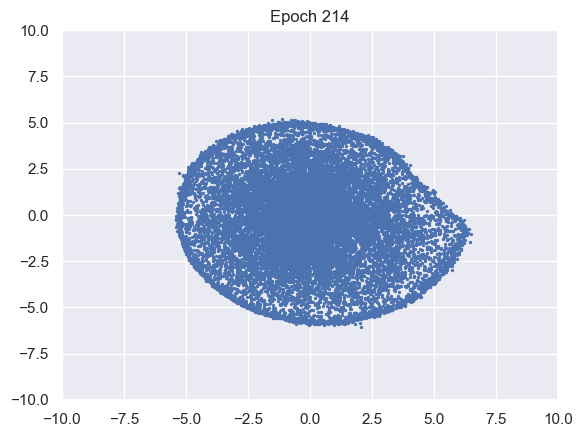

100%|██████████| 976/976 [00:10<00:00, 95.46it/s]


D loss : 1.3415, GP_loss : 0 G_loss : -0.7475, MI : 4.2402


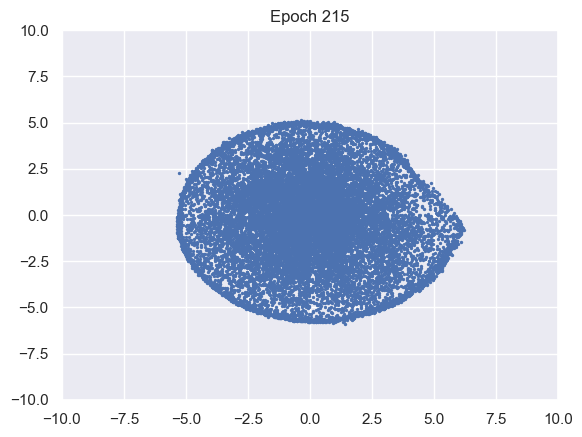

100%|██████████| 976/976 [00:10<00:00, 95.35it/s]


D loss : 1.3414, GP_loss : 0 G_loss : -0.7476, MI : 4.2422


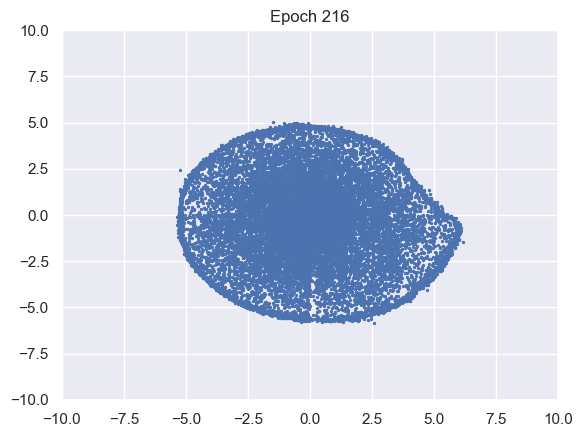

100%|██████████| 976/976 [00:10<00:00, 92.54it/s]


D loss : 1.3413, GP_loss : 0 G_loss : -0.7477, MI : 4.2449


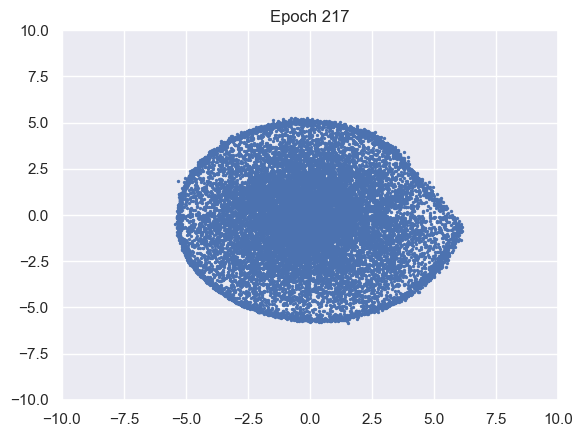

100%|██████████| 976/976 [00:10<00:00, 93.25it/s]


D loss : 1.3412, GP_loss : 0 G_loss : -0.7478, MI : 4.2471


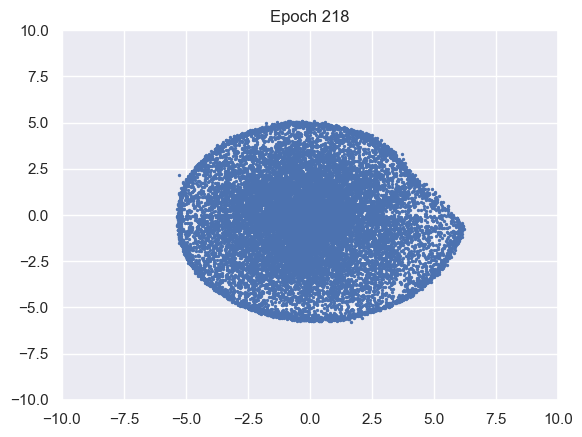

100%|██████████| 976/976 [00:10<00:00, 94.28it/s]


D loss : 1.3411, GP_loss : 0 G_loss : -0.748, MI : 4.249


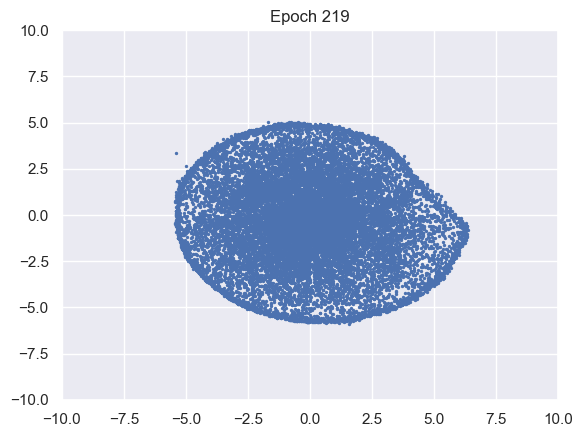

100%|██████████| 976/976 [00:10<00:00, 92.33it/s]


D loss : 1.341, GP_loss : 0 G_loss : -0.7481, MI : 4.2505


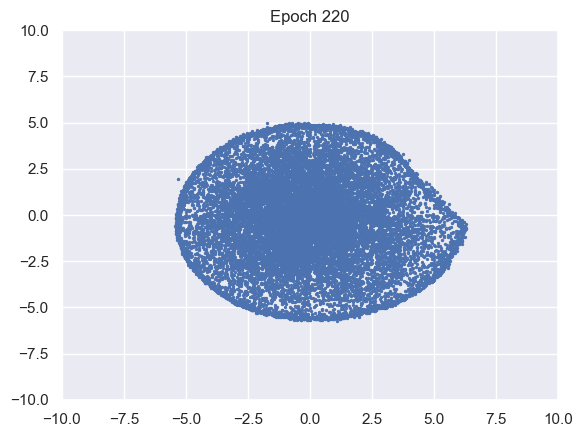

100%|██████████| 976/976 [00:10<00:00, 93.29it/s]


D loss : 1.341, GP_loss : 0 G_loss : -0.7482, MI : 4.2526


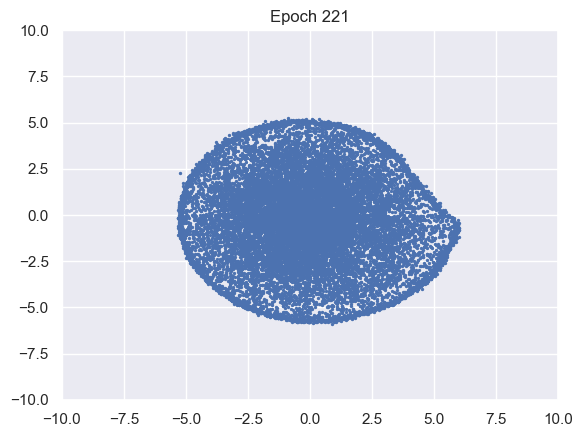

100%|██████████| 976/976 [00:10<00:00, 91.49it/s]


D loss : 1.3409, GP_loss : 0 G_loss : -0.7483, MI : 4.2545


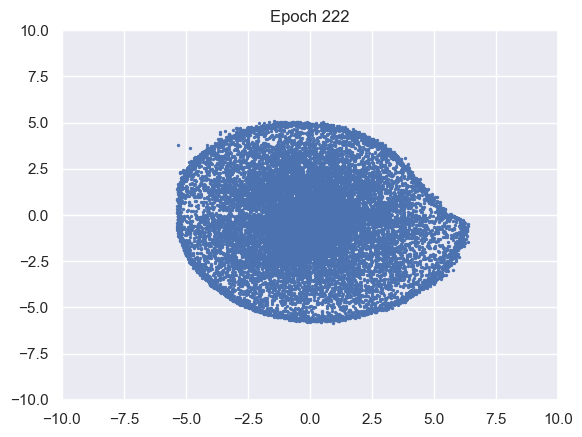

100%|██████████| 976/976 [00:10<00:00, 90.27it/s]


D loss : 1.3408, GP_loss : 0 G_loss : -0.7484, MI : 4.2571


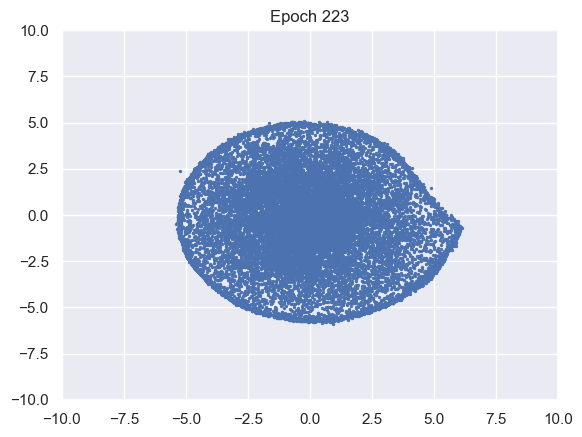

100%|██████████| 976/976 [00:10<00:00, 88.97it/s]


D loss : 1.3407, GP_loss : 0 G_loss : -0.7485, MI : 4.2587


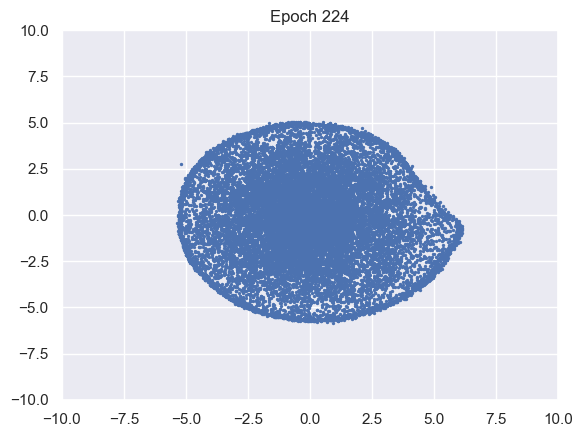

100%|██████████| 976/976 [00:11<00:00, 88.42it/s]


D loss : 1.3406, GP_loss : 0 G_loss : -0.7486, MI : 4.2595


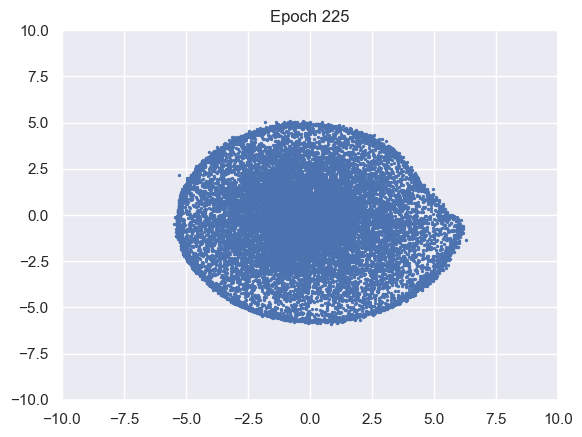

100%|██████████| 976/976 [00:10<00:00, 89.47it/s]


D loss : 1.3405, GP_loss : 0 G_loss : -0.7488, MI : 4.2616


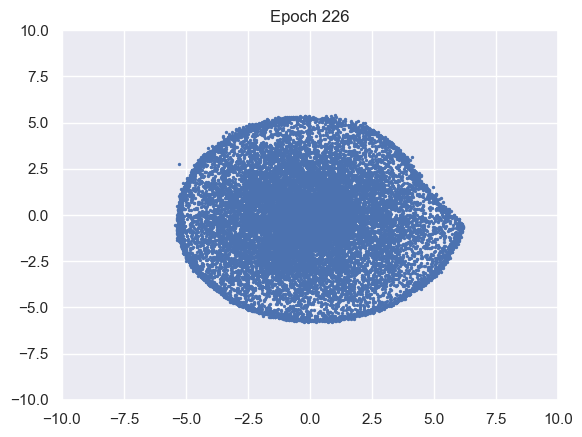

100%|██████████| 976/976 [00:10<00:00, 92.03it/s]


D loss : 1.3404, GP_loss : 0 G_loss : -0.7489, MI : 4.2636


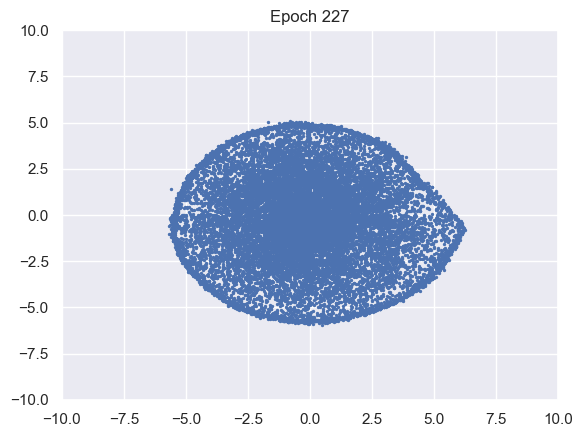

100%|██████████| 976/976 [00:10<00:00, 89.43it/s]


D loss : 1.3403, GP_loss : 0 G_loss : -0.749, MI : 4.2646


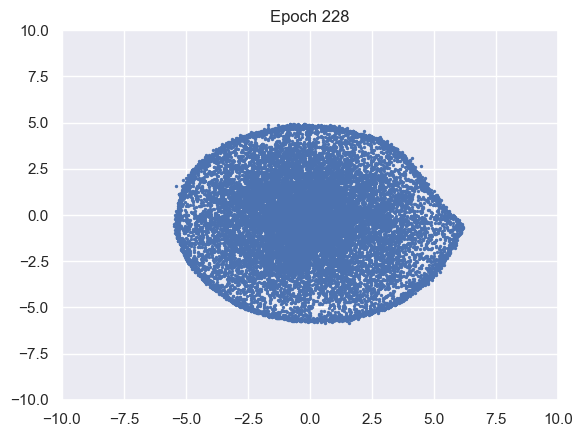

100%|██████████| 976/976 [00:10<00:00, 91.64it/s]


D loss : 1.3402, GP_loss : 0 G_loss : -0.7491, MI : 4.2668


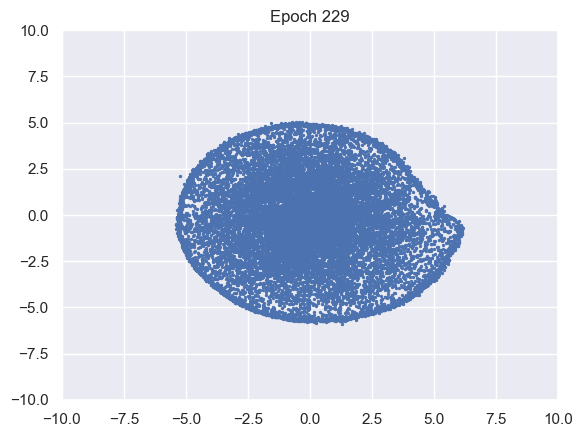

100%|██████████| 976/976 [00:10<00:00, 90.21it/s]


D loss : 1.3402, GP_loss : 0 G_loss : -0.7492, MI : 4.269


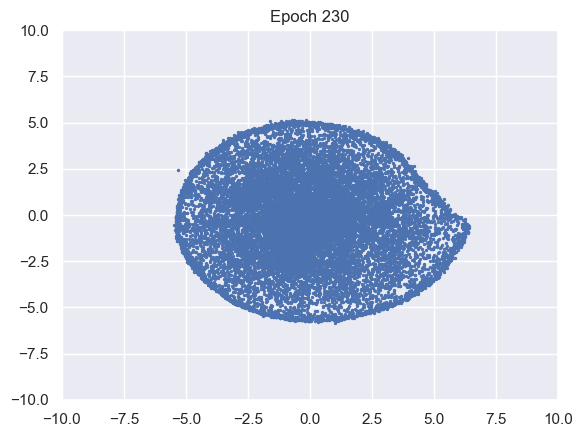

100%|██████████| 976/976 [00:10<00:00, 90.13it/s]


D loss : 1.3401, GP_loss : 0 G_loss : -0.7493, MI : 4.2706


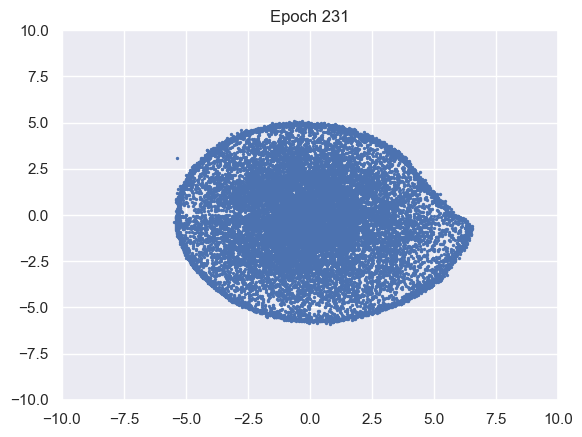

100%|██████████| 976/976 [00:10<00:00, 90.89it/s]


D loss : 1.34, GP_loss : 0 G_loss : -0.7494, MI : 4.2728


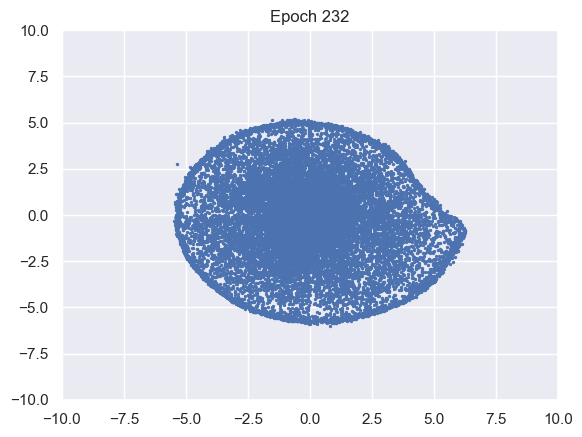

100%|██████████| 976/976 [00:10<00:00, 92.39it/s]


D loss : 1.3399, GP_loss : 0 G_loss : -0.7495, MI : 4.2744


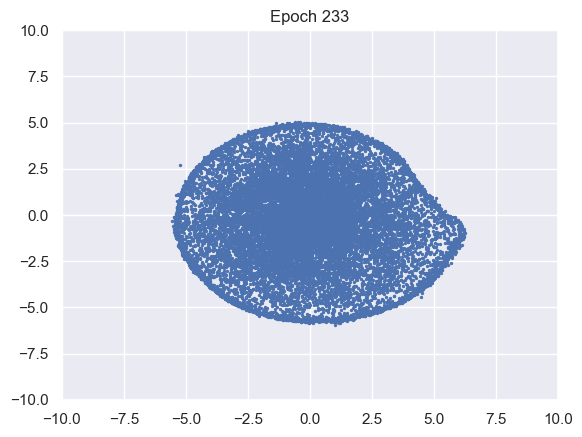

100%|██████████| 976/976 [00:10<00:00, 89.83it/s]


D loss : 1.3398, GP_loss : 0 G_loss : -0.7496, MI : 4.2757


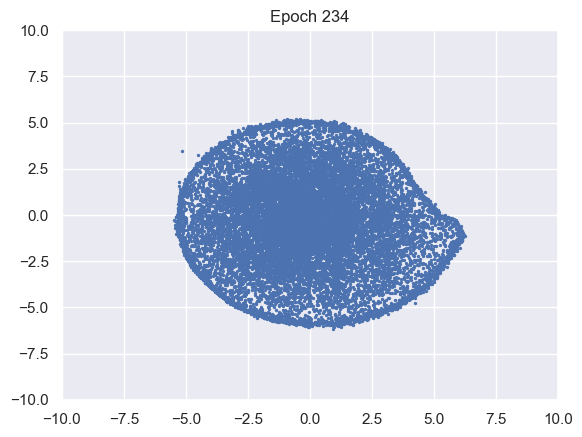

100%|██████████| 976/976 [00:10<00:00, 89.96it/s]


D loss : 1.3397, GP_loss : 0 G_loss : -0.7497, MI : 4.2775


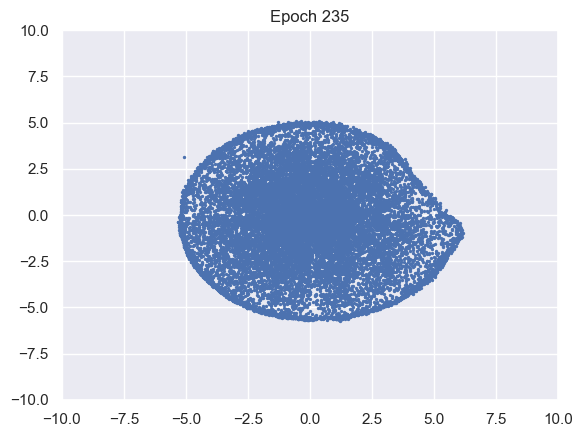

100%|██████████| 976/976 [00:10<00:00, 92.57it/s]


D loss : 1.3397, GP_loss : 0 G_loss : -0.7498, MI : 4.2785


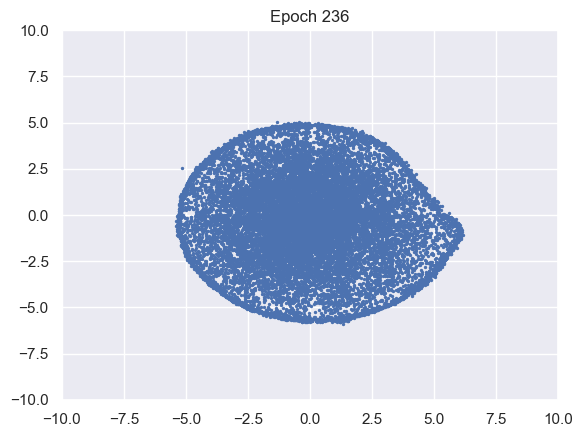

100%|██████████| 976/976 [00:10<00:00, 91.42it/s]


D loss : 1.3396, GP_loss : 0 G_loss : -0.7499, MI : 4.2807


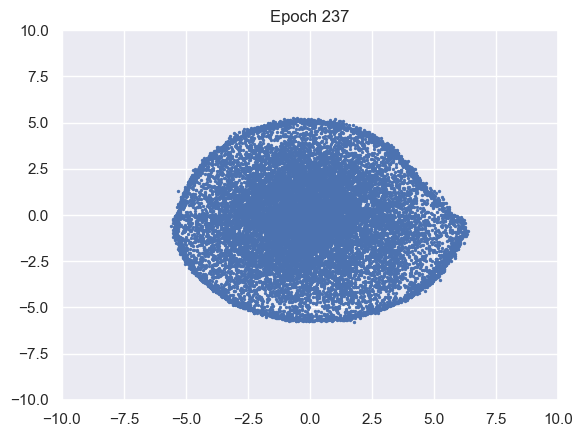

100%|██████████| 976/976 [00:10<00:00, 91.23it/s]


D loss : 1.3395, GP_loss : 0 G_loss : -0.75, MI : 4.2826


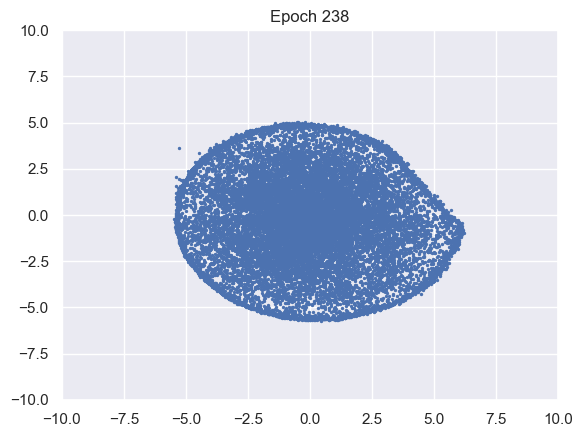

100%|██████████| 976/976 [00:10<00:00, 91.51it/s]


D loss : 1.3394, GP_loss : 0 G_loss : -0.7501, MI : 4.2846


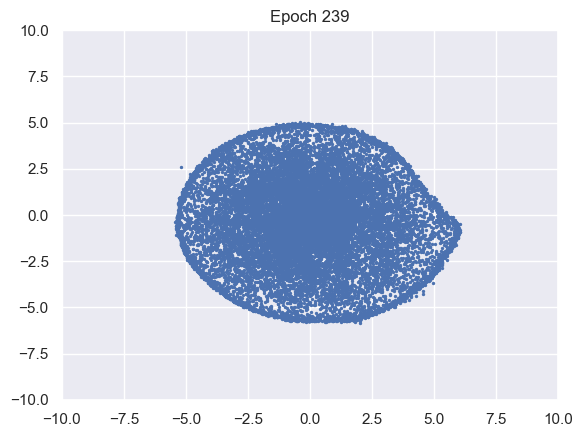

100%|██████████| 976/976 [00:10<00:00, 92.85it/s]


D loss : 1.3394, GP_loss : 0 G_loss : -0.7502, MI : 4.2865


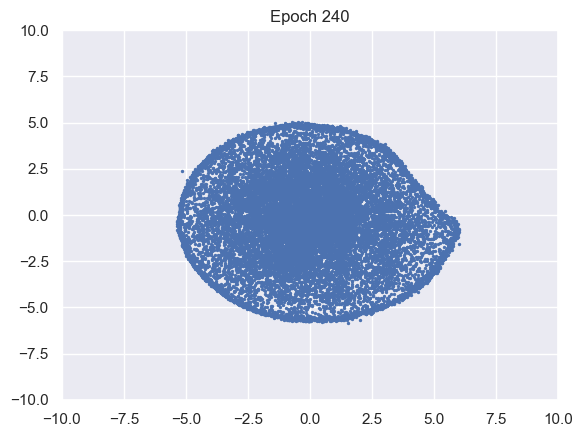

100%|██████████| 976/976 [00:10<00:00, 92.03it/s]


D loss : 1.3393, GP_loss : 0 G_loss : -0.7503, MI : 4.2885


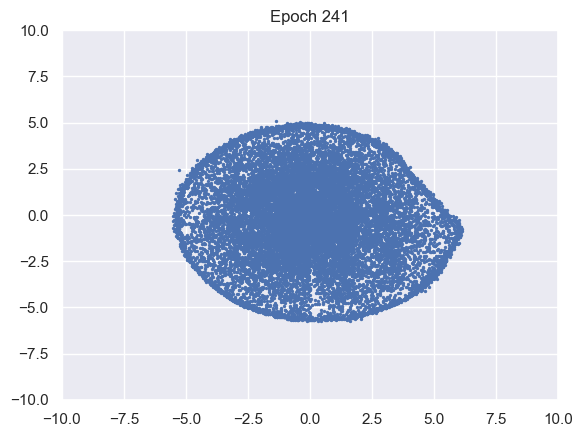

100%|██████████| 976/976 [00:10<00:00, 91.88it/s]


D loss : 1.3392, GP_loss : 0 G_loss : -0.7504, MI : 4.2897


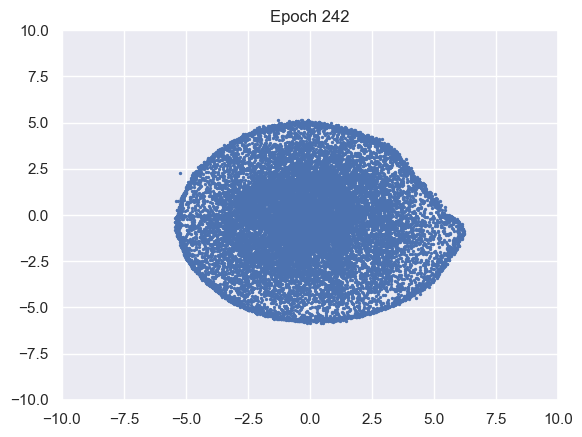

100%|██████████| 976/976 [00:10<00:00, 90.16it/s]


D loss : 1.3391, GP_loss : 0 G_loss : -0.7505, MI : 4.2917


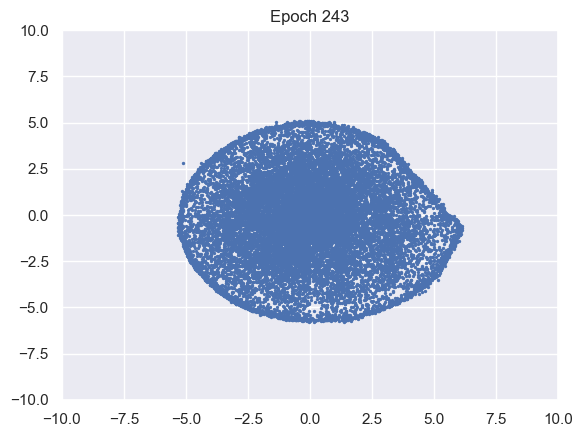

100%|██████████| 976/976 [00:10<00:00, 91.53it/s]


D loss : 1.339, GP_loss : 0 G_loss : -0.7506, MI : 4.2933


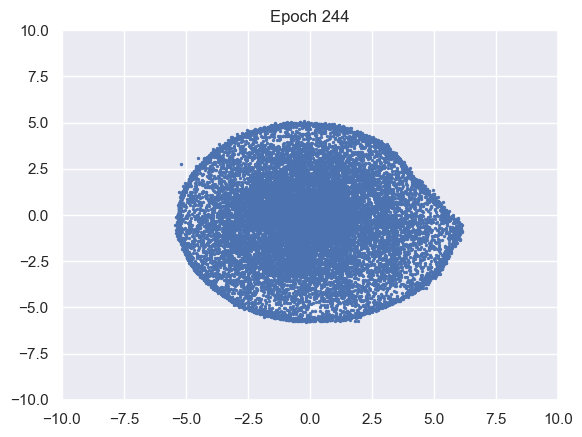

100%|██████████| 976/976 [00:10<00:00, 88.76it/s]


D loss : 1.339, GP_loss : 0 G_loss : -0.7507, MI : 4.2947


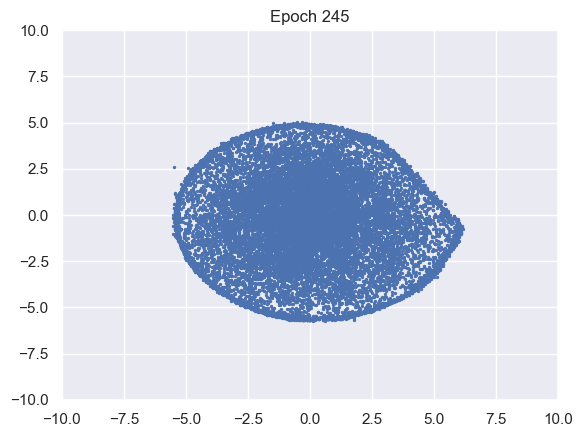

100%|██████████| 976/976 [00:11<00:00, 88.63it/s]


D loss : 1.3389, GP_loss : 0 G_loss : -0.7508, MI : 4.2941


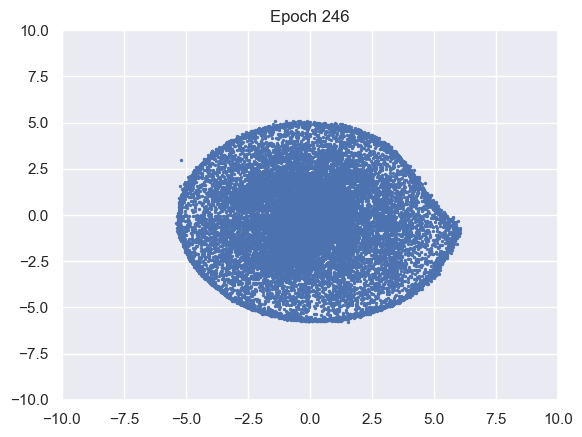

100%|██████████| 976/976 [00:10<00:00, 90.08it/s]


D loss : 1.3388, GP_loss : 0 G_loss : -0.7509, MI : 4.2958


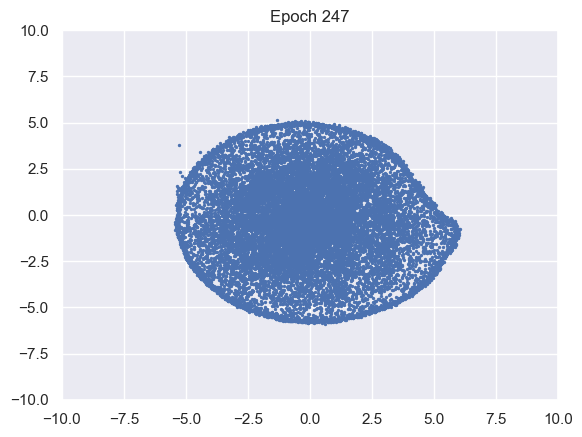

100%|██████████| 976/976 [00:10<00:00, 91.11it/s]


D loss : 1.3387, GP_loss : 0 G_loss : -0.751, MI : 4.2974


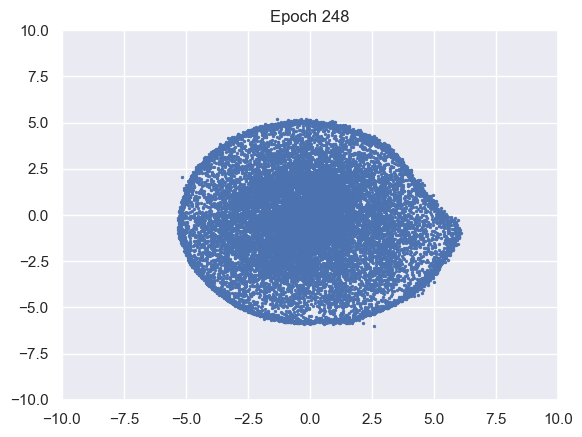

100%|██████████| 976/976 [00:10<00:00, 89.93it/s]


D loss : 1.3387, GP_loss : 0 G_loss : -0.7511, MI : 4.2982


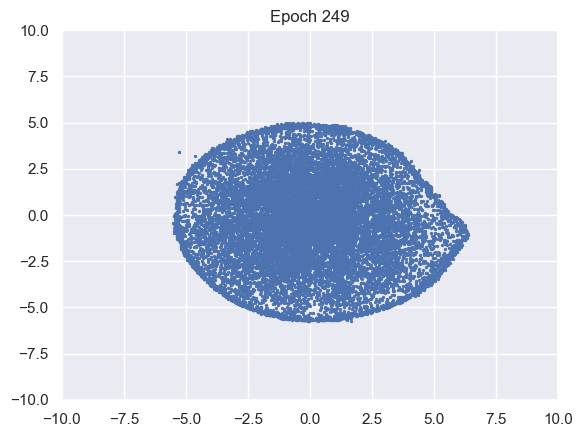

100%|██████████| 976/976 [00:10<00:00, 91.08it/s]


D loss : 1.3386, GP_loss : 0 G_loss : -0.7512, MI : 4.3


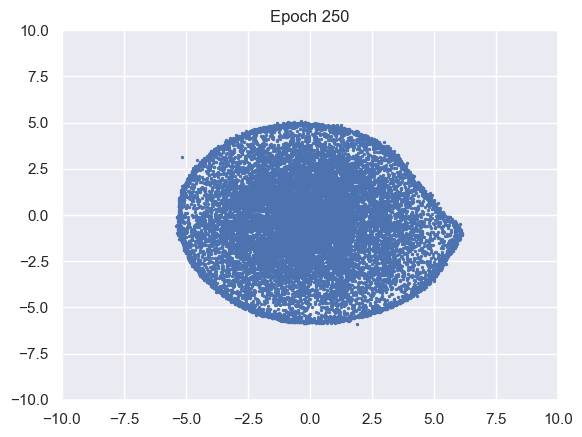

100%|██████████| 976/976 [00:10<00:00, 91.69it/s]


D loss : 1.3385, GP_loss : 0 G_loss : -0.7513, MI : 4.3008


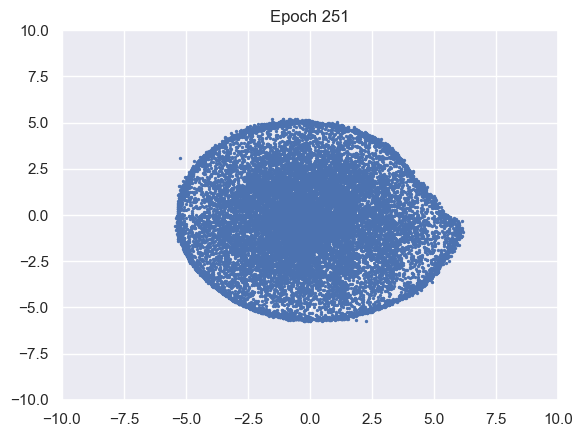

100%|██████████| 976/976 [00:10<00:00, 92.71it/s]


D loss : 1.3385, GP_loss : 0 G_loss : -0.7514, MI : 4.303


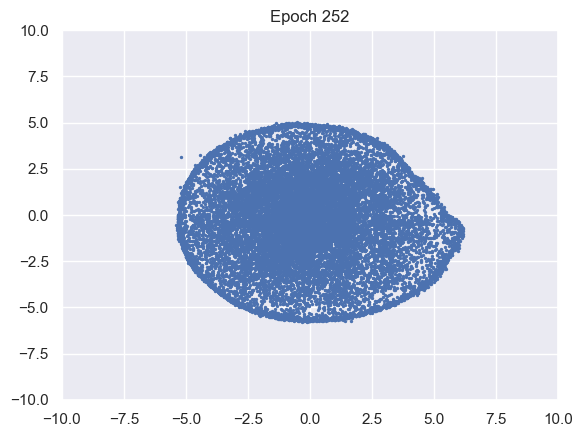

100%|██████████| 976/976 [00:10<00:00, 90.65it/s]


D loss : 1.3384, GP_loss : 0 G_loss : -0.7515, MI : 4.3042


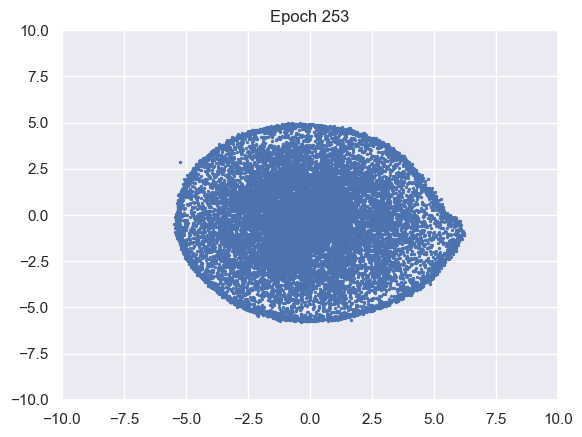

100%|██████████| 976/976 [00:10<00:00, 92.93it/s]


D loss : 1.3383, GP_loss : 0 G_loss : -0.7516, MI : 4.3057


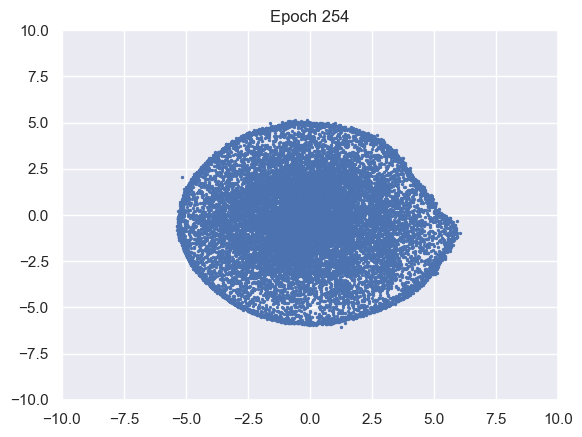

100%|██████████| 976/976 [00:10<00:00, 92.43it/s]


D loss : 1.3382, GP_loss : 0 G_loss : -0.7517, MI : 4.3069


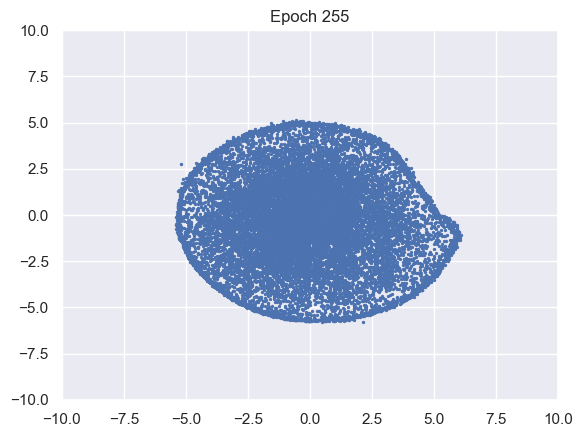

100%|██████████| 976/976 [00:10<00:00, 93.00it/s]


D loss : 1.3382, GP_loss : 0 G_loss : -0.7518, MI : 4.3088


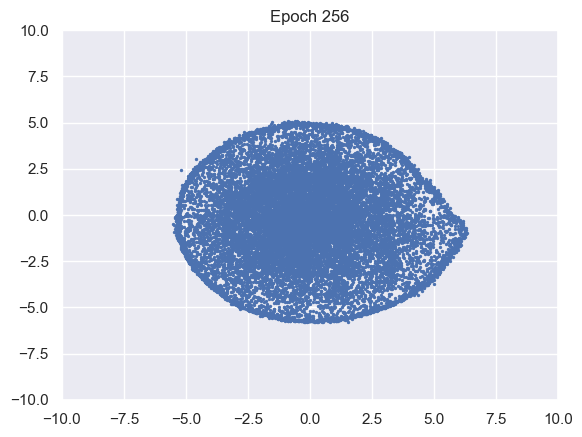

100%|██████████| 976/976 [00:10<00:00, 92.76it/s]


D loss : 1.3381, GP_loss : 0 G_loss : -0.7519, MI : 4.3083


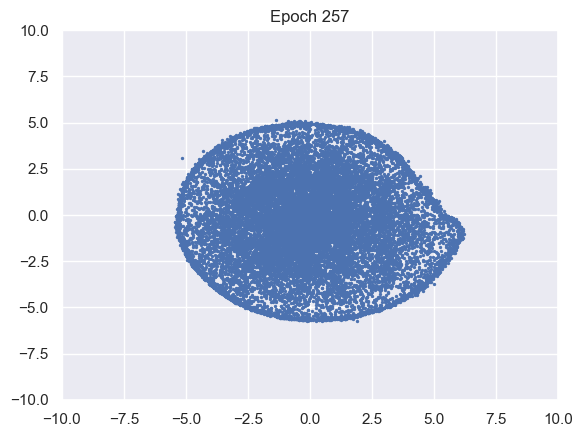

100%|██████████| 976/976 [00:10<00:00, 92.14it/s]


D loss : 1.338, GP_loss : 0 G_loss : -0.752, MI : 4.31


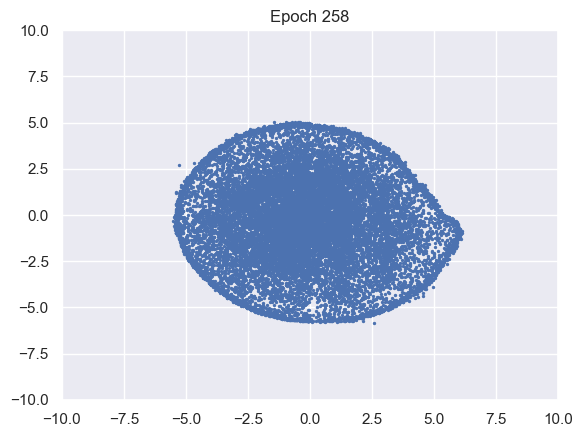

100%|██████████| 976/976 [00:10<00:00, 91.38it/s]


D loss : 1.338, GP_loss : 0 G_loss : -0.752, MI : 4.3108


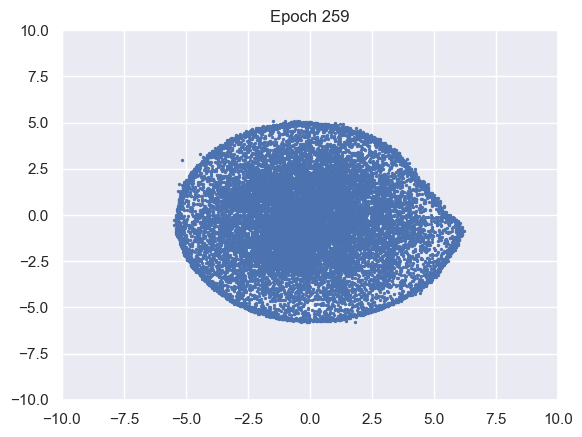

100%|██████████| 976/976 [00:10<00:00, 92.00it/s]


D loss : 1.3379, GP_loss : 0 G_loss : -0.7521, MI : 4.3125


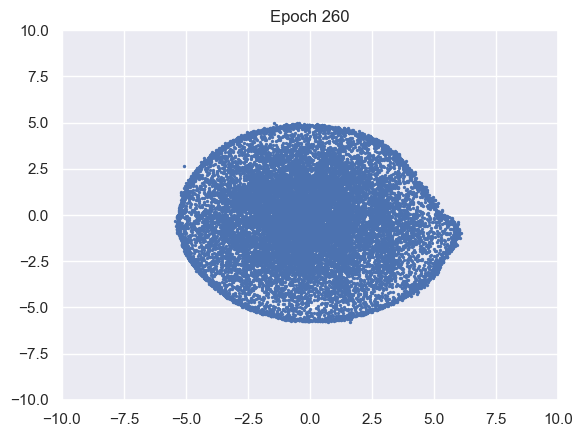

100%|██████████| 976/976 [00:10<00:00, 90.63it/s]


D loss : 1.3378, GP_loss : 0 G_loss : -0.7522, MI : 4.3137


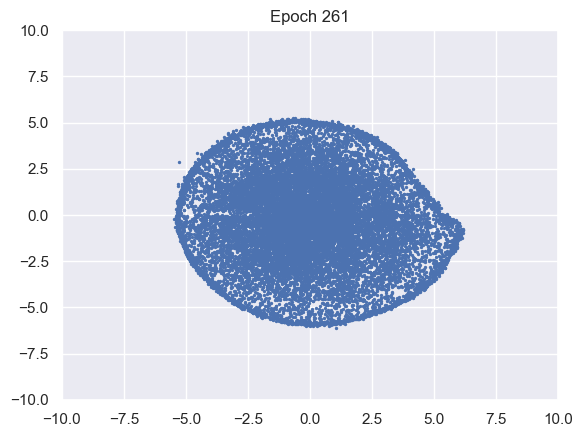

100%|██████████| 976/976 [00:10<00:00, 89.03it/s]


D loss : 1.3378, GP_loss : 0 G_loss : -0.7523, MI : 4.315


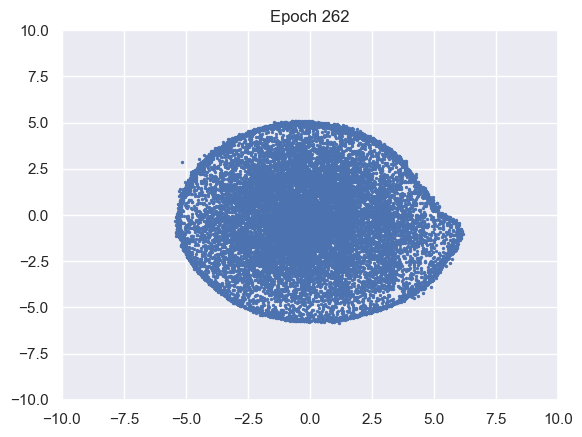

100%|██████████| 976/976 [00:10<00:00, 88.82it/s]


D loss : 1.3377, GP_loss : 0 G_loss : -0.7524, MI : 4.3155


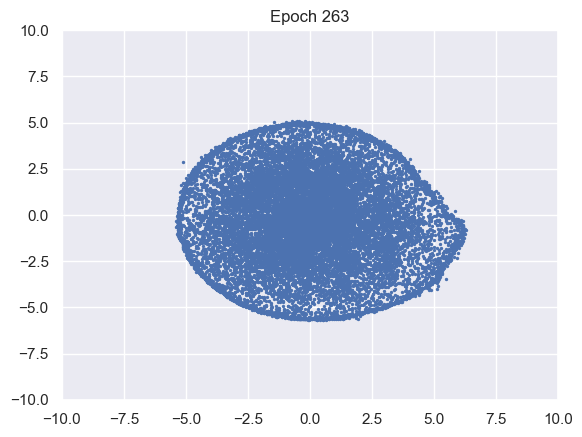

100%|██████████| 976/976 [00:10<00:00, 89.77it/s]


D loss : 1.3376, GP_loss : 0 G_loss : -0.7525, MI : 4.3171


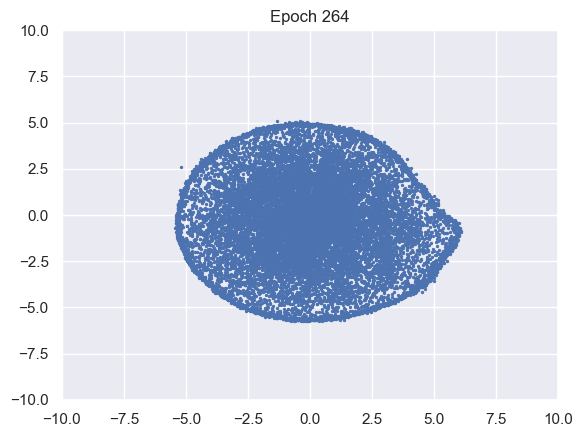

100%|██████████| 976/976 [00:10<00:00, 90.68it/s]


D loss : 1.3376, GP_loss : 0 G_loss : -0.7526, MI : 4.3186


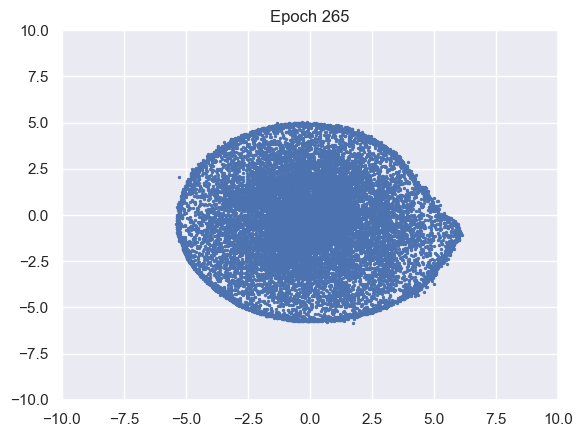

100%|██████████| 976/976 [00:10<00:00, 93.39it/s]


D loss : 1.3375, GP_loss : 0 G_loss : -0.7527, MI : 4.3201


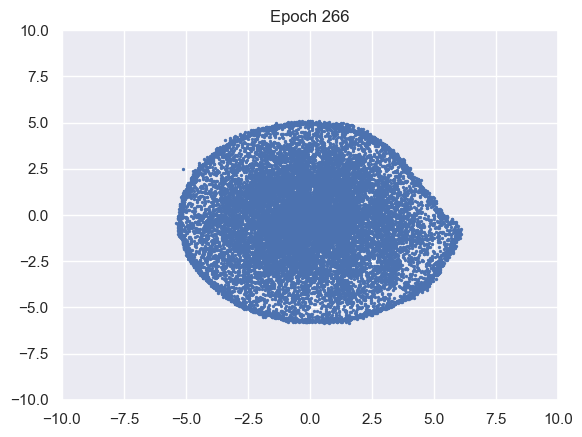

100%|██████████| 976/976 [00:10<00:00, 92.55it/s]


D loss : 1.3375, GP_loss : 0 G_loss : -0.7528, MI : 4.3214


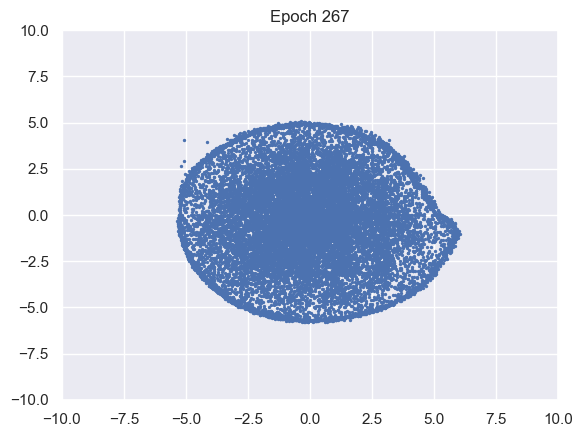

100%|██████████| 976/976 [00:10<00:00, 93.49it/s]


D loss : 1.3374, GP_loss : 0 G_loss : -0.7528, MI : 4.3215


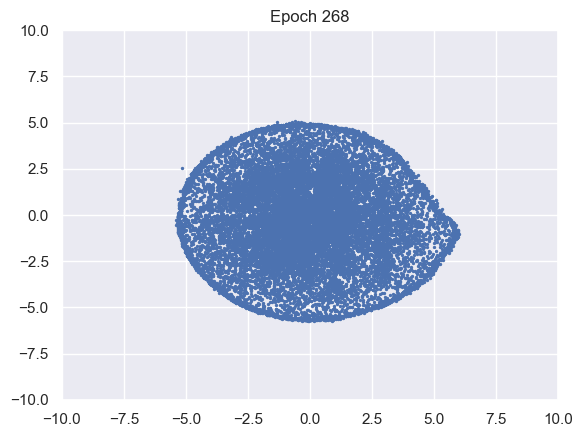

100%|██████████| 976/976 [00:10<00:00, 92.18it/s]


D loss : 1.3373, GP_loss : 0 G_loss : -0.7529, MI : 4.3232


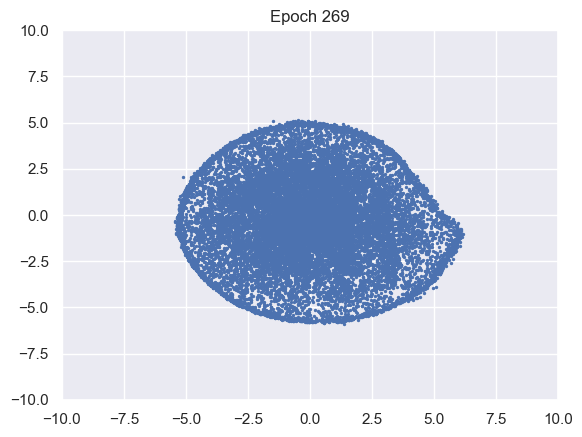

100%|██████████| 976/976 [00:10<00:00, 91.83it/s]


D loss : 1.3373, GP_loss : 0 G_loss : -0.753, MI : 4.3239


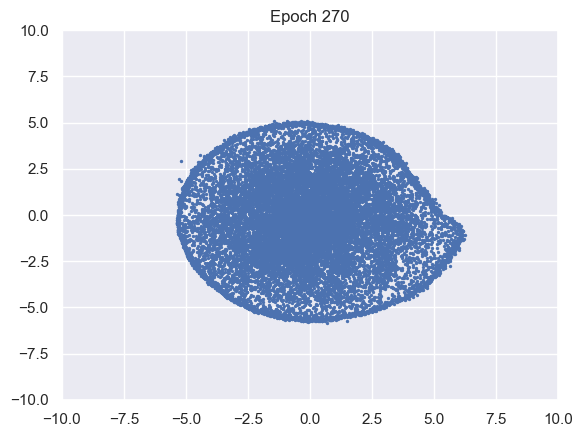

100%|██████████| 976/976 [00:10<00:00, 90.65it/s]


D loss : 1.3372, GP_loss : 0 G_loss : -0.7531, MI : 4.3256


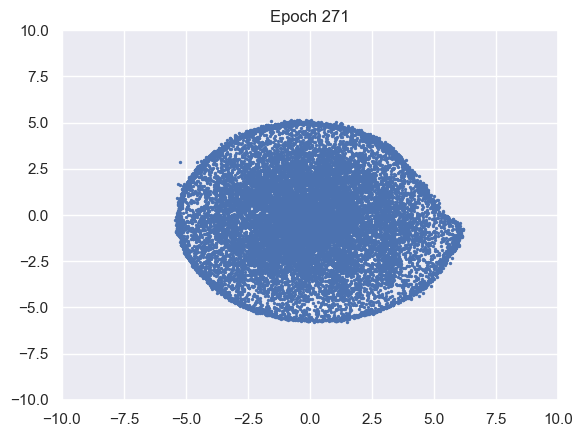

100%|██████████| 976/976 [00:10<00:00, 91.52it/s]


D loss : 1.3372, GP_loss : 0 G_loss : -0.7532, MI : 4.3254


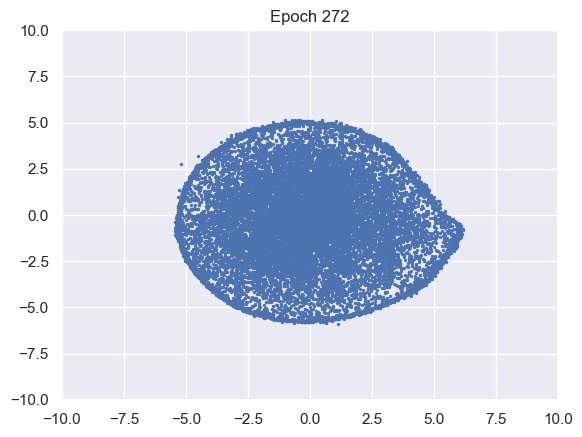

100%|██████████| 976/976 [00:10<00:00, 91.91it/s]


D loss : 1.3371, GP_loss : 0 G_loss : -0.7533, MI : 4.3265


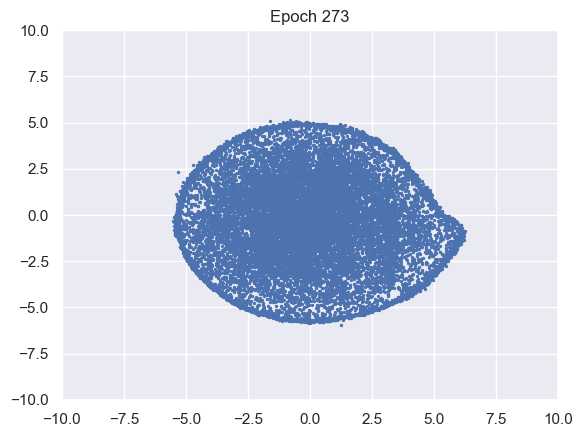

100%|██████████| 976/976 [00:10<00:00, 92.93it/s]


D loss : 1.337, GP_loss : 0 G_loss : -0.7533, MI : 4.3277


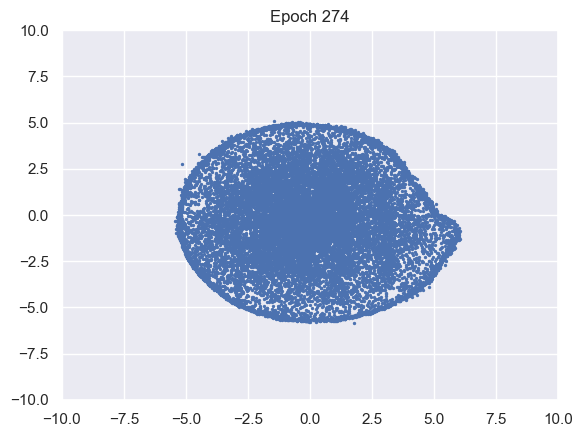

100%|██████████| 976/976 [00:10<00:00, 92.85it/s]


D loss : 1.337, GP_loss : 0 G_loss : -0.7534, MI : 4.3287


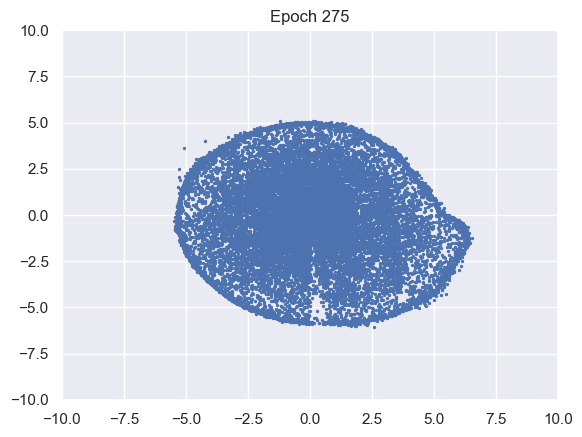

100%|██████████| 976/976 [00:10<00:00, 93.25it/s]


D loss : 1.3369, GP_loss : 0 G_loss : -0.7535, MI : 4.3296


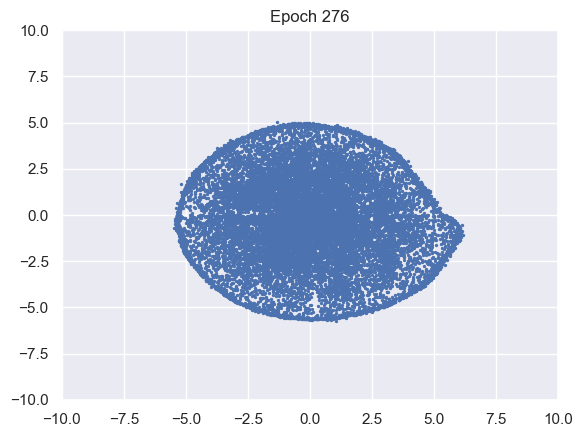

100%|██████████| 976/976 [00:10<00:00, 94.26it/s]


D loss : 1.3369, GP_loss : 0 G_loss : -0.7536, MI : 4.3308


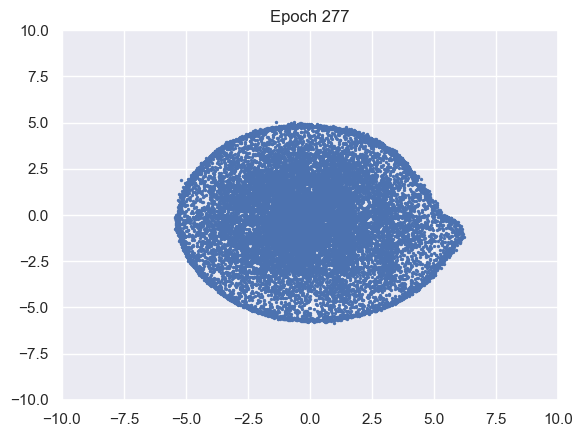

100%|██████████| 976/976 [00:10<00:00, 92.77it/s]


D loss : 1.3368, GP_loss : 0 G_loss : -0.7537, MI : 4.3322


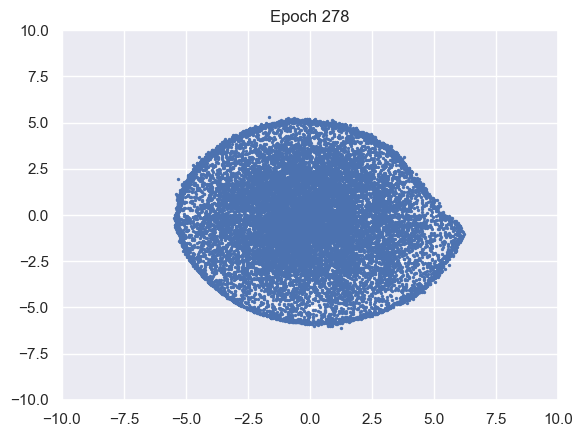

100%|██████████| 976/976 [00:10<00:00, 92.80it/s]


D loss : 1.3367, GP_loss : 0 G_loss : -0.7537, MI : 4.3334


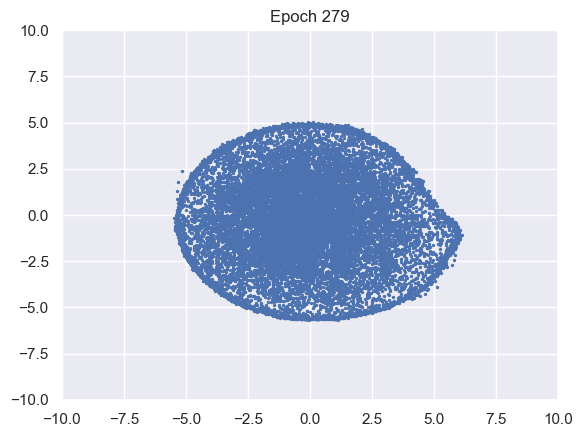

100%|██████████| 976/976 [00:10<00:00, 91.65it/s]


D loss : 1.3367, GP_loss : 0 G_loss : -0.7538, MI : 4.334


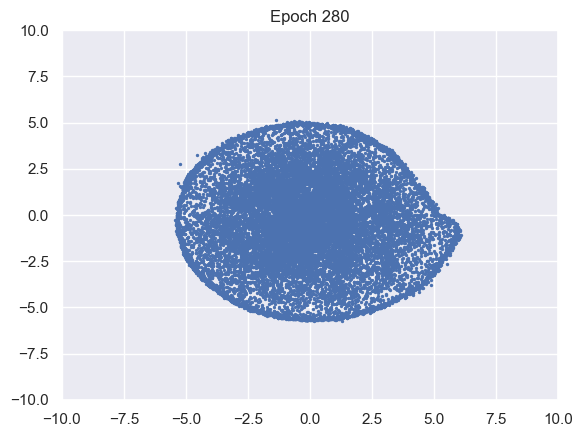

100%|██████████| 976/976 [00:10<00:00, 92.97it/s]


D loss : 1.3366, GP_loss : 0 G_loss : -0.7539, MI : 4.3358


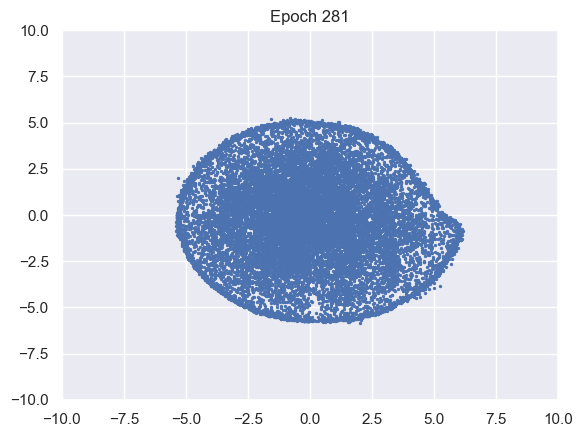

100%|██████████| 976/976 [00:10<00:00, 90.77it/s]


D loss : 1.3366, GP_loss : 0 G_loss : -0.754, MI : 4.3364


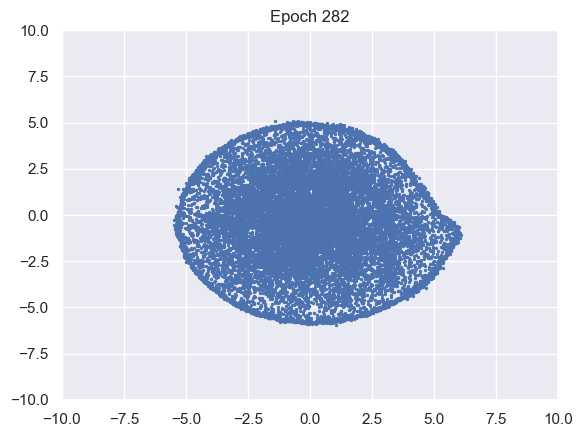

100%|██████████| 976/976 [00:10<00:00, 91.76it/s]


D loss : 1.3365, GP_loss : 0 G_loss : -0.7541, MI : 4.338


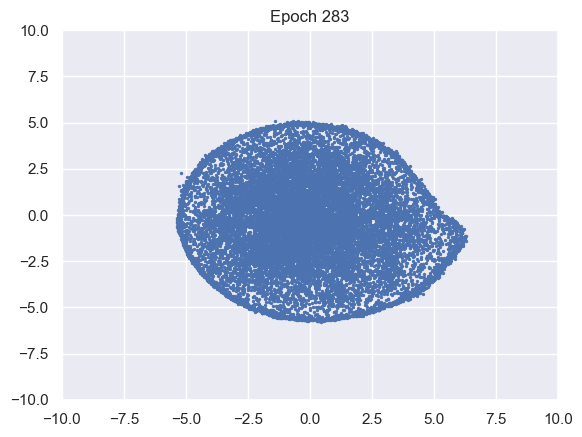

100%|██████████| 976/976 [00:10<00:00, 92.26it/s]


D loss : 1.3365, GP_loss : 0 G_loss : -0.7541, MI : 4.3394


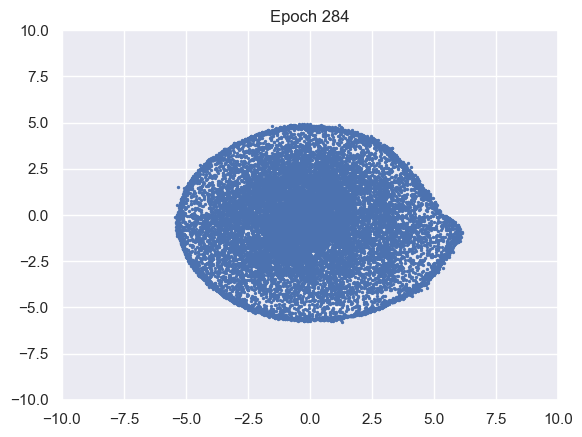

100%|██████████| 976/976 [00:10<00:00, 93.39it/s]


D loss : 1.3364, GP_loss : 0 G_loss : -0.7542, MI : 4.3401


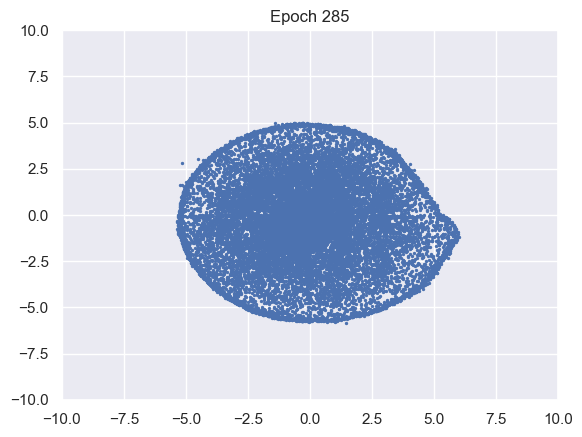

100%|██████████| 976/976 [00:10<00:00, 94.40it/s]


D loss : 1.3363, GP_loss : 0 G_loss : -0.7543, MI : 4.3411


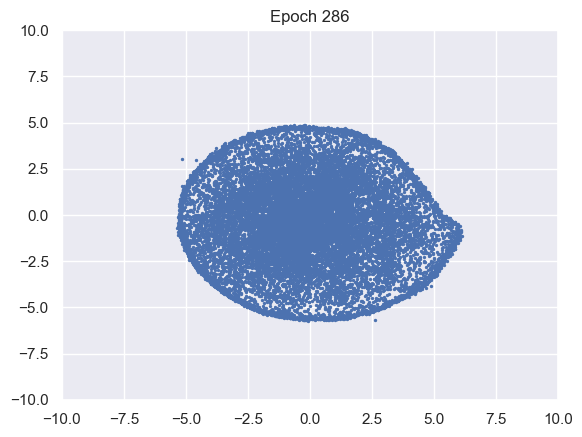

100%|██████████| 976/976 [00:10<00:00, 94.18it/s]


D loss : 1.3363, GP_loss : 0 G_loss : -0.7544, MI : 4.342


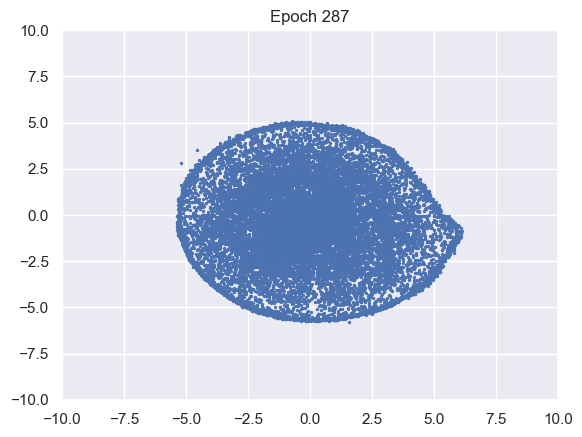

100%|██████████| 976/976 [00:10<00:00, 94.73it/s]


D loss : 1.3362, GP_loss : 0 G_loss : -0.7544, MI : 4.3433


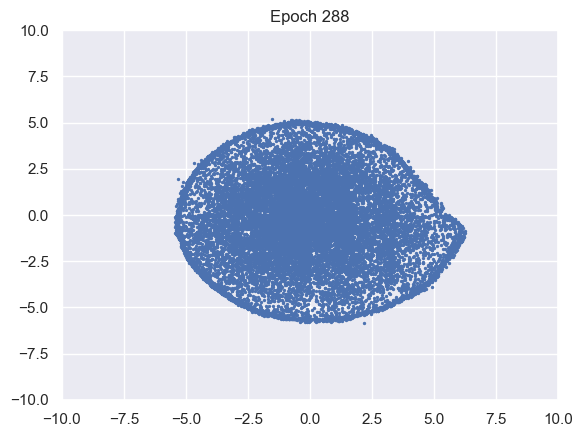

100%|██████████| 976/976 [00:10<00:00, 94.29it/s]


D loss : 1.3362, GP_loss : 0 G_loss : -0.7545, MI : 4.3445


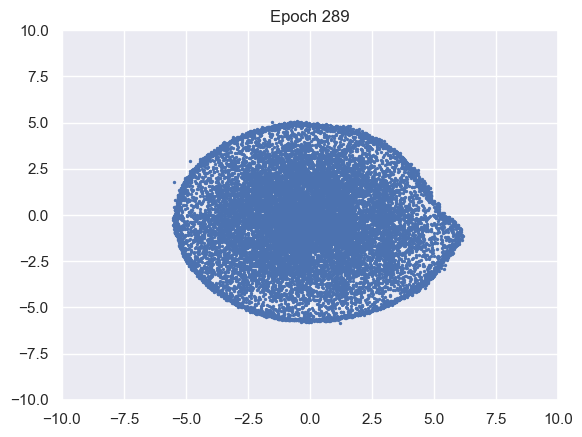

100%|██████████| 976/976 [00:10<00:00, 92.33it/s]


D loss : 1.3361, GP_loss : 0 G_loss : -0.7546, MI : 4.3443


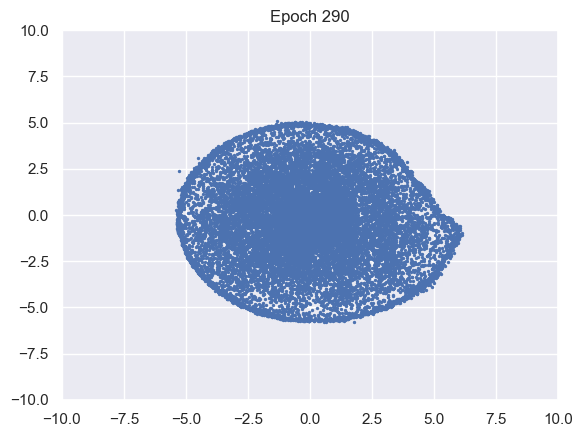

100%|██████████| 976/976 [00:10<00:00, 91.23it/s]


D loss : 1.3361, GP_loss : 0 G_loss : -0.7547, MI : 4.3455


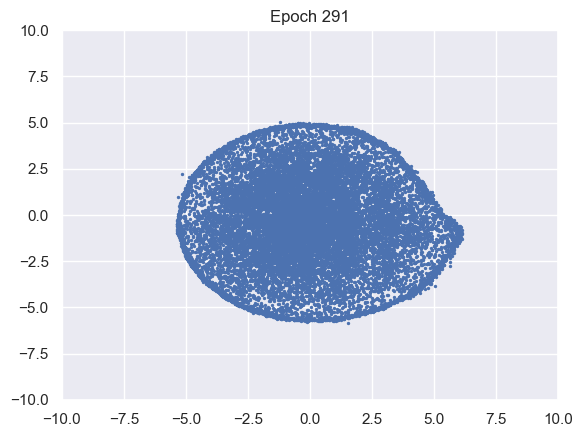

100%|██████████| 976/976 [00:10<00:00, 93.21it/s]


D loss : 1.336, GP_loss : 0 G_loss : -0.7547, MI : 4.3464


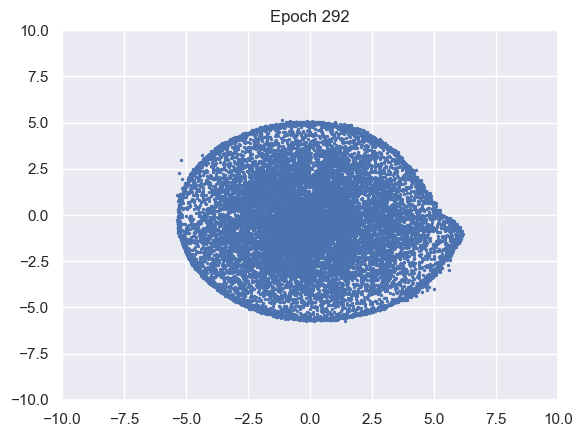

100%|██████████| 976/976 [00:10<00:00, 94.20it/s]


D loss : 1.336, GP_loss : 0 G_loss : -0.7548, MI : 4.3477


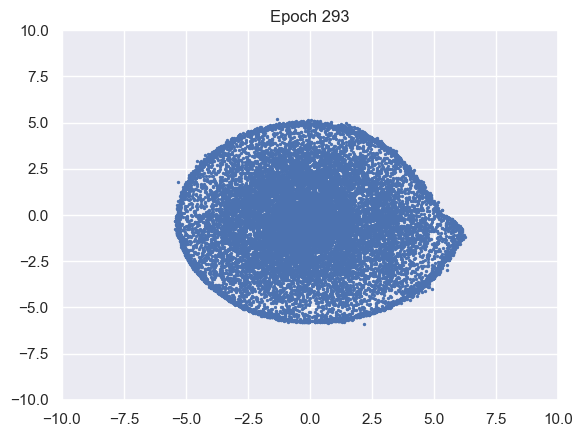

100%|██████████| 976/976 [00:10<00:00, 93.72it/s]


D loss : 1.3359, GP_loss : 0 G_loss : -0.7549, MI : 4.3486


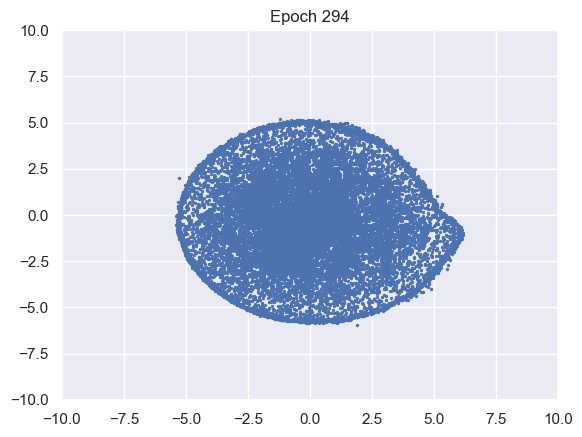

100%|██████████| 976/976 [00:10<00:00, 95.07it/s]


D loss : 1.3359, GP_loss : 0 G_loss : -0.7549, MI : 4.3495


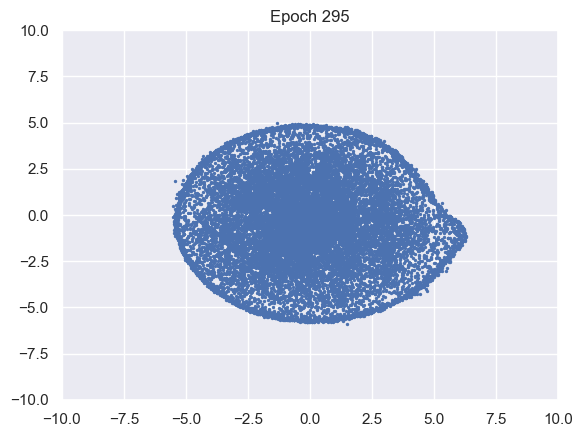

100%|██████████| 976/976 [00:10<00:00, 94.17it/s]


D loss : 1.3358, GP_loss : 0 G_loss : -0.755, MI : 4.3502


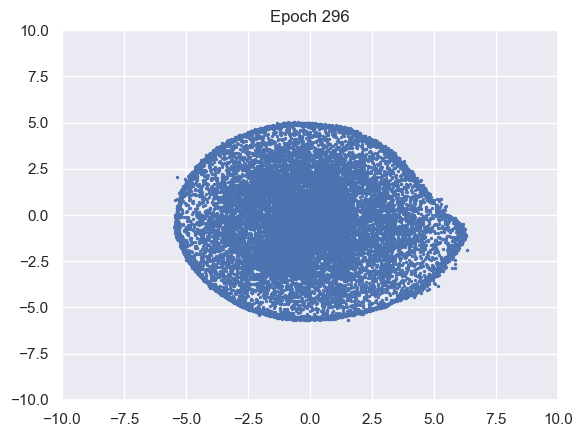

100%|██████████| 976/976 [00:10<00:00, 94.85it/s]


D loss : 1.3358, GP_loss : 0 G_loss : -0.7551, MI : 4.3517


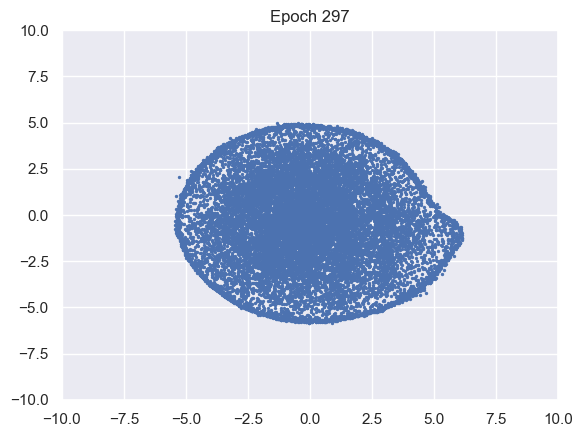

100%|██████████| 976/976 [00:10<00:00, 93.90it/s]


D loss : 1.3357, GP_loss : 0 G_loss : -0.7552, MI : 4.353


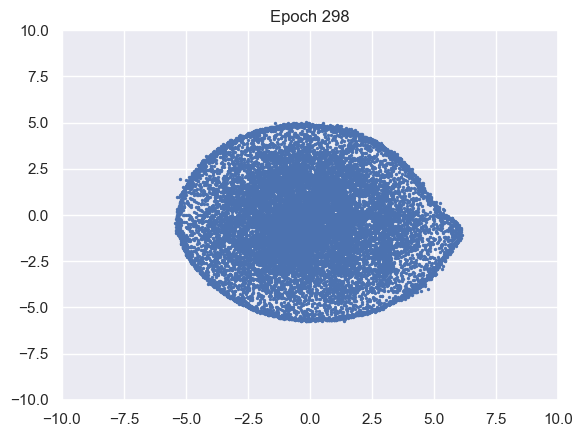

100%|██████████| 976/976 [00:10<00:00, 90.02it/s]


D loss : 1.3357, GP_loss : 0 G_loss : -0.7552, MI : 4.3543


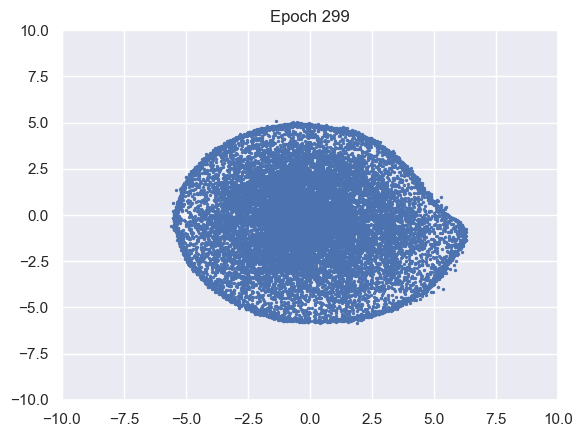

100%|██████████| 976/976 [00:10<00:00, 89.38it/s]


D loss : 1.3356, GP_loss : 0 G_loss : -0.7553, MI : 4.3562


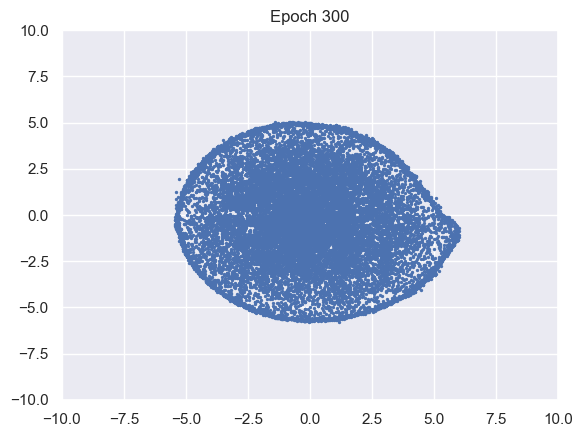

100%|██████████| 976/976 [00:10<00:00, 89.75it/s]


D loss : 1.3356, GP_loss : 0 G_loss : -0.7554, MI : 4.3573


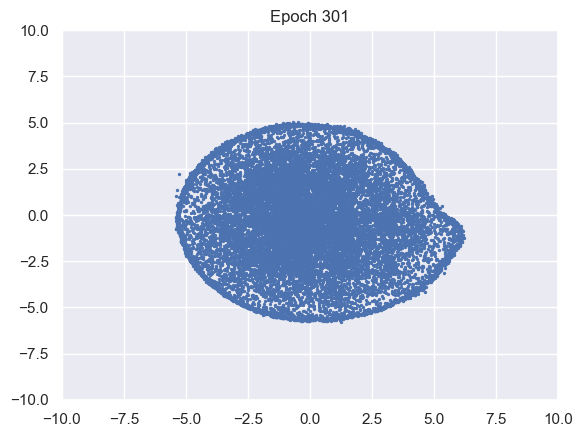

100%|██████████| 976/976 [00:10<00:00, 89.89it/s]


D loss : 1.3355, GP_loss : 0 G_loss : -0.7555, MI : 4.3584


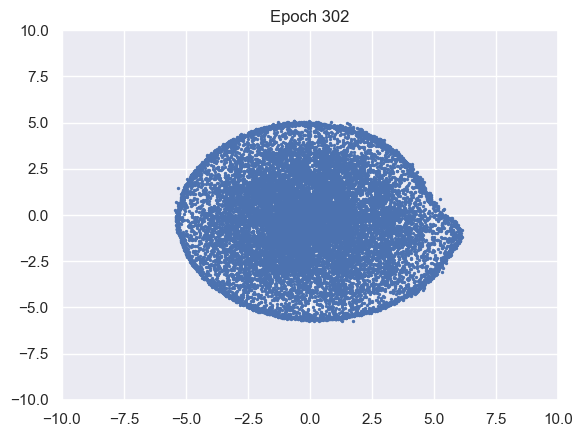

100%|██████████| 976/976 [00:10<00:00, 88.75it/s]


D loss : 1.3355, GP_loss : 0 G_loss : -0.7555, MI : 4.3598


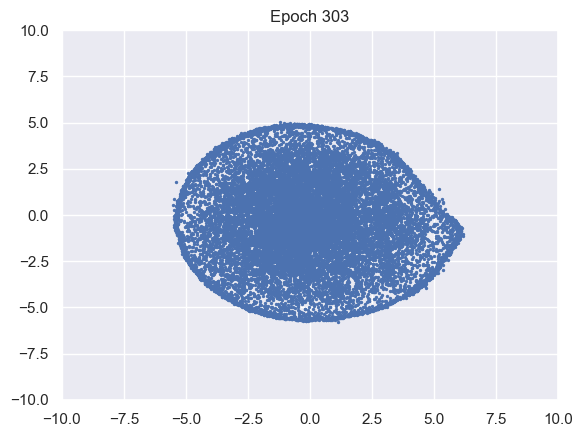

100%|██████████| 976/976 [00:11<00:00, 88.39it/s]


D loss : 1.3354, GP_loss : 0 G_loss : -0.7556, MI : 4.3598


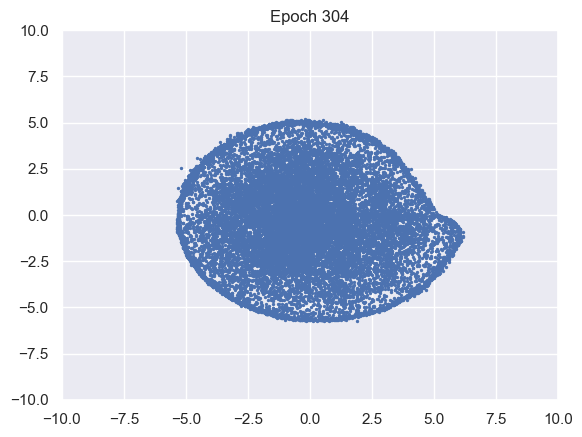

100%|██████████| 976/976 [00:11<00:00, 88.71it/s]


D loss : 1.3354, GP_loss : 0 G_loss : -0.7557, MI : 4.3612


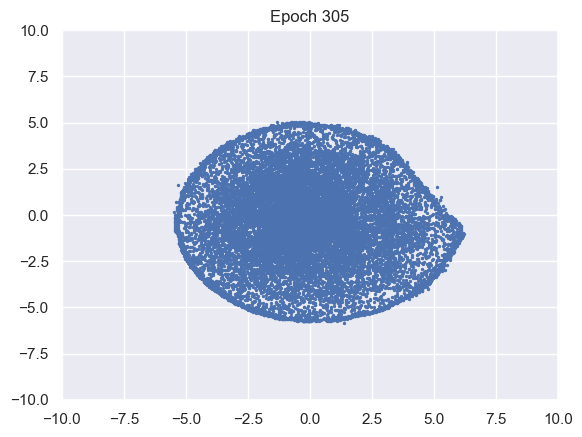

100%|██████████| 976/976 [00:10<00:00, 89.32it/s]


D loss : 1.3354, GP_loss : 0 G_loss : -0.7557, MI : 4.3626


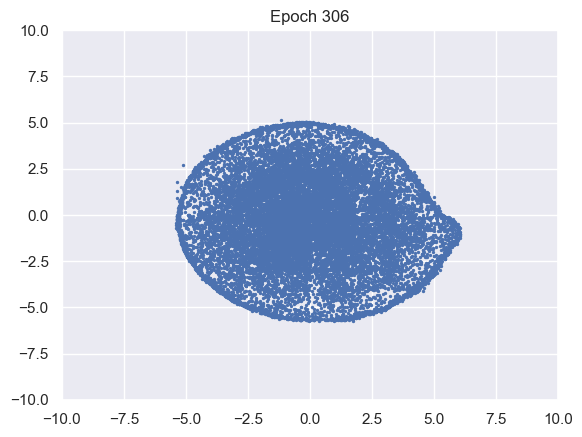

100%|██████████| 976/976 [00:10<00:00, 91.17it/s]


D loss : 1.3353, GP_loss : 0 G_loss : -0.7558, MI : 4.3638


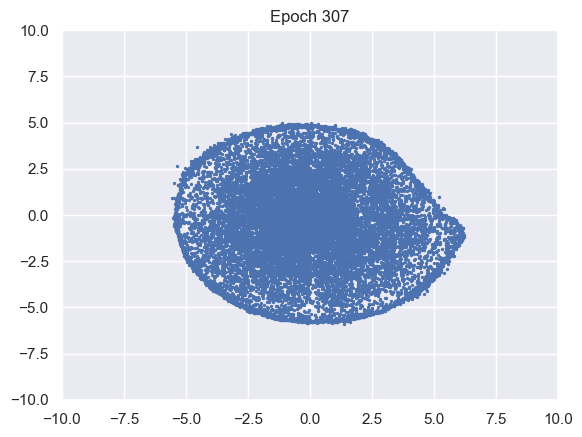

100%|██████████| 976/976 [00:10<00:00, 92.80it/s]


D loss : 1.3353, GP_loss : 0 G_loss : -0.7559, MI : 4.3654


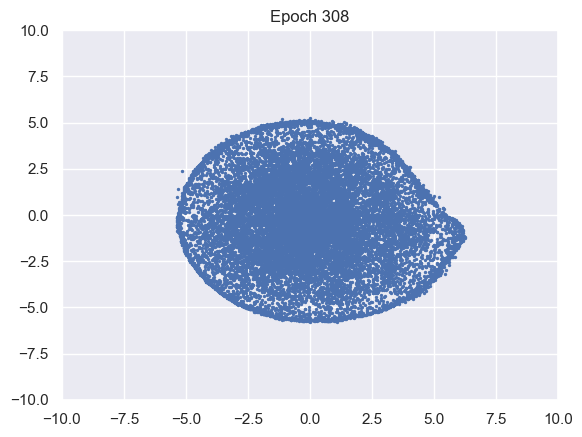

100%|██████████| 976/976 [00:10<00:00, 93.26it/s]


D loss : 1.3352, GP_loss : 0 G_loss : -0.7559, MI : 4.364


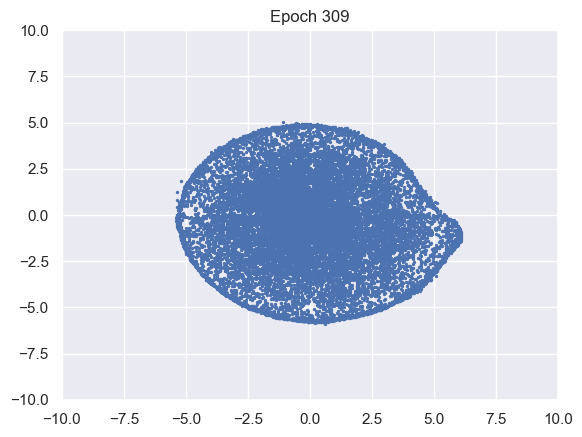

100%|██████████| 976/976 [00:10<00:00, 92.29it/s]


D loss : 1.3352, GP_loss : 0 G_loss : -0.756, MI : 4.3652


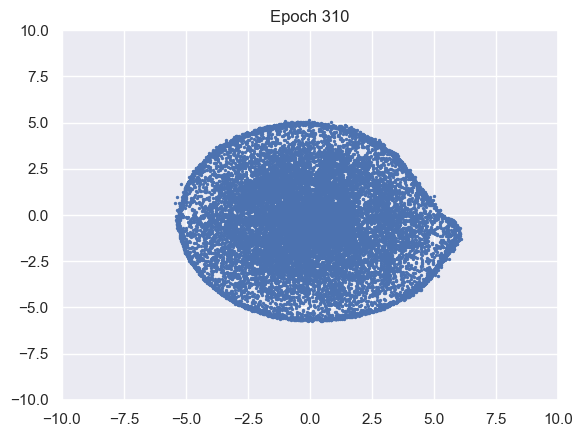

100%|██████████| 976/976 [00:10<00:00, 91.15it/s]


D loss : 1.3351, GP_loss : 0 G_loss : -0.7561, MI : 4.3664


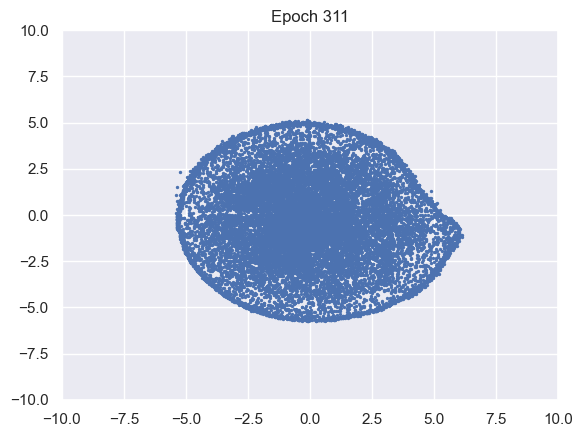

100%|██████████| 976/976 [00:10<00:00, 91.74it/s]


D loss : 1.3351, GP_loss : 0 G_loss : -0.7561, MI : 4.3679


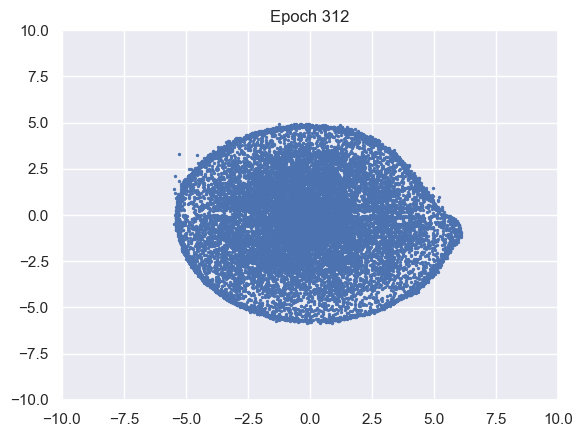

100%|██████████| 976/976 [00:10<00:00, 94.66it/s]


D loss : 1.335, GP_loss : 0 G_loss : -0.7562, MI : 4.3674


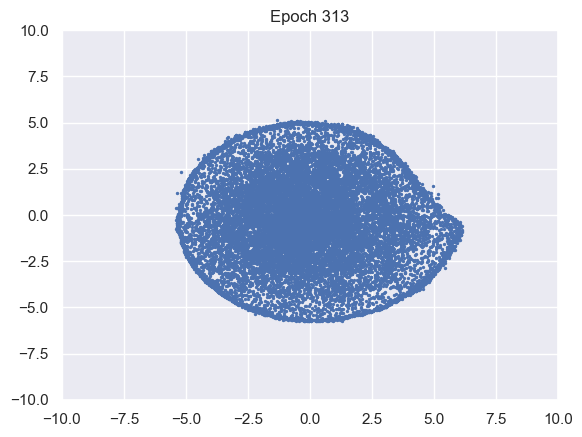

100%|██████████| 976/976 [00:10<00:00, 92.79it/s]


D loss : 1.335, GP_loss : 0 G_loss : -0.7563, MI : 4.3686


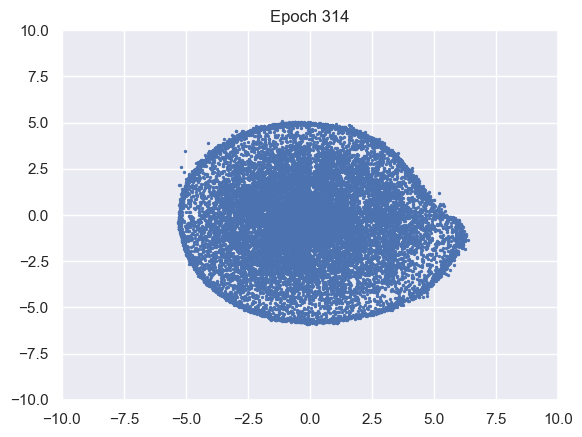

100%|██████████| 976/976 [00:10<00:00, 91.53it/s]


D loss : 1.335, GP_loss : 0 G_loss : -0.7563, MI : 4.3702


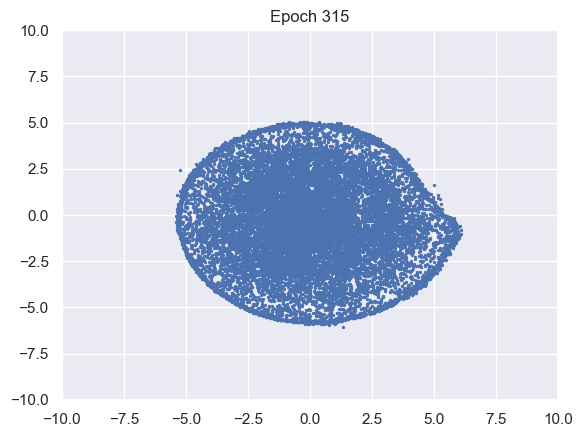

100%|██████████| 976/976 [00:10<00:00, 91.33it/s]


D loss : 1.3349, GP_loss : 0 G_loss : -0.7564, MI : 4.372


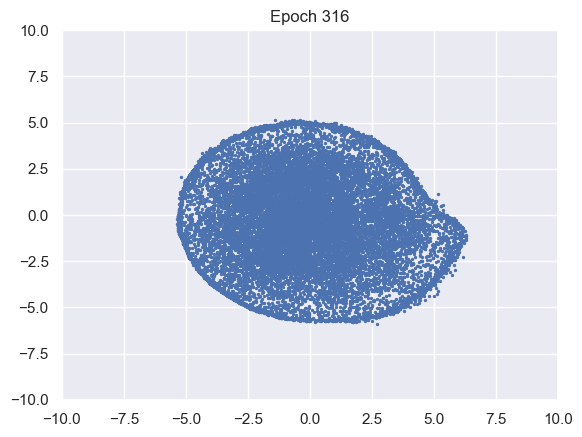

100%|██████████| 976/976 [00:10<00:00, 90.50it/s]


D loss : 1.3349, GP_loss : 0 G_loss : -0.7565, MI : 4.3729


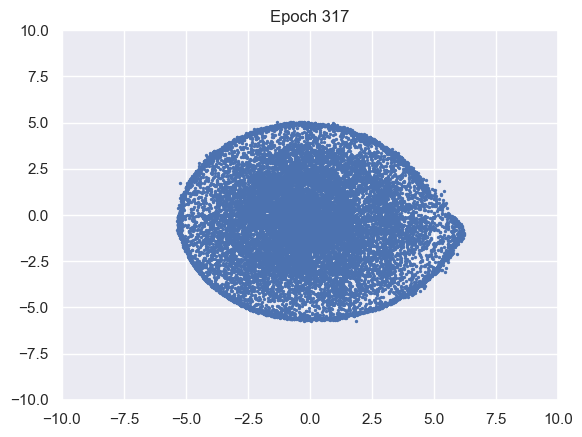

100%|██████████| 976/976 [00:10<00:00, 92.28it/s]


D loss : 1.3348, GP_loss : 0 G_loss : -0.7565, MI : 4.3739


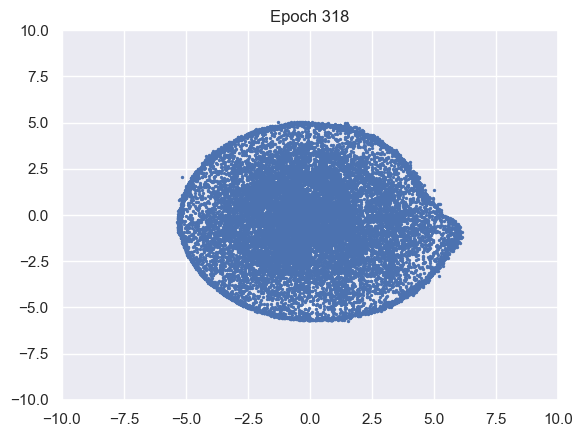

100%|██████████| 976/976 [00:10<00:00, 94.66it/s]


D loss : 1.3348, GP_loss : 0 G_loss : -0.7566, MI : 4.375


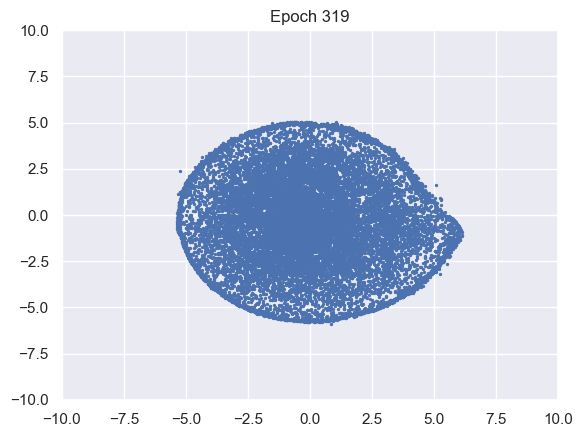

100%|██████████| 976/976 [00:10<00:00, 92.87it/s]


D loss : 1.3348, GP_loss : 0 G_loss : -0.7567, MI : 4.3756


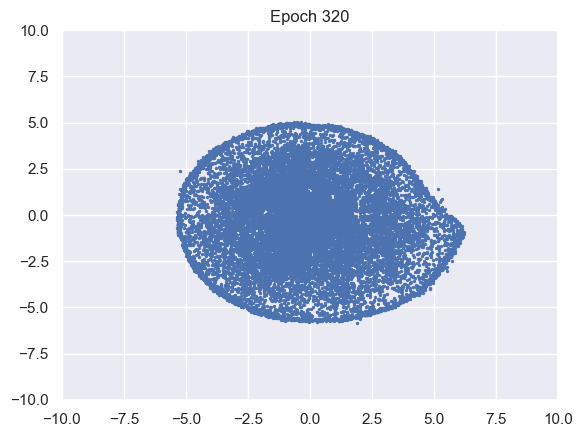

100%|██████████| 976/976 [00:10<00:00, 91.55it/s]


D loss : 1.3347, GP_loss : 0 G_loss : -0.7567, MI : 4.3763


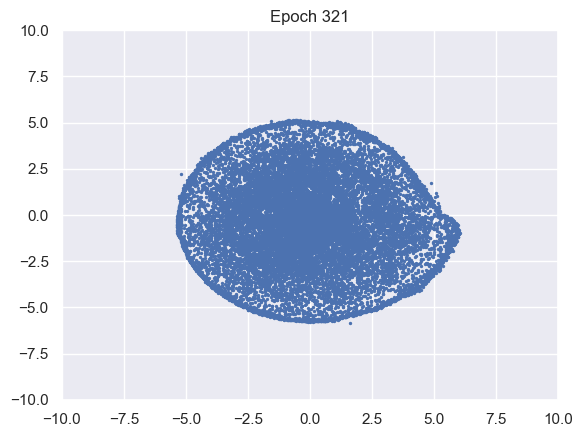

100%|██████████| 976/976 [00:10<00:00, 94.08it/s]


D loss : 1.3347, GP_loss : 0 G_loss : -0.7568, MI : 4.3775


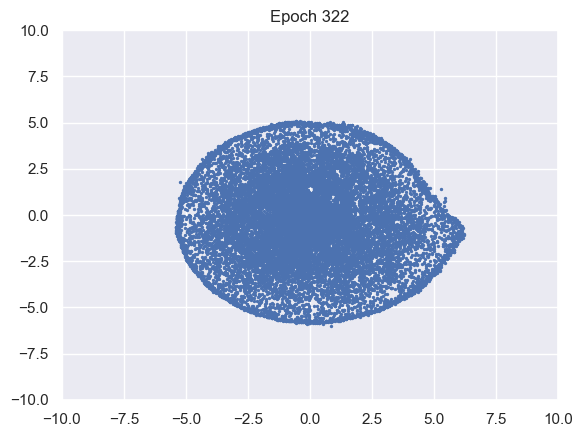

100%|██████████| 976/976 [00:10<00:00, 92.78it/s]


D loss : 1.3346, GP_loss : 0 G_loss : -0.7568, MI : 4.3791


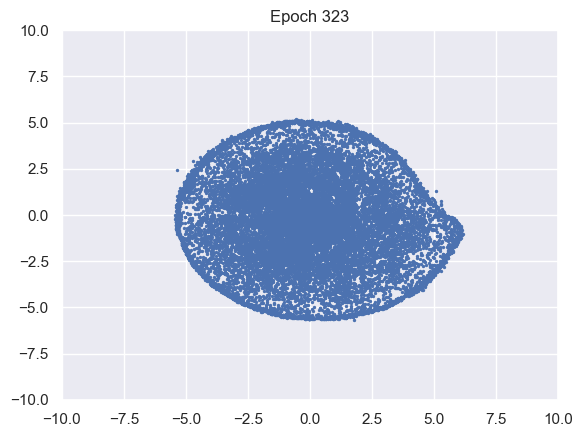

100%|██████████| 976/976 [00:10<00:00, 94.79it/s]


D loss : 1.3346, GP_loss : 0 G_loss : -0.7569, MI : 4.38


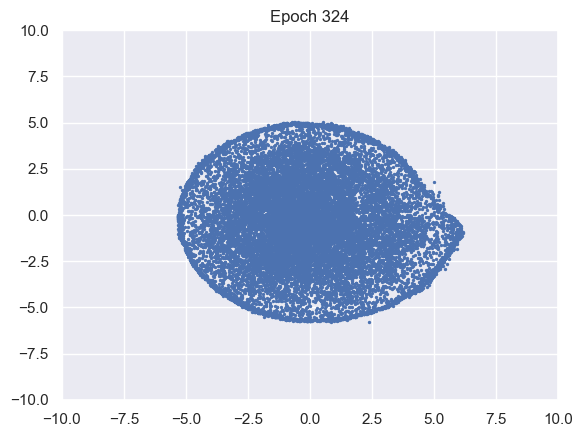

100%|██████████| 976/976 [00:10<00:00, 96.06it/s]


D loss : 1.3346, GP_loss : 0 G_loss : -0.757, MI : 4.3817


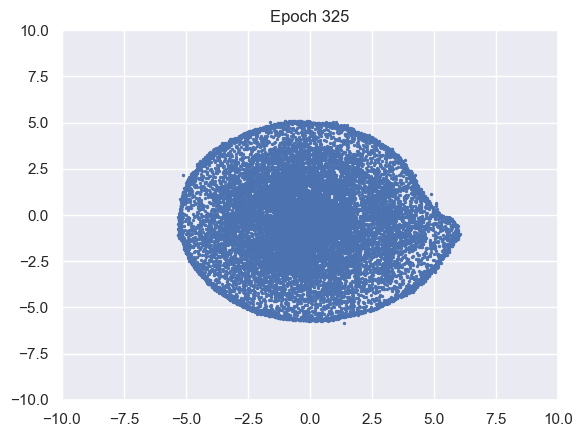

100%|██████████| 976/976 [00:10<00:00, 95.43it/s]


D loss : 1.3345, GP_loss : 0 G_loss : -0.757, MI : 4.382


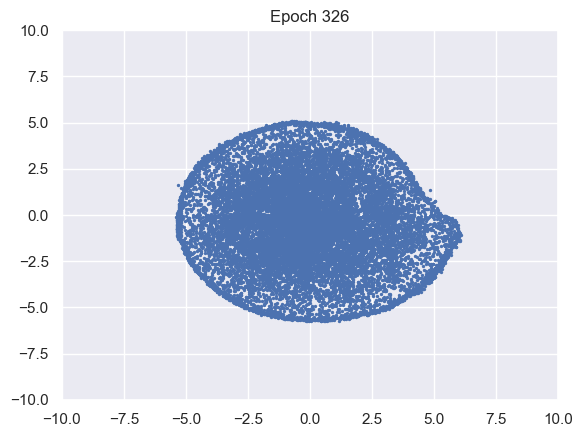

100%|██████████| 976/976 [00:10<00:00, 94.54it/s]


D loss : 1.3345, GP_loss : 0 G_loss : -0.7571, MI : 4.3822


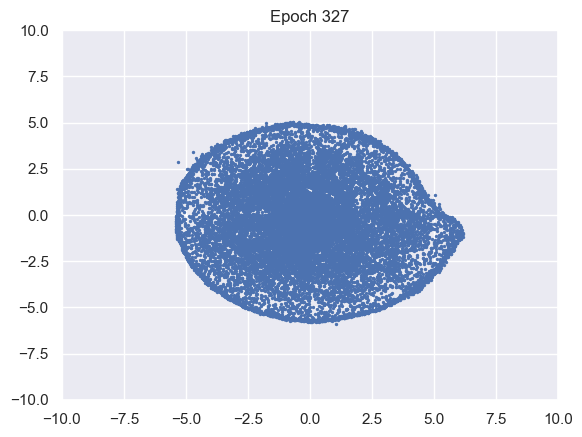

100%|██████████| 976/976 [00:10<00:00, 95.29it/s]


D loss : 1.3345, GP_loss : 0 G_loss : -0.7571, MI : 4.3837


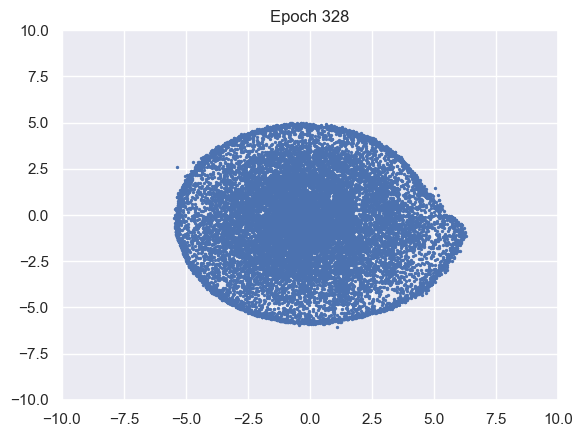

100%|██████████| 976/976 [00:10<00:00, 96.33it/s]


D loss : 1.3344, GP_loss : 0 G_loss : -0.7572, MI : 4.3845


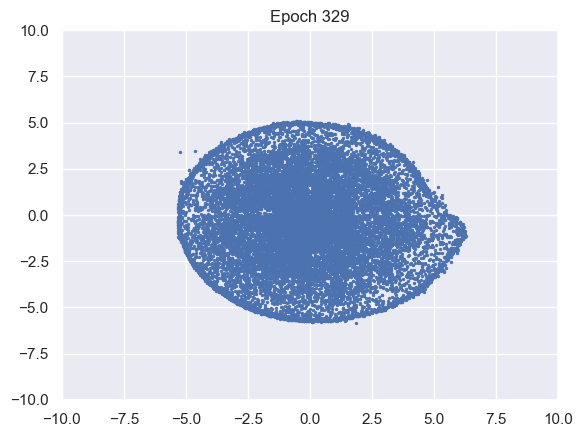

100%|██████████| 976/976 [00:10<00:00, 95.35it/s]


D loss : 1.3344, GP_loss : 0 G_loss : -0.7573, MI : 4.3856


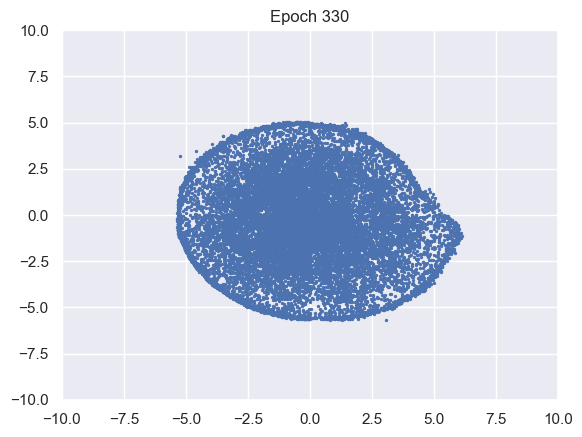

100%|██████████| 976/976 [00:10<00:00, 94.65it/s]


D loss : 1.3343, GP_loss : 0 G_loss : -0.7573, MI : 4.3863


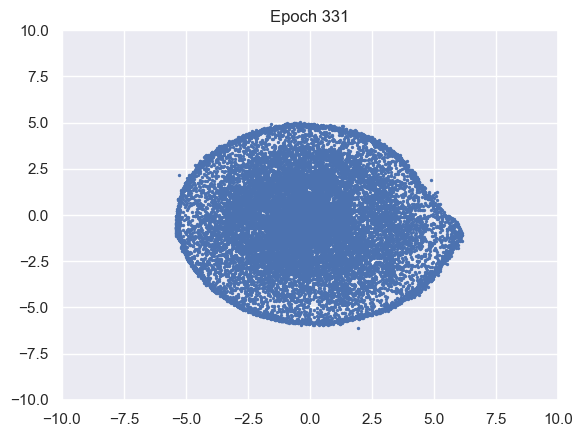

100%|██████████| 976/976 [00:10<00:00, 95.14it/s]


D loss : 1.3343, GP_loss : 0 G_loss : -0.7574, MI : 4.387


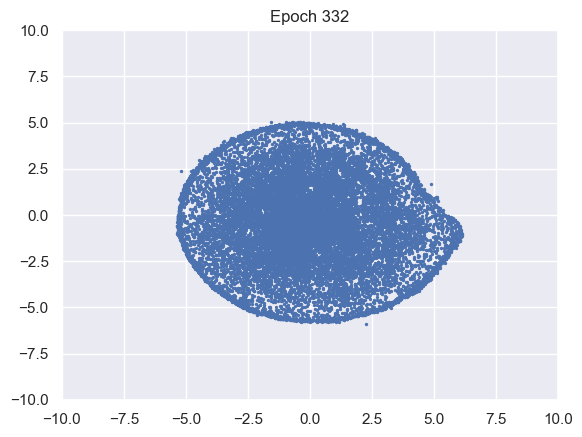

100%|██████████| 976/976 [00:10<00:00, 95.34it/s]


D loss : 1.3343, GP_loss : 0 G_loss : -0.7574, MI : 4.3881


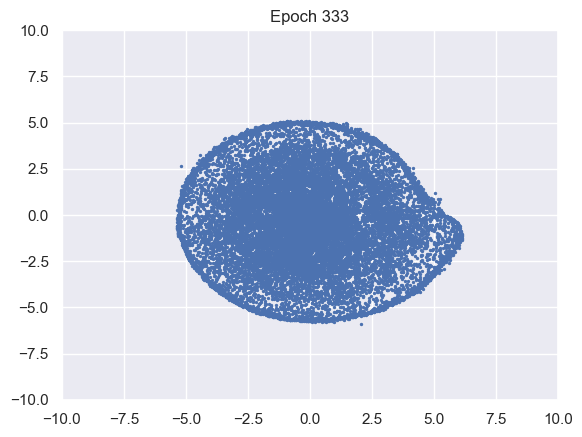

100%|██████████| 976/976 [00:10<00:00, 95.80it/s]


D loss : 1.3342, GP_loss : 0 G_loss : -0.7575, MI : 4.3895


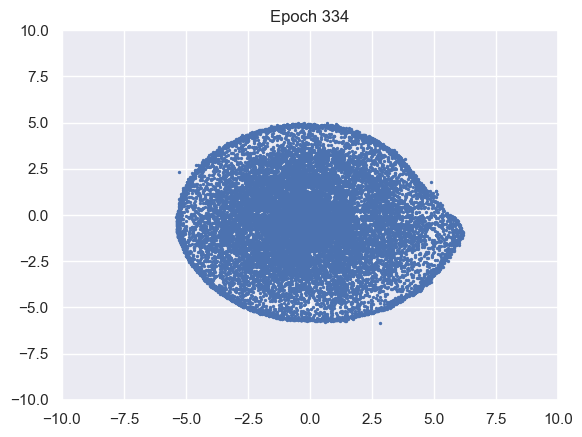

100%|██████████| 976/976 [00:10<00:00, 91.81it/s]


D loss : 1.3342, GP_loss : 0 G_loss : -0.7575, MI : 4.3904


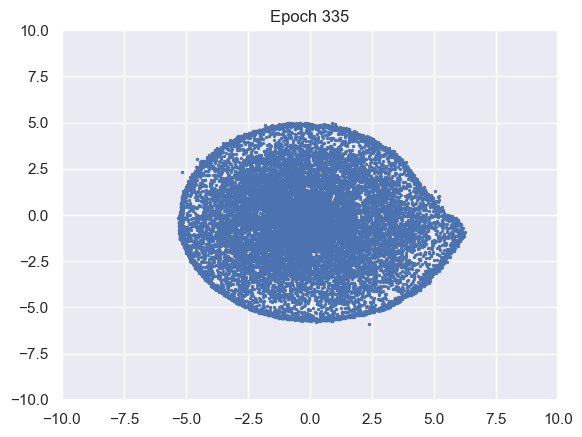

100%|██████████| 976/976 [00:10<00:00, 93.25it/s]


D loss : 1.3342, GP_loss : 0 G_loss : -0.7576, MI : 4.391


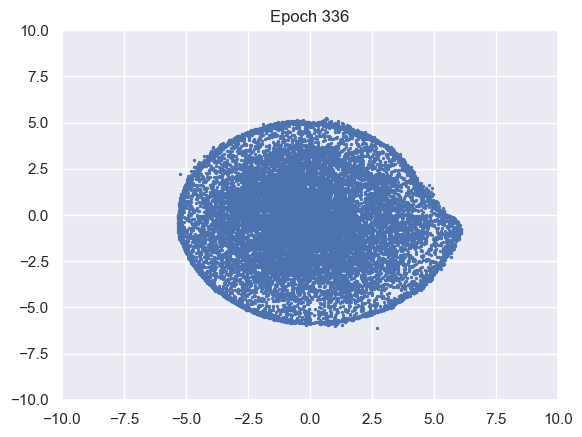

100%|██████████| 976/976 [00:10<00:00, 91.92it/s]


D loss : 1.3341, GP_loss : 0 G_loss : -0.7576, MI : 4.3917


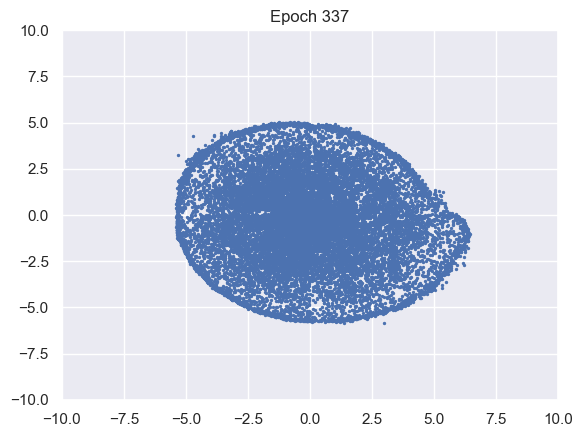

100%|██████████| 976/976 [00:10<00:00, 91.54it/s]


D loss : 1.3341, GP_loss : 0 G_loss : -0.7577, MI : 4.3931


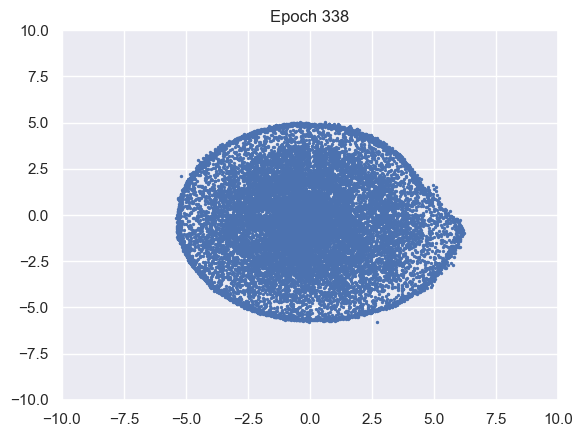

100%|██████████| 976/976 [00:10<00:00, 90.95it/s]


D loss : 1.3341, GP_loss : 0 G_loss : -0.7578, MI : 4.394


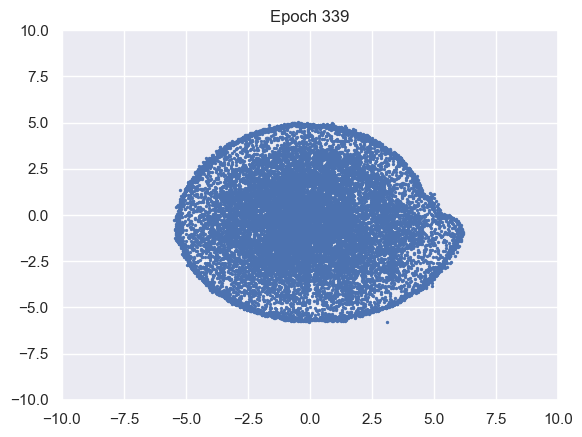

100%|██████████| 976/976 [00:10<00:00, 92.40it/s]


D loss : 1.3341, GP_loss : 0 G_loss : -0.7578, MI : 4.3951


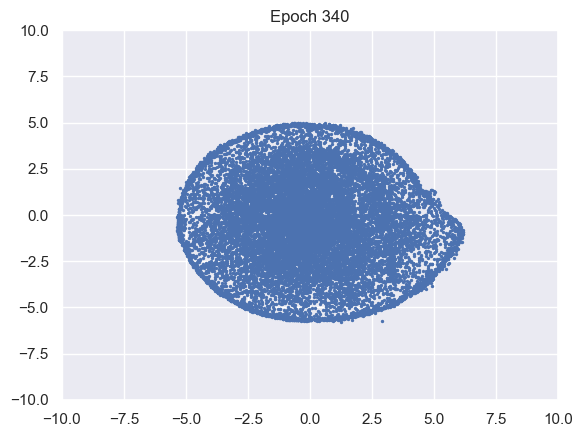

100%|██████████| 976/976 [00:10<00:00, 92.55it/s]


D loss : 1.334, GP_loss : 0 G_loss : -0.7579, MI : 4.396


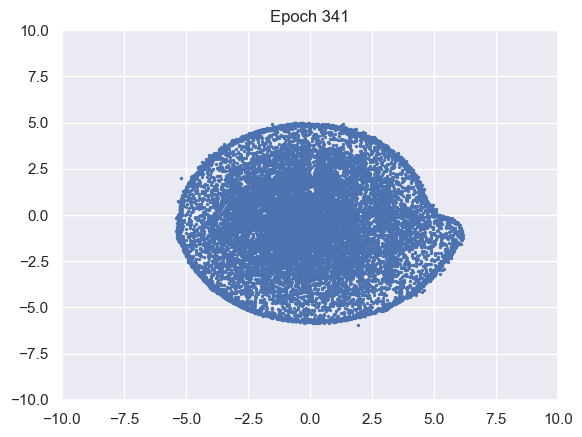

100%|██████████| 976/976 [00:10<00:00, 92.95it/s]


D loss : 1.334, GP_loss : 0 G_loss : -0.7579, MI : 4.3971


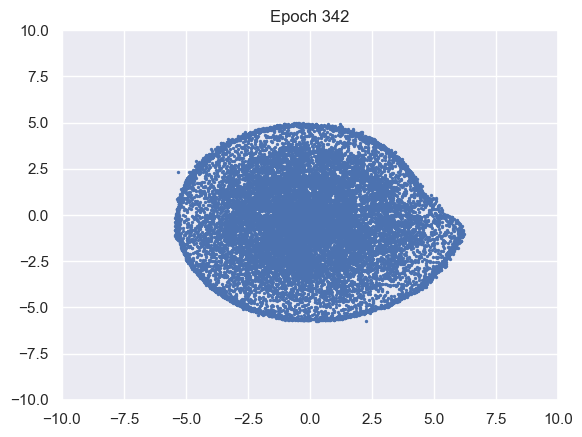

100%|██████████| 976/976 [00:10<00:00, 92.55it/s]


D loss : 1.334, GP_loss : 0 G_loss : -0.758, MI : 4.3983


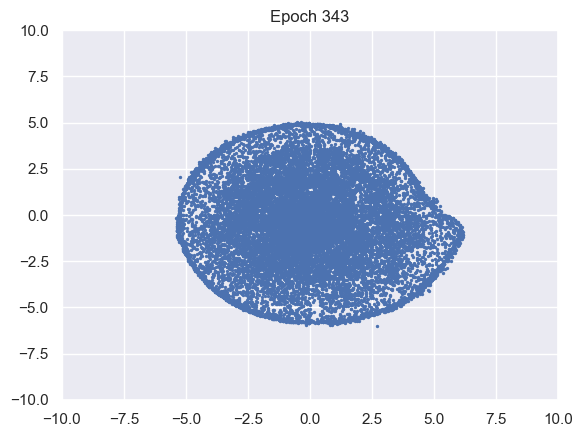

100%|██████████| 976/976 [00:10<00:00, 94.07it/s]


D loss : 1.3339, GP_loss : 0 G_loss : -0.758, MI : 4.3992


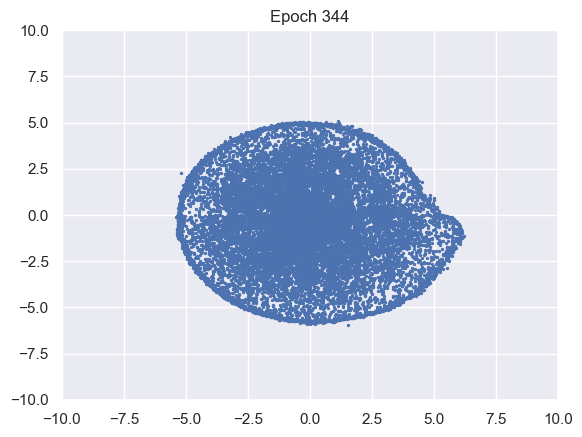

100%|██████████| 976/976 [00:10<00:00, 92.85it/s]


D loss : 1.3339, GP_loss : 0 G_loss : -0.7581, MI : 4.4009


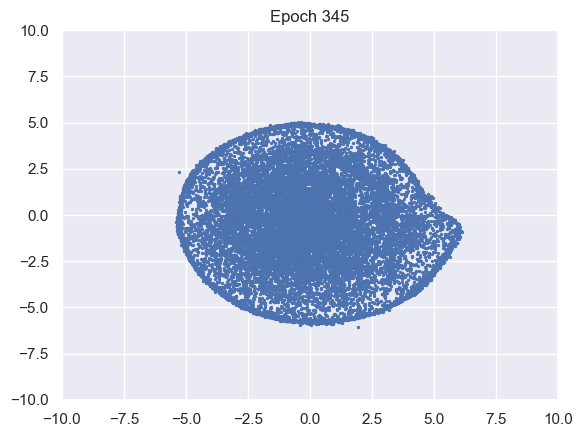

100%|██████████| 976/976 [00:10<00:00, 91.77it/s]


D loss : 1.3339, GP_loss : 0 G_loss : -0.7581, MI : 4.4015


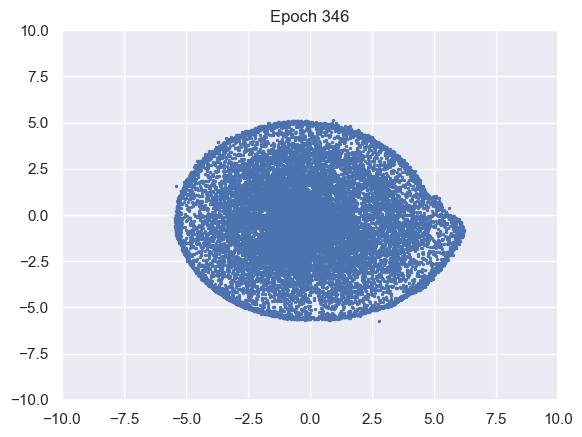

100%|██████████| 976/976 [00:10<00:00, 93.27it/s]


D loss : 1.3339, GP_loss : 0 G_loss : -0.7582, MI : 4.4013


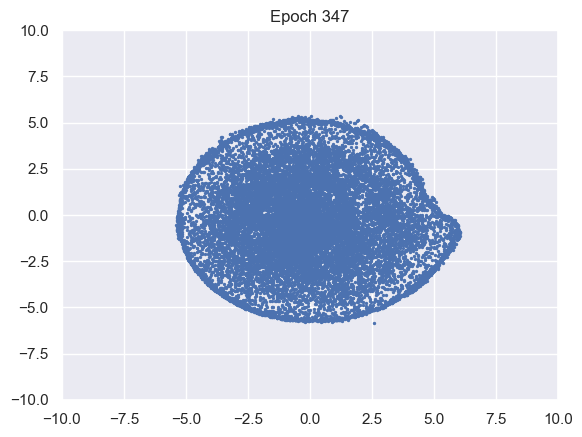

100%|██████████| 976/976 [00:10<00:00, 93.87it/s]


D loss : 1.3338, GP_loss : 0 G_loss : -0.7582, MI : 4.4022


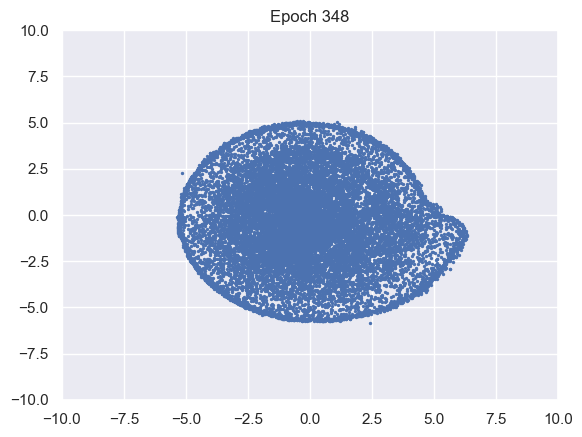

100%|██████████| 976/976 [00:10<00:00, 95.75it/s]


D loss : 1.3338, GP_loss : 0 G_loss : -0.7583, MI : 4.4031


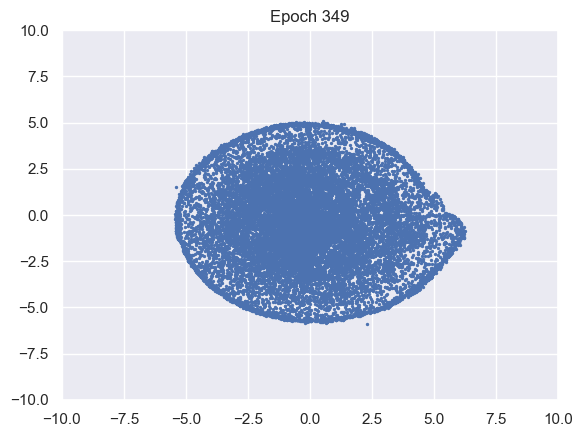

100%|██████████| 976/976 [00:10<00:00, 94.57it/s]


D loss : 1.3338, GP_loss : 0 G_loss : -0.7583, MI : 4.4044


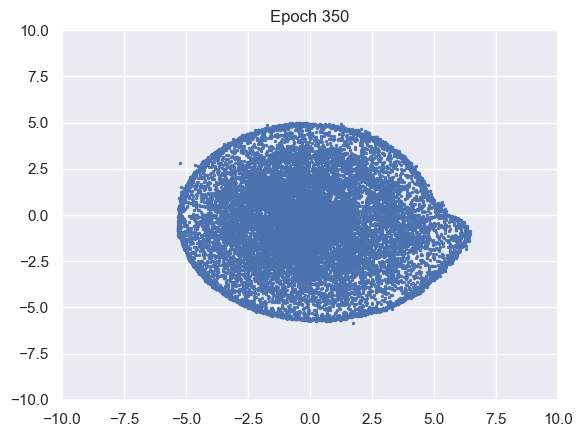

100%|██████████| 976/976 [00:10<00:00, 94.34it/s]


D loss : 1.3338, GP_loss : 0 G_loss : -0.7584, MI : 4.4051


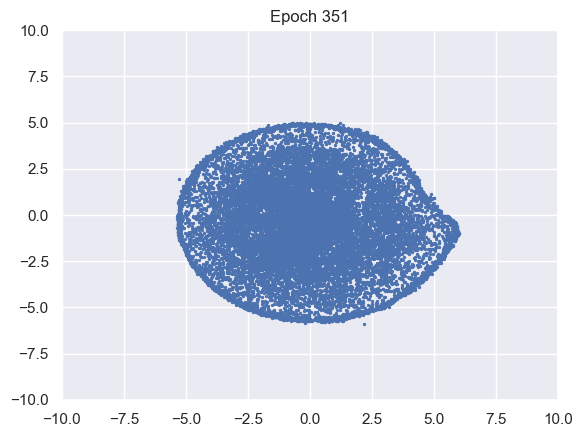

100%|██████████| 976/976 [00:10<00:00, 95.61it/s]


D loss : 1.3337, GP_loss : 0 G_loss : -0.7584, MI : 4.4062


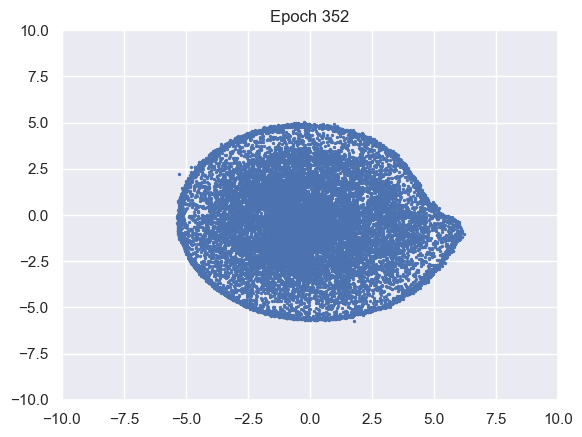

100%|██████████| 976/976 [00:10<00:00, 95.41it/s]


D loss : 1.3337, GP_loss : 0 G_loss : -0.7585, MI : 4.4071


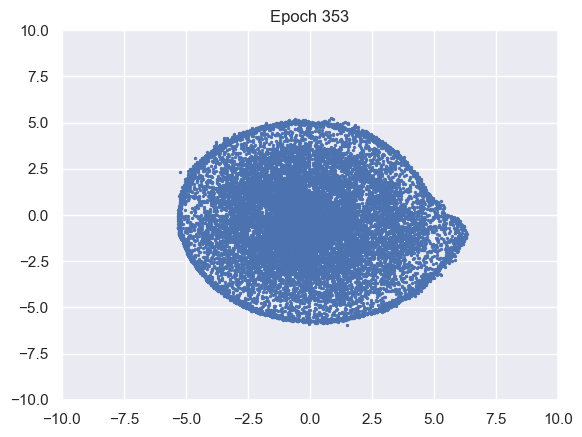

100%|██████████| 976/976 [00:10<00:00, 95.60it/s]


D loss : 1.3337, GP_loss : 0 G_loss : -0.7585, MI : 4.4081


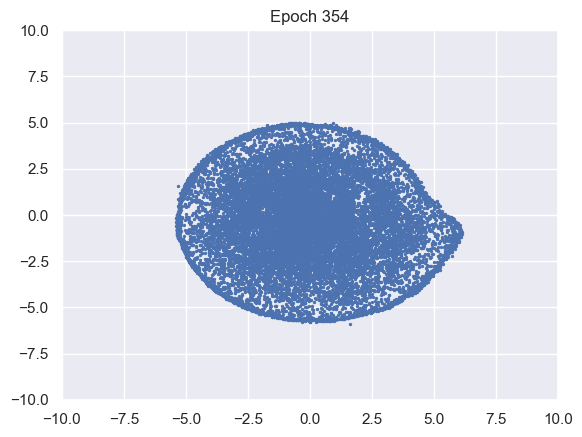

100%|██████████| 976/976 [00:10<00:00, 96.02it/s]


D loss : 1.3337, GP_loss : 0 G_loss : -0.7586, MI : 4.4086


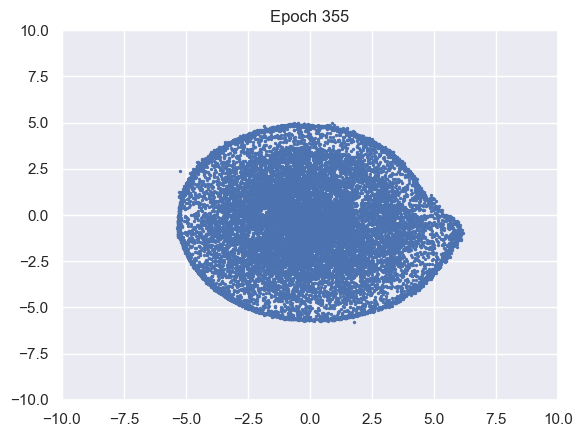

100%|██████████| 976/976 [00:10<00:00, 95.80it/s]


D loss : 1.3336, GP_loss : 0 G_loss : -0.7586, MI : 4.4094


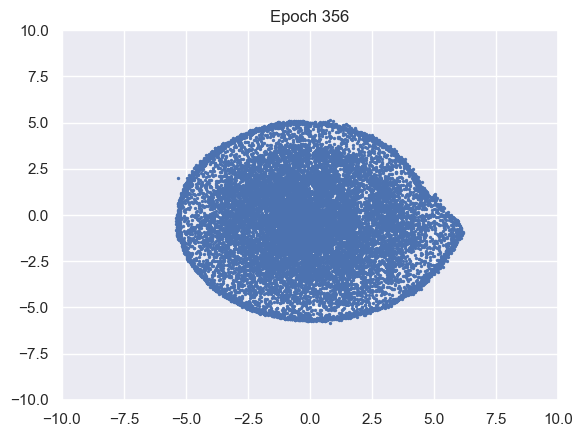

100%|██████████| 976/976 [00:10<00:00, 97.43it/s]


D loss : 1.3336, GP_loss : 0 G_loss : -0.7587, MI : 4.4099


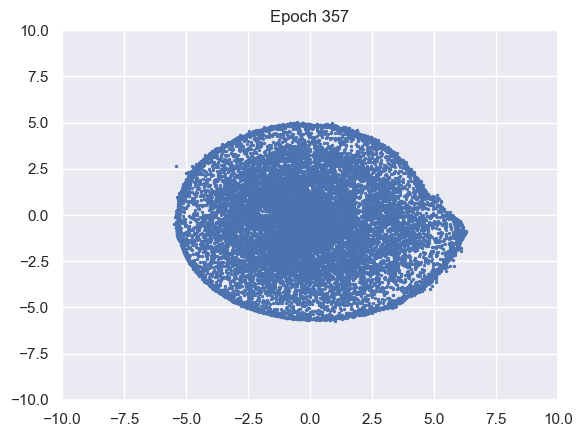

100%|██████████| 976/976 [00:10<00:00, 96.79it/s]


D loss : 1.3336, GP_loss : 0 G_loss : -0.7587, MI : 4.4108


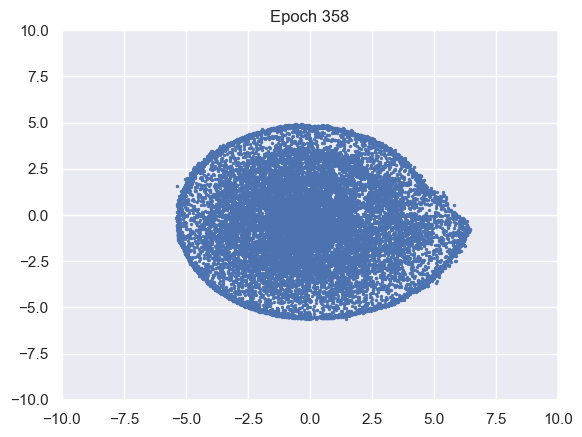

100%|██████████| 976/976 [00:10<00:00, 96.90it/s] 


D loss : 1.3336, GP_loss : 0 G_loss : -0.7588, MI : 4.4119


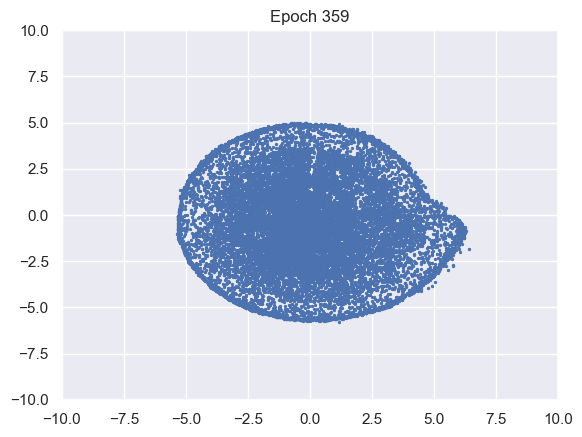

100%|██████████| 976/976 [00:10<00:00, 95.61it/s]


D loss : 1.3335, GP_loss : 0 G_loss : -0.7588, MI : 4.4129


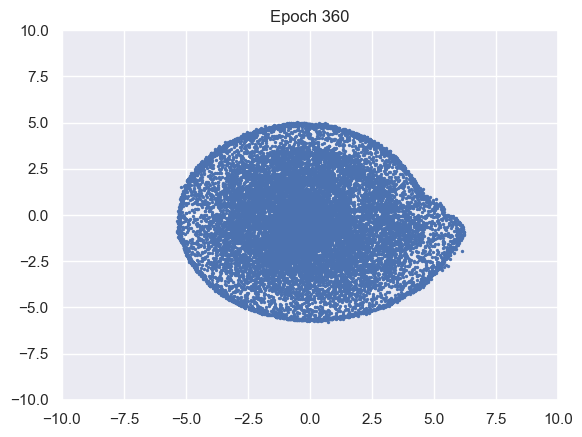

100%|██████████| 976/976 [00:10<00:00, 97.33it/s]


D loss : 1.3335, GP_loss : 0 G_loss : -0.7589, MI : 4.4135


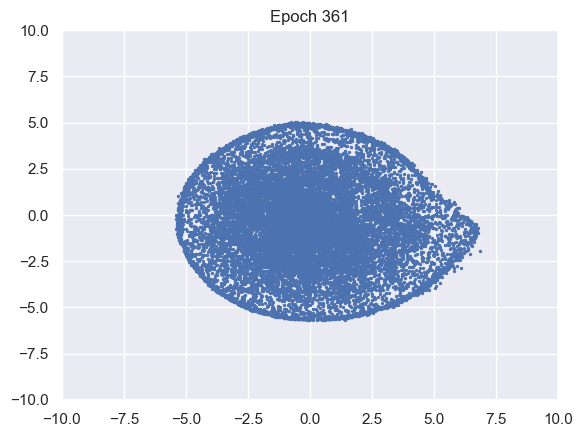

100%|██████████| 976/976 [00:10<00:00, 96.28it/s]


D loss : 1.3335, GP_loss : 0 G_loss : -0.7589, MI : 4.414


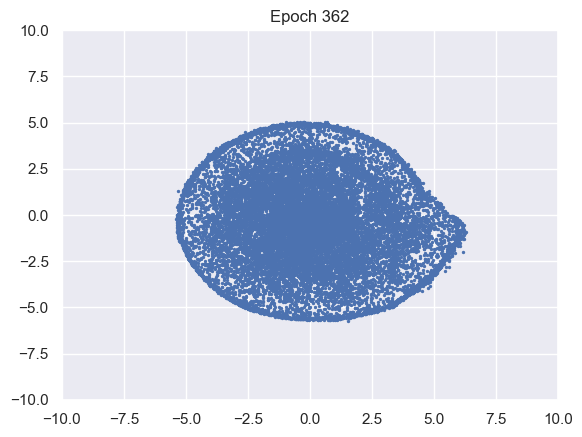

100%|██████████| 976/976 [00:09<00:00, 98.10it/s]


D loss : 1.3335, GP_loss : 0 G_loss : -0.759, MI : 4.4145


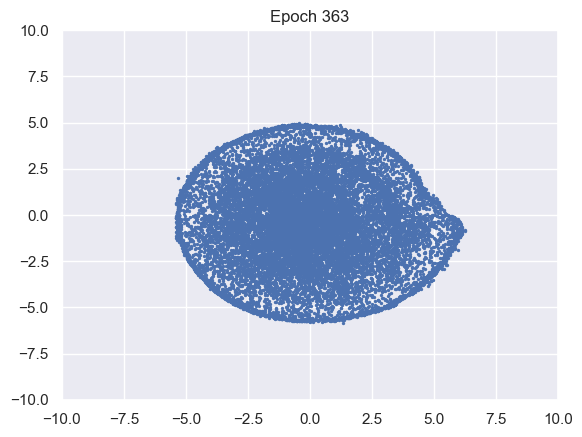

100%|██████████| 976/976 [00:10<00:00, 97.25it/s]


D loss : 1.3335, GP_loss : 0 G_loss : -0.759, MI : 4.4154


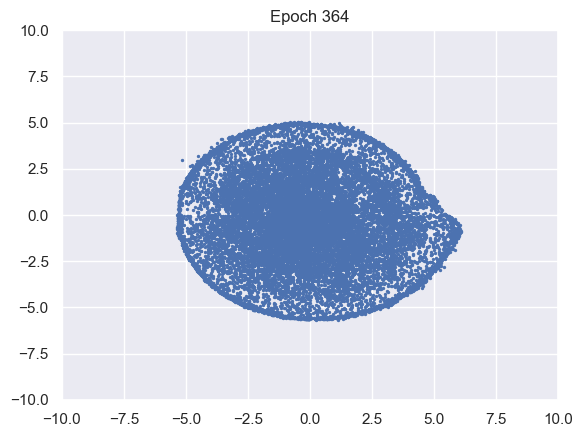

100%|██████████| 976/976 [00:10<00:00, 97.42it/s] 


D loss : 1.3334, GP_loss : 0 G_loss : -0.7591, MI : 4.4165


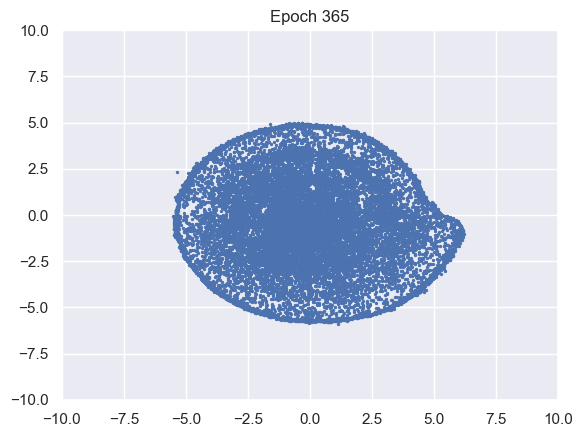

100%|██████████| 976/976 [00:09<00:00, 97.62it/s]


D loss : 1.3334, GP_loss : 0 G_loss : -0.7591, MI : 4.4176


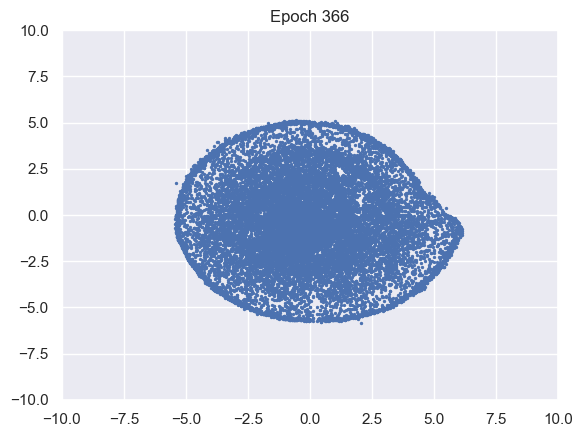

100%|██████████| 976/976 [00:10<00:00, 97.22it/s]


D loss : 1.3334, GP_loss : 0 G_loss : -0.7592, MI : 4.4183


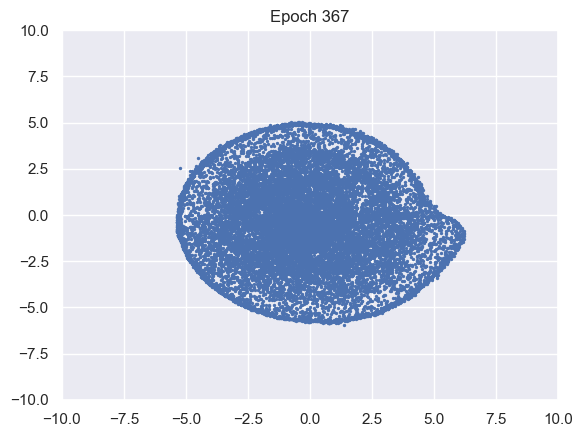

100%|██████████| 976/976 [00:10<00:00, 97.47it/s]


D loss : 1.3334, GP_loss : 0 G_loss : -0.7592, MI : 4.419


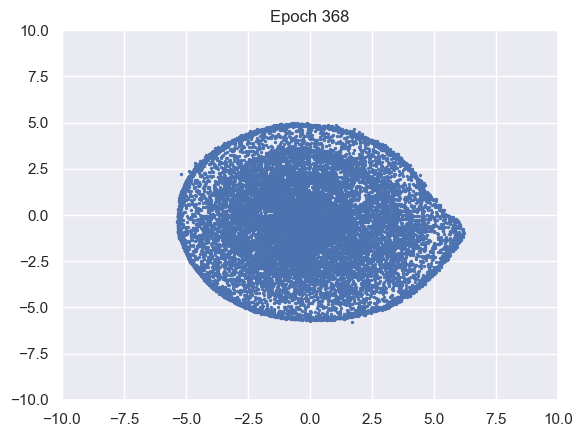

100%|██████████| 976/976 [00:09<00:00, 97.91it/s]


D loss : 1.3334, GP_loss : 0 G_loss : -0.7592, MI : 4.4197


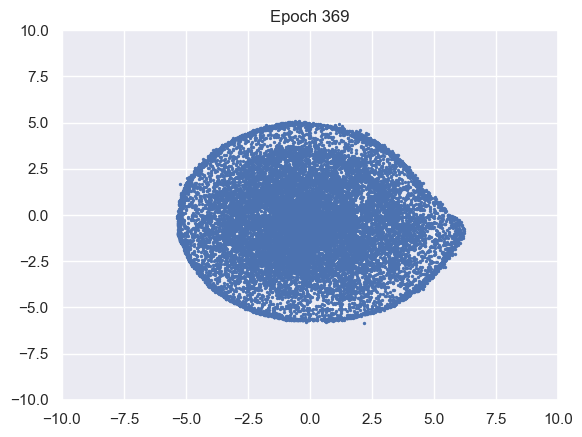

100%|██████████| 976/976 [00:10<00:00, 95.89it/s]


D loss : 1.3333, GP_loss : 0 G_loss : -0.7593, MI : 4.4207


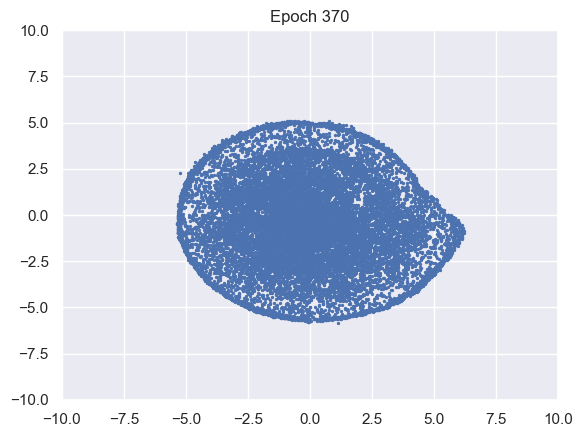

100%|██████████| 976/976 [00:10<00:00, 94.83it/s]


D loss : 1.3333, GP_loss : 0 G_loss : -0.7593, MI : 4.4211


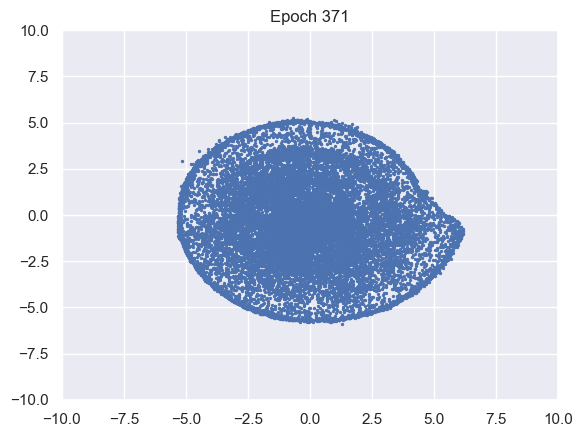

100%|██████████| 976/976 [00:10<00:00, 96.39it/s]


D loss : 1.3333, GP_loss : 0 G_loss : -0.7594, MI : 4.4221


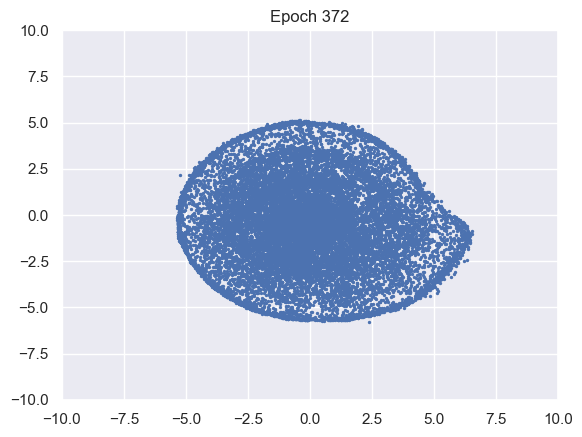

100%|██████████| 976/976 [00:10<00:00, 96.55it/s]


D loss : 1.3333, GP_loss : 0 G_loss : -0.7594, MI : 4.4234


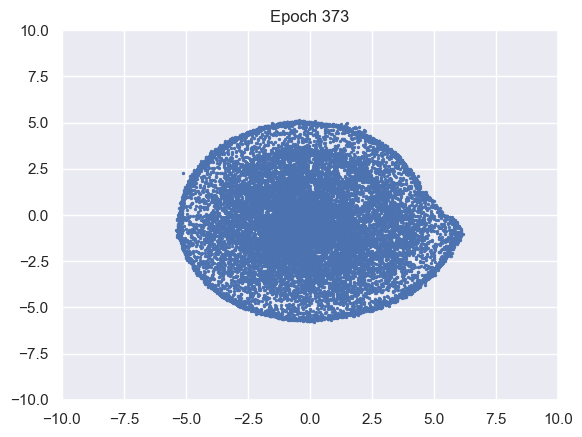

100%|██████████| 976/976 [00:10<00:00, 91.77it/s]


D loss : 1.3333, GP_loss : 0 G_loss : -0.7595, MI : 4.4241


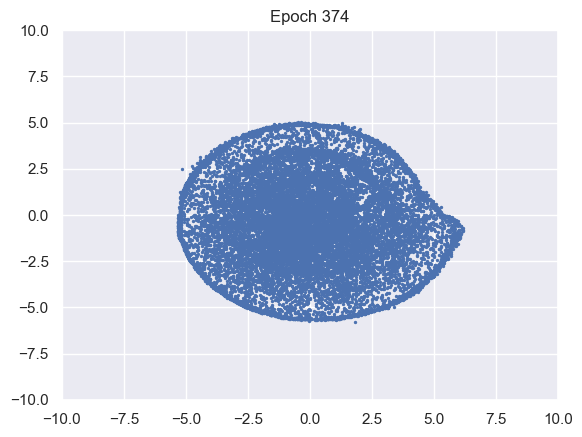

100%|██████████| 976/976 [00:10<00:00, 91.84it/s]


D loss : 1.3333, GP_loss : 0 G_loss : -0.7595, MI : 4.425


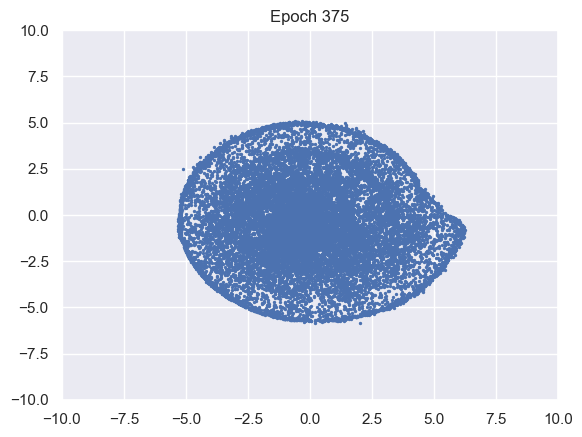

100%|██████████| 976/976 [00:10<00:00, 94.35it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.7595, MI : 4.4259


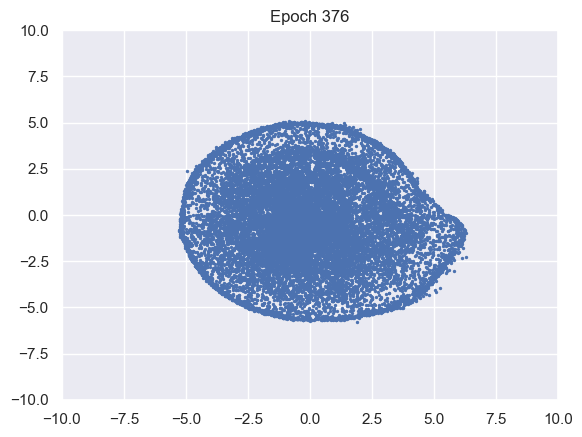

100%|██████████| 976/976 [00:10<00:00, 94.37it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.7596, MI : 4.4228


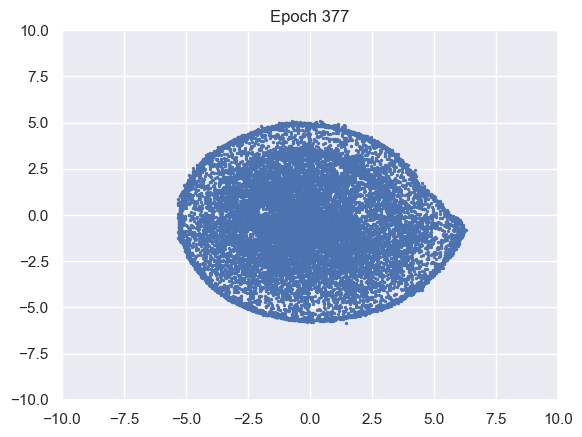

100%|██████████| 976/976 [00:10<00:00, 94.67it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.7596, MI : 4.4235


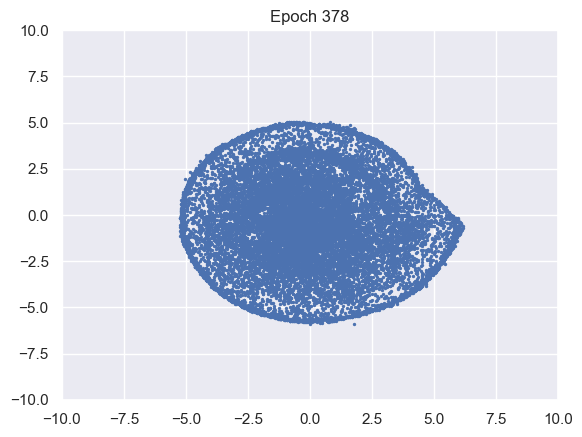

100%|██████████| 976/976 [00:10<00:00, 94.67it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.7597, MI : 4.4234


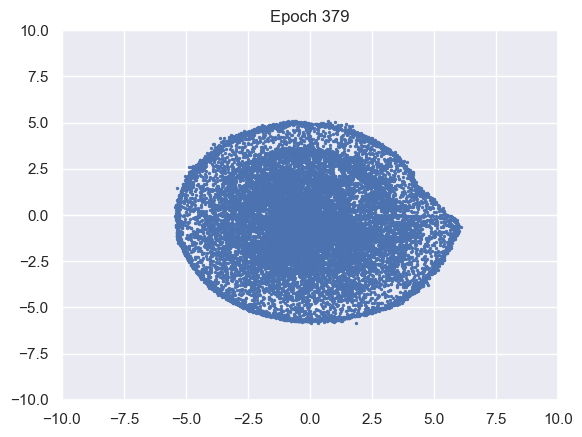

100%|██████████| 976/976 [00:10<00:00, 94.63it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.7597, MI : 4.4243


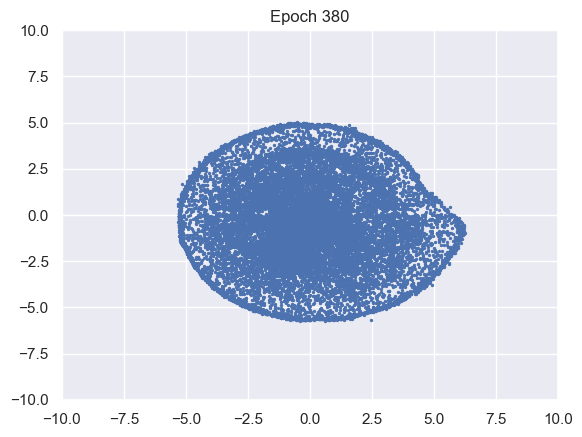

100%|██████████| 976/976 [00:10<00:00, 93.78it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.7598, MI : 4.4245


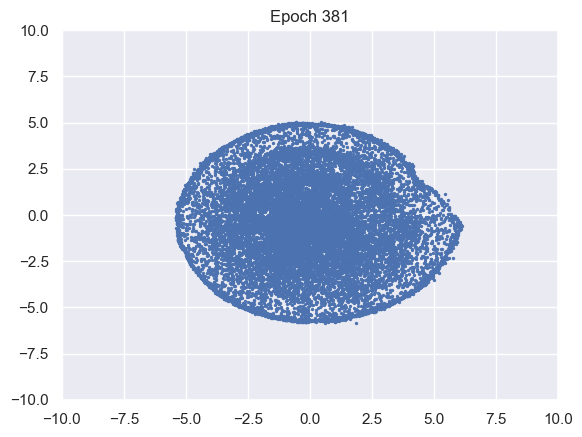

100%|██████████| 976/976 [00:10<00:00, 93.94it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.7598, MI : 4.425


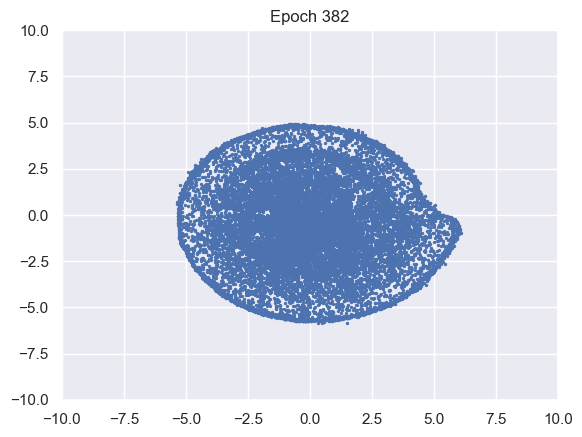

100%|██████████| 976/976 [00:10<00:00, 93.12it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.7598, MI : 4.4258


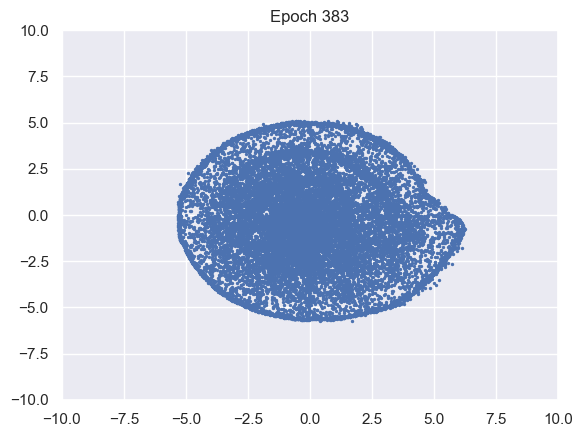

100%|██████████| 976/976 [00:10<00:00, 91.11it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7599, MI : 4.4263


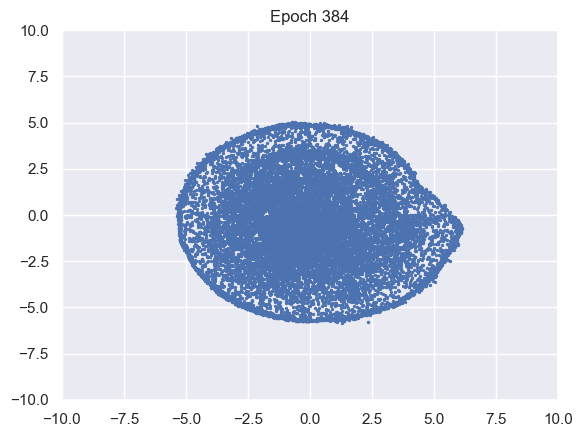

100%|██████████| 976/976 [00:10<00:00, 91.33it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7599, MI : 4.427


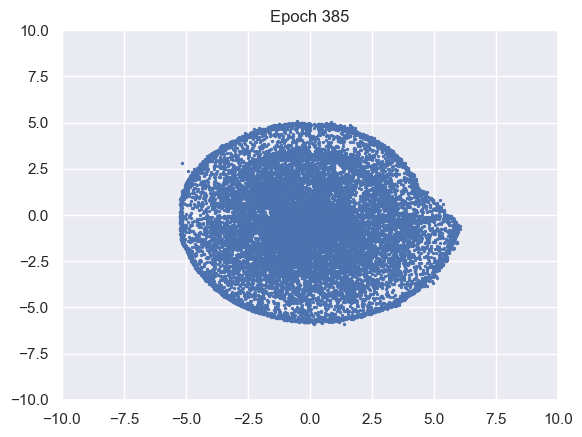

100%|██████████| 976/976 [00:10<00:00, 95.10it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.76, MI : 4.4271


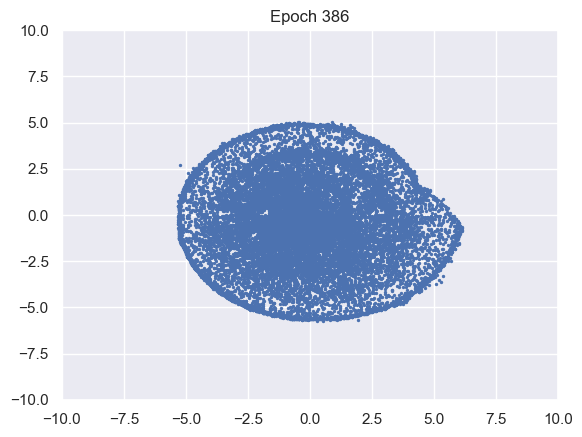

100%|██████████| 976/976 [00:10<00:00, 94.61it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.76, MI : 4.428


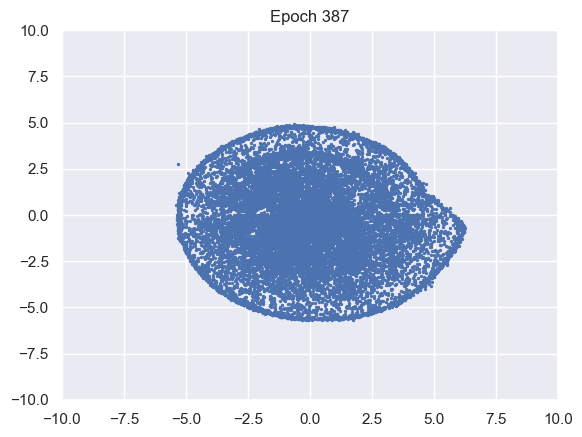

100%|██████████| 976/976 [00:10<00:00, 94.82it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.76, MI : 4.4264


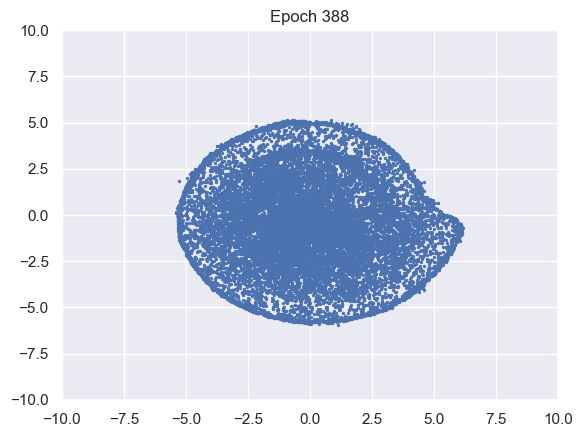

100%|██████████| 976/976 [00:10<00:00, 93.91it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7601, MI : 4.4274


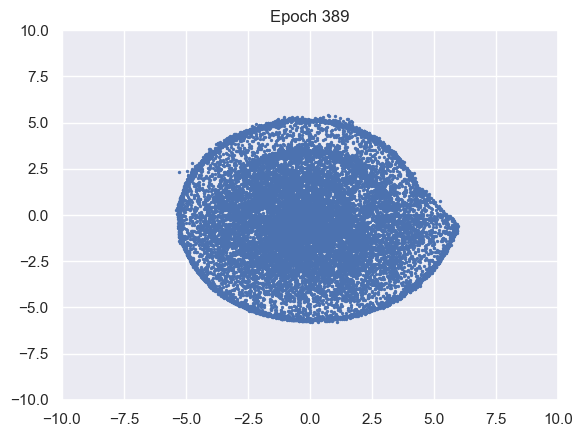

100%|██████████| 976/976 [00:10<00:00, 93.52it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7601, MI : 4.4283


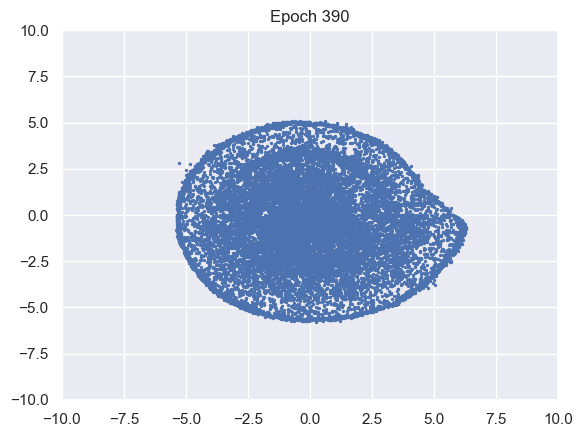

100%|██████████| 976/976 [00:10<00:00, 94.74it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7601, MI : 4.4291


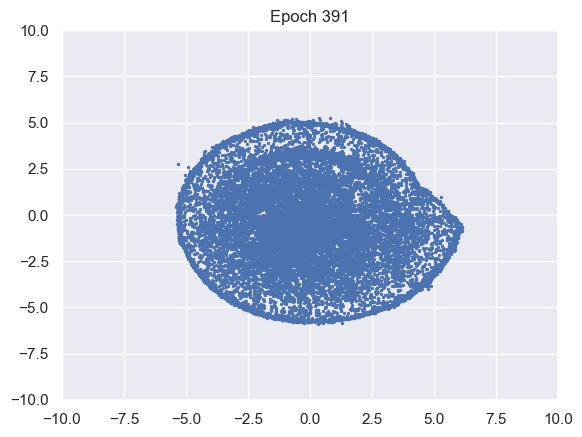

100%|██████████| 976/976 [00:10<00:00, 94.60it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7602, MI : 4.4294


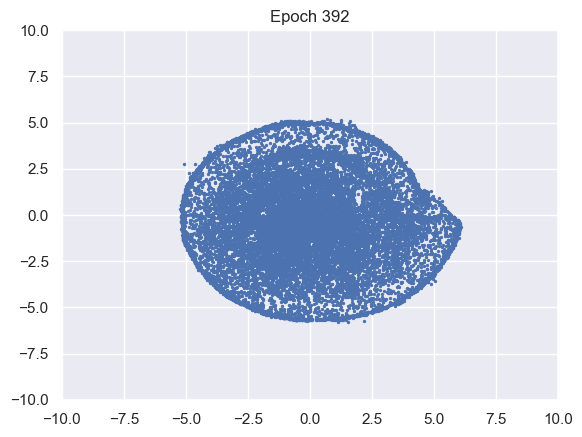

100%|██████████| 976/976 [00:10<00:00, 94.39it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7602, MI : 4.43


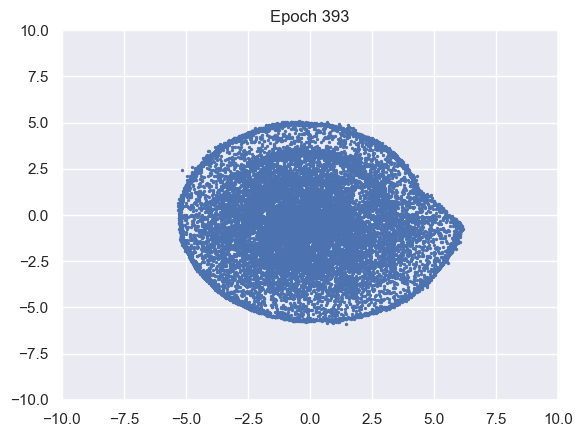

100%|██████████| 976/976 [00:10<00:00, 94.70it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7603, MI : 4.4311


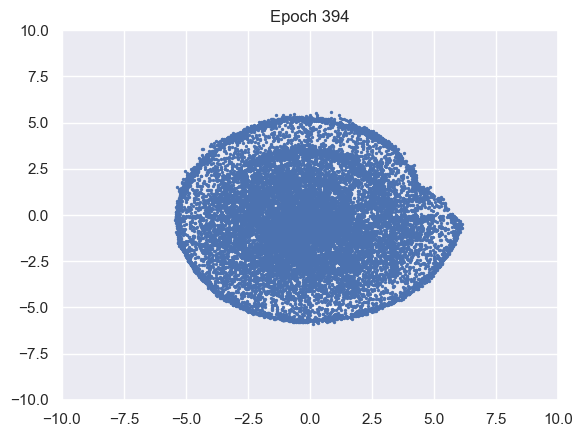

100%|██████████| 976/976 [00:10<00:00, 95.06it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7603, MI : 4.4318


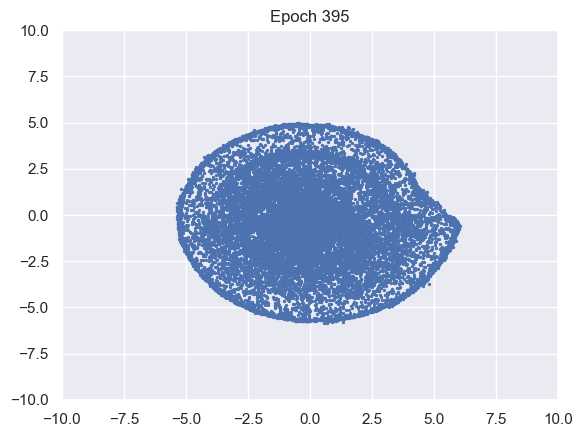

100%|██████████| 976/976 [00:10<00:00, 95.36it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7603, MI : 4.4328


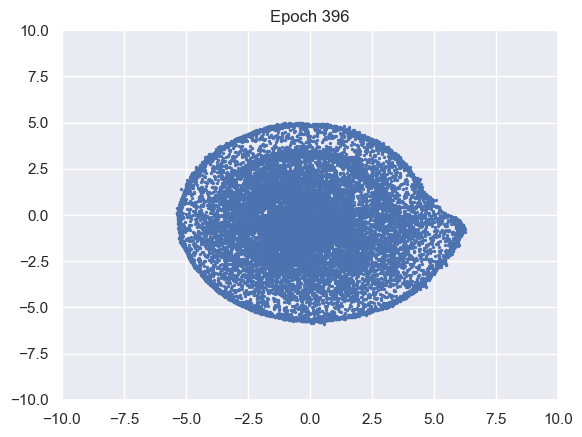

100%|██████████| 976/976 [00:10<00:00, 94.80it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7604, MI : 4.4335


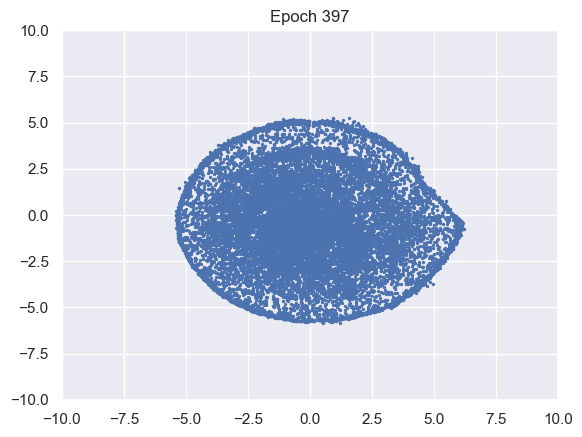

100%|██████████| 976/976 [00:10<00:00, 95.95it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7604, MI : 4.4344


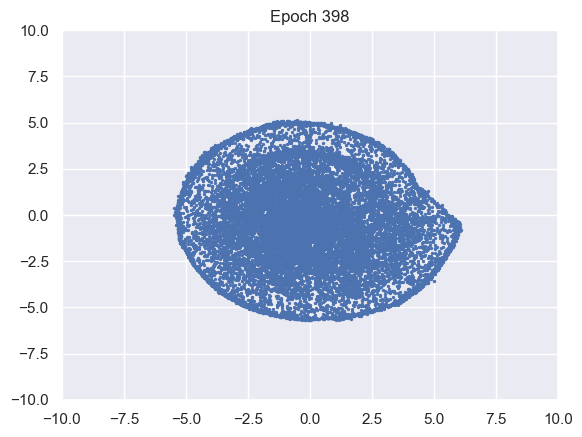

100%|██████████| 976/976 [00:10<00:00, 96.36it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7604, MI : 4.4351


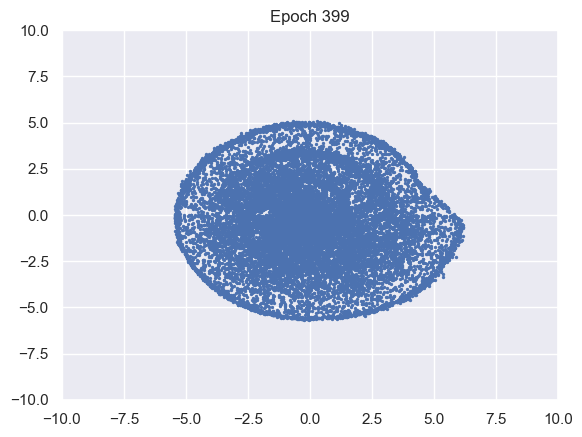

100%|██████████| 976/976 [00:10<00:00, 94.76it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7605, MI : 4.4354


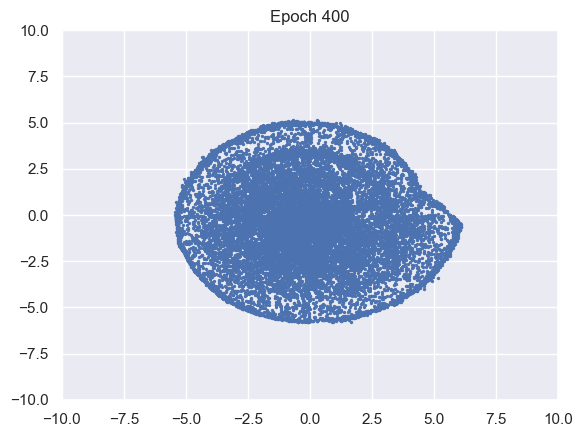

100%|██████████| 976/976 [00:10<00:00, 93.68it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7605, MI : 4.4361


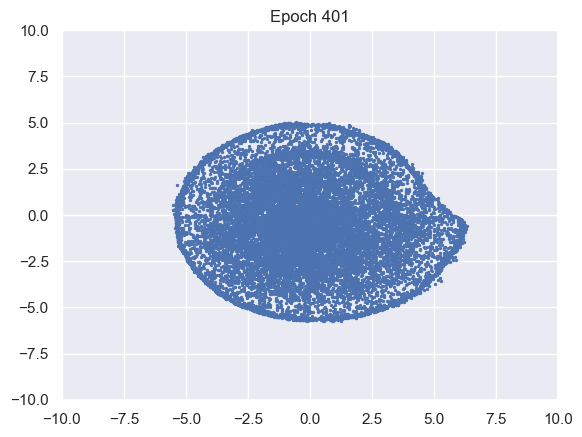

100%|██████████| 976/976 [00:10<00:00, 95.28it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7605, MI : 4.437


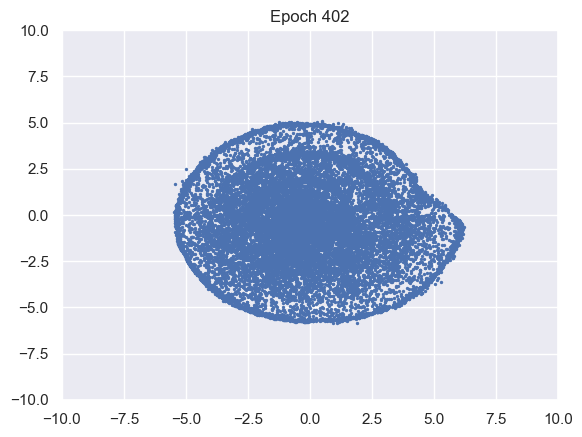

100%|██████████| 976/976 [00:10<00:00, 94.28it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7606, MI : 4.4376


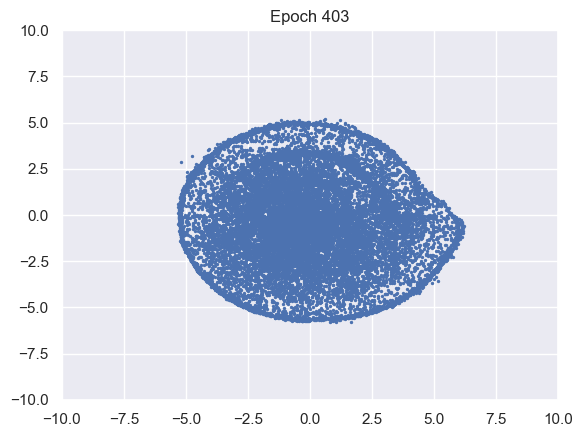

100%|██████████| 976/976 [00:10<00:00, 95.80it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7606, MI : 4.438


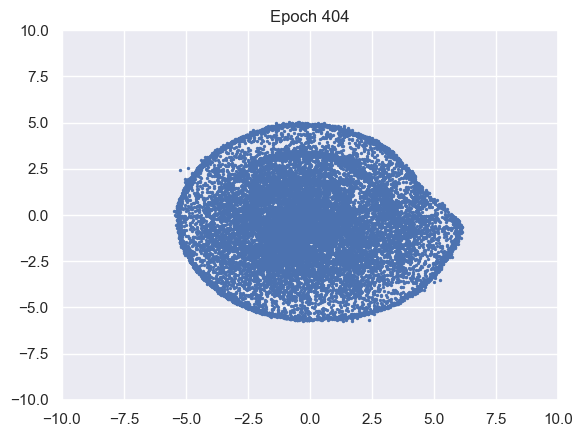

100%|██████████| 976/976 [00:10<00:00, 95.86it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7606, MI : 4.4387


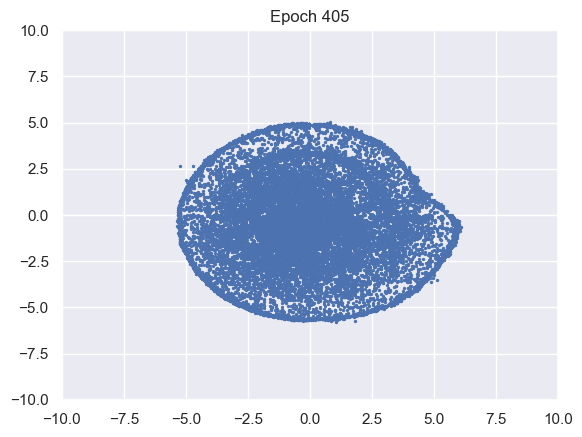

100%|██████████| 976/976 [00:10<00:00, 96.02it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7607, MI : 4.4394


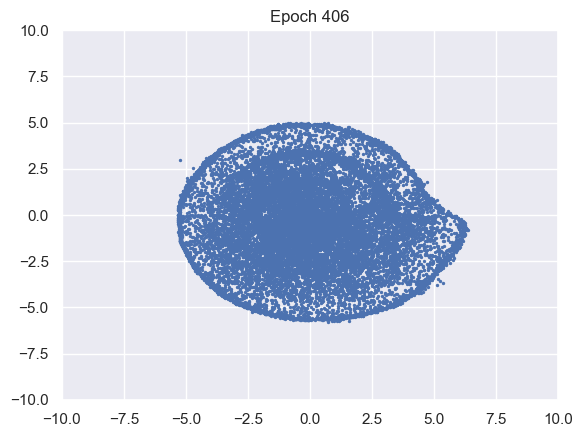

100%|██████████| 976/976 [00:10<00:00, 95.33it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7607, MI : 4.4401


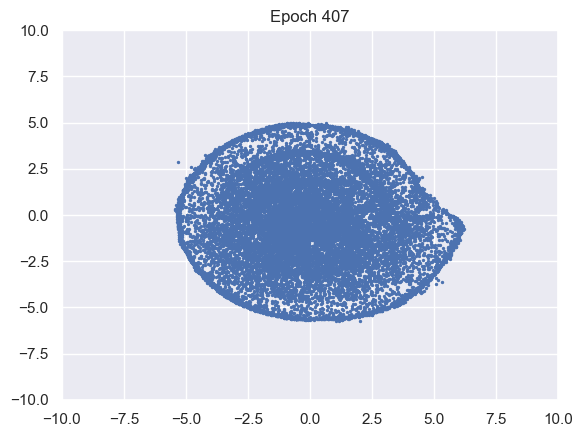

100%|██████████| 976/976 [00:10<00:00, 95.52it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7607, MI : 4.4396


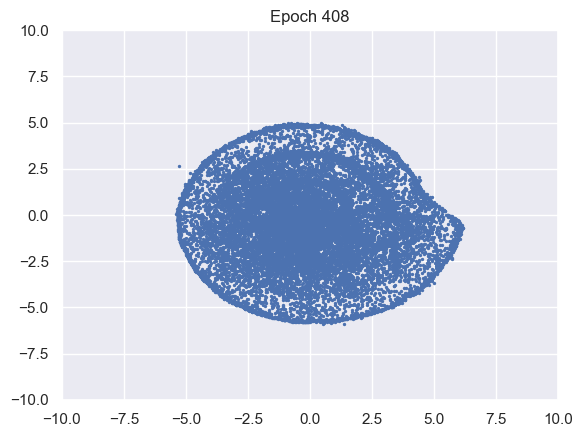

100%|██████████| 976/976 [00:10<00:00, 94.74it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7608, MI : 4.4403


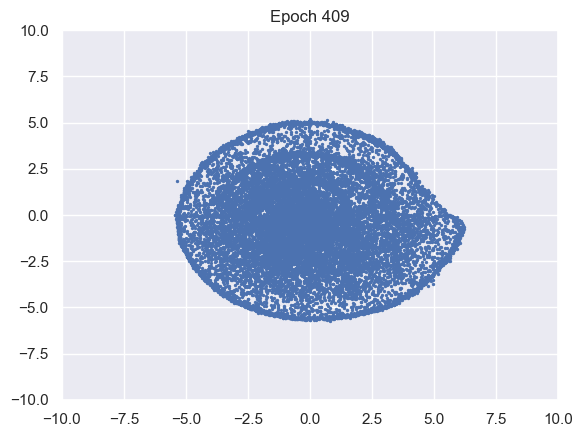

100%|██████████| 976/976 [00:10<00:00, 94.93it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7608, MI : 4.4414


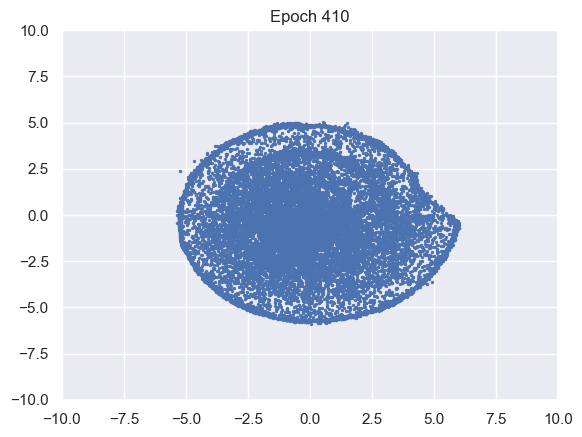

100%|██████████| 976/976 [00:10<00:00, 94.83it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7608, MI : 4.4422


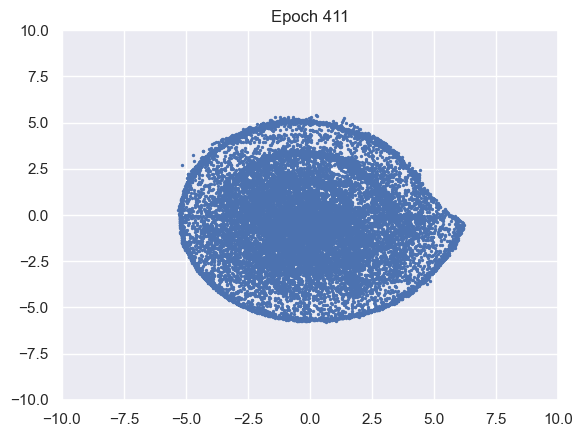

100%|██████████| 976/976 [00:10<00:00, 94.77it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7609, MI : 4.4432


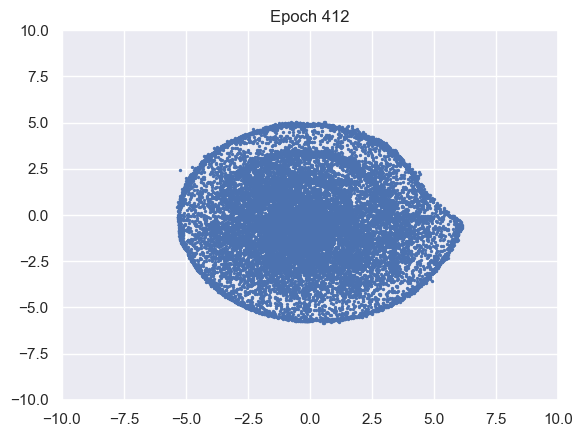

100%|██████████| 976/976 [00:10<00:00, 93.82it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7609, MI : 4.4435


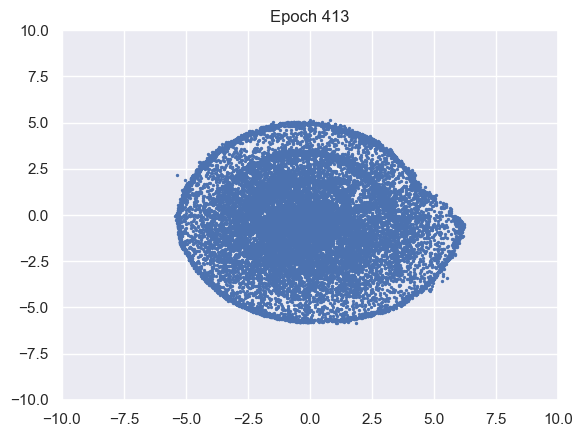

100%|██████████| 976/976 [00:10<00:00, 94.12it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7609, MI : 4.4443


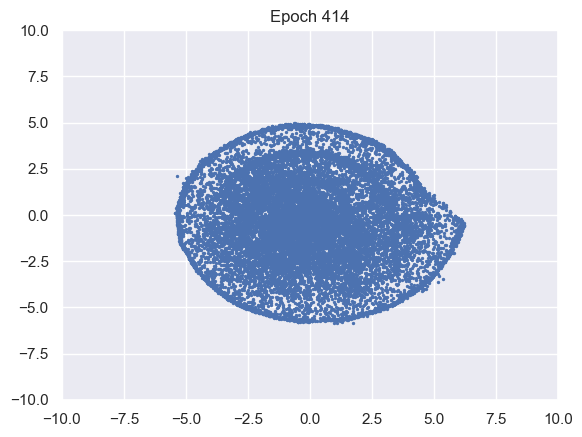

100%|██████████| 976/976 [00:10<00:00, 92.94it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.761, MI : 4.4455


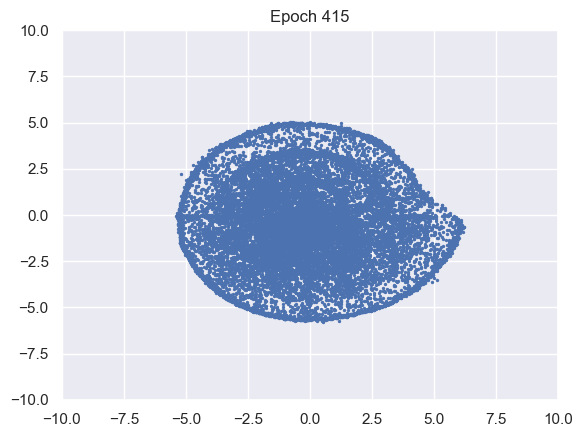

100%|██████████| 976/976 [00:10<00:00, 93.91it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.761, MI : 4.4458


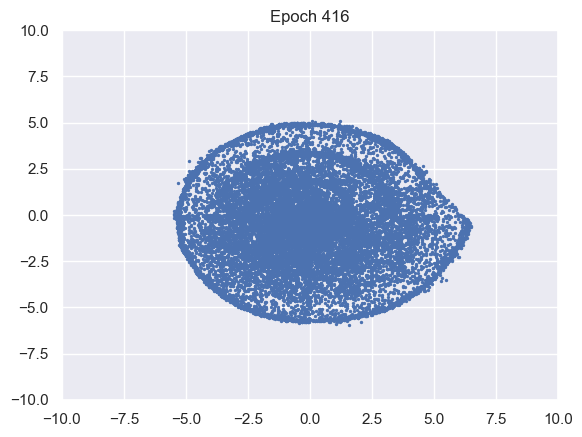

100%|██████████| 976/976 [00:10<00:00, 94.54it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.761, MI : 4.4462


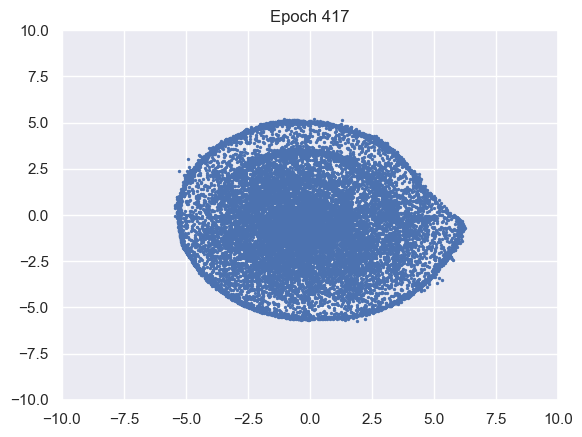

100%|██████████| 976/976 [00:10<00:00, 94.64it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.761, MI : 4.4468


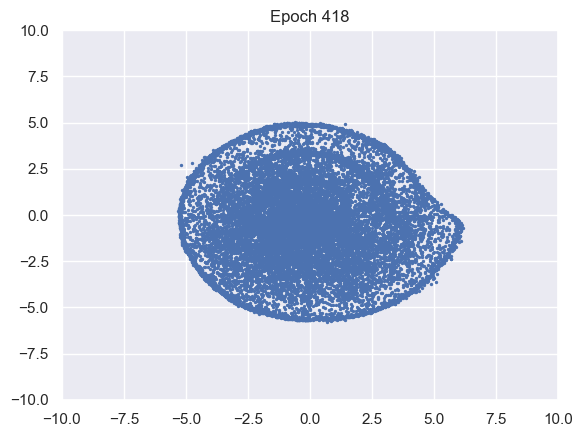

100%|██████████| 976/976 [00:10<00:00, 94.10it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7611, MI : 4.4474


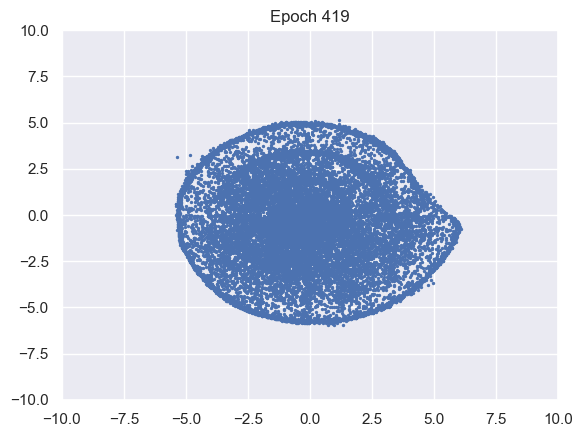

100%|██████████| 976/976 [00:10<00:00, 93.03it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7611, MI : 4.4464


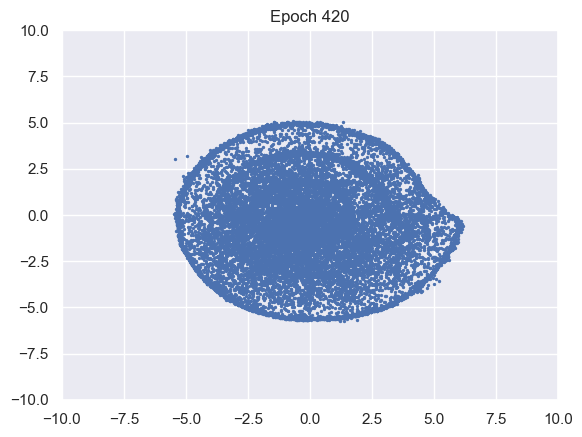

100%|██████████| 976/976 [00:10<00:00, 94.78it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7611, MI : 4.4471


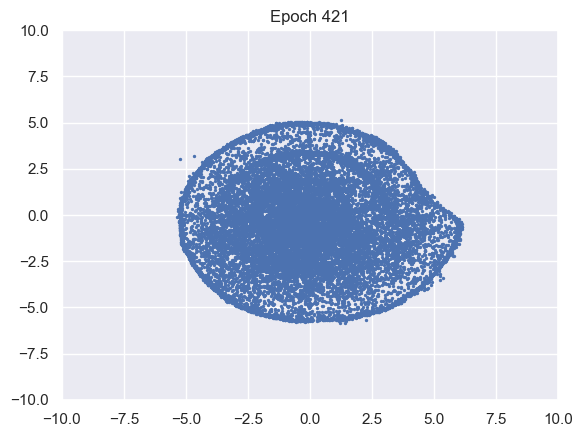

100%|██████████| 976/976 [00:10<00:00, 94.26it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7611, MI : 4.4478


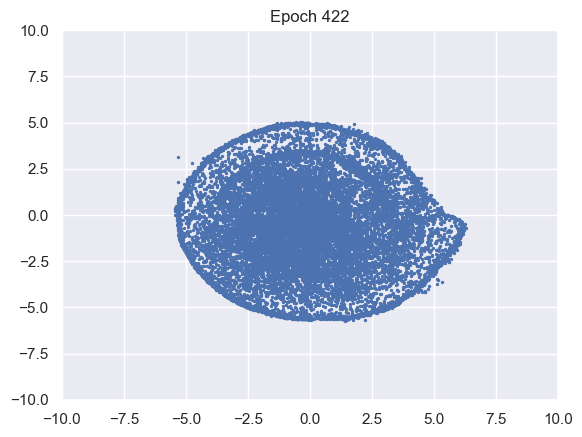

100%|██████████| 976/976 [00:10<00:00, 94.90it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7612, MI : 4.4476


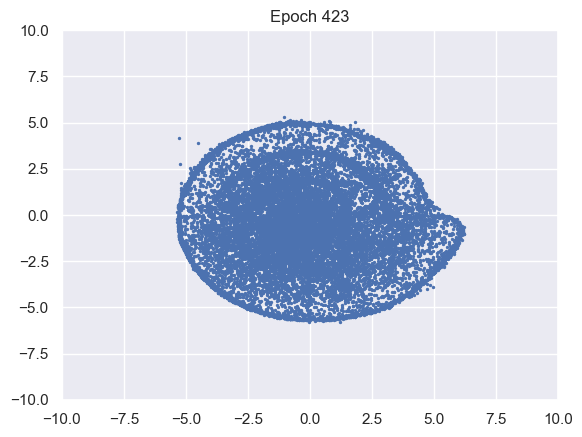

100%|██████████| 976/976 [00:10<00:00, 95.26it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7612, MI : 4.4485


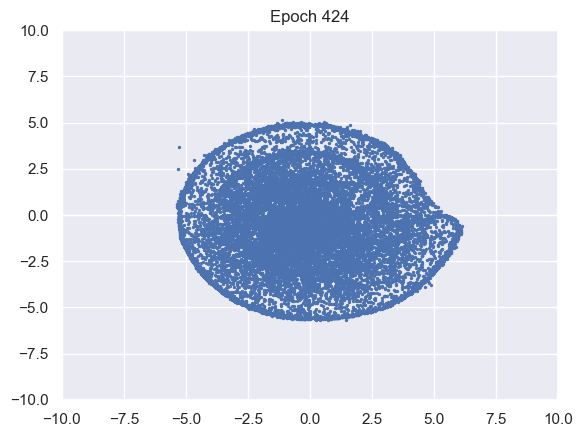

100%|██████████| 976/976 [00:10<00:00, 96.53it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7612, MI : 4.4494


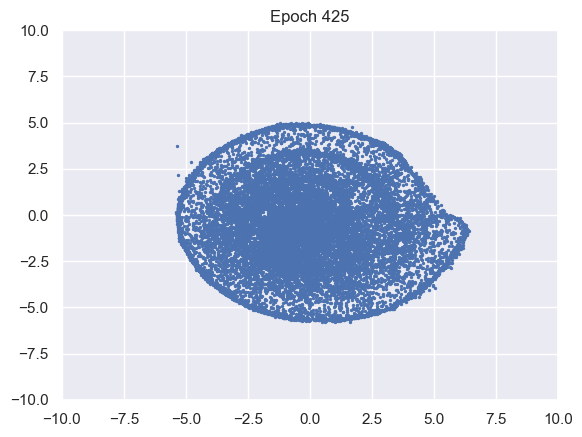

100%|██████████| 976/976 [00:10<00:00, 96.04it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7612, MI : 4.4501


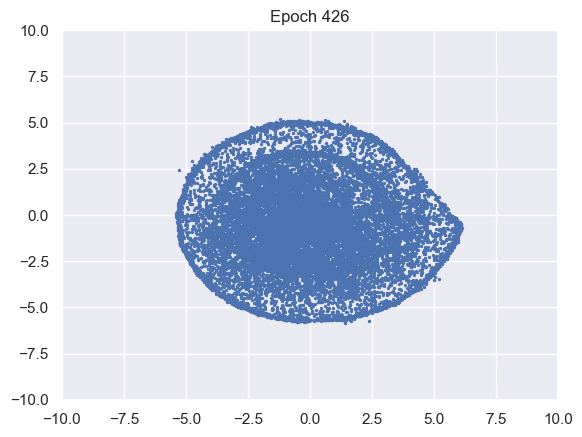

100%|██████████| 976/976 [00:10<00:00, 96.41it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7613, MI : 4.4509


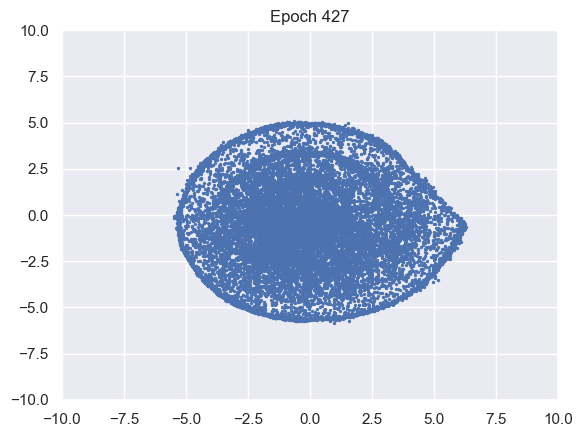

100%|██████████| 976/976 [00:10<00:00, 95.80it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7613, MI : 4.4516


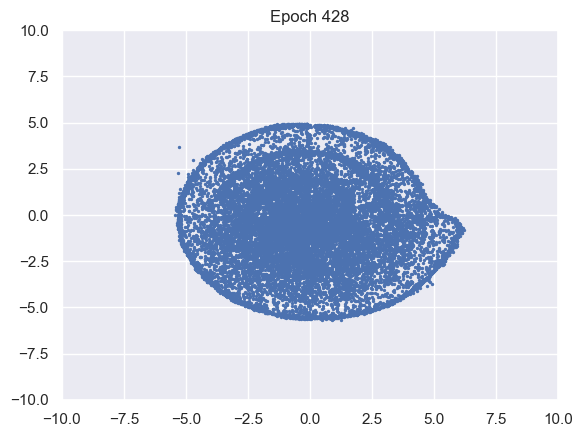

100%|██████████| 976/976 [00:10<00:00, 96.24it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7613, MI : 4.4523


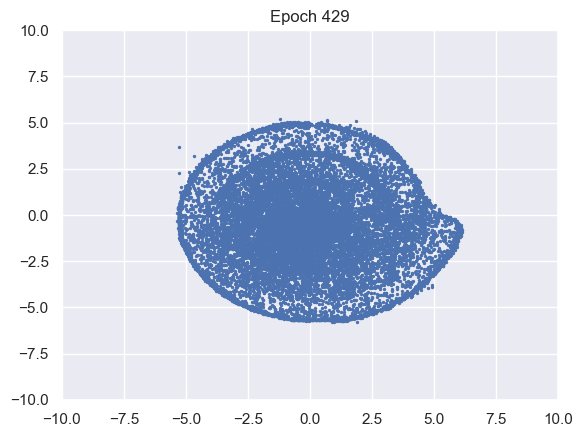

100%|██████████| 976/976 [00:10<00:00, 95.41it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7614, MI : 4.452


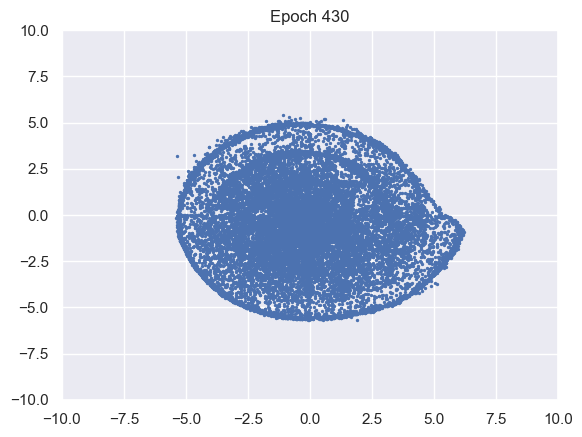

100%|██████████| 976/976 [00:10<00:00, 96.27it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7614, MI : 4.4527


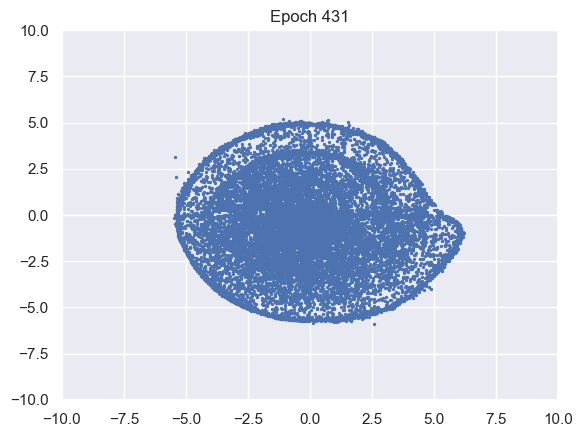

100%|██████████| 976/976 [00:10<00:00, 95.64it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7614, MI : 4.4535


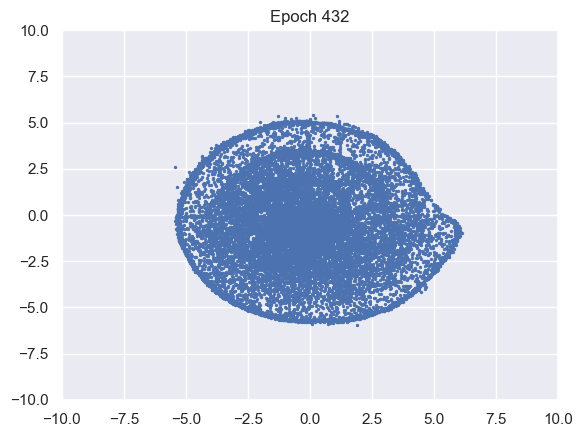

100%|██████████| 976/976 [00:10<00:00, 96.34it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7614, MI : 4.4543


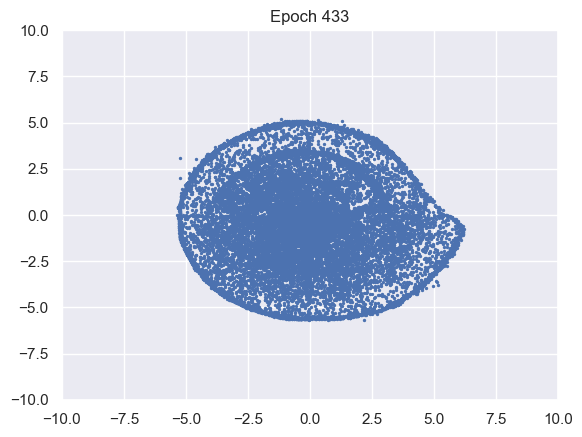

100%|██████████| 976/976 [00:10<00:00, 95.23it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7615, MI : 4.4548


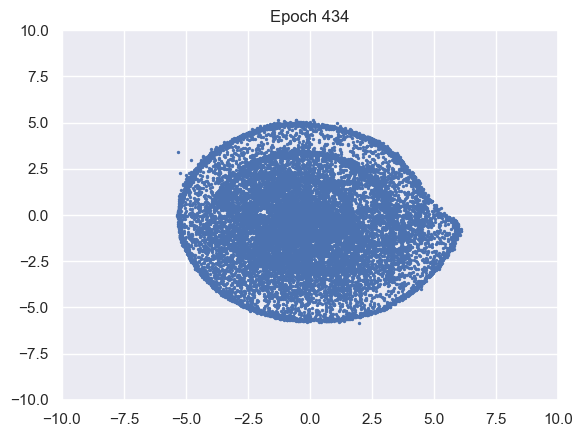

100%|██████████| 976/976 [00:10<00:00, 95.77it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7615, MI : 4.4551


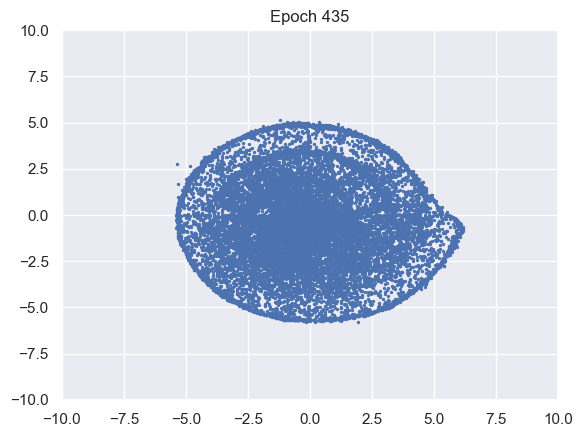

100%|██████████| 976/976 [00:10<00:00, 95.49it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7615, MI : 4.4561


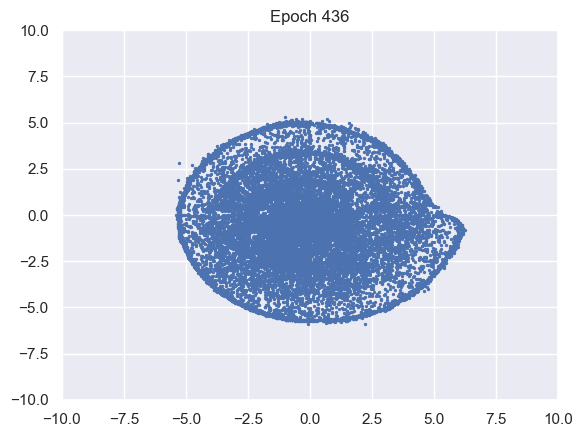

100%|██████████| 976/976 [00:10<00:00, 95.24it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7615, MI : 4.4568


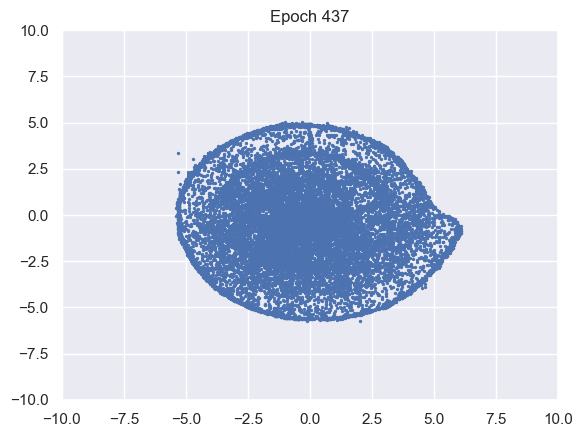

100%|██████████| 976/976 [00:10<00:00, 96.49it/s]


D loss : 1.333, GP_loss : 0 G_loss : -0.7616, MI : 4.4573


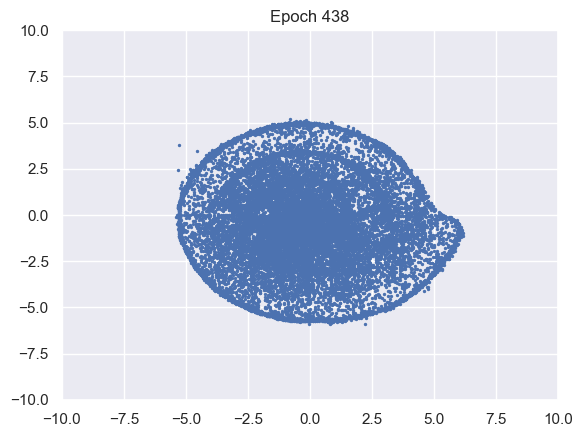

100%|██████████| 976/976 [00:10<00:00, 95.51it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7616, MI : 4.4582


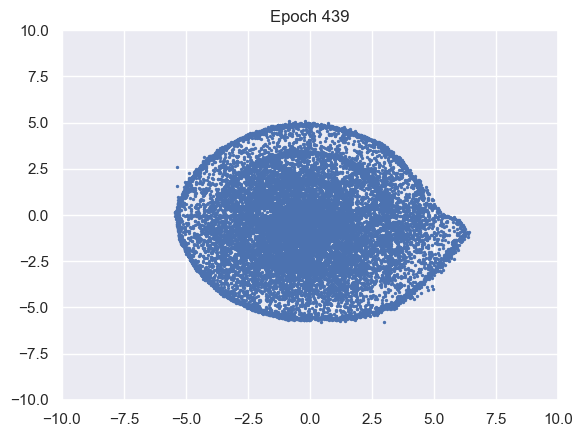

100%|██████████| 976/976 [00:10<00:00, 95.81it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7616, MI : 4.4591


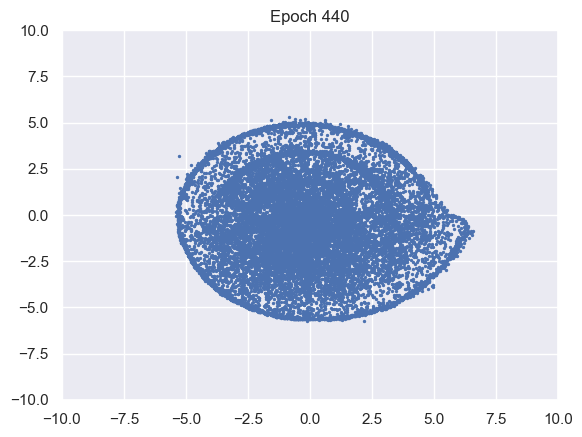

100%|██████████| 976/976 [00:10<00:00, 95.56it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7616, MI : 4.4599


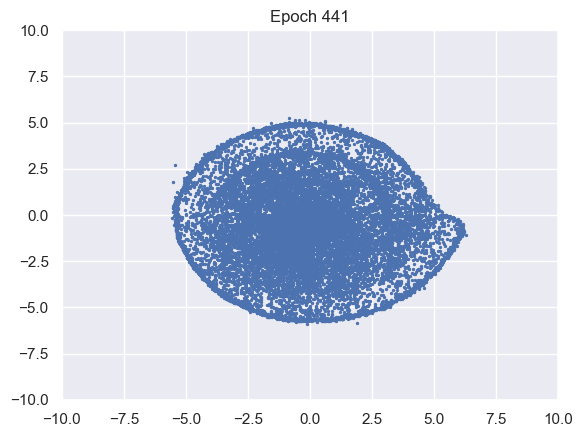

100%|██████████| 976/976 [00:10<00:00, 96.13it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7616, MI : 4.4604


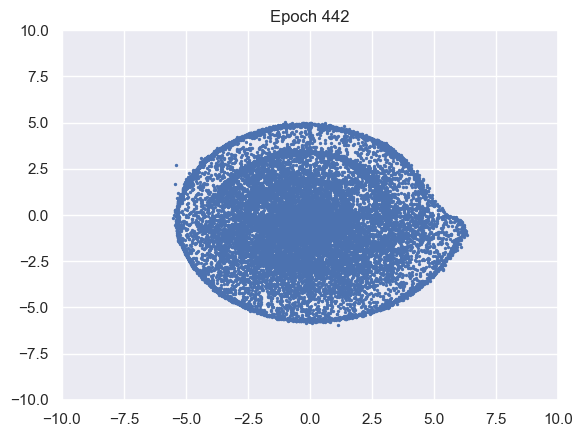

100%|██████████| 976/976 [00:10<00:00, 91.70it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7617, MI : 4.4612


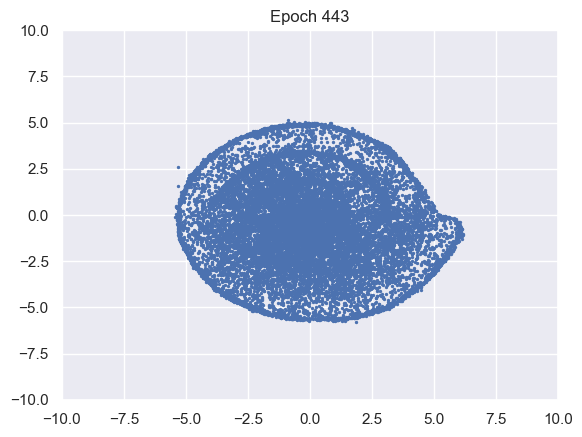

100%|██████████| 976/976 [00:10<00:00, 94.55it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7617, MI : 4.4619


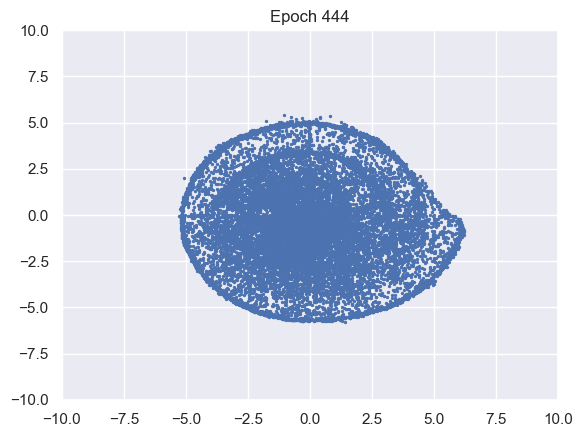

100%|██████████| 976/976 [00:10<00:00, 94.68it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7617, MI : 4.4624


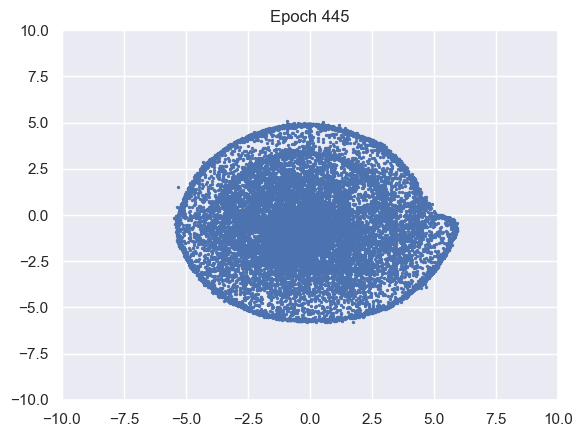

100%|██████████| 976/976 [00:10<00:00, 96.05it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7617, MI : 4.4631


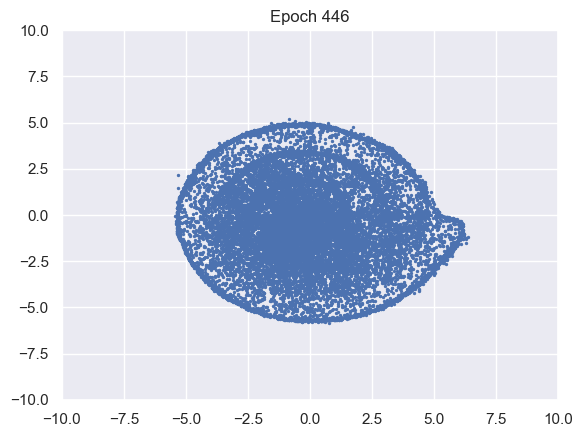

100%|██████████| 976/976 [00:10<00:00, 96.00it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7618, MI : 4.4638


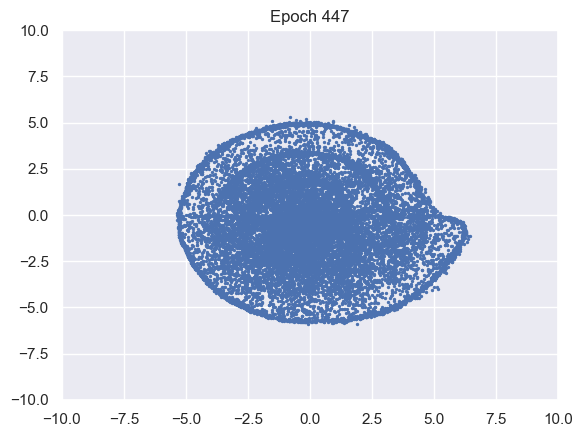

100%|██████████| 976/976 [00:10<00:00, 95.35it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7618, MI : 4.4646


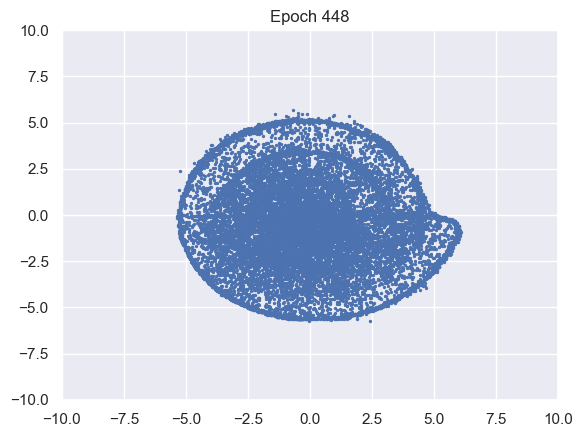

100%|██████████| 976/976 [00:10<00:00, 95.56it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7618, MI : 4.4649


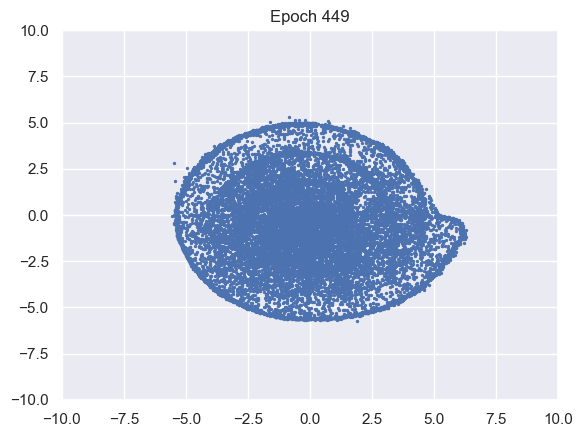

100%|██████████| 976/976 [00:10<00:00, 95.61it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7618, MI : 4.4657


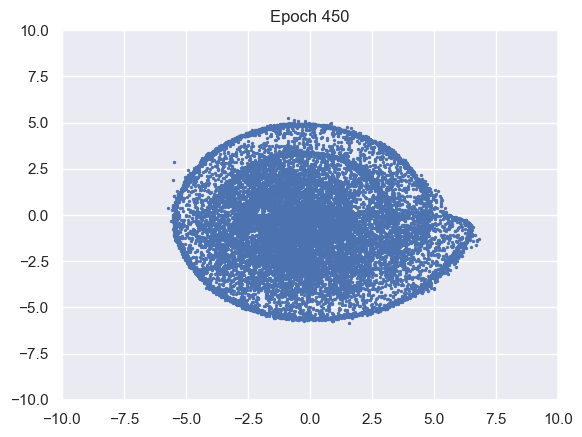

100%|██████████| 976/976 [00:10<00:00, 94.99it/s]


D loss : 1.3331, GP_loss : 0 G_loss : -0.7619, MI : 4.4661


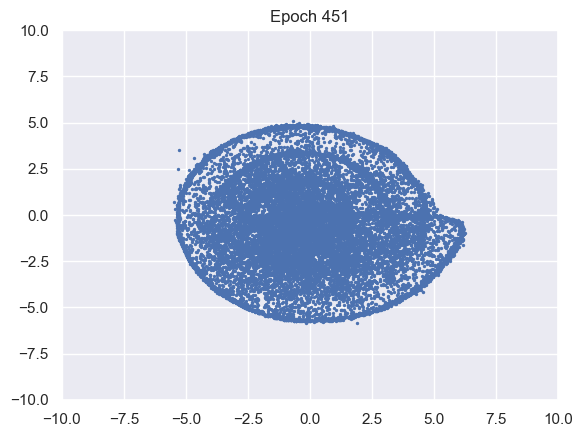

100%|██████████| 976/976 [00:10<00:00, 93.36it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.7619, MI : 4.4666


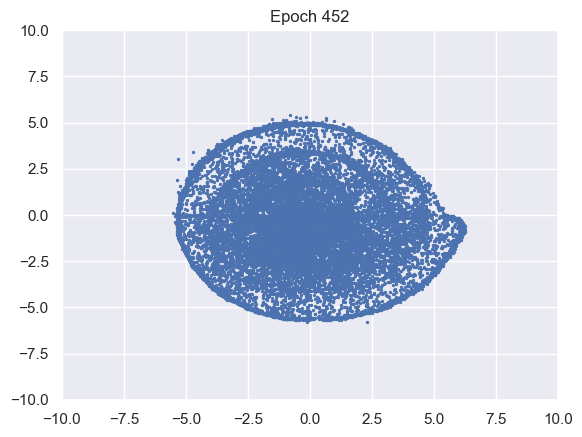

100%|██████████| 976/976 [00:10<00:00, 93.51it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.7619, MI : 4.467


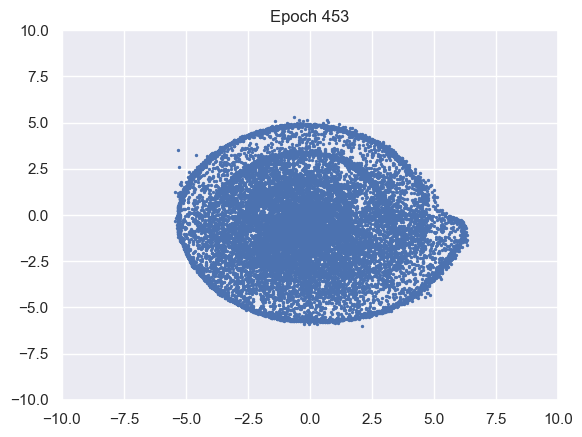

100%|██████████| 976/976 [00:10<00:00, 94.53it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.7619, MI : 4.4673


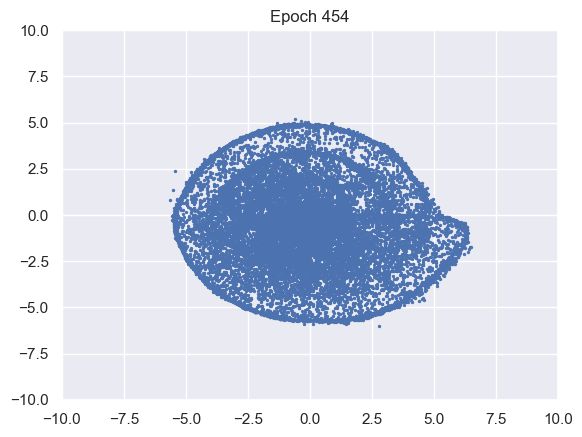

100%|██████████| 976/976 [00:10<00:00, 91.65it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.7619, MI : 4.4678


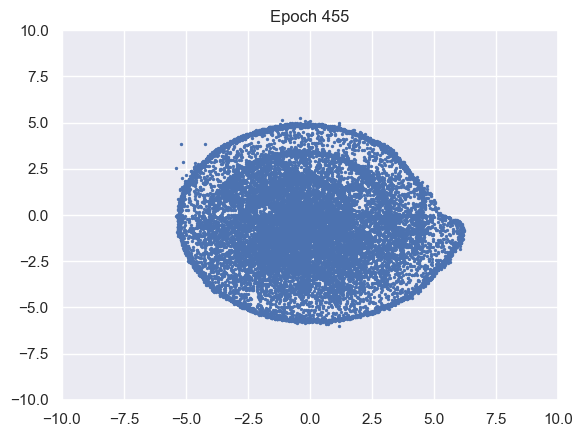

100%|██████████| 976/976 [00:10<00:00, 94.48it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.762, MI : 4.468


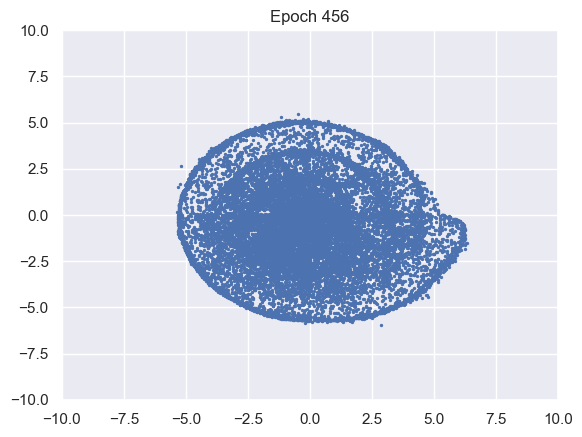

100%|██████████| 976/976 [00:10<00:00, 93.07it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.762, MI : 4.4688


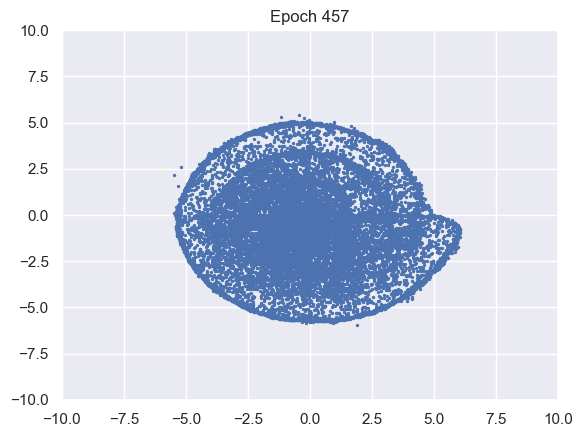

100%|██████████| 976/976 [00:10<00:00, 91.87it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.762, MI : 4.4695


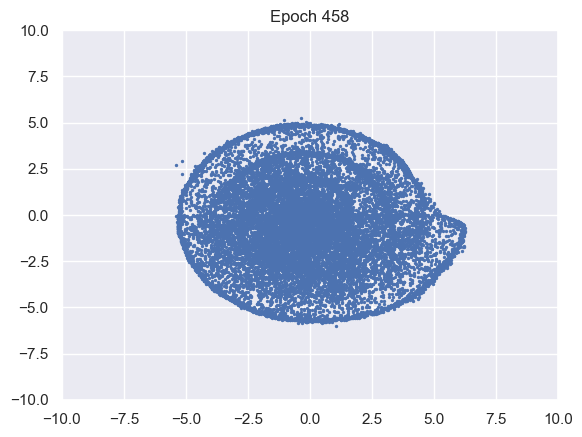

100%|██████████| 976/976 [00:10<00:00, 91.95it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.762, MI : 4.4702


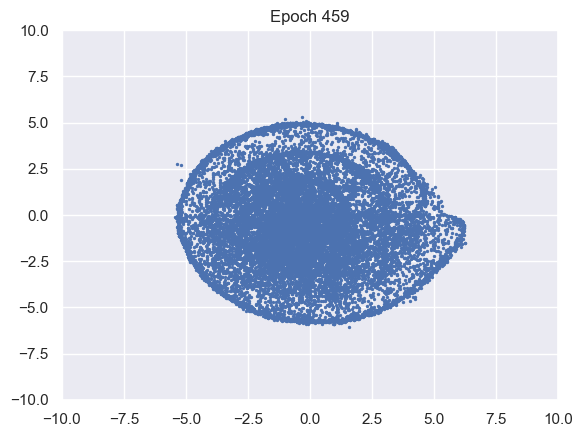

100%|██████████| 976/976 [00:10<00:00, 93.55it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.762, MI : 4.4692


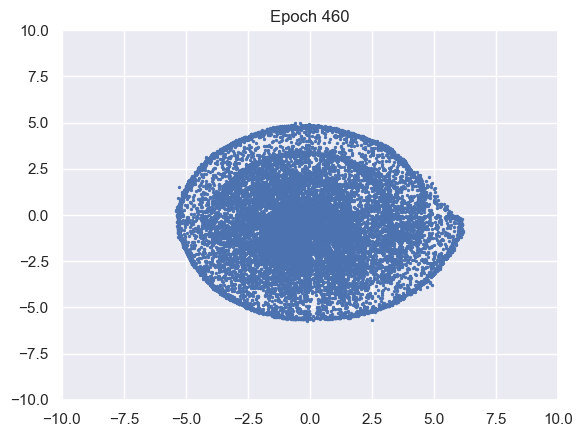

100%|██████████| 976/976 [00:10<00:00, 92.83it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.7621, MI : 4.4699


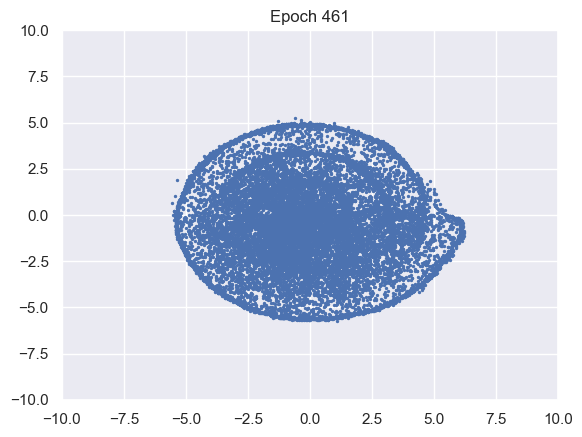

100%|██████████| 976/976 [00:10<00:00, 93.88it/s]


D loss : 1.3332, GP_loss : 0 G_loss : -0.7621, MI : 4.4704


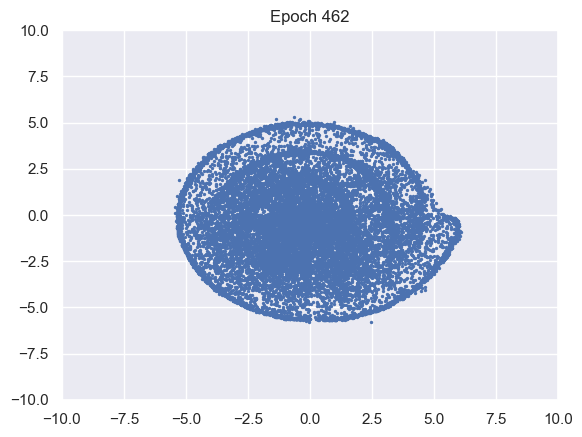

100%|██████████| 976/976 [00:10<00:00, 93.75it/s]


D loss : 1.3333, GP_loss : 0 G_loss : -0.7621, MI : 4.4708


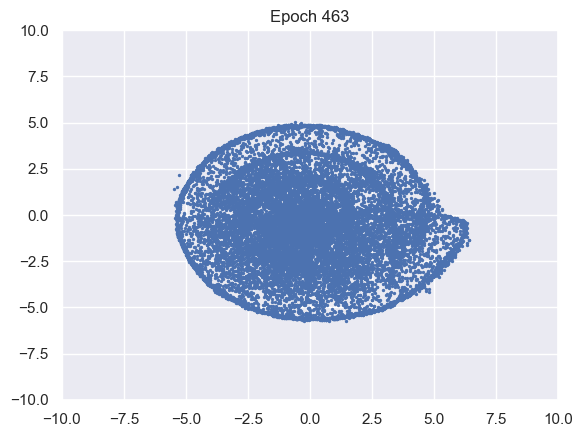

100%|██████████| 976/976 [00:10<00:00, 93.77it/s]


D loss : 1.3333, GP_loss : 0 G_loss : -0.7621, MI : 4.4713


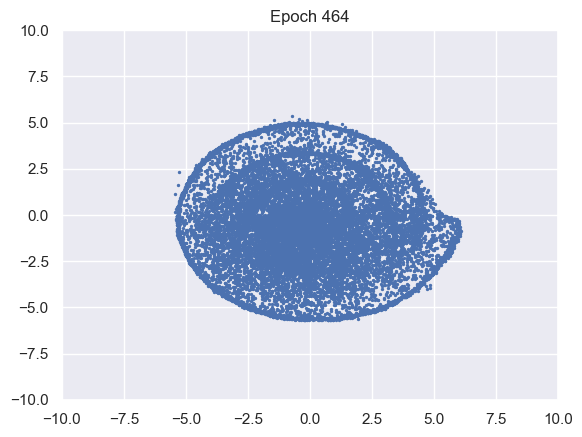

100%|██████████| 976/976 [00:10<00:00, 92.81it/s]


D loss : 1.3333, GP_loss : 0 G_loss : -0.7621, MI : 4.472


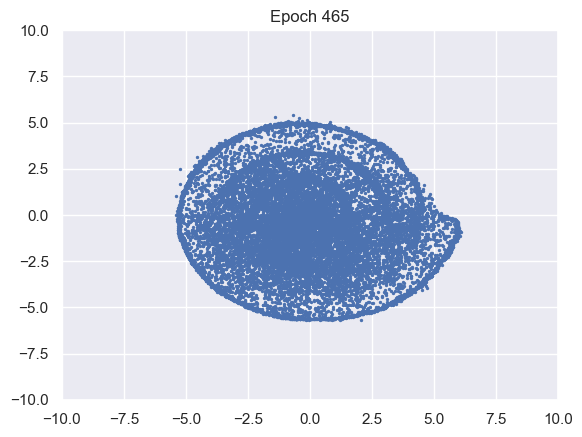

100%|██████████| 976/976 [00:10<00:00, 92.56it/s]


D loss : 1.3333, GP_loss : 0 G_loss : -0.7622, MI : 4.4722


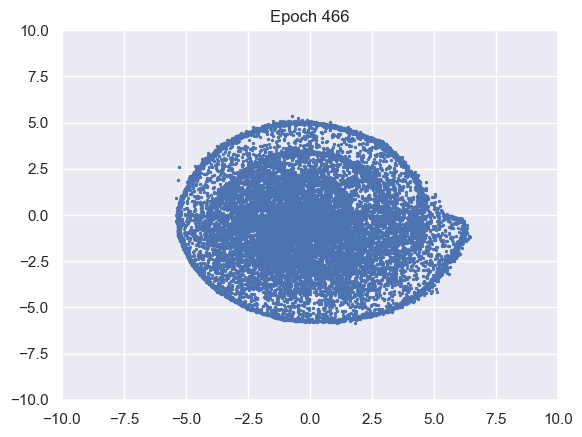

100%|██████████| 976/976 [00:10<00:00, 92.81it/s]


D loss : 1.3333, GP_loss : 0 G_loss : -0.7622, MI : 4.4728


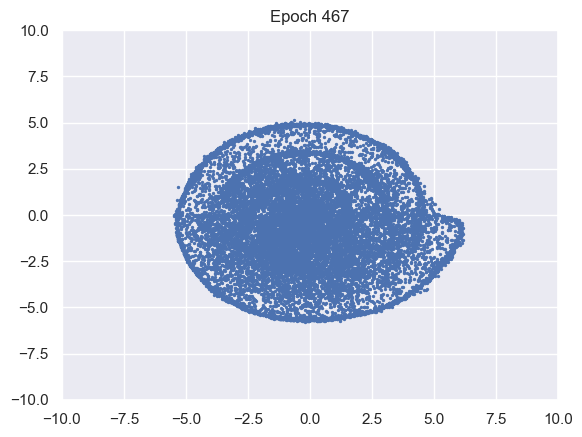

100%|██████████| 976/976 [00:10<00:00, 93.19it/s]


D loss : 1.3333, GP_loss : 0 G_loss : -0.7622, MI : 4.4729


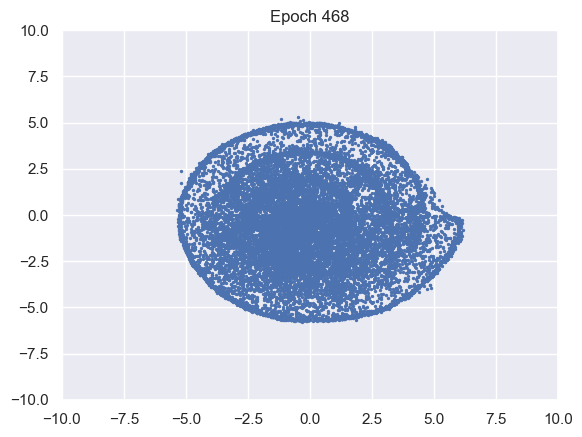

100%|██████████| 976/976 [00:10<00:00, 92.07it/s]


D loss : 1.3333, GP_loss : 0 G_loss : -0.7622, MI : 4.4737


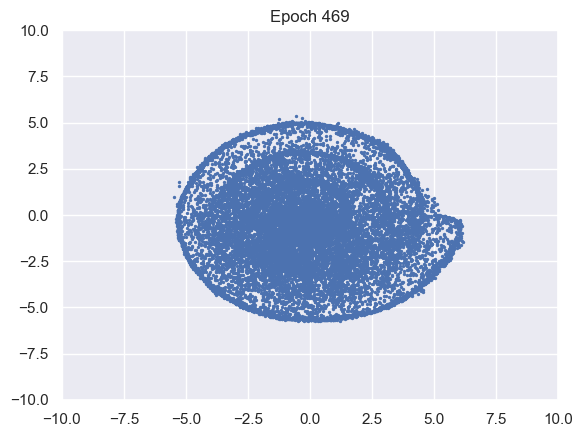

100%|██████████| 976/976 [00:10<00:00, 92.80it/s]


D loss : 1.3333, GP_loss : 0 G_loss : -0.7622, MI : 4.4739


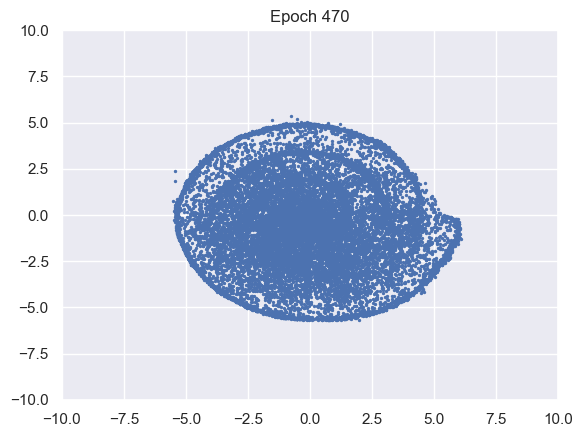

100%|██████████| 976/976 [00:10<00:00, 94.46it/s]


D loss : 1.3333, GP_loss : 0 G_loss : -0.7622, MI : 4.4742


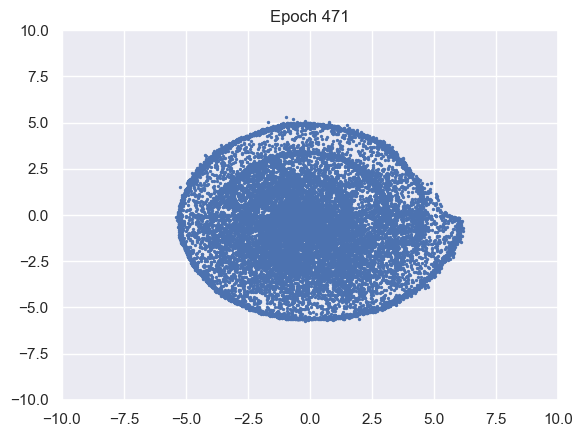

100%|██████████| 976/976 [00:10<00:00, 93.94it/s]


D loss : 1.3334, GP_loss : 0 G_loss : -0.7623, MI : 4.475


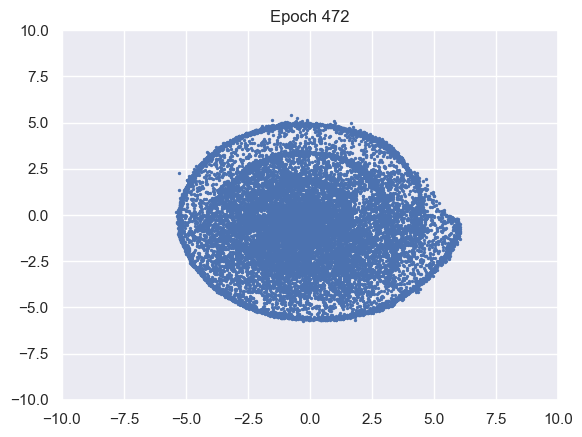

100%|██████████| 976/976 [00:10<00:00, 93.86it/s]


D loss : 1.3334, GP_loss : 0 G_loss : -0.7623, MI : 4.4748


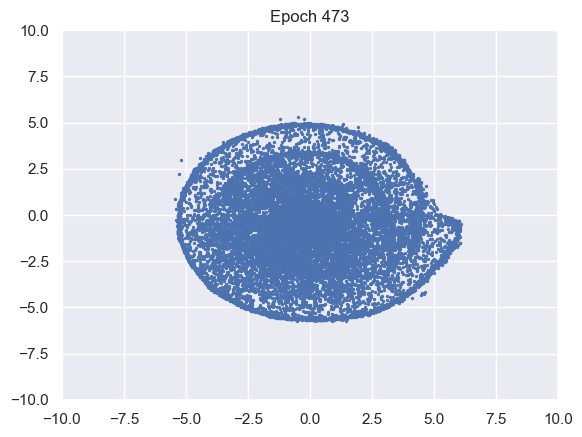

100%|██████████| 976/976 [00:10<00:00, 93.69it/s]


D loss : 1.3334, GP_loss : 0 G_loss : -0.7623, MI : 4.4753


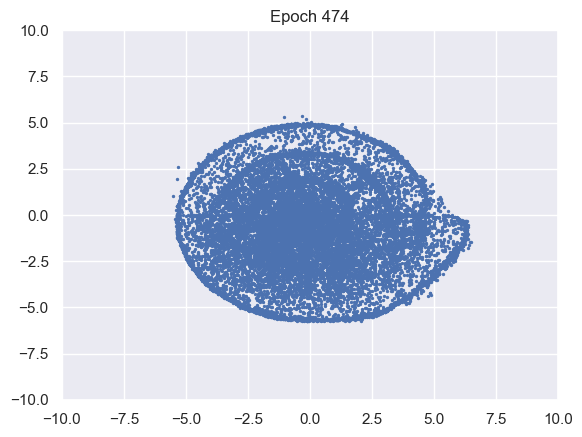

100%|██████████| 976/976 [00:10<00:00, 94.60it/s]


D loss : 1.3334, GP_loss : 0 G_loss : -0.7623, MI : 4.4761


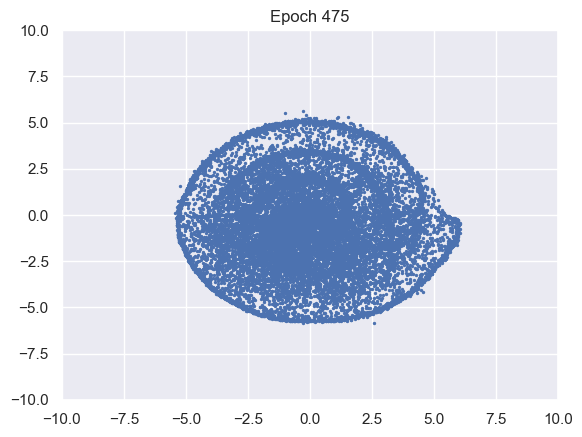

100%|██████████| 976/976 [00:10<00:00, 93.85it/s]


D loss : 1.3334, GP_loss : 0 G_loss : -0.7623, MI : 4.4764


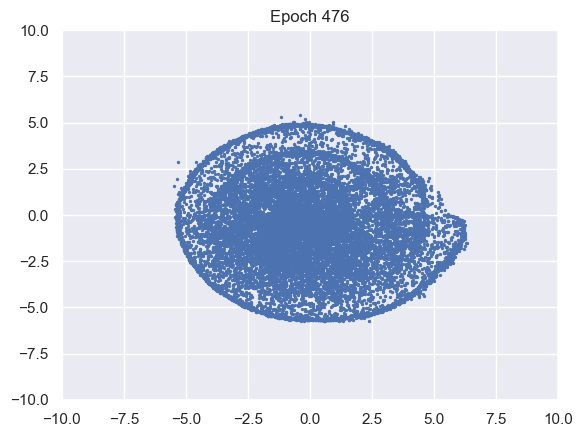

100%|██████████| 976/976 [00:10<00:00, 93.85it/s]


D loss : 1.3334, GP_loss : 0 G_loss : -0.7623, MI : 4.4772


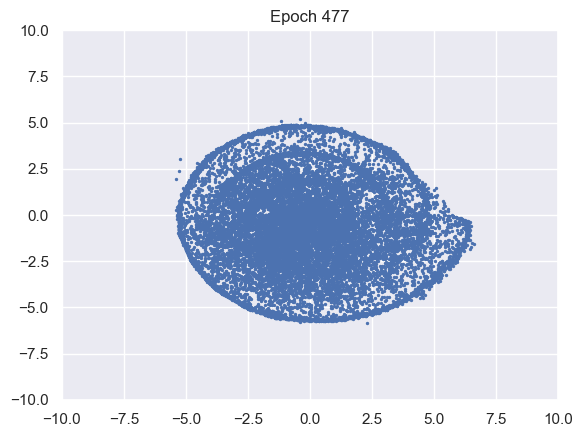

100%|██████████| 976/976 [00:10<00:00, 94.24it/s]


D loss : 1.3334, GP_loss : 0 G_loss : -0.7624, MI : 4.4776


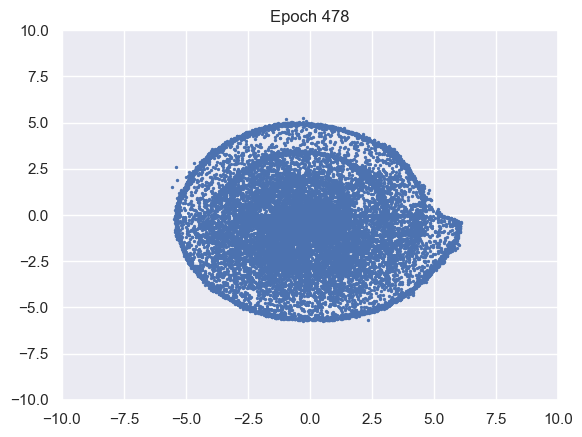

100%|██████████| 976/976 [00:10<00:00, 94.26it/s]


D loss : 1.3334, GP_loss : 0 G_loss : -0.7624, MI : 4.4781


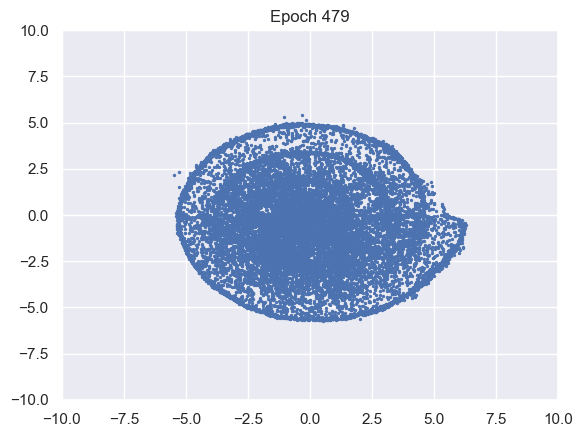

100%|██████████| 976/976 [00:10<00:00, 94.38it/s]


D loss : 1.3335, GP_loss : 0 G_loss : -0.7624, MI : 4.4789


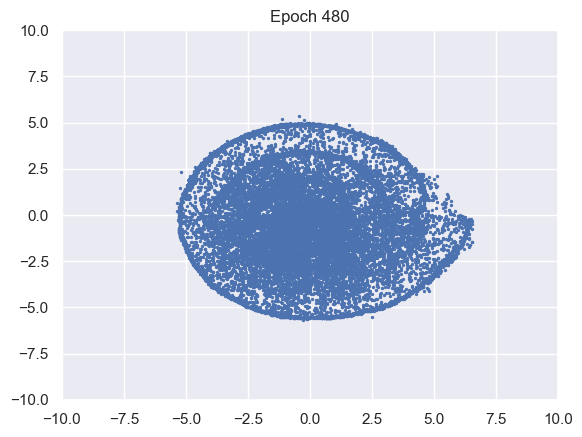

100%|██████████| 976/976 [00:10<00:00, 94.20it/s]


D loss : 1.3335, GP_loss : 0 G_loss : -0.7624, MI : 4.4796


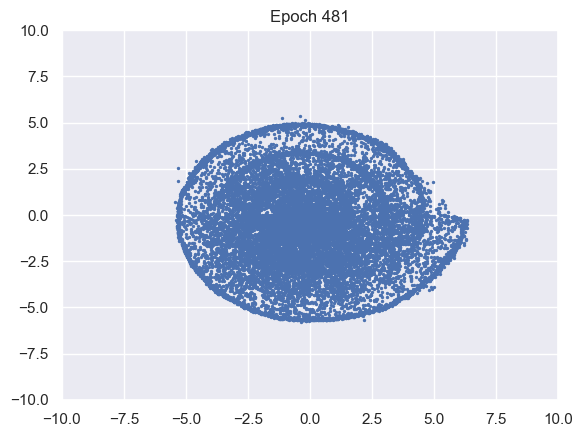

100%|██████████| 976/976 [00:10<00:00, 94.16it/s]


D loss : 1.3335, GP_loss : 0 G_loss : -0.7624, MI : 4.4798


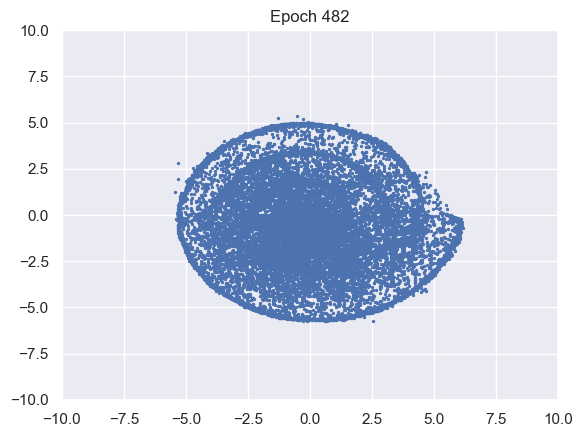

100%|██████████| 976/976 [00:10<00:00, 94.91it/s]


D loss : 1.3335, GP_loss : 0 G_loss : -0.7624, MI : 4.4803


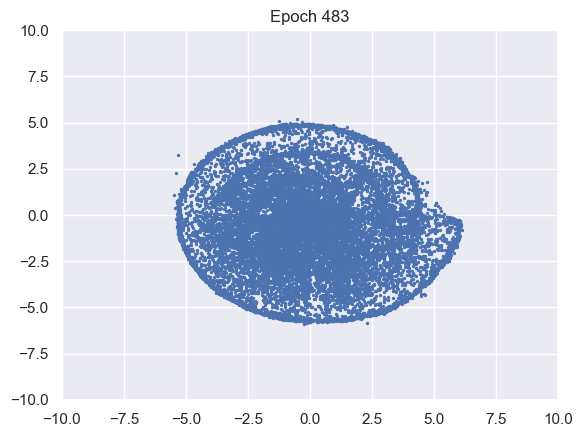

100%|██████████| 976/976 [00:10<00:00, 95.21it/s]


D loss : 1.3335, GP_loss : 0 G_loss : -0.7625, MI : 4.4812


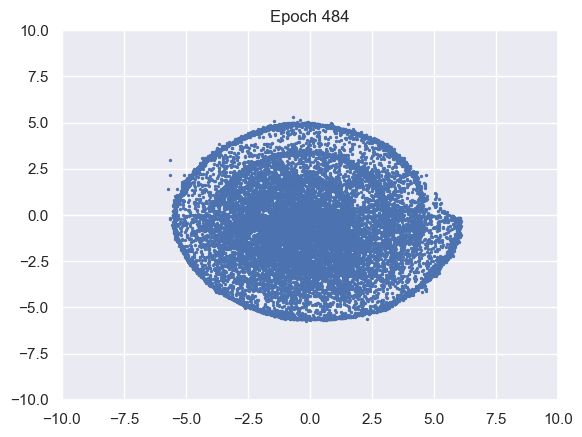

100%|██████████| 976/976 [00:10<00:00, 94.58it/s]


D loss : 1.3335, GP_loss : 0 G_loss : -0.7625, MI : 4.4817


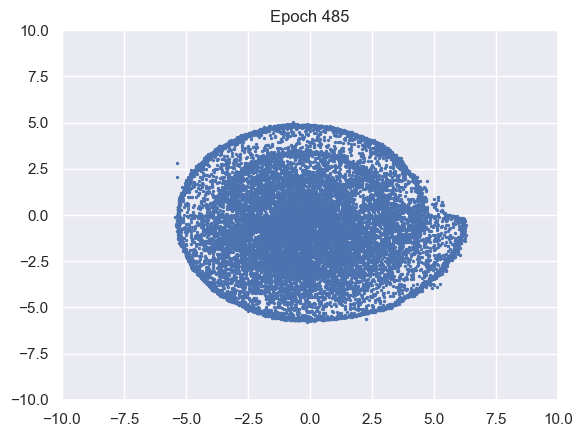

100%|██████████| 976/976 [00:10<00:00, 93.77it/s]


D loss : 1.3335, GP_loss : 0 G_loss : -0.7625, MI : 4.4822


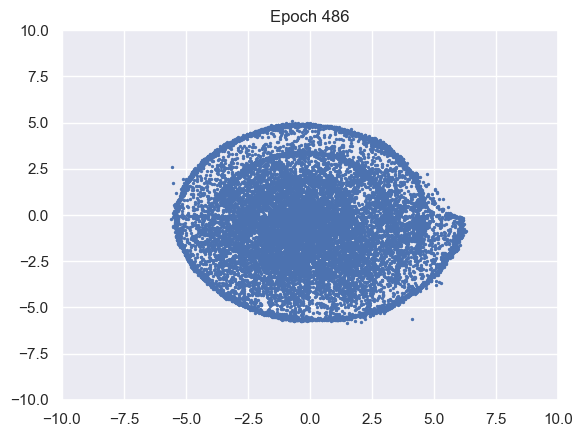

100%|██████████| 976/976 [00:10<00:00, 94.28it/s]


D loss : 1.3335, GP_loss : 0 G_loss : -0.7625, MI : 4.4826


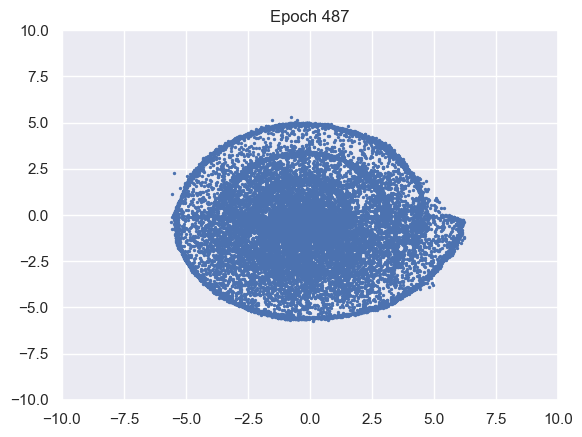

100%|██████████| 976/976 [00:10<00:00, 95.21it/s]


D loss : 1.3336, GP_loss : 0 G_loss : -0.7625, MI : 4.4827


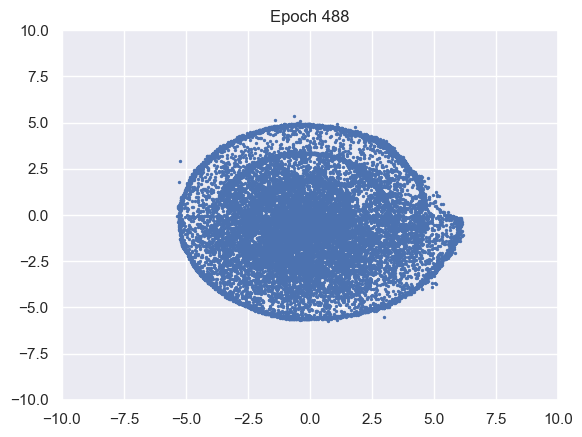

100%|██████████| 976/976 [00:10<00:00, 92.56it/s]


D loss : 1.3336, GP_loss : 0 G_loss : -0.7625, MI : 4.4834


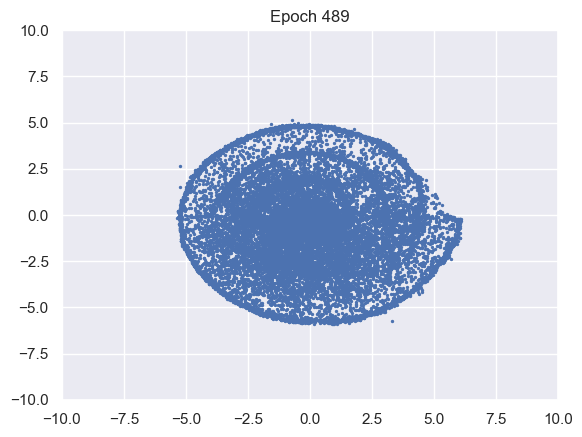

100%|██████████| 976/976 [00:10<00:00, 92.75it/s]


D loss : 1.3336, GP_loss : 0 G_loss : -0.7625, MI : 4.4836


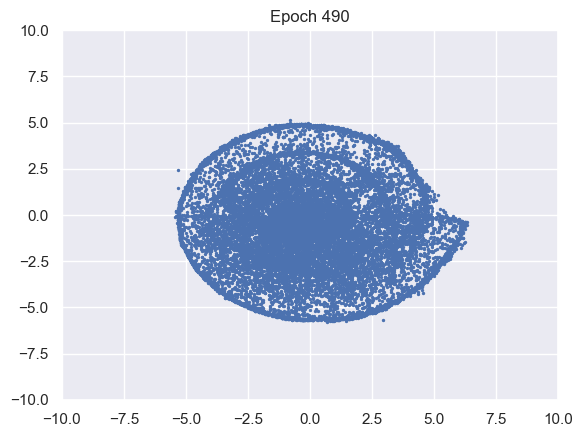

100%|██████████| 976/976 [00:10<00:00, 92.50it/s]


D loss : 1.3336, GP_loss : 0 G_loss : -0.7626, MI : 4.4843


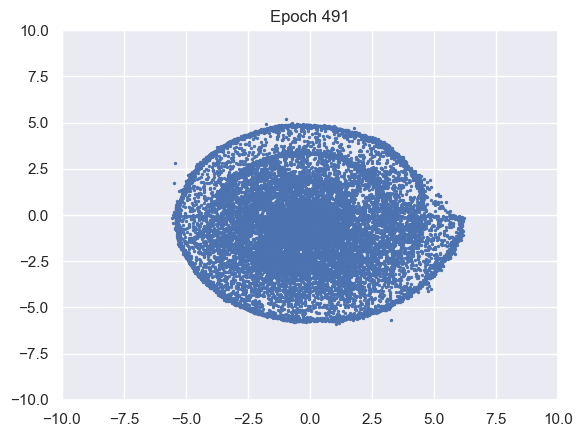

100%|██████████| 976/976 [00:10<00:00, 93.12it/s]


D loss : 1.3336, GP_loss : 0 G_loss : -0.7626, MI : 4.4847


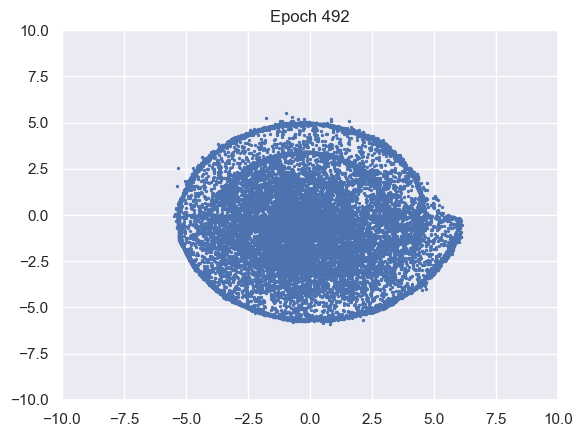

100%|██████████| 976/976 [00:10<00:00, 93.78it/s]


D loss : 1.3336, GP_loss : 0 G_loss : -0.7626, MI : 4.4853


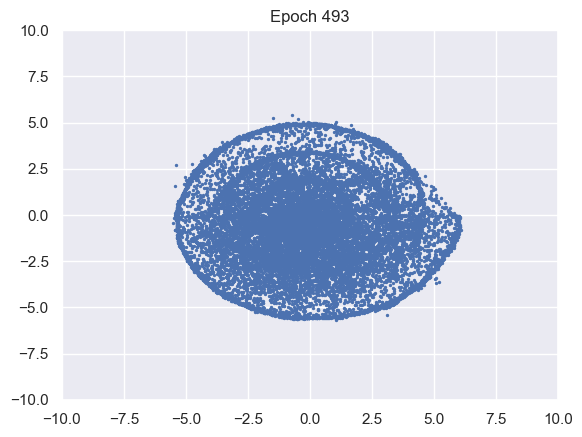

100%|██████████| 976/976 [00:10<00:00, 94.37it/s]


D loss : 1.3336, GP_loss : 0 G_loss : -0.7626, MI : 4.4858


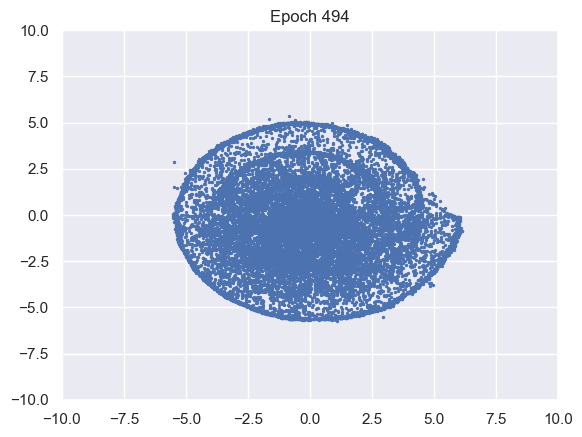

100%|██████████| 976/976 [00:10<00:00, 93.31it/s]


D loss : 1.3337, GP_loss : 0 G_loss : -0.7626, MI : 4.486


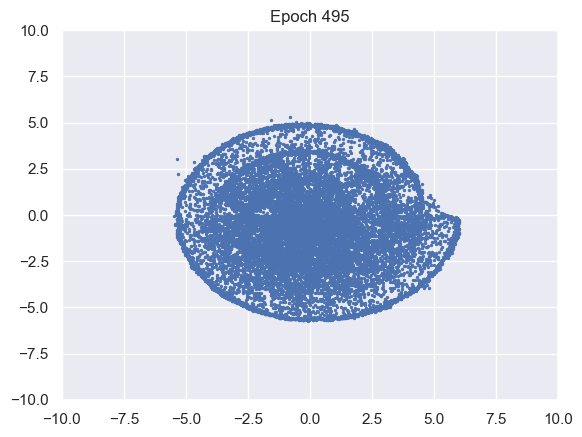

100%|██████████| 976/976 [00:10<00:00, 95.52it/s]


D loss : 1.3337, GP_loss : 0 G_loss : -0.7626, MI : 4.4865


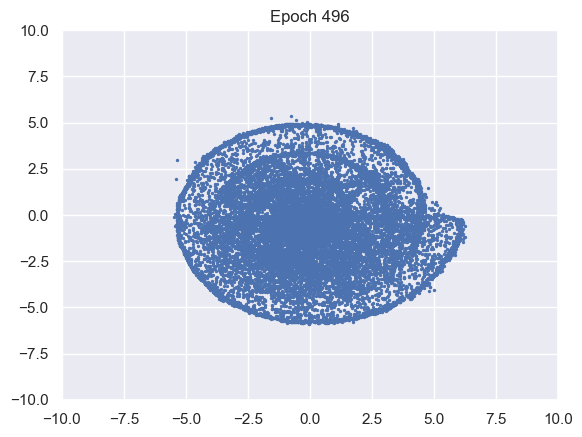

100%|██████████| 976/976 [00:10<00:00, 96.07it/s]


D loss : 1.3337, GP_loss : 0 G_loss : -0.7626, MI : 4.4868


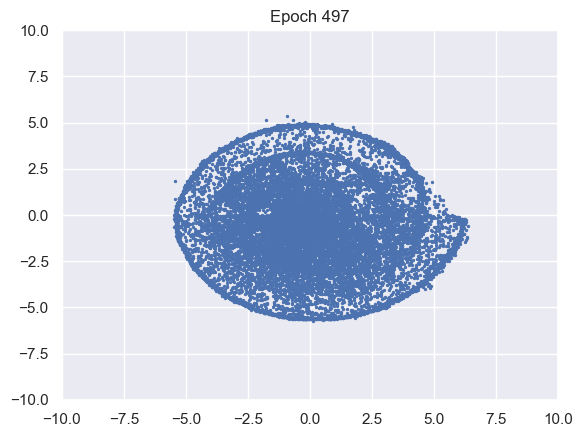

100%|██████████| 976/976 [00:10<00:00, 95.54it/s]


D loss : 1.3337, GP_loss : 0 G_loss : -0.7627, MI : 4.4877


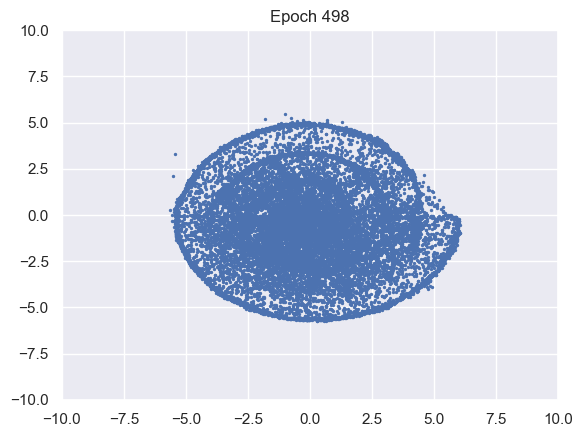

100%|██████████| 976/976 [00:10<00:00, 96.31it/s]


D loss : 1.3337, GP_loss : 0 G_loss : -0.7627, MI : 4.4884


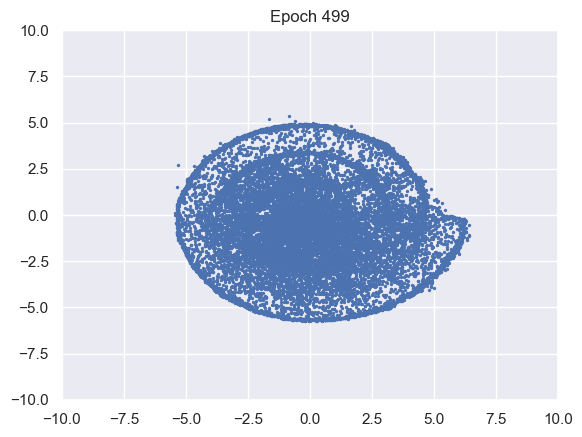

100%|██████████| 976/976 [00:10<00:00, 96.08it/s]


D loss : 1.3337, GP_loss : 0 G_loss : -0.7627, MI : 4.4886


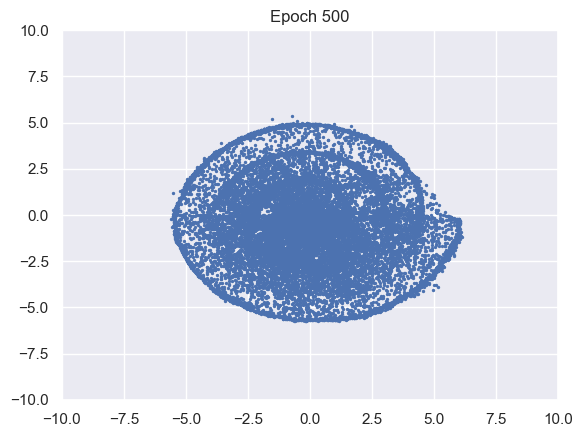

([2.650364875793457,
  2.4945907592773438,
  2.1724395751953125,
  1.9803977012634277,
  1.8336818218231201,
  1.6929137706756592,
  1.6243407726287842,
  1.5680646896362305,
  1.5205438137054443,
  1.4573907852172852,
  1.4133225679397583,
  1.389495611190796,
  1.3314216136932373,
  1.2665038108825684,
  1.1871352195739746,
  1.1698113679885864,
  1.1498053073883057,
  1.1271642446517944,
  1.1268537044525146,
  1.166694164276123,
  1.0744664669036865,
  1.0387113094329834,
  1.1442739963531494,
  1.1265830993652344,
  1.1810989379882812,
  1.1924599409103394,
  1.184138298034668,
  1.2704722881317139,
  1.2804961204528809,
  1.2381478548049927,
  1.2921713590621948,
  1.3165303468704224,
  1.3176710605621338,
  1.3455129861831665,
  1.235893726348877,
  1.2895472049713135,
  1.1971197128295898,
  1.2058584690093994,
  1.2176513671875,
  1.2498586177825928,
  1.214172601699829,
  1.2135305404663086,
  1.1995561122894287,
  1.264618992805481,
  1.2416107654571533,
  1.255835771560669,

In [43]:
# MI augemented GAN
G = Generator()
G_ma = Generator()
D = Discriminator()
M = Mine()

if USE_GPU:
    G, G_ma, D, M = G.cuda(), G_ma.cuda(), D.cuda(), M.cuda()

d_loss_arr, gp_loss_arr, g_loss_arr, mi_arr = [], [], [], []
G_ma.load_state_dict(G.state_dict())
G_opt = torch.optim.Adam(G.parameters(), lr=2e-4)
D_opt = torch.optim.Adam(D.parameters(), lr=2e-4)
M_opt = torch.optim.Adam(M.parameters(), lr=2e-4)

train(epoch_num=500, is_zero_gp=True, is_mi_obj=True)ㄴ

In [37]:
gp_loss_arr

[]